In [18]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import h5py
from sedpy.observate import load_filters, getSED
import astropy.stats
from astroquery.sdss import SDSS
from astropy import coordinates as coords
from astropy import units as u
import astropy.io.fits as fits
from astropy.modeling import models, fitting
from scipy.signal import medfilt
import scipy
from lmfit.models import GaussianModel, SkewedGaussianModel
import matplotlib.lines as mlines
from astropy.modeling import models, fitting
import os, shutil

#from palettable.tableau import Tableau_10
#col = Tableau_10.hex_colors

#from binotools import calbino
import binotools as bt
import CalBino as cb


plt.style.use('seaborn-talk')
from matplotlib import rc_file
#rc_file(os.environ['WORK_DIR']+'/code/matplotlibrc')

plt.rc('figure', dpi=150, figsize=(12,5))

# Binospec Telluric Correction and Flux Calibration

Flux calibration code from Ben Johnson, telluric correction by `molecfit`

Run `molecfit` in `os.environ['WORK_DIR']+'/Observing/Binospec/telluric_corrections'`

Save calib files in `os.environ['BINO_DIR']+'2649_BLAS_1/calib/'`

In [19]:
#calib_dir = os.environ['BINO_DIR']+'2649_BLAS_1/calib/'

# Work on sky-subtracted data?
sky_sub = False
if sky_sub:
    skysub_lab = '_skysub'
    flux_scale = 1.
else:
    skysub_lab = ''
    flux_scale = 1.e-19

In [20]:
# Find stars on the mask

# Find the stars
datadir    = "/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/"

def find_data():
    """
    Finds raw data
    """
    datadir    = "/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/"
    files=sorted(bt.insensitive_glob(datadir+'/*/obj_clean*abs_slits_lin.fits'))
    errs=sorted(bt.insensitive_glob(datadir+'/*/obj_clean*abs_err_slits_lin.fits'))
    #datadir    = "/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask1/Expositions/mask1/"
    #files=files+sorted(bt.insensitive_glob(datadir+'/*/obj_clean*abs_slits_lin_*.fits'))
    #errs=errs+sorted(bt.insensitive_glob(datadir+'/*/obj_clean*abs_err_slits_lin_*.fits'))
    return files,errs


spec2D_all,err2D_all = find_data()
for i,s in enumerate(spec2D_all):
    print(i,s)

stars={}
stars["index"]=[]
stars["id"]=[]
stars["ra"]=[]
stars["dec"]=[]
for ss,f in enumerate( [name for name in fits.open(spec2D_all[0]) if "ImageHDU" in str(name)]): #Get stars index
    #print(name)
    if "f_" in f.header["SLITOBJ"]:
        stars["index"].append(ss)
        stars["id"].append(f.header["SLITOBJ"])
        stars["ra"].append(f.header["ra"])
        stars["dec"].append(f.header["dec"])


for ss,f in enumerate( [name for name in fits.open(spec2D_all[70]) if "ImageHDU" in str(name)]): #Get stars index
    #print(name)
    if "f_" in f.header["SLITOBJ"]:
        stars["index"].append(ss)
        stars["id"].append(f.header["SLITOBJ"])
        stars["ra"].append(f.header["ra"])
        stars["dec"].append(f.header["dec"])

for ss,f in enumerate( [name for name in fits.open(spec2D_all[130]) if "ImageHDU" in str(name)]): #Get stars index
    #print(name)
    if "f_" in f.header["SLITOBJ"]:
        stars["index"].append(ss)
        stars["id"].append(f.header["SLITOBJ"])
        stars["ra"].append(f.header["ra"])
        stars["dec"].append(f.header["dec"])

#for ss,f in enumerate( [name for name in fits.open(spec2D_all[162]) if "ImageHDU" in str(name)]): #Get stars index
#    #print(name)
#    if "f_" in f.header["SLITOBJ"]:
#        stars["index"].append(ss)
#        stars["id"].append(f.header["SLITOBJ"])
#        stars["ra"].append(f.header["ra"])
#        stars["dec"].append(f.header["dec"])

print(stars)

0 /Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0124/obj_clean000_abs_slits_lin.fits
1 /Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0124/obj_clean001_abs_slits_lin.fits
2 /Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0124/obj_clean002_abs_slits_lin.fits
3 /Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0208/obj_clean000_abs_slits_lin.fits
4 /Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0208/obj_clean001_abs_slits_lin.fits
5 /Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0208/obj_clean002_abs_slits_lin.fits
6 /Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0208/obj_clean003_abs_slits_lin.fits
7 /Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0208/obj_clea

# Telluric Functions


In [21]:
from astropy.stats import sigma_clip

def giveMaskTelluric(wave_nm):

    telluric_regions = {'O2 A band':[757., 775.],
                        'O2 B-band':[685., 694.]}

    mask_telluric = np.array([], dtype=int)
    for region in telluric_regions:
        mask_telluric = np.hstack((mask_telluric, (np.where((wave_nm > telluric_regions[region][0]) & (wave_nm < telluric_regions[region][1]))[0])))

    return mask_telluric

def std_telluric_region(args, opt_args):
    """RMS of corrected flux in region of O2 A-band"""
    
    alpha, beta = args    
    wave, flux_in, trans_std = opt_args

    mask_telluric=giveMaskTelluric(wave/10.0)
    
    flux_corr = telluric_correction(wave, flux_in, trans_std, alpha, beta)[0]

    #print(alpha,beta,np.sum(np.abs(flux_corr[mask_telluric])))
    #plt.plot(wave[mask_telluric],flux_corr[mask_telluric],".")
    #plt.title(str(alpha)+"  "+ str(beta)+"  "+str(np.nanstd(flux_corr[mask_telluric])))
    #plt.show()
    return np.nanstd(flux_corr[mask_telluric])

def scaled_transmission(wave, trans_std, alpha=0., beta=1.):
    """
    Translate and scale transmission
    """
    transmission_function = np.interp(wave-alpha, wave, trans_std)**beta   
    return transmission_function

def telluric_correction(wave, flux_in, trans_std, alpha=0., beta=1.):
    """
    Telluric correction (assuming std at same airmass as target)
    
    F_corr = F_in / T(lambda - alpha)**beta
    """
    
    # Translate and scale transmission
    transmission_function = scaled_transmission(wave, trans_std, alpha, beta) 
        
    flux_out = flux_in/transmission_function
    flux_out[flux_out == 0.] = np.nan
    
    return flux_out,transmission_function

def optimized_tellcorr(wave, flux_in, trans_std, verbose=False):
    initial_guess = [0., 1.]  # initial guess can be anything
    bnds=((-10,10),(0.,2.))
    result = scipy.optimize.minimize(std_telluric_region, initial_guess, bounds=bnds,
                                     args=[wave, flux_in*1e16, trans_std])
    if verbose:
        print(result.x)
        
    alpha = result.x[0]
    beta  = result.x[1]
    

    return telluric_correction(wave, flux_in, trans_std, alpha=alpha, beta=beta)[1], alpha, beta


####
# Gonzalo Code
####

def obtainTransmission(wave,fluxSpec,fluxTemplate):
    transm=[ fluxTemplate[i]/fluxSpec[i] for i in range(0,len(wave))]
    #transm=transm/np.median(transm)
    return transm

def TelluricMask(tellCalib,wave):
    wave=np.array(wave)
    tellCalib=np.array(tellCalib)
    wave_nm=wave/10
    telluric_regions = {'O2 A band':[757., 775.],
                    'O2 B-band':[685., 694.]}
    mask_telluric=[]
    for ss,region in enumerate(telluric_regions):
        mask_telluric.append((wave_nm < telluric_regions[region][0]) | (wave_nm > telluric_regions[region][1]))
    mask    =   np.logical_and(*mask_telluric)
    #tellCalibs= np.interp(wave,wave[mask],tellCalib[mask])

    return wave[mask],tellCalib[mask]

def runCalbino(ra,dec,data_wave,data_flux,data_err):
    calbinoStar = cb.FluxCalBino(filter_set=["sdss_g0", "sdss_r0", "sdss_i0"])
    star_mags=calbinoStar.get_star_mags(ra,dec,verbose=False)

    libwave, libflux, libparams = calbinoStar.get_library()
    best_model = calbinoStar.choose_model(star_mags, nmod=1)

    best_sed = getSED(calbinoStar.libwave, best_model, calbinoStar.filters)
    dm       = np.mean(star_mags - best_sed, axis=-1)
    conv     = np.atleast_1d(10**(-0.4 * dm))
    fluxed_model = best_model * conv[:, None]
    
    z = 0.0 # redshift of the star, if known.
    a = (1 + z)
    fluxed_model_interp = np.interp(data_wave, libwave * a, fluxed_model[0])



    #get both into the scale of the sdss magnitudes
    i0=star_mags[2] #only filter in our range 
    filteri0=load_filters(["sdss_i0"])


    waveModel,maskedModel   =   TelluricMask(fluxed_model[0],calbinoStar.libwave)
    waveData,maskedData   =   TelluricMask(data_flux,data_wave)  
    print("wave Data, masked Data:",waveData,maskedData)

    maskedData=np.nan_to_num(maskedData)
    maskedData=zero_to_median(maskedData)

    magModel= getSED(waveModel,maskedModel,filteri0)
    magData=  getSED(waveData,maskedData,filteri0)
    print("mag Data: ",magData)


    calibModel=mag2flux_dif(i0,magModel)
    calibData=mag2flux_dif(i0,magData)
    print("calib Data: ",calibData)

    fluxed_model_interp= fluxed_model_interp*calibModel
    data_flux*=calibData
    data_err*=calibData



    ##Fit curve to continuum of data and continuum of model, then subtract

    fluxModel_noContinuum=(fluxed_model_interp/calbinoStar.smooth_calibration(data_wave,fluxed_model_interp,degree=2))
    fluxData_noContinuum=(data_flux/calbinoStar.smooth_calibration(data_wave,zero_to_nan(data_flux),degree=2))

    """

    plt.plot(data_wave,fluxed_model_interp)
    #plt.plot(data_wave,medfilt(fluxed_model_interp, 251),alpha=0.8,lw=0.8,ls="--")
    plt.plot(data_wave,calbinoStar.smooth_calibration(data_wave,fluxed_model_interp,degree=2)) 
    plt.show()

    #plt.plot(data_wave,fluxed_model_interp/medfilt(fluxed_model_interp, 251))
    plt.plot(data_wave,fluxed_model_interp/calbinoStar.smooth_calibration(data_wave,fluxed_model_interp,degree=2),alpha=0.6) 
    plt.show()

    plt.plot(data_wave,zero_to_median(data_flux))
    #plt.plot(data_wave,medfilt(data_flux, 501),alpha=0.8,lw=0.8,ls="--") 
    plt.plot(data_wave,calbinoStar.smooth_calibration(data_wave,zero_to_nan(data_flux),degree=2))
    plt.show()

    plt.plot(data_wave,zero_to_median(data_flux)/medfilt(data_flux, 501))
    plt.show()


    #fluxModel_noContinuum=(fluxed_model_interp/medfilt(fluxed_model_interp, 251))
    #fluxData_noContinuum=(data_flux/medfilt(data_flux, 501))

    plt.plot(data_wave,fluxData_noContinuum/fluxModel_noContinuum)
    plt.axhline(y=1,ls="--",alpha=0.9,color="black")
    plt.ylim(-0.5,1.5)
    plt.show()

    """
    #calibration =  data_flux   /fluxed_model_interp
    calibration =   fluxData_noContinuum/fluxModel_noContinuum   




    calibration=[ 1.0 if c>1.0 else c for c in calibration]
  

    smoothed_calibration = medfilt(calibration, 101)
    
    calibration=zero_to_median(calibration)
    calibration,smoothed_calibration=zero_to_one(calibration),zero_to_one(smoothed_calibration)
    
    #plt.plot(calibration)
    #plt.plot(smoothed_calibration)
    #plt.show()


    return fluxed_model_interp,calibration,smoothed_calibration




# Fitting Functions

In [22]:
# 1D slit spectra

from scipy.optimize import minimize
from scipy import interpolate
import os

def gaussian_ML(x,flux, mu, sig,C) :
    """Gaussian"""
    return flux* np.exp( -0.5 * (x-mu)**2 / sig**2) + C

def log_likelihood_ML(theta, x, y, yerr):
    flux, mu,sig,C = theta
    model = gaussian_ML(x,flux, mu,sig,C)
    sigma2 = yerr ** 2  #sigma2 is sigma square from the likelihood stuff, not the gaussian
    return -0.5 * np.sum((y - model) ** 2 / sigma2 + np.log(sigma2))

def obtainSeeing(data,reps,rango,interval,showPlots=False):
    seeings=[]
    for i in range(0,reps-5):
        sectionData = data[:,interval*i:interval*(i+1)] #Cut section of the data 
        collapsedData = np.nansum(sectionData,axis=1)
        collapsedData=collapsedData/np.max(collapsedData)
        #print(collapsedData)

        if np.isnan(max(collapsedData))==True:
            continue
        peak=list(collapsedData).index(max(collapsedData))

        waveX=range(0,len(collapsedData))
        nll = lambda *args: -log_likelihood_ML(*args)   #ML fit
        initial = np.array([1,peak,2,0 ])
        soln = minimize(nll, initial, args=(waveX, collapsedData, np.sqrt(np.abs(collapsedData)+0.01)))
        flux,mu,sig,C = soln.x
        
        fwhm=2.355*sig
        seeings.append(fwhm)
    #if fwhm*0.24 <0.8 or fwhm*0.24 >1.1:
        if showPlots==True:
            plt.plot(np.linspace(0,len(collapsedData),500),gaussian_ML(np.linspace(0,len(collapsedData),500),*soln.x),alpha=0.2)
            plt.plot(waveX,collapsedData,alpha=0.2)
            plt.axvline(x=mu+fwhm)
            plt.axvline(x=mu-fwhm)
    plt.title("Seeing: "+ str(np.nanmedian(seeings)*0.24))
    plt.show()
    return np.nanmedian(seeings)


# Conversion Functions

In [23]:
def interpolateStar(wave,flux):
    f = interpolate.interp1d(wave, flux)
    return f

def ABtoFlux(AB):
    flux=10**-((AB+48.6)/2.5)
    return flux

def mag2flux_dif(observation,data):
    fluxCalib=ABtoFlux(observation)/ABtoFlux(data)
    return fluxCalib

def zero_to_median(lista):
    smoothed=medfilt(lista, 101)
    for i in range(0,len(lista)):
        if lista[i]==0:
            lista[i]=smoothed[i]
    return lista

def zero_to_nan(lista):
    for i in range(0,len(lista)):
        if lista[i]==0:
            lista[i]=np.nan
    return lista

def zero_to_one(lista):
    for i in range(0,len(lista)):
        if lista[i]==0:
            lista[i]=1
    return lista

# Flux Calibration Functions

In [24]:
def FluxCalib(ra,dec,data_wave,data_flux):
    #Flux must be already telluric calibrated
    calbinoStar = cb.FluxCalBino(filter_set=["sdss_g0", "sdss_r0", "sdss_i0"])
    star_mags=calbinoStar.get_star_mags(ra,dec,verbose=False)
    best_model = calbinoStar.choose_model(star_mags, nmod=1)
    best_sed = getSED(calbinoStar.libwave, best_model, calbinoStar.filters)
    
    dm       = np.mean(star_mags - best_sed, axis=-1)
    conv     = np.atleast_1d(10**(-0.4 * dm))
    fluxed_model = best_model * conv[:, None]
    fluxed_model_interp = np.interp(data_wave, calbinoStar.libwave, fluxed_model[0])

    calibration = fluxed_model_interp / data_flux


    p_init = models.Polynomial1D(degree=2)
    calibration_masked = np.ma.masked_array(calibration, mask=np.isnan(calibration))
    fit_p = fitting.LinearLSQFitter()
    p = fit_p(p_init, data_wave, calibration_masked)


    return  p(data_wave)

## Main


mask2_1


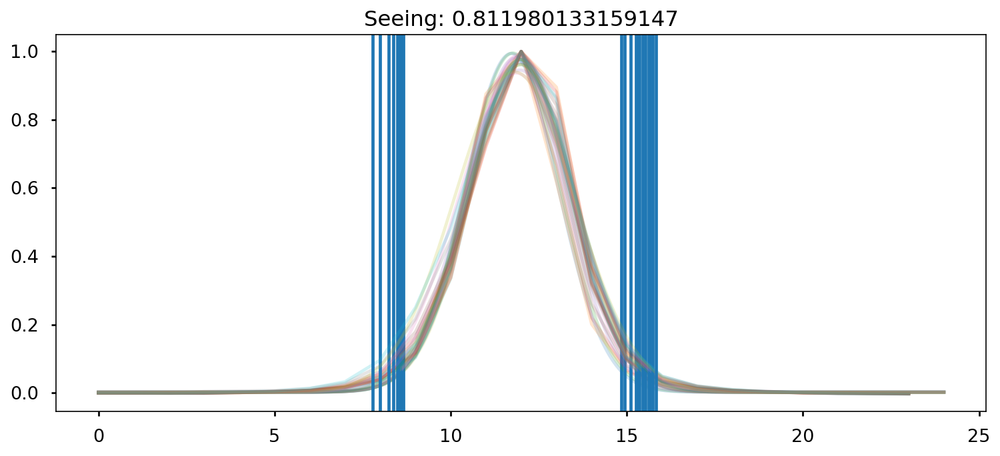

Mediana espectro estrella:  134.7425
Mediana fluxcal:  3.166118864887859e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.36267188]
calib Data:  [0.98230137]


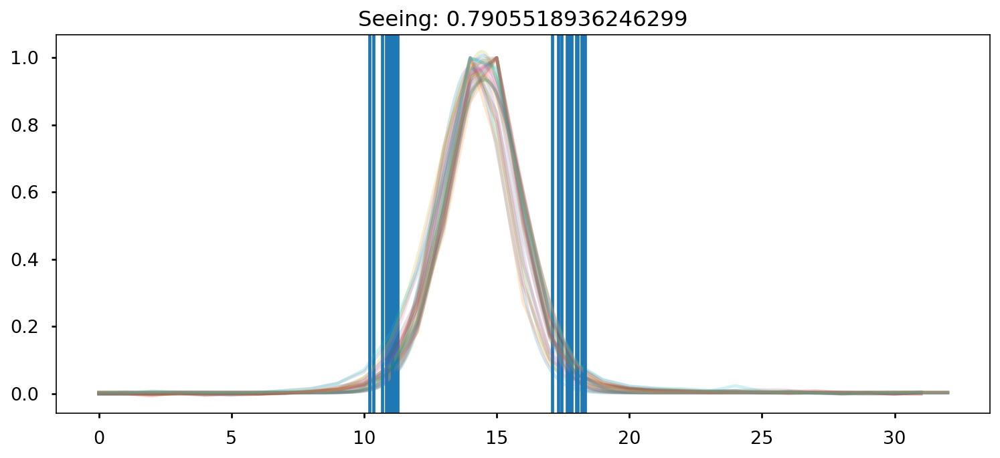

Mediana espectro estrella:  54.01373
Mediana fluxcal:  3.242809511255064e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.33576245]
calib Data:  [0.98490191]
Fcalib :  [3.44406066e-18 3.44372118e-18 3.44338185e-18 ... 3.89864679e-18
 3.89914794e-18 3.89964924e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0124/obj_clean000_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0124
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0124/obj_clean000_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0124
mask2_1


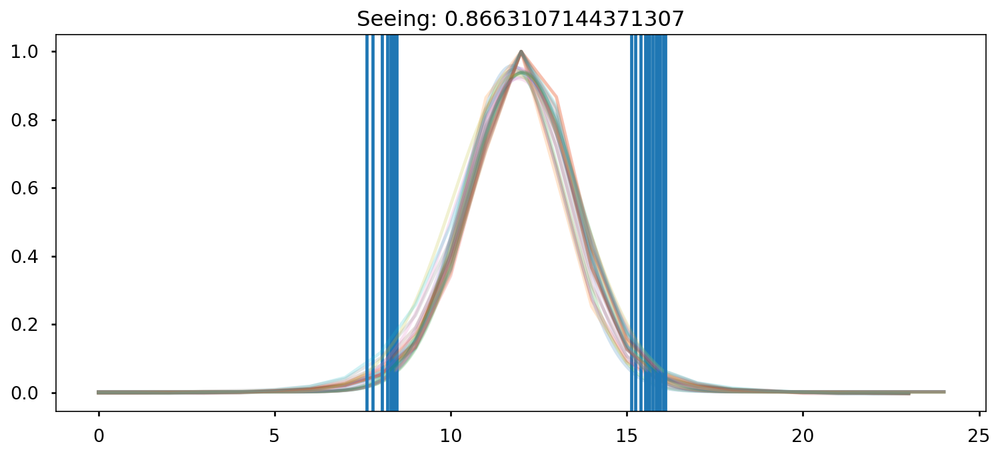

Mediana espectro estrella:  132.85251
Mediana fluxcal:  3.26882777846904e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.32298405]
calib Data:  [0.94704283]


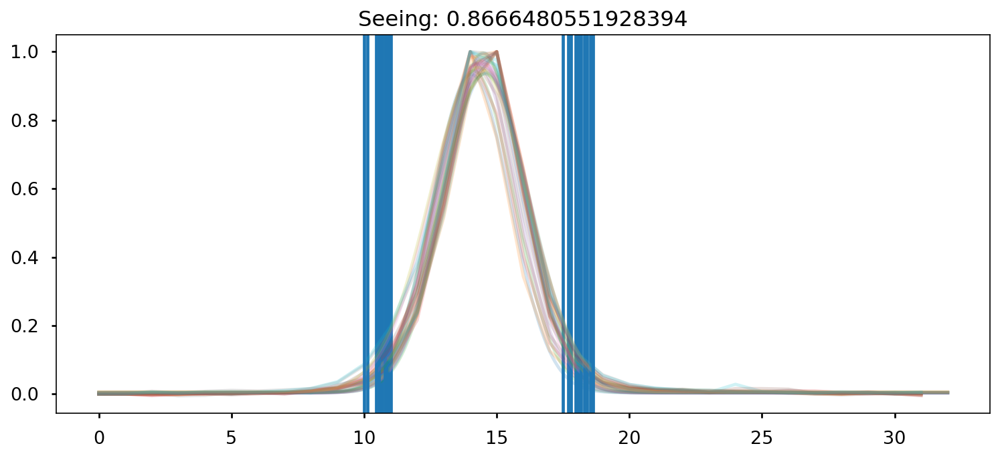

Mediana espectro estrella:  53.63512
Mediana fluxcal:  3.205422229593553e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.33084496]
calib Data:  [0.9804512]
Fcalib :  [3.60440010e-18 3.60391383e-18 3.60342776e-18 ... 4.14911276e-18
 4.14979278e-18 4.15047301e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0124/obj_clean001_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0124
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0124/obj_clean001_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0124
mask2_1


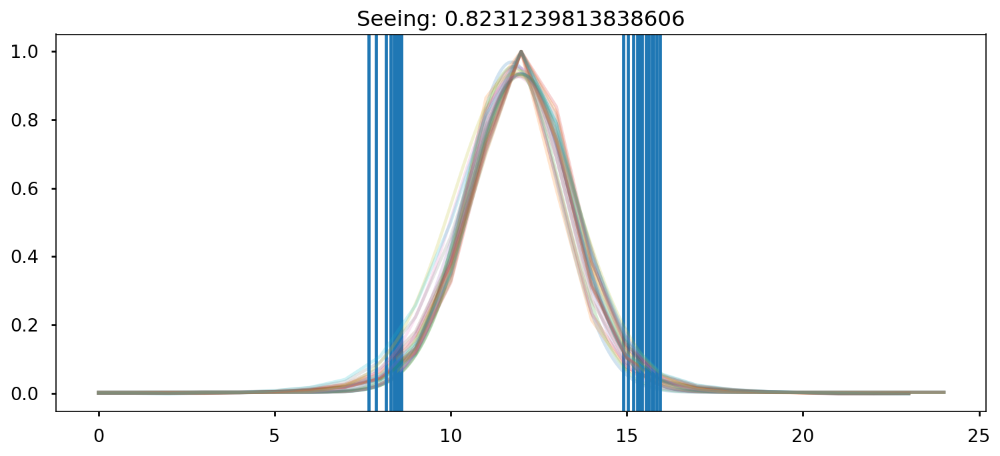

Mediana espectro estrella:  131.32042
Mediana fluxcal:  3.1884181687711273e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.36672813]
calib Data:  [0.98597806]


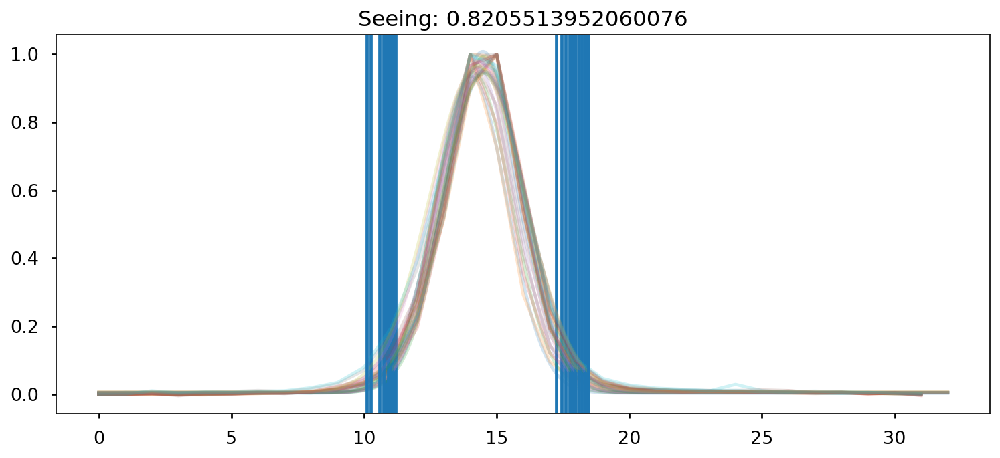

Mediana espectro estrella:  51.555187
Mediana fluxcal:  3.3591986524485946e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.3385351]
calib Data:  [0.98742027]
Fcalib :  [3.41926931e-18 3.41897126e-18 3.41867337e-18 ... 4.12986225e-18
 4.13041292e-18 4.13096374e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0124/obj_clean002_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0124
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0124/obj_clean002_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0124
mask2_1


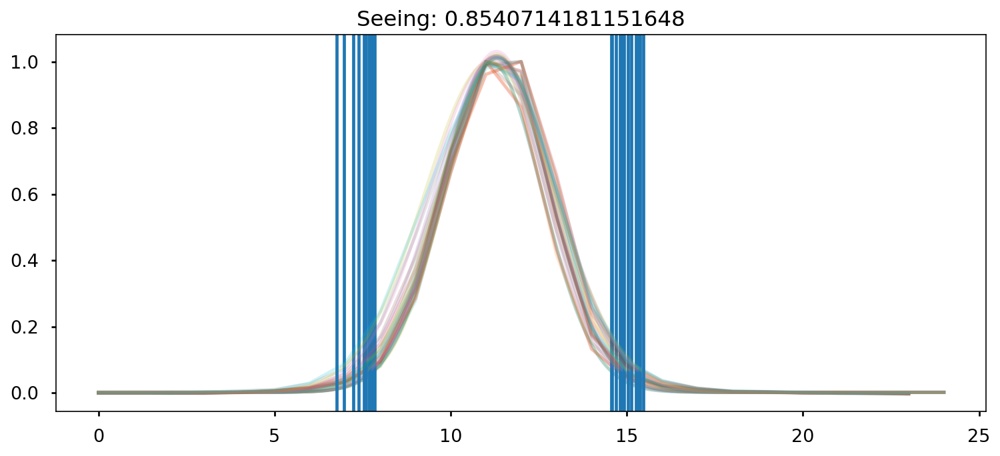

Mediana espectro estrella:  132.27112
Mediana fluxcal:  3.1592567145636337e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.35585321]
calib Data:  [0.97615163]


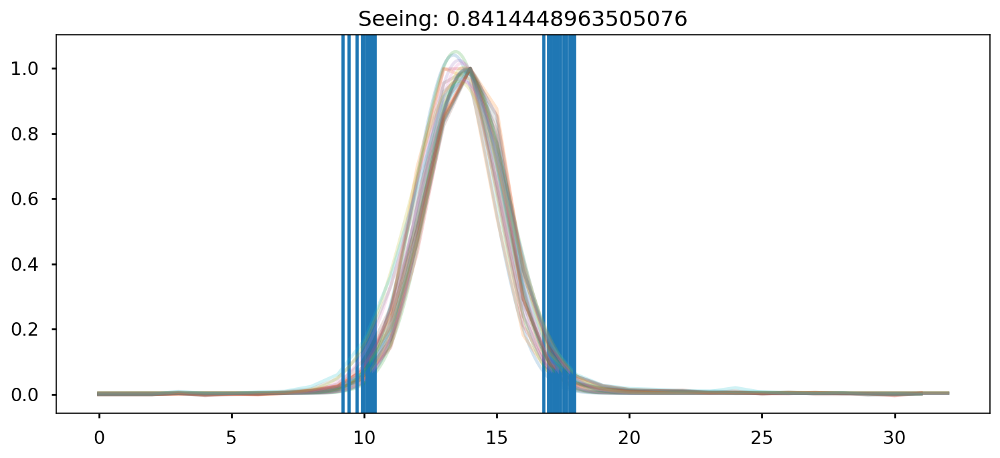

Mediana espectro estrella:  55.286858
Mediana fluxcal:  3.1370424887368666e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.34193738]
calib Data:  [0.99051932]
Fcalib :  [3.51683639e-18 3.51657072e-18 3.51630512e-18 ... 3.27242151e-18
 3.27260043e-18 3.27277942e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0208/obj_clean000_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0208
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0208/obj_clean000_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0208
mask2_1


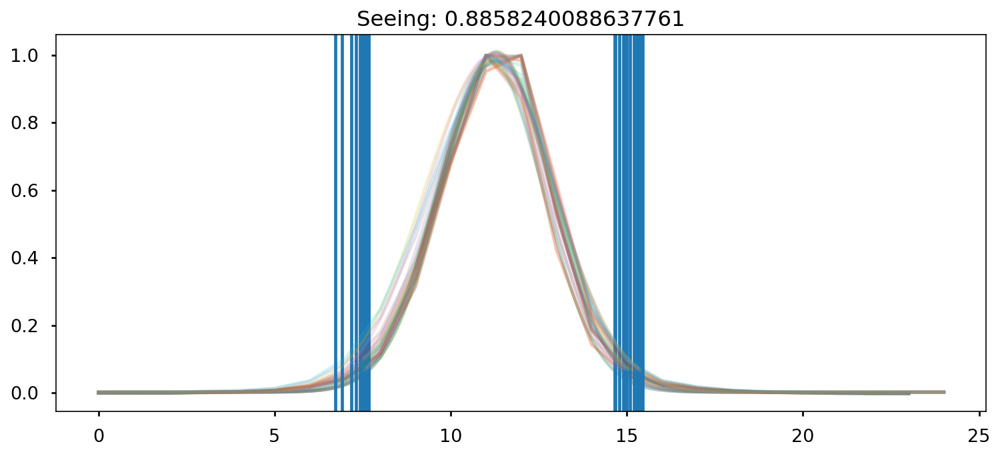

Mediana espectro estrella:  134.96857
Mediana fluxcal:  3.101969444781804e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.35435226]
calib Data:  [0.97480311]


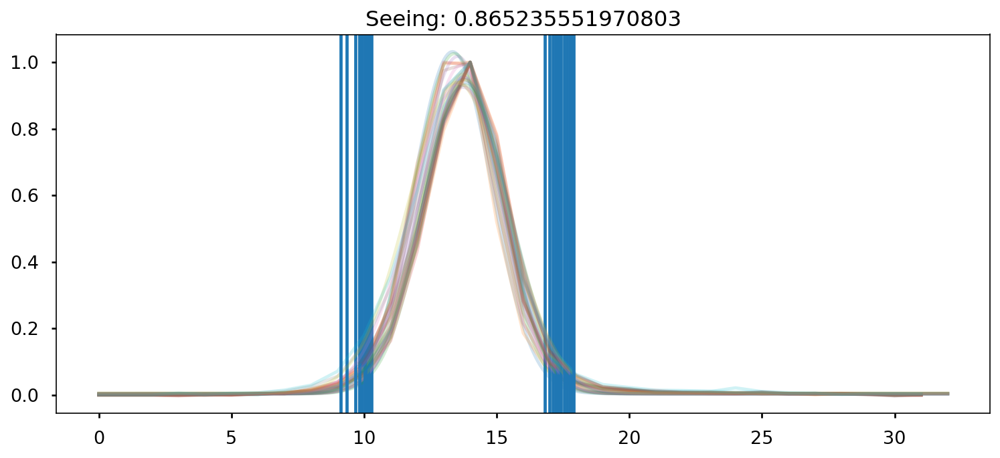

Mediana espectro estrella:  55.89886
Mediana fluxcal:  3.1462091322572413e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.3401666]
calib Data:  [0.98890515]
Fcalib :  [3.45133370e-18 3.45102954e-18 3.45072549e-18 ... 3.44353301e-18
 3.44383450e-18 3.44413610e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0208/obj_clean001_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0208
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0208/obj_clean001_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0208
mask2_1


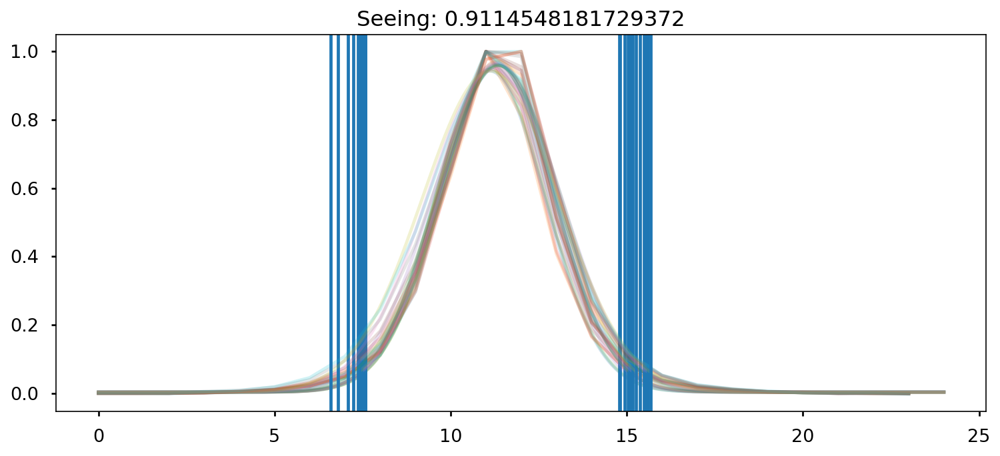

Mediana espectro estrella:  132.93512
Mediana fluxcal:  3.1501487949429723e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.35415702]
calib Data:  [0.97462783]


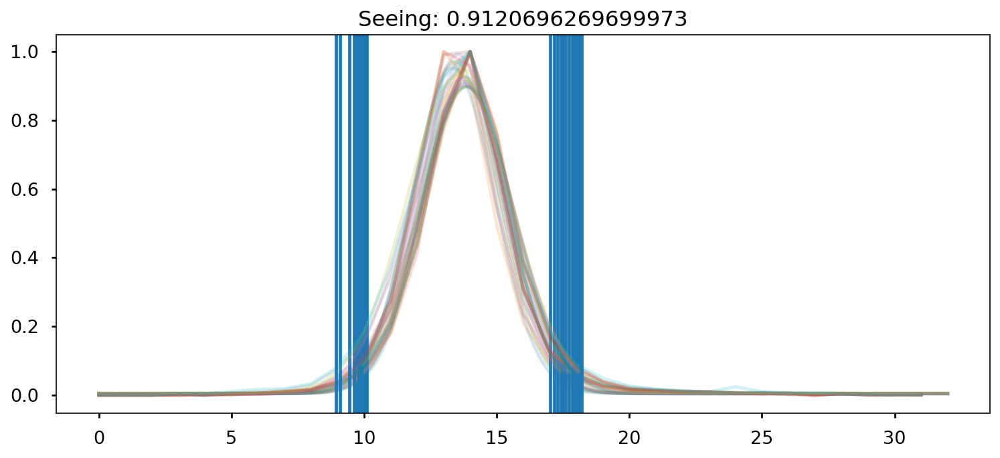

Mediana espectro estrella:  53.00236
Mediana fluxcal:  3.2748178325342717e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.33529767]
calib Data:  [0.98448038]
Fcalib :  [3.43839662e-18 3.43808812e-18 3.43777975e-18 ... 3.82047697e-18
 3.82092136e-18 3.82136589e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0208/obj_clean002_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0208
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0208/obj_clean002_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0208
mask2_1


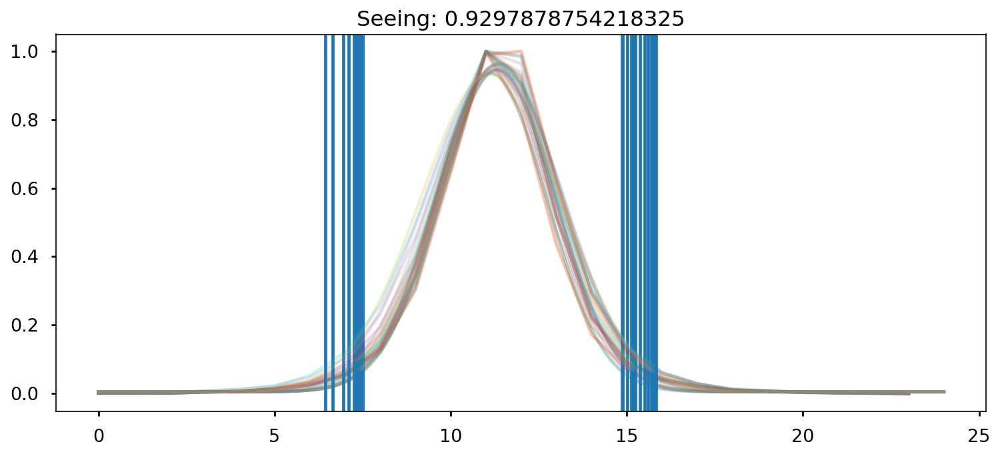

Mediana espectro estrella:  130.21017
Mediana fluxcal:  3.2192848958067623e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.35524561]
calib Data:  [0.97560551]


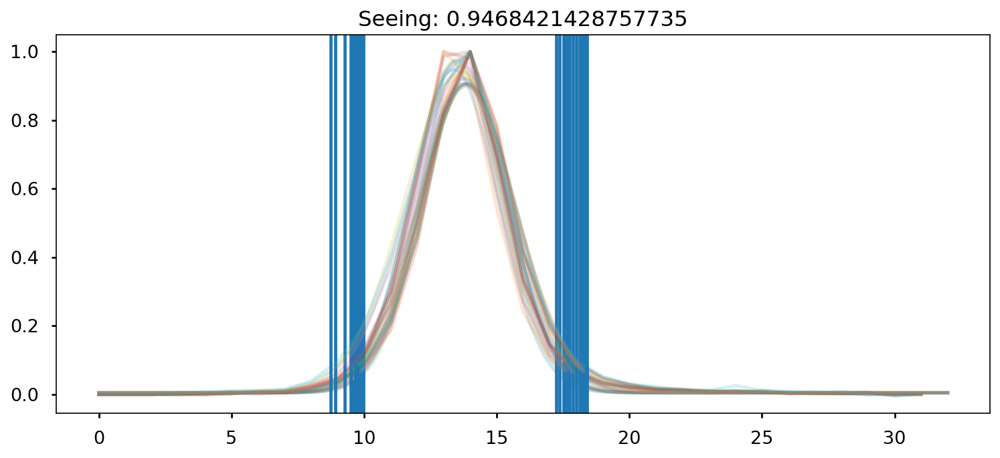

Mediana espectro estrella:  51.669636
Mediana fluxcal:  3.3630679982612832e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.33830986]
calib Data:  [0.98721545]
Fcalib :  [3.51042634e-18 3.51011299e-18 3.50979979e-18 ... 3.93928096e-18
 3.93974682e-18 3.94021281e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0208/obj_clean003_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0208
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0208/obj_clean003_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0208
mask2_1


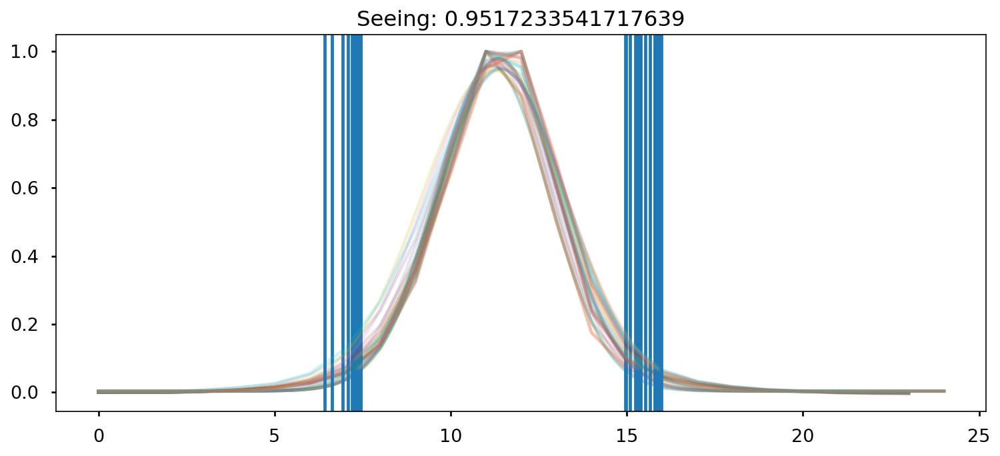

Mediana espectro estrella:  125.17421
Mediana fluxcal:  3.3583044365463362e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.35682467]
calib Data:  [0.97702543]


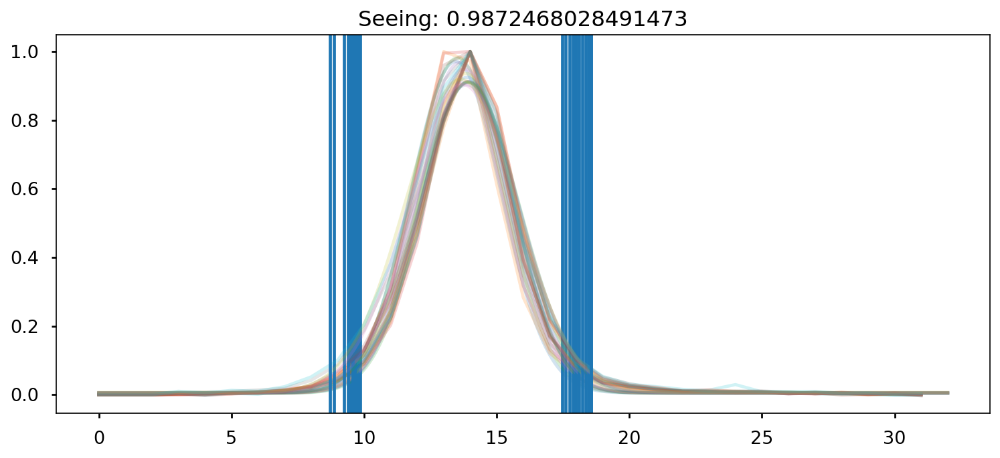

Mediana espectro estrella:  49.861954
Mediana fluxcal:  3.494413585719361e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.33640867]
calib Data:  [0.98548829]
Fcalib :  [3.66344828e-18 3.66313121e-18 3.66281428e-18 ... 4.03337117e-18
 4.03381981e-18 4.03426858e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0208/obj_clean004_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0208
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0208/obj_clean004_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0208
mask2_1


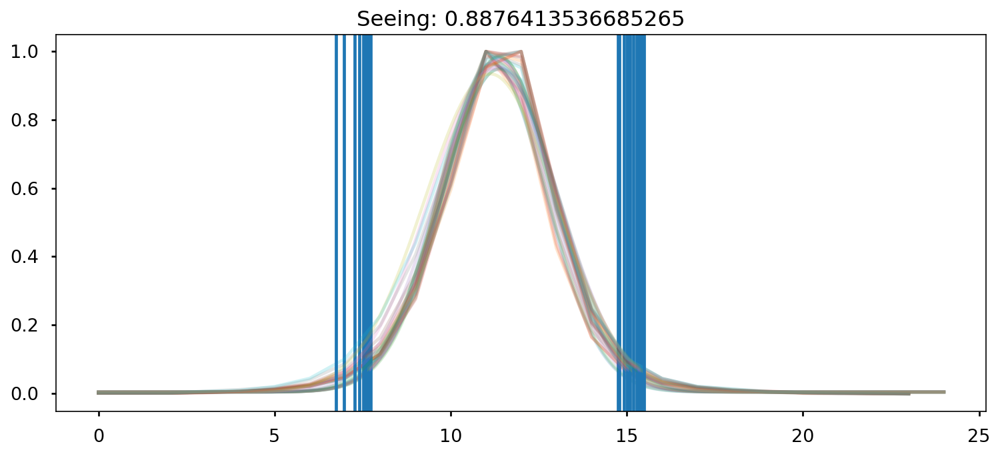

Mediana espectro estrella:  132.3878
Mediana fluxcal:  3.1807555022076336e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.35280385]
calib Data:  [0.97341389]


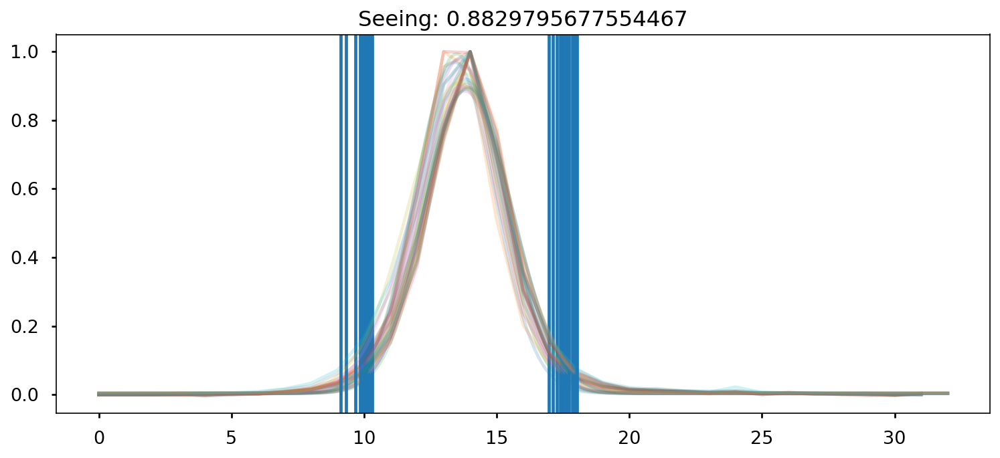

Mediana espectro estrella:  52.83647
Mediana fluxcal:  3.283952265261737e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.33645473]
calib Data:  [0.98553009]
Fcalib :  [3.45483632e-18 3.45454054e-18 3.45424489e-18 ... 3.79651058e-18
 3.79692788e-18 3.79734531e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0208/obj_clean005_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0208
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0208/obj_clean005_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0208
mask2_1


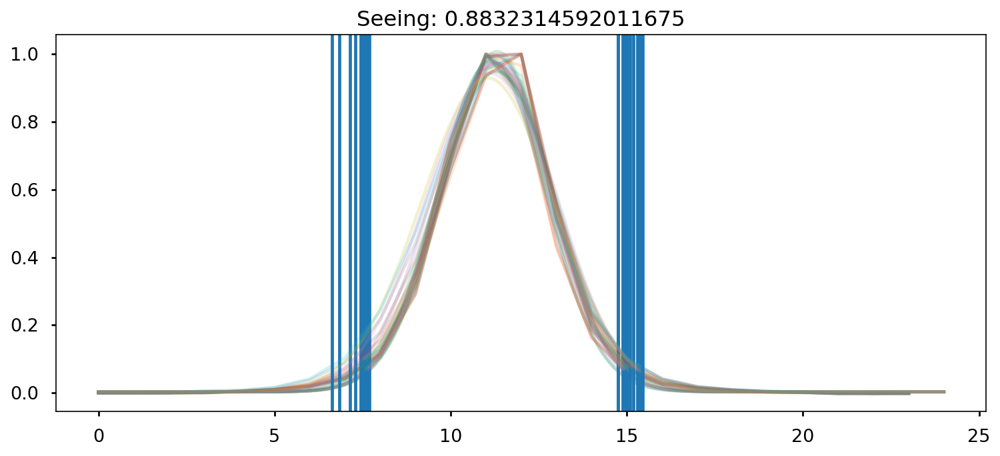

Mediana espectro estrella:  132.17459
Mediana fluxcal:  3.1868842023173095e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.35604504]
calib Data:  [0.97632411]


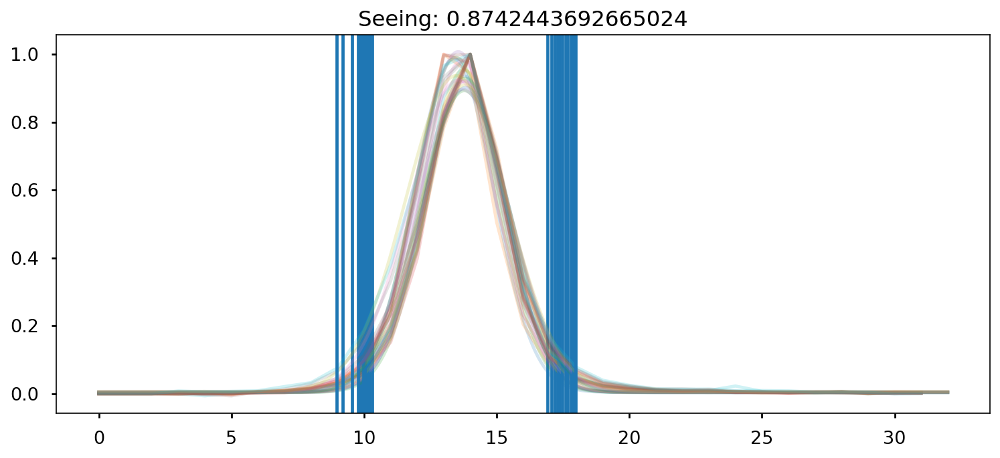

Mediana espectro estrella:  53.307014
Mediana fluxcal:  3.2553261728966032e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.33961028]
calib Data:  [0.98839858]
Fcalib :  [3.45323583e-18 3.45294977e-18 3.45266382e-18 ... 3.72022723e-18
 3.72060827e-18 3.72098944e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0208/obj_clean006_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0208
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0208/obj_clean006_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0208
mask2_1


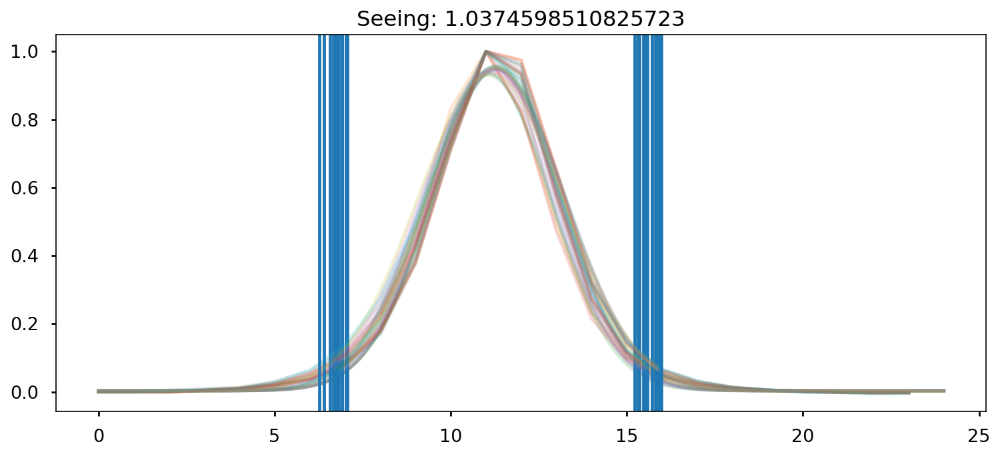

Mediana espectro estrella:  124.778206
Mediana fluxcal:  3.4257694183889137e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.35644964]
calib Data:  [0.97668801]


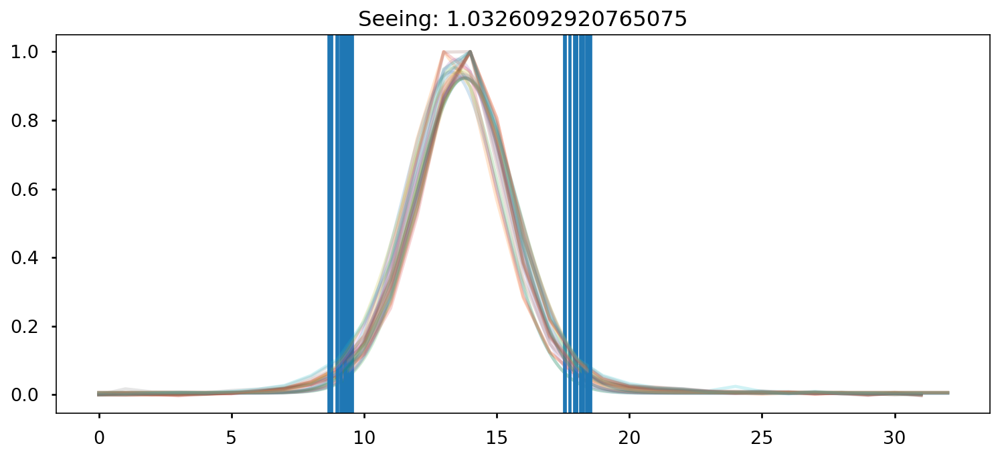

Mediana espectro estrella:  48.63679
Mediana fluxcal:  3.6227871462982645e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.32797158]
calib Data:  [0.97785989]
Fcalib :  [3.79945328e-18 3.79902138e-18 3.79858967e-18 ... 4.50625458e-18
 4.50693781e-18 4.50762124e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0209/obj_clean000_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0209
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0209/obj_clean000_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0209
mask2_1


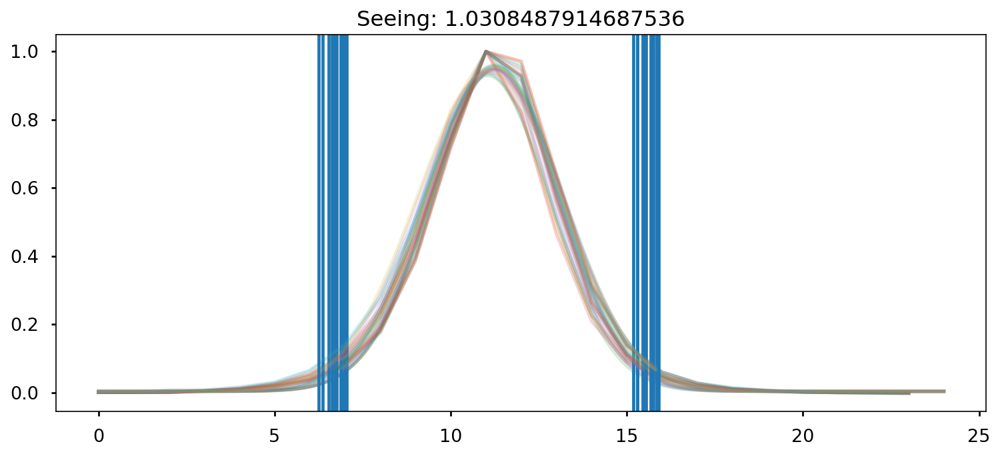

Mediana espectro estrella:  126.00917
Mediana fluxcal:  3.385989466480502e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.35525483]
calib Data:  [0.9756138]


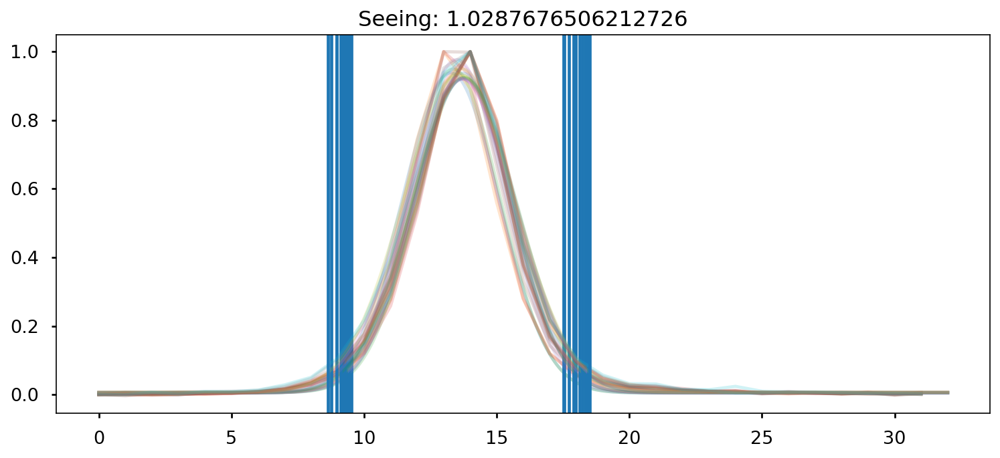

Mediana espectro estrella:  49.192234
Mediana fluxcal:  3.582732913472593e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.32688485]
calib Data:  [0.97688162]
Fcalib :  [3.74745663e-18 3.74703560e-18 3.74661477e-18 ... 4.46100140e-18
 4.46167615e-18 4.46235109e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0209/obj_clean001_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0209
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0209/obj_clean001_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0209
mask2_1


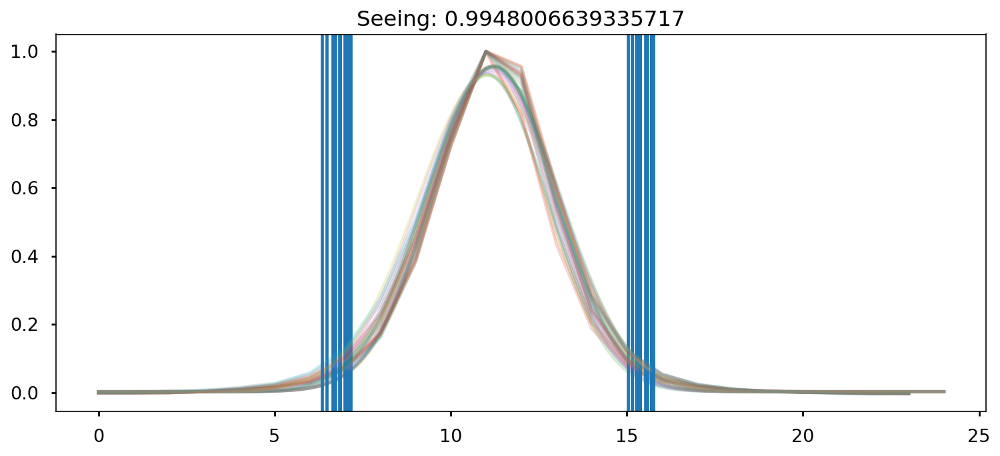

Mediana espectro estrella:  127.56202
Mediana fluxcal:  3.3591154872547767e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.35268807]
calib Data:  [0.9733101]


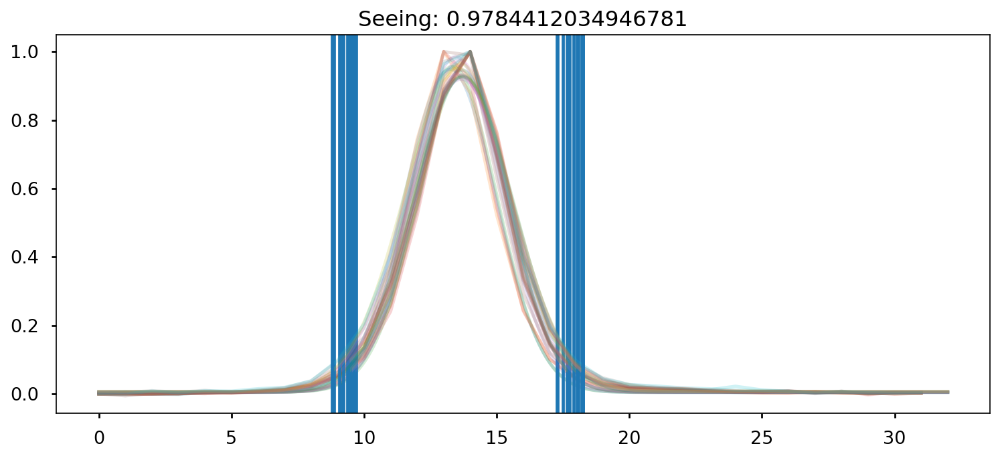

Mediana espectro estrella:  50.14482
Mediana fluxcal:  3.506848405656518e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.32157206]
calib Data:  [0.97211316]
Fcalib :  [3.69811442e-18 3.69771711e-18 3.69731998e-18 ... 4.29629564e-18
 4.29690566e-18 4.29751587e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0209/obj_clean002_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0209
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0209/obj_clean002_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0209
mask2_1


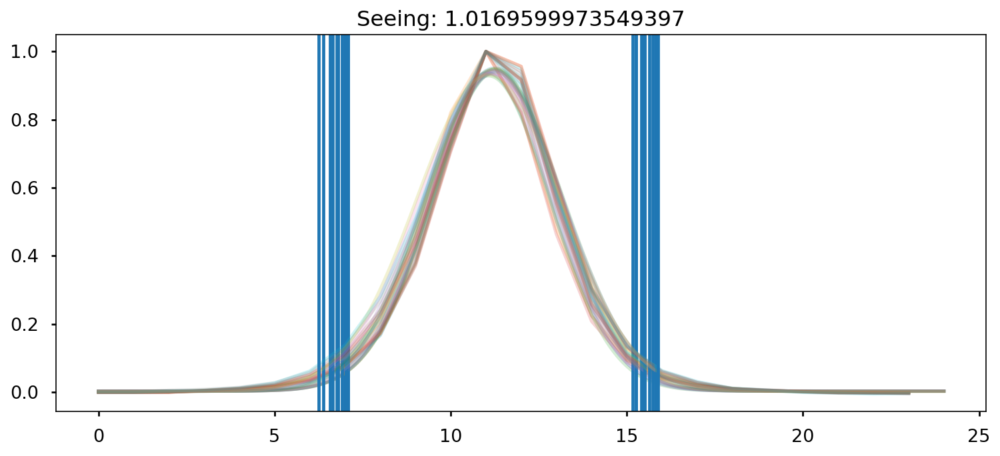

Mediana espectro estrella:  124.69636
Mediana fluxcal:  3.4278314410040777e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.35629553]
calib Data:  [0.97654939]


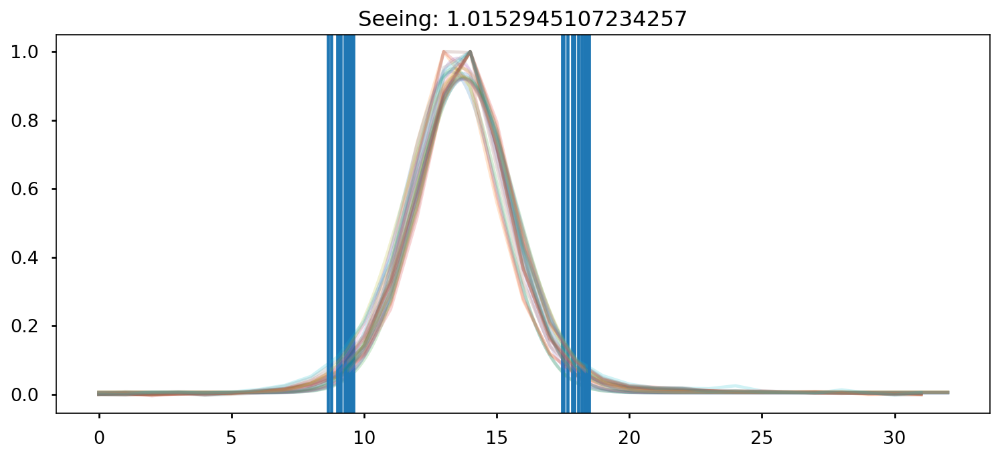

Mediana espectro estrella:  48.631836
Mediana fluxcal:  3.618874971915934e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.32465613]
calib Data:  [0.97487841]
Fcalib :  [3.76478669e-18 3.76438393e-18 3.76398135e-18 ... 4.49769677e-18
 4.49836013e-18 4.49902368e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0209/obj_clean003_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0209
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0209/obj_clean003_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0209
mask2_1


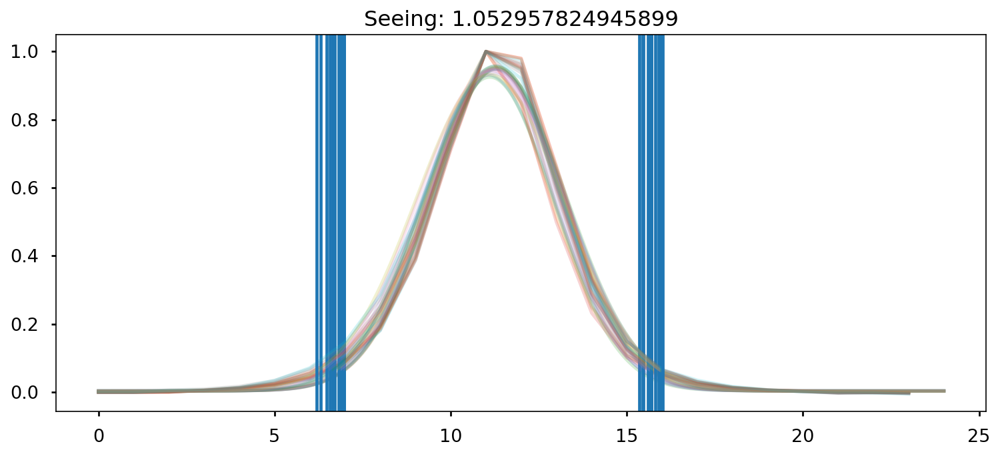

Mediana espectro estrella:  119.0853
Mediana fluxcal:  3.574839680295772e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.35442438]
calib Data:  [0.97486786]


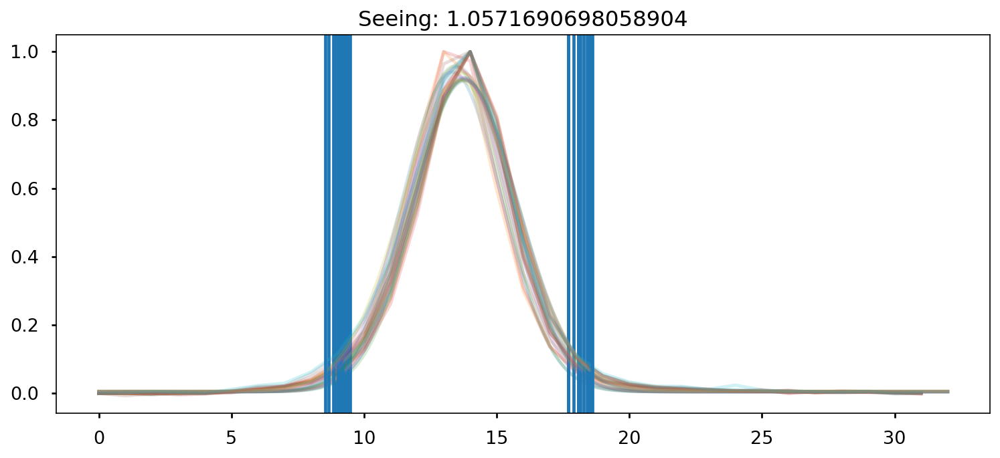

Mediana espectro estrella:  46.568283
Mediana fluxcal:  3.7774807349009156e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.33025029]
calib Data:  [0.97991434]
Fcalib :  [3.91505527e-18 3.91465396e-18 3.91425284e-18 ... 4.65354517e-18
 4.65420906e-18 4.65487313e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0209/obj_clean004_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0209
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0209/obj_clean004_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0209
mask2_1


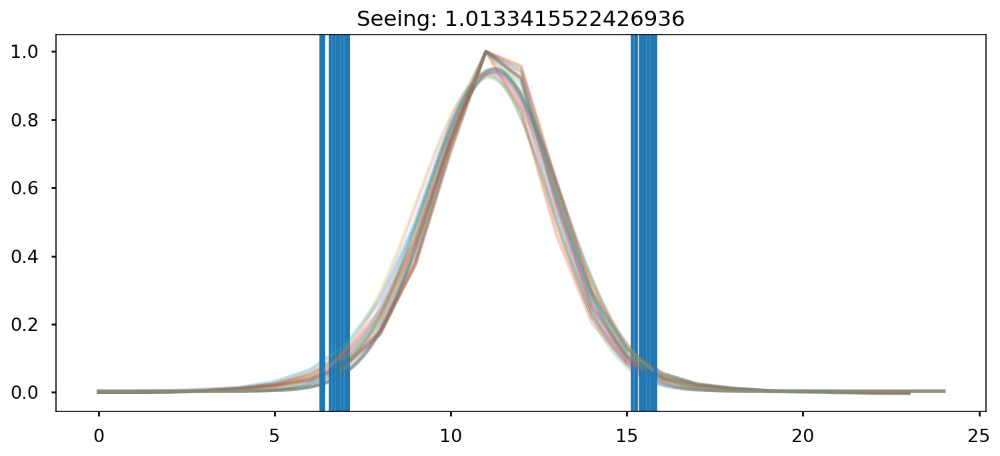

Mediana espectro estrella:  123.30823
Mediana fluxcal:  3.4495889771889896e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.35253398]
calib Data:  [0.97317197]


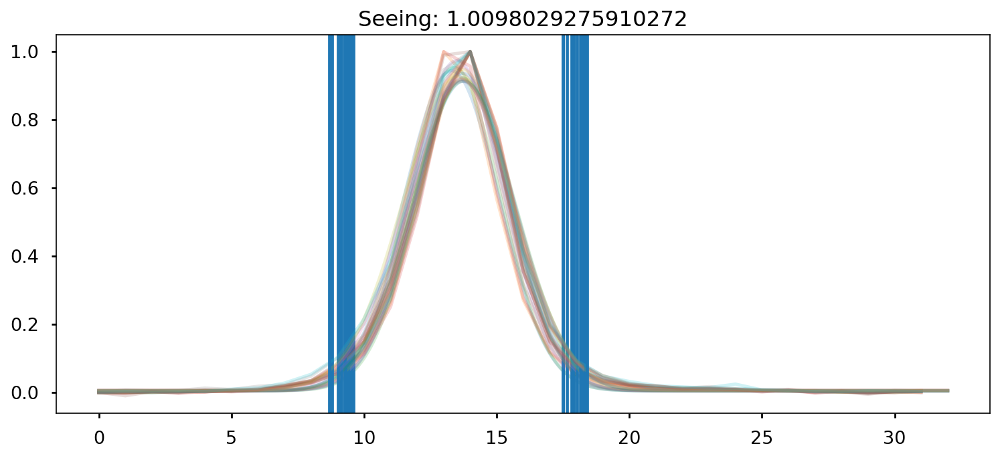

Mediana espectro estrella:  47.944218
Mediana fluxcal:  3.662257302109435e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.32782238]
calib Data:  [0.97772552]
Fcalib :  [3.77280278e-18 3.77242609e-18 3.77204958e-18 ... 4.50377764e-18
 4.50441423e-18 4.50505099e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0209/obj_clean005_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0209
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0209/obj_clean005_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0209
mask2_1


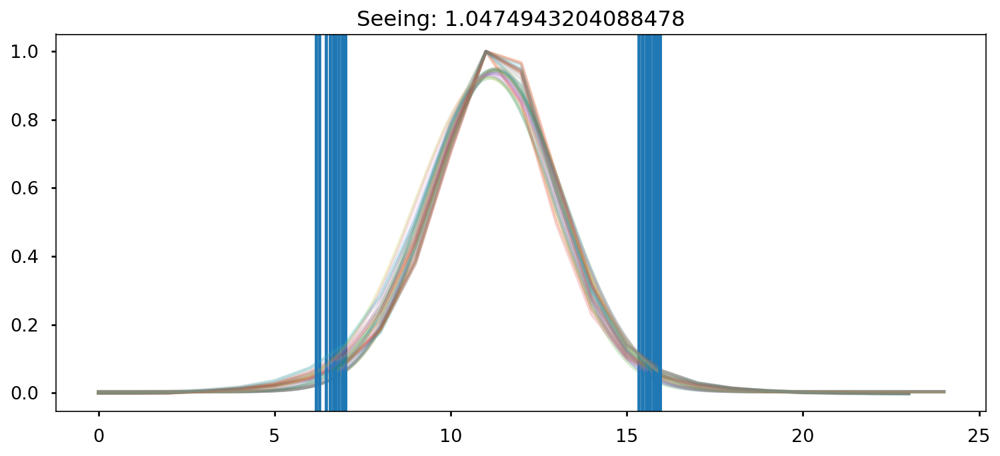

Mediana espectro estrella:  118.13696
Mediana fluxcal:  3.5938026993733614e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.35558529]
calib Data:  [0.97591078]


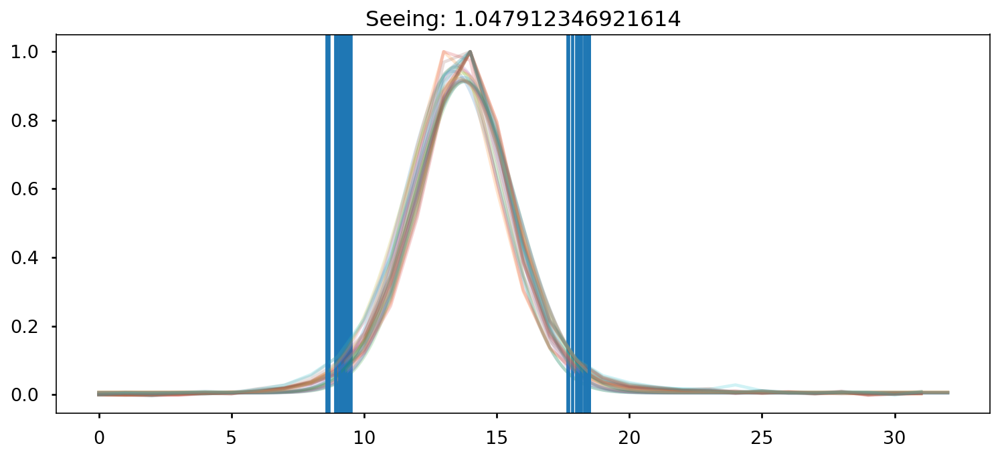

Mediana espectro estrella:  46.27498
Mediana fluxcal:  3.787630245958622e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.33137172]
calib Data:  [0.980927]
Fcalib :  [3.90163716e-18 3.90124815e-18 3.90085934e-18 ... 4.72374711e-18
 4.72442840e-18 4.72510988e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0209/obj_clean006_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0209
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0209/obj_clean006_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0209
mask2_1


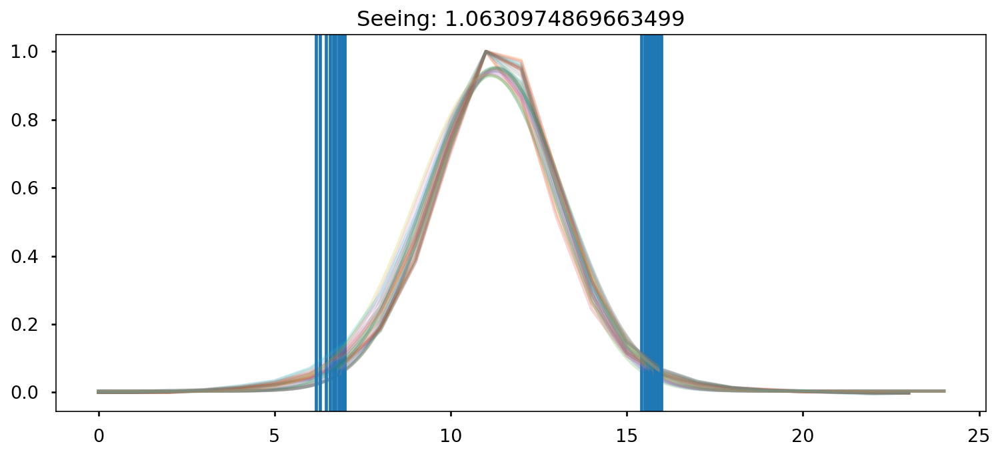

Mediana espectro estrella:  119.22109
Mediana fluxcal:  3.55431971919329e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.35247891]
calib Data:  [0.97312261]


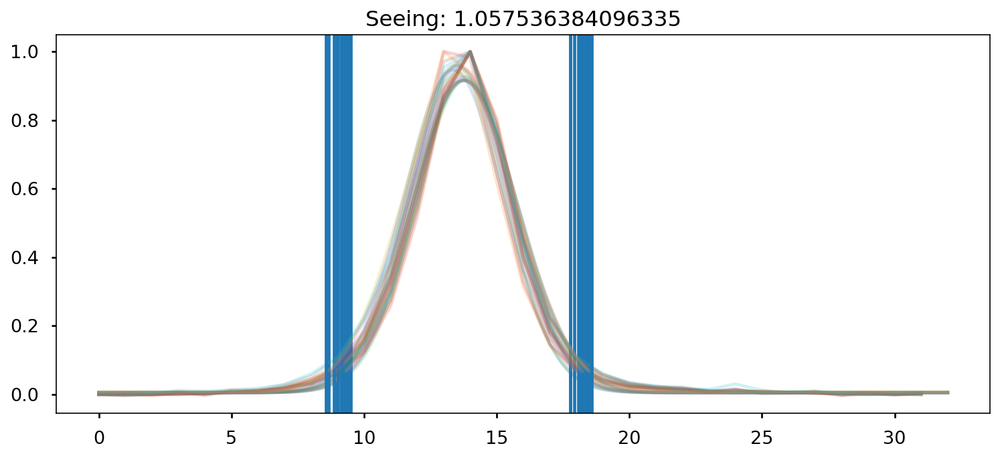

Mediana espectro estrella:  46.85494
Mediana fluxcal:  3.745450188193453e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.33393596]
calib Data:  [0.98324645]
Fcalib :  [3.85524092e-18 3.85486218e-18 3.85448362e-18 ... 4.65374330e-18
 4.65440593e-18 4.65506875e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0209/obj_clean007_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0209
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0209/obj_clean007_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0209
mask2_1


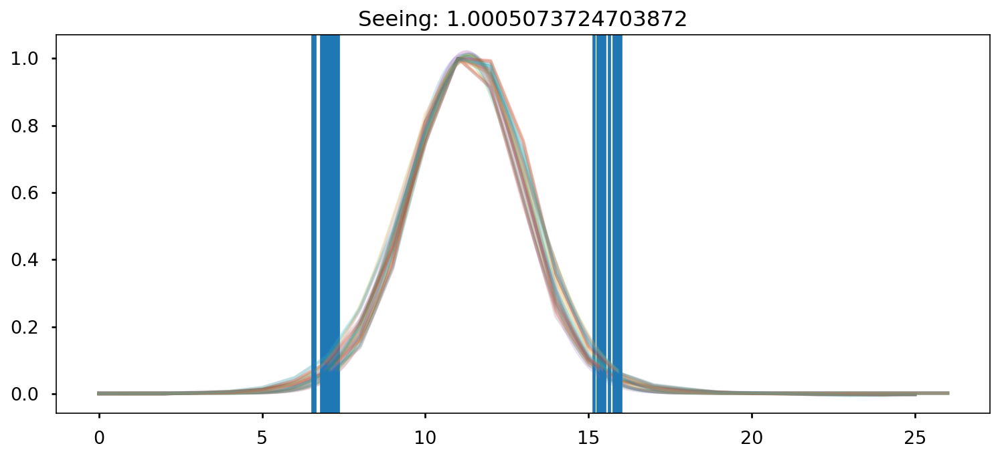

Mediana espectro estrella:  112.05818
Mediana fluxcal:  3.926880332749636e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.34984476]
calib Data:  [0.97076454]


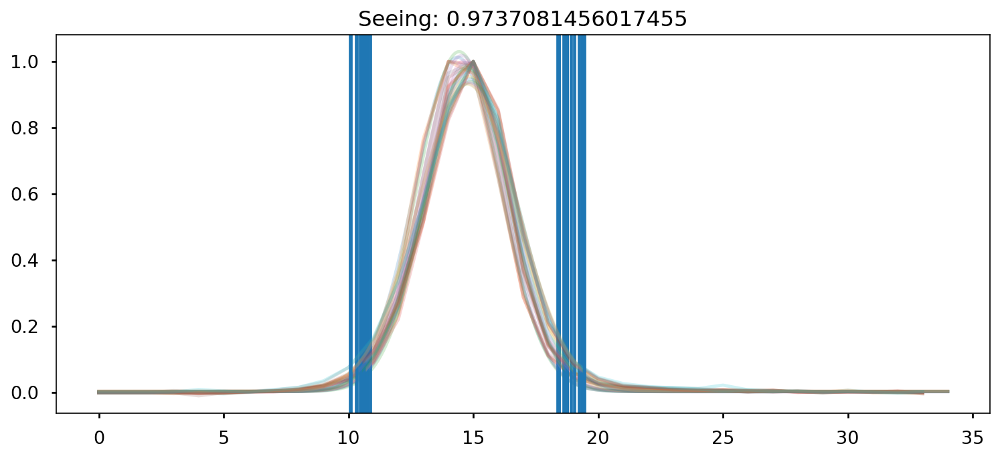

Mediana espectro estrella:  47.546127
Mediana fluxcal:  3.7174821480794055e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.34597103]
calib Data:  [0.99420608]
Fcalib :  [4.07270786e-18 4.07238167e-18 4.07205562e-18 ... 4.41899853e-18
 4.41944789e-18 4.41989739e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0211/obj_clean000_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0211
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0211/obj_clean000_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0211
mask2_1


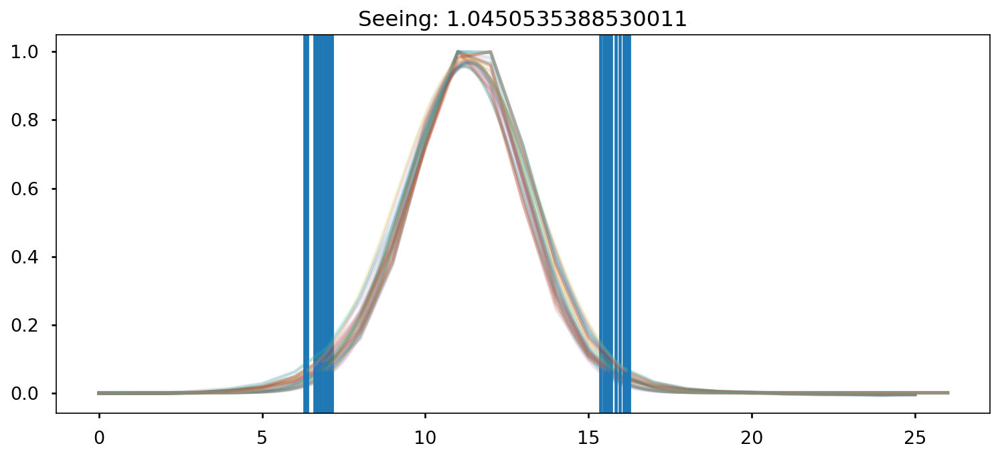

Mediana espectro estrella:  111.00704
Mediana fluxcal:  3.888393766222548e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.35292888]
calib Data:  [0.97352599]


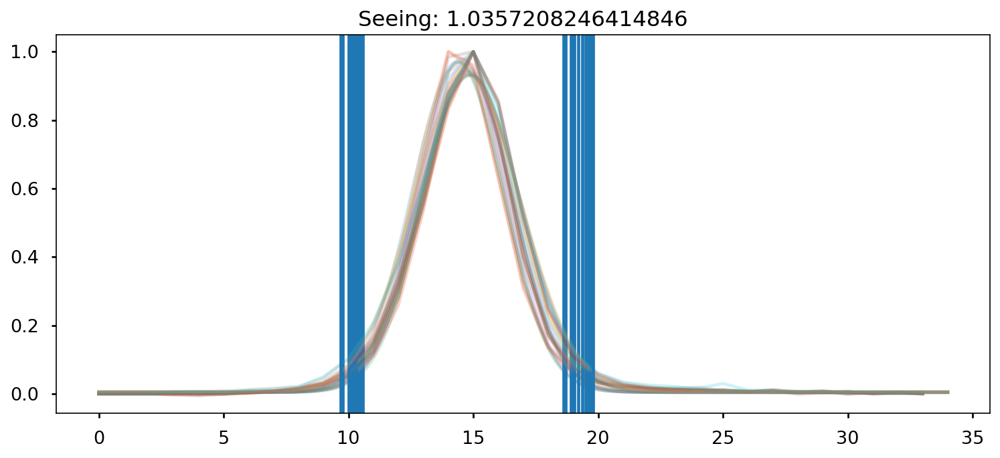

Mediana espectro estrella:  45.168
Mediana fluxcal:  3.872436048090348e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.34229577]
calib Data:  [0.99084634]
Fcalib :  [4.03096985e-18 4.03062492e-18 4.03028017e-18 ... 4.96046076e-18
 4.96113613e-18 4.96181167e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0211/obj_clean001_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0211
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0211/obj_clean001_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0211
mask2_1


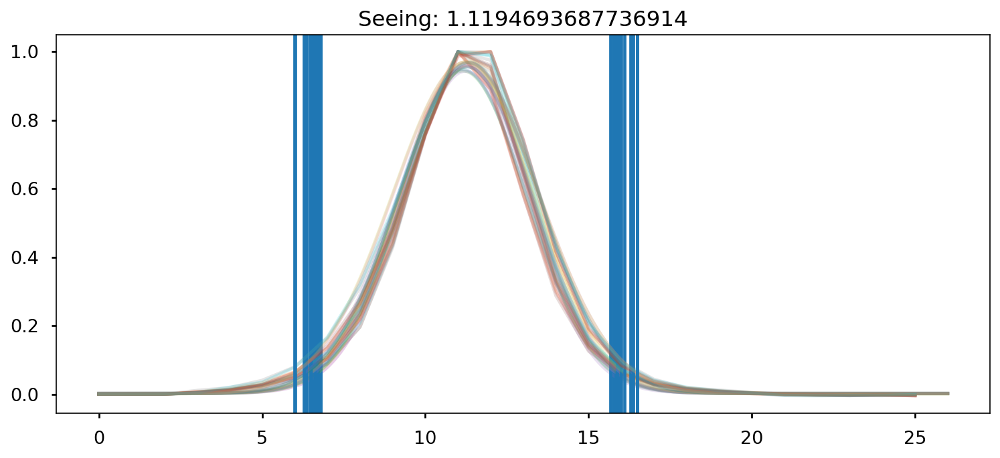

Mediana espectro estrella:  109.69578
Mediana fluxcal:  3.9065908457065895e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.36767424]
calib Data:  [0.98683762]


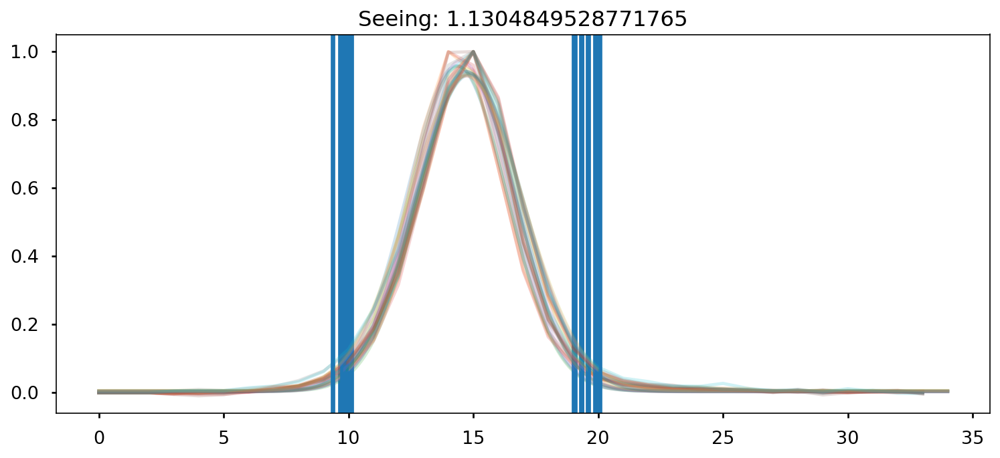

Mediana espectro estrella:  45.118034
Mediana fluxcal:  3.8500605321513844e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.34646505]
calib Data:  [0.99465855]
Fcalib :  [4.08118765e-18 4.08082600e-18 4.08046451e-18 ... 4.80544776e-18
 4.80606693e-18 4.80668627e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0211/obj_clean002_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0211
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0211/obj_clean002_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0211
mask2_1


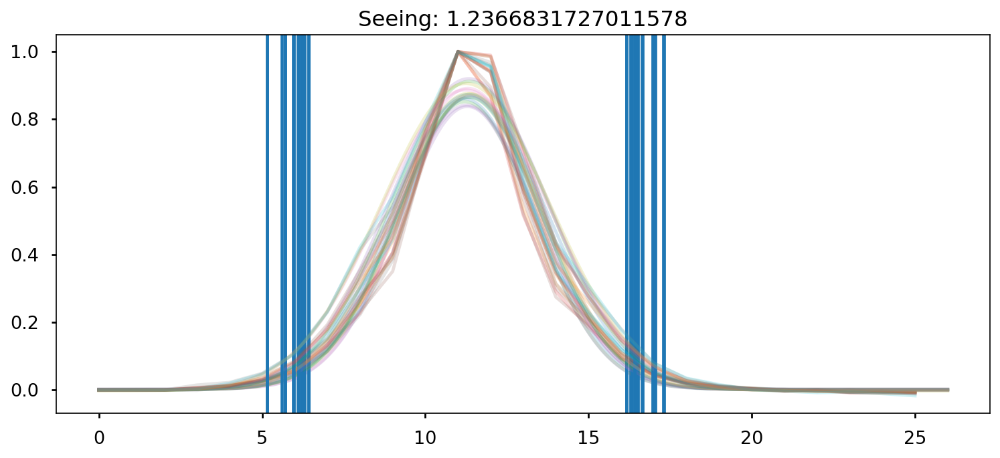

Mediana espectro estrella:  52.179703
Mediana fluxcal:  8.158868005251895e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.29620148]
calib Data:  [0.92396728]


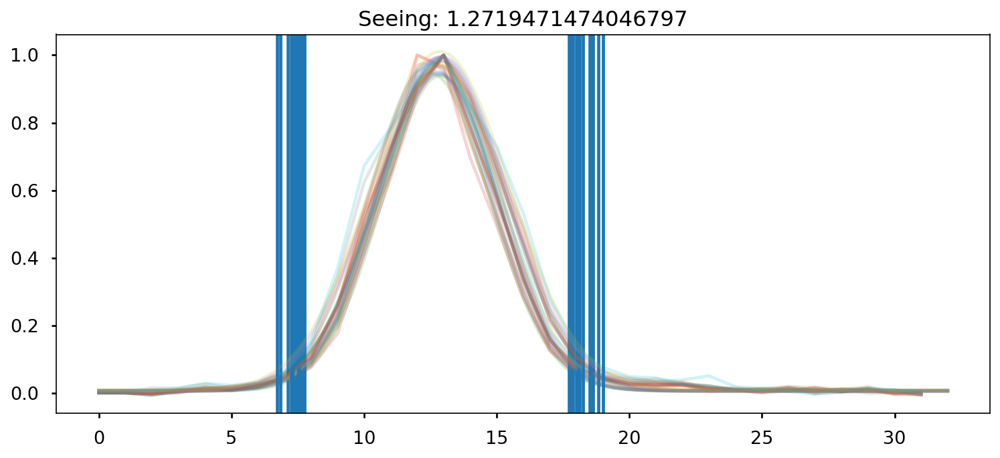

Mediana espectro estrella:  24.001163
Mediana fluxcal:  7.009855427876883e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.27604221]
calib Data:  [0.93219095]
Fcalib :  [8.64702831e-18 8.64614158e-18 8.64525514e-18 ... 8.35827127e-18
 8.35905570e-18 8.35984043e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0212/obj_clean000_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0212
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0212/obj_clean000_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0212
mask2_1


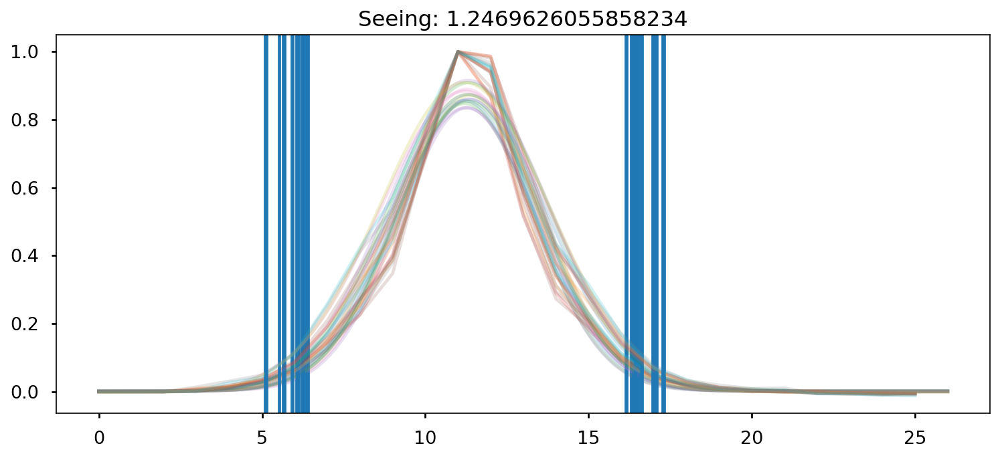

Mediana espectro estrella:  51.993
Mediana fluxcal:  8.22386813749847e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.30907781]
calib Data:  [0.93499034]


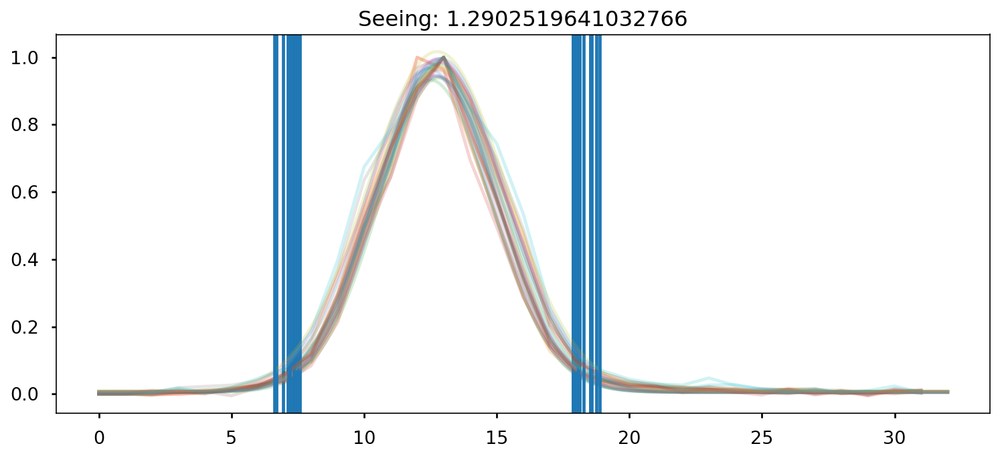

Mediana espectro estrella:  23.798676
Mediana fluxcal:  7.10153662994899e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.28892406]
calib Data:  [0.94331692]
Fcalib :  [8.71590532e-18 8.71500314e-18 8.71410126e-18 ... 8.50884202e-18
 8.50967095e-18 8.51050018e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0212/obj_clean001_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0212
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0212/obj_clean001_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0212
mask2_1


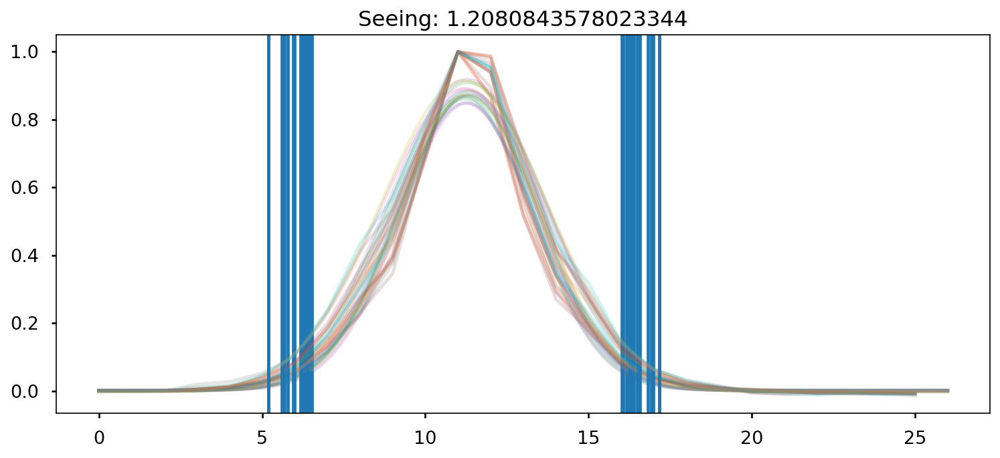

Mediana espectro estrella:  51.23621
Mediana fluxcal:  8.345216785759202e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.31304085]
calib Data:  [0.93840938]


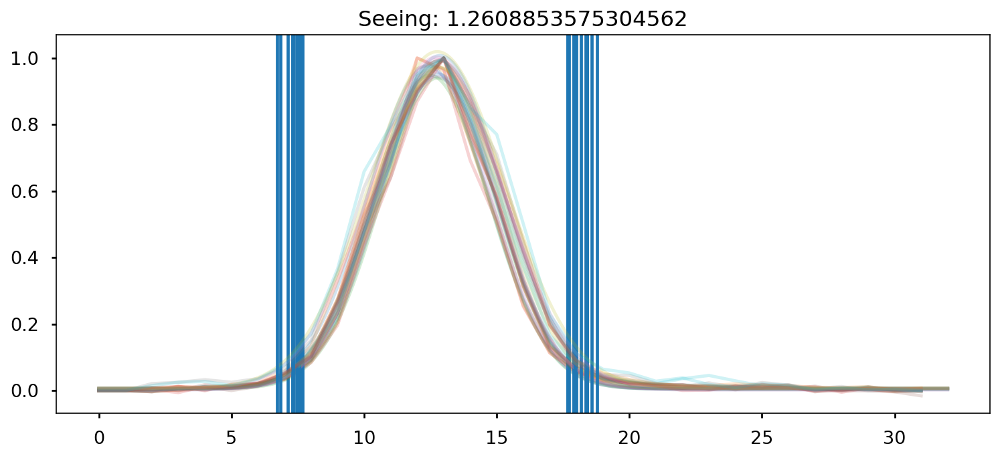

Mediana espectro estrella:  23.237629
Mediana fluxcal:  7.231918876607666e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.30115645]
calib Data:  [0.95400485]
Fcalib :  [8.85985760e-18 8.85895549e-18 8.85805369e-18 ... 8.64907280e-18
 8.64990033e-18 8.65072816e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0212/obj_clean002_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0212
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0212/obj_clean002_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0212
mask2_1


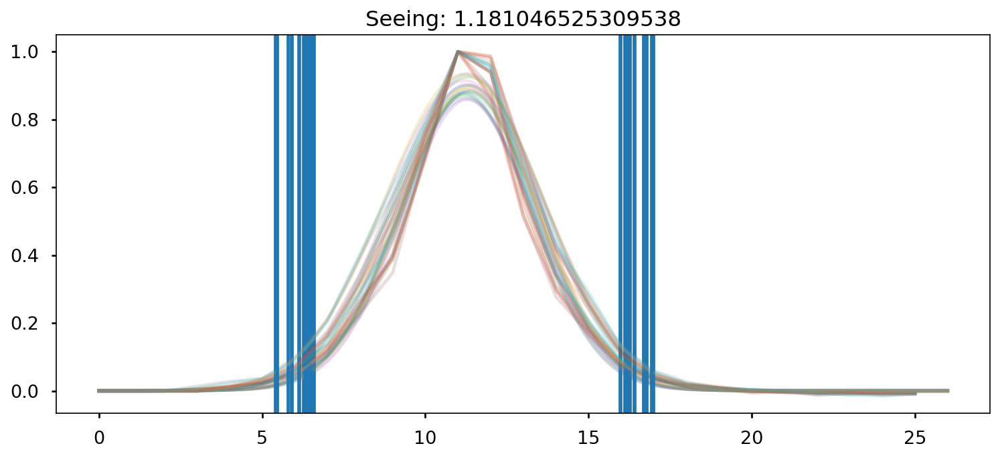

Mediana espectro estrella:  50.618755
Mediana fluxcal:  8.458627523620395e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.3138314]
calib Data:  [0.9390929]


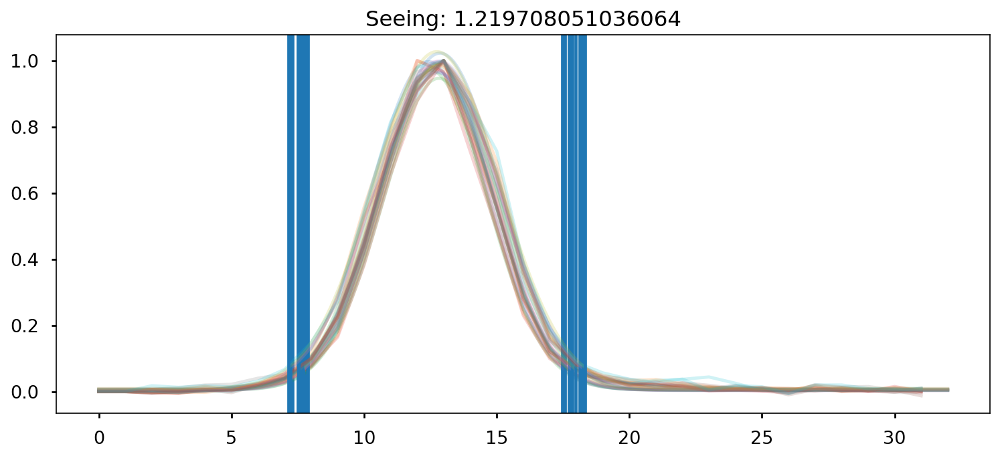

Mediana espectro estrella:  23.454296
Mediana fluxcal:  7.184570573695465e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.3048575]
calib Data:  [0.95726239]
Fcalib :  [8.83574087e-18 8.83496455e-18 8.83418848e-18 ... 8.41956627e-18
 8.42019497e-18 8.42082393e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0212/obj_clean003_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0212
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0212/obj_clean003_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0212
mask2_1


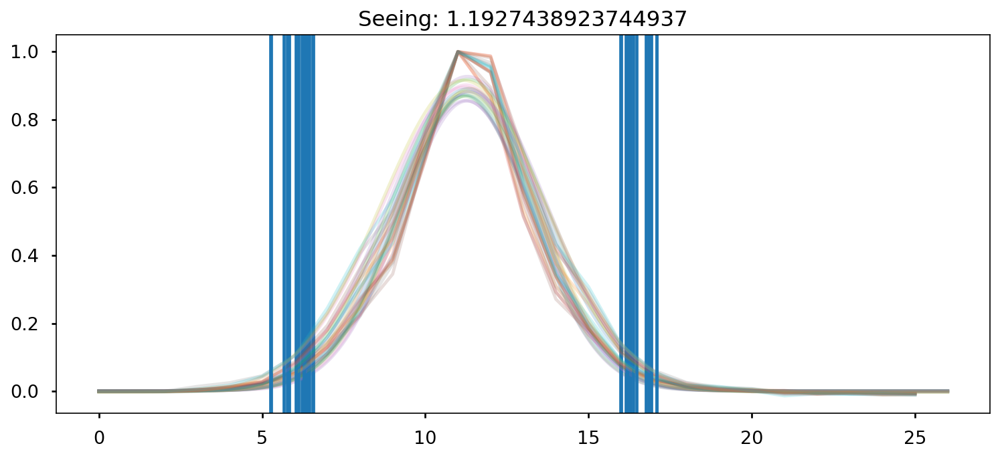

Mediana espectro estrella:  51.0568
Mediana fluxcal:  8.073049429795185e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.36500671]
calib Data:  [0.98441605]


<ipython-input-21-0b12572c6f73>:34: RuntimeWarning: invalid value encountered in power
  transmission_function = np.interp(wave-alpha, wave, trans_std)**beta


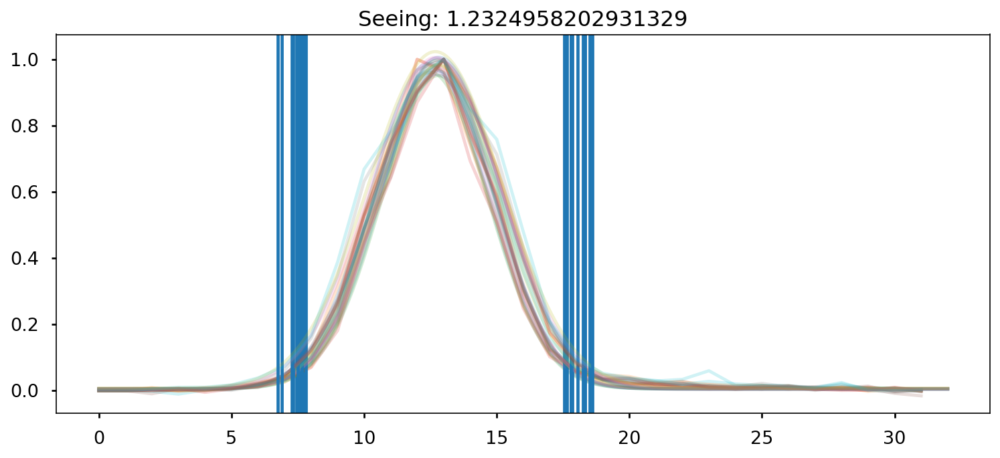

Mediana espectro estrella:  23.073917
Mediana fluxcal:  7.317012550196067e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.28343718]
calib Data:  [0.93856179]
Fcalib :  [9.42911467e-18 9.42736777e-18 9.42562154e-18 ... 1.00351881e-17
 1.00371510e-17 1.00391146e-17]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0212/obj_clean004_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0212
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0212/obj_clean004_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0212
mask2_1


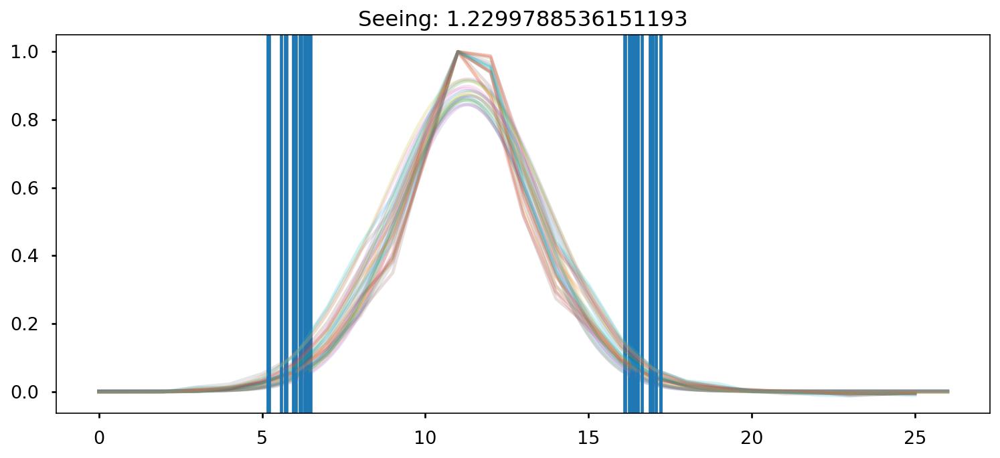

Mediana espectro estrella:  52.15793
Mediana fluxcal:  9.036063091226536e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.20294901]
calib Data:  [0.84792141]


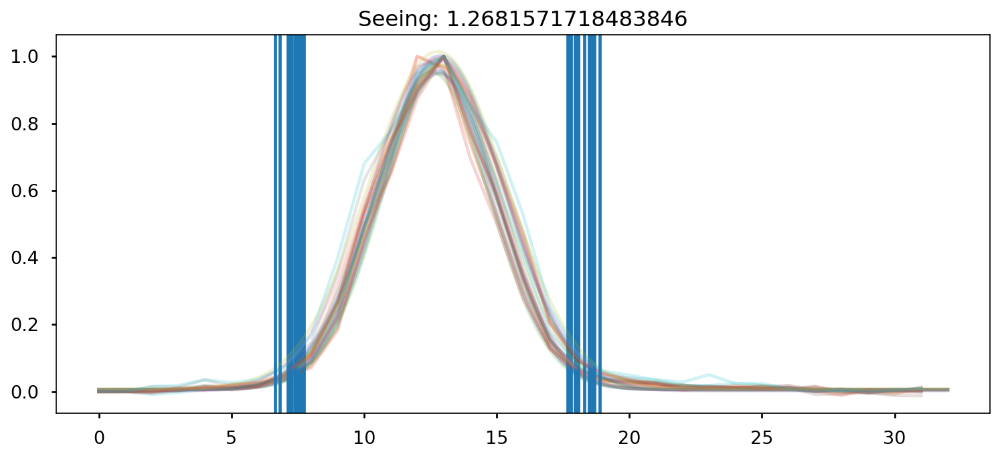

Mediana espectro estrella:  23.929028
Mediana fluxcal:  7.073207892637762e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.30147123]
calib Data:  [0.95428147]
Fcalib :  [7.42861085e-18 7.42977417e-18 7.43093696e-18 ... 5.48962809e-18
 5.48777530e-18 5.48592198e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0212/obj_clean005_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0212
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0212/obj_clean005_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0212
mask2_1


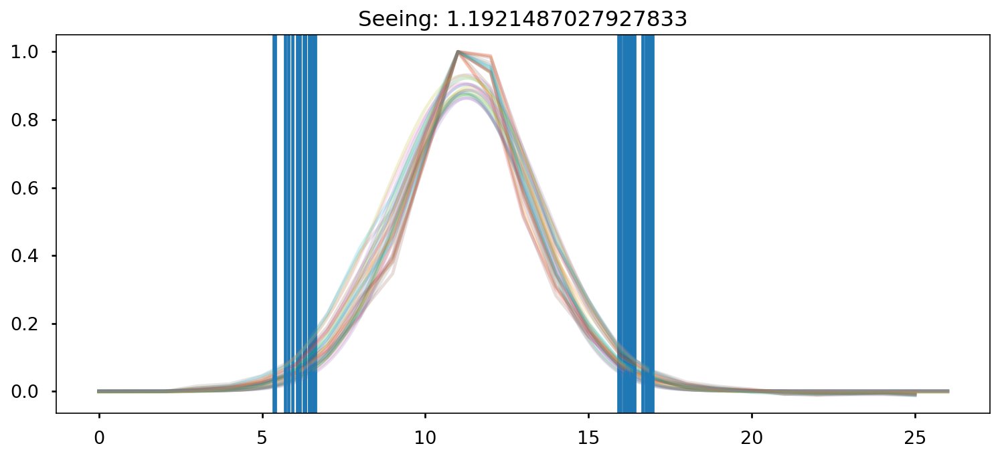

Mediana espectro estrella:  50.88233
Mediana fluxcal:  8.53802147143031e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.29568638]
calib Data:  [0.92352903]


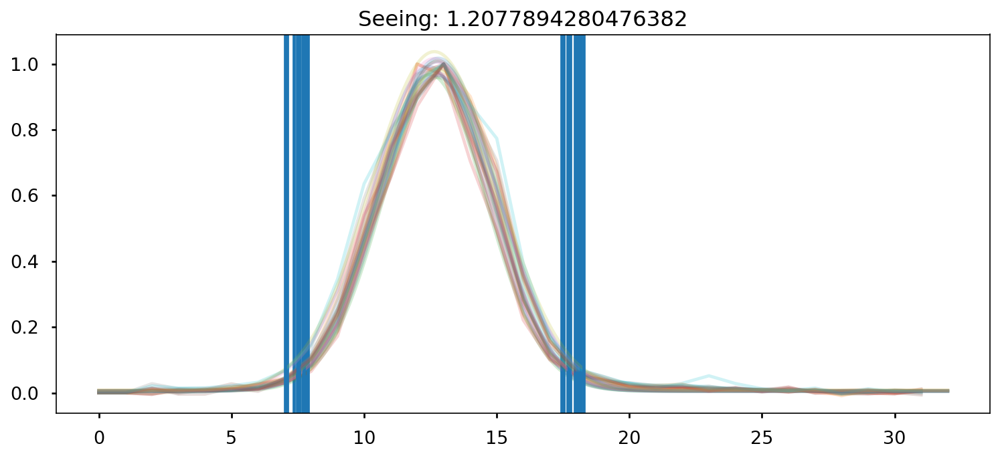

Mediana espectro estrella:  23.067581
Mediana fluxcal:  7.427006169682957e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.30906153]
calib Data:  [0.96097616]
Fcalib :  [8.72277680e-18 8.72220602e-18 8.72163541e-18 ... 8.36115403e-18
 8.36159650e-18 8.36203916e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0212/obj_clean006_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0212
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0212/obj_clean006_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0212
mask2_1


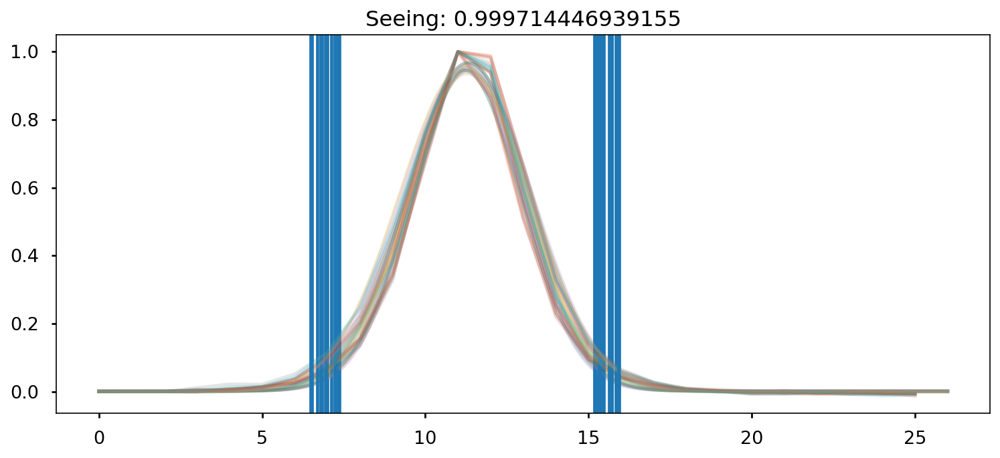

Mediana espectro estrella:  42.843315
Mediana fluxcal:  9.86668051398596e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.32397418]
calib Data:  [0.94790687]


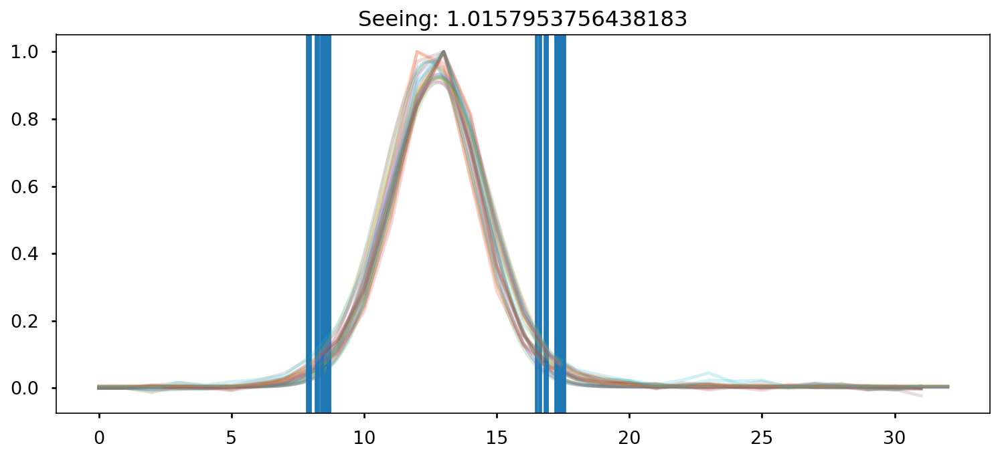

Mediana espectro estrella:  15.109579
Mediana fluxcal:  1.171333296292181e-17
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31428603]
calib Data:  [0.96561146]
Fcalib :  [1.17865664e-17 1.17849050e-17 1.17832445e-17 ... 1.48132297e-17
 1.48159672e-17 1.48187055e-17]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0212/obj_clean007_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0212
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0212/obj_clean007_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0212
mask2_1


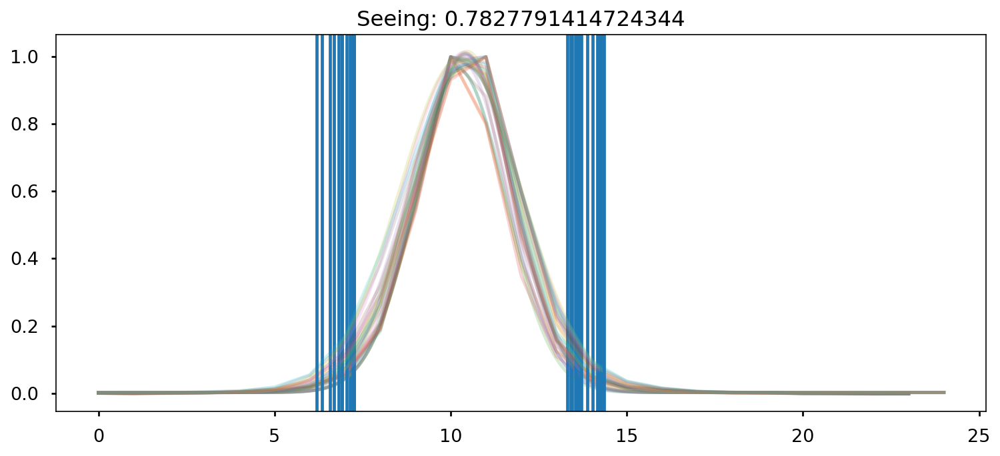

Mediana espectro estrella:  124.4185
Mediana fluxcal:  3.533006670568388e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.32600463]
calib Data:  [0.94968123]


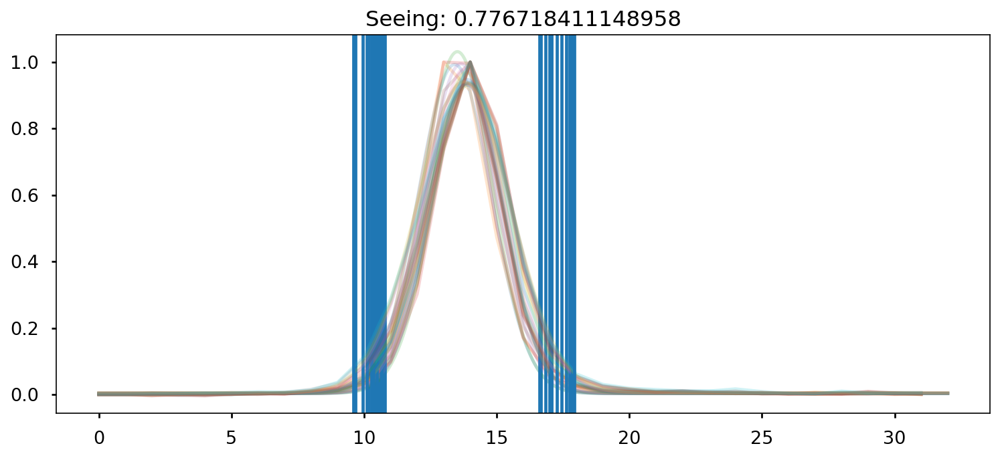

Mediana espectro estrella:  50.050858
Mediana fluxcal:  3.543884652816732e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.33333067]
calib Data:  [0.98269845]
Fcalib :  [4.07309390e-18 4.07218609e-18 4.07127871e-18 ... 5.76815374e-18
 5.76966424e-18 5.77117516e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0220/obj_clean000_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0220
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0220/obj_clean000_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0220
mask2_1


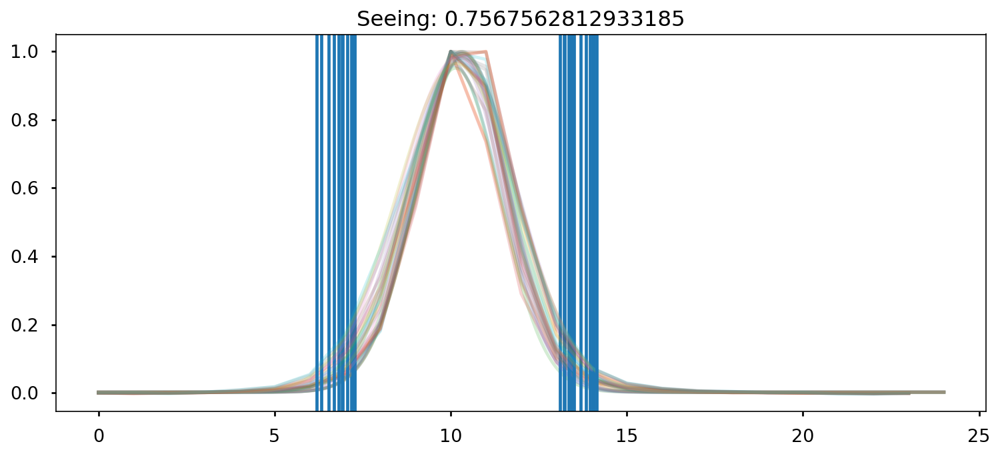

Mediana espectro estrella:  127.33458
Mediana fluxcal:  3.5122461732215885e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.30579046]
calib Data:  [0.93216369]


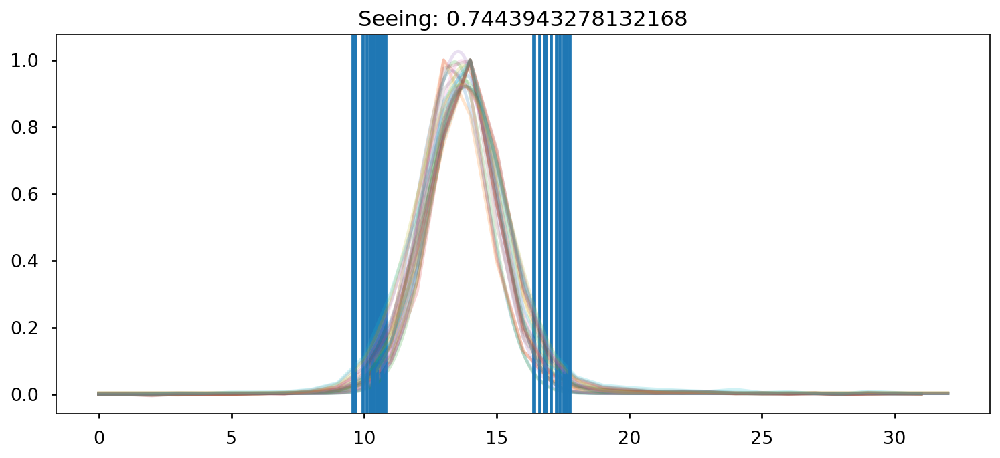

Mediana espectro estrella:  50.674248
Mediana fluxcal:  3.4957834209102346e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.34022458]
calib Data:  [0.98895797]
Fcalib :  [4.13935074e-18 4.13832925e-18 4.13730823e-18 ... 5.88949661e-18
 5.89114041e-18 5.89278468e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0220/obj_clean001_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0220
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0220/obj_clean001_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0220
mask2_1


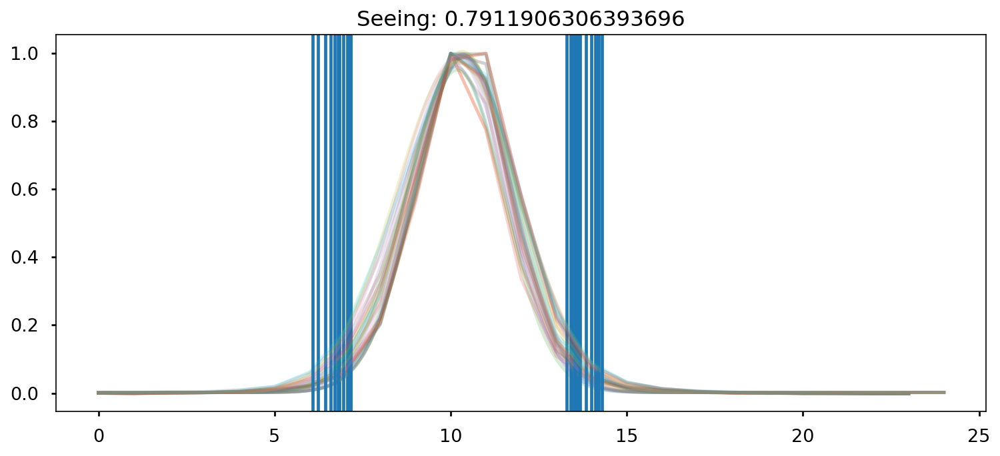

Mediana espectro estrella:  123.698524
Mediana fluxcal:  3.537699503187117e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.32231137]
calib Data:  [0.94645626]


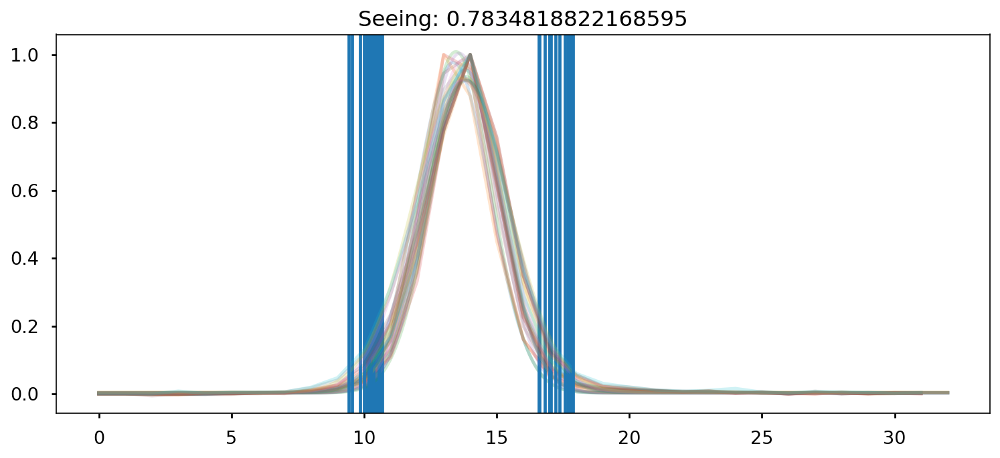

Mediana espectro estrella:  49.391724
Mediana fluxcal:  3.5798901887167916e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.34186992]
calib Data:  [0.99045778]
Fcalib :  [4.07006182e-18 4.06916244e-18 4.06826350e-18 ... 5.84243067e-18
 5.84396021e-18 5.84549018e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0220/obj_clean002_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0220
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0220/obj_clean002_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0220
mask2_1


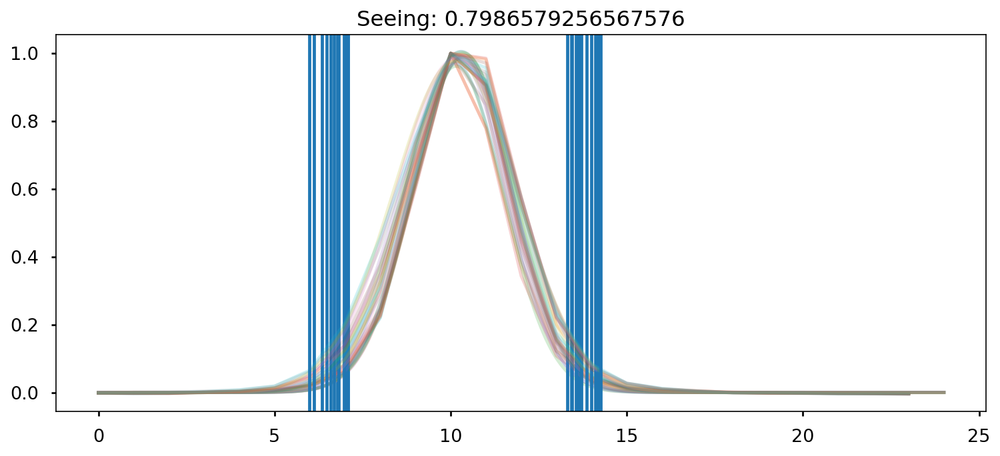

Mediana espectro estrella:  123.79976
Mediana fluxcal:  3.5427112190208405e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.3199105]
calib Data:  [0.94436569]


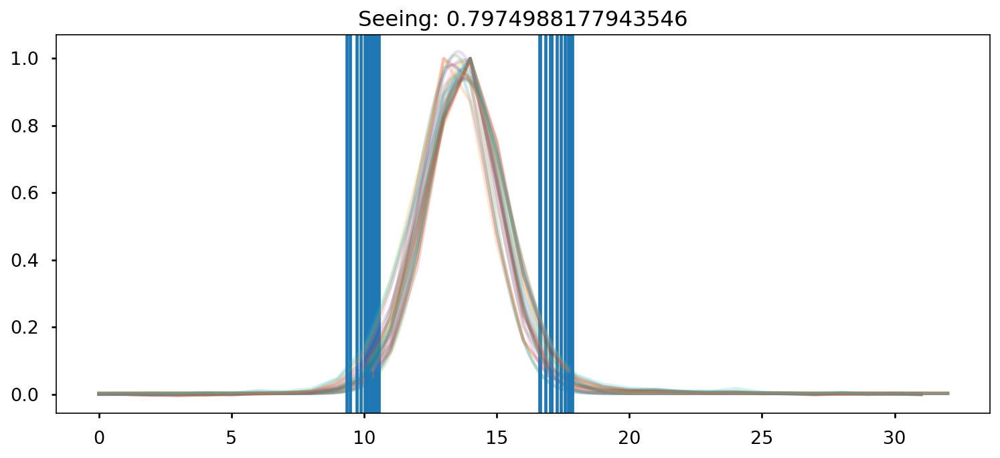

Mediana espectro estrella:  49.03961
Mediana fluxcal:  3.612469626797183e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.34204519]
calib Data:  [0.99061768]
Fcalib :  [4.10288036e-18 4.10195424e-18 4.10102858e-18 ... 5.93469179e-18
 5.93626920e-18 5.93784705e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0220/obj_clean003_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0220
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0220/obj_clean003_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0220
mask2_1


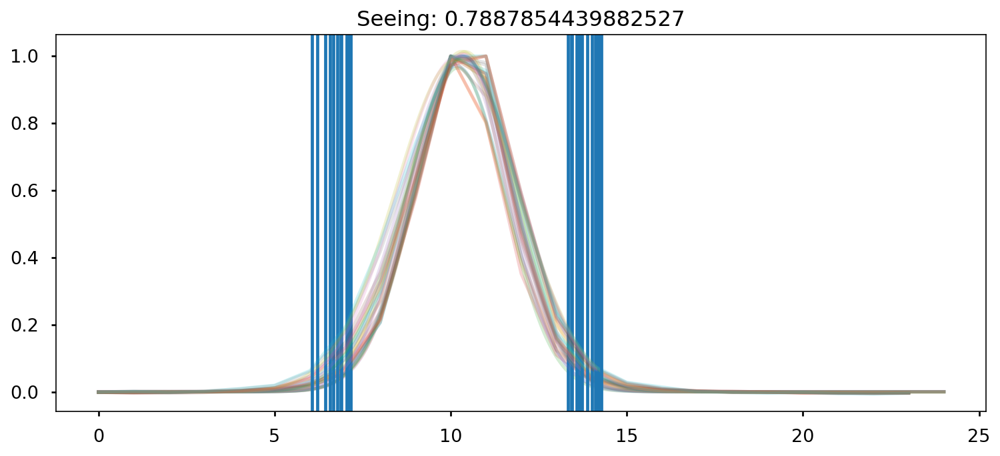

Mediana espectro estrella:  124.84964
Mediana fluxcal:  3.520320310606146e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.31763177]
calib Data:  [0.94238574]


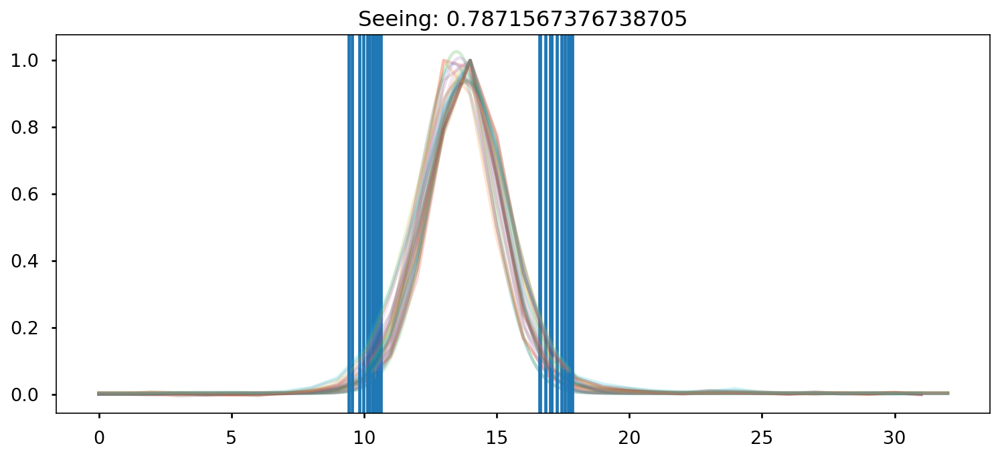

Mediana espectro estrella:  49.633102
Mediana fluxcal:  3.555031081000398e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.34563199]
calib Data:  [0.99389567]
Fcalib :  [4.04764820e-18 4.04674618e-18 4.04584460e-18 ... 5.84258767e-18
 5.84412787e-18 5.84566851e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0220/obj_clean004_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0220
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0220/obj_clean004_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0220
mask2_1


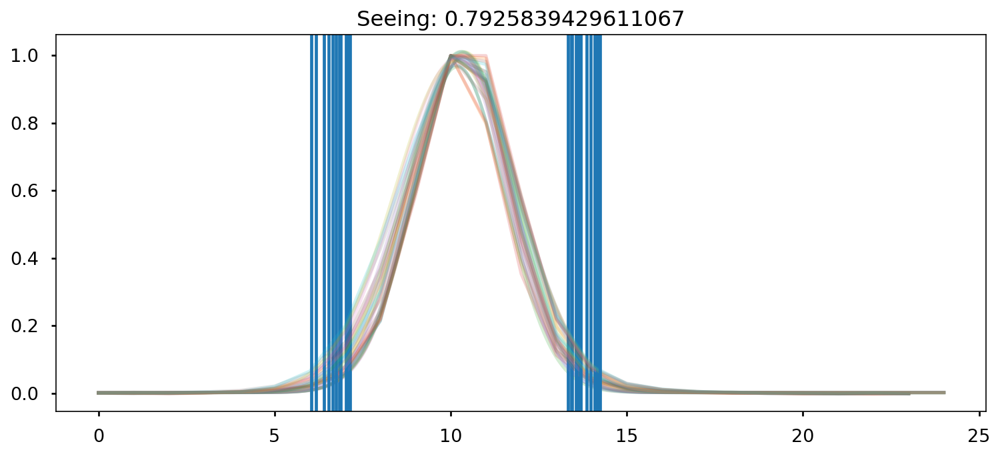

Mediana espectro estrella:  126.77603
Mediana fluxcal:  3.4645618130893117e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.32494285]
calib Data:  [0.94875296]


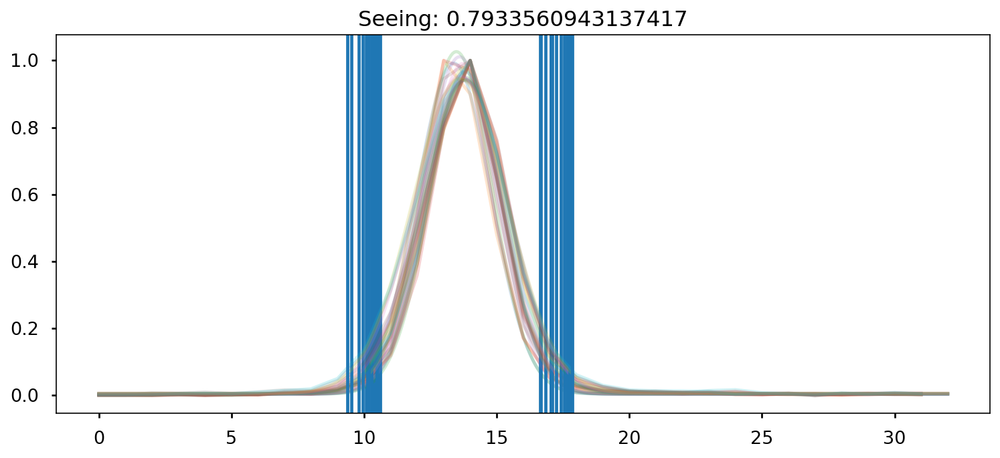

Mediana espectro estrella:  50.059708
Mediana fluxcal:  3.5259635384485055e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.34658698]
calib Data:  [0.99477026]
Fcalib :  [3.96356473e-18 3.96270556e-18 3.96184682e-18 ... 5.76013425e-18
 5.76163216e-18 5.76313049e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0220/obj_clean005_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0220
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0220/obj_clean005_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0220
mask2_1


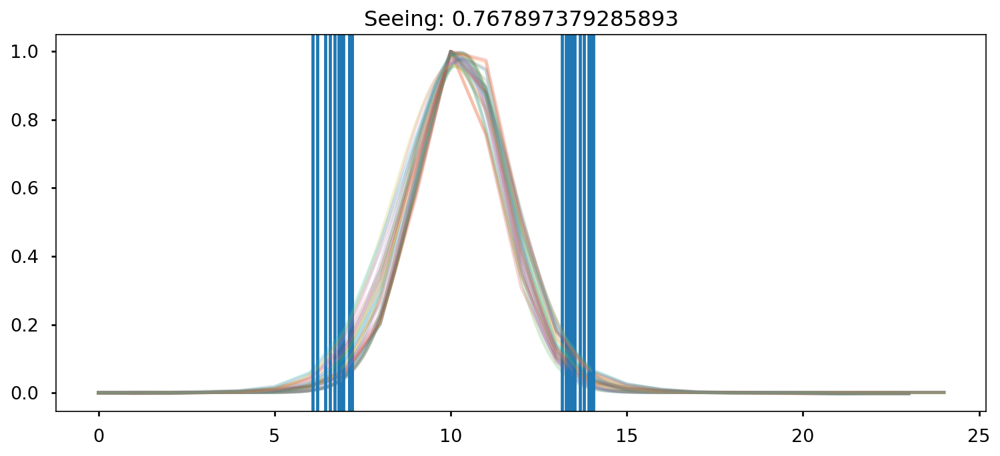

Mediana espectro estrella:  126.59935
Mediana fluxcal:  3.4653385333300142e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.3248528]
calib Data:  [0.94867427]


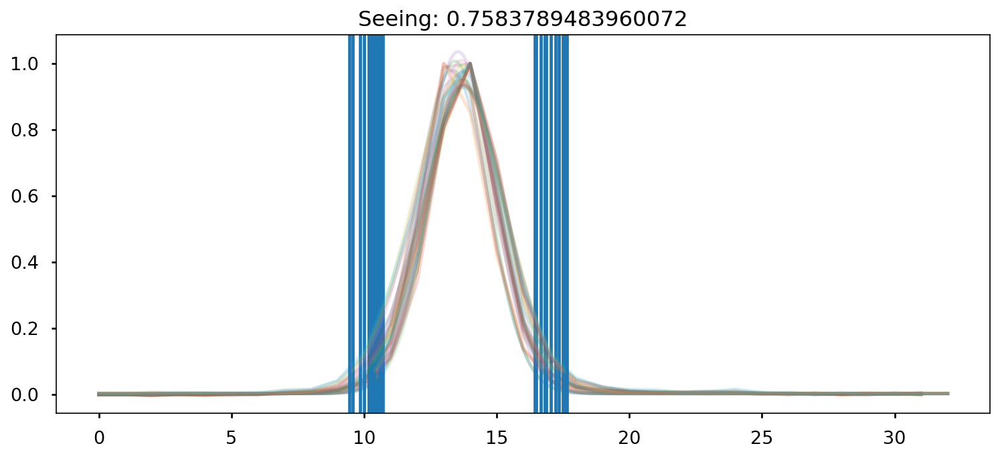

Mediana espectro estrella:  50.650105
Mediana fluxcal:  3.4965276122297244e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.33250637]
calib Data:  [0.98195265]
Fcalib :  [3.94443798e-18 3.94358191e-18 3.94272627e-18 ... 5.75207997e-18
 5.75357871e-18 5.75507787e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0220/obj_clean006_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0220
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0220/obj_clean006_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0220
mask2_1


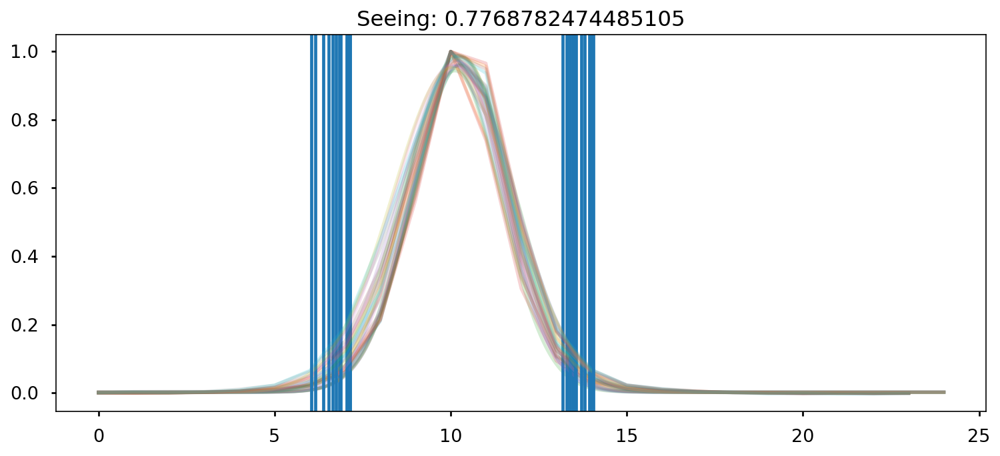

Mediana espectro estrella:  125.60521
Mediana fluxcal:  3.4959980753866496e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.32056463]
calib Data:  [0.94493482]


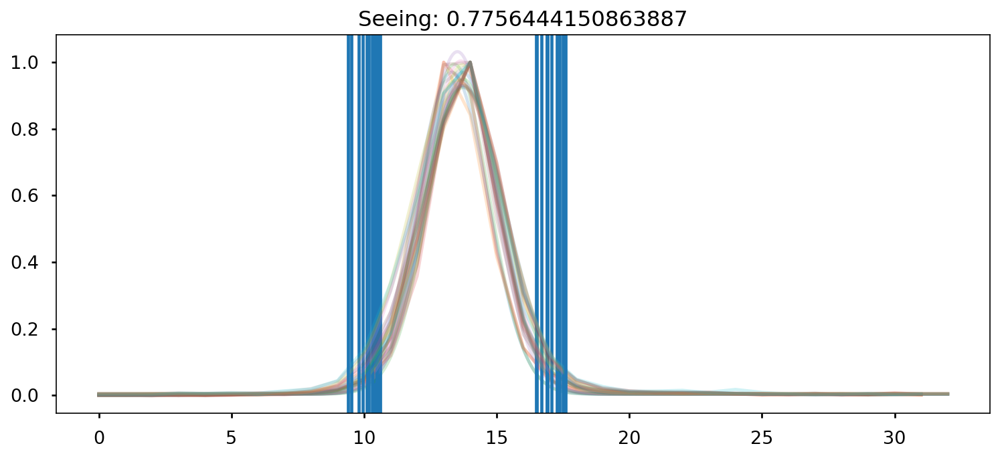

Mediana espectro estrella:  50.029743
Mediana fluxcal:  3.547461881027048e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.33383501]
calib Data:  [0.98315503]
Fcalib :  [4.01957296e-18 4.01867497e-18 4.01777742e-18 ... 5.85528247e-18
 5.85683312e-18 5.85838421e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0220/obj_clean007_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0220
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0220/obj_clean007_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0220
mask2_1


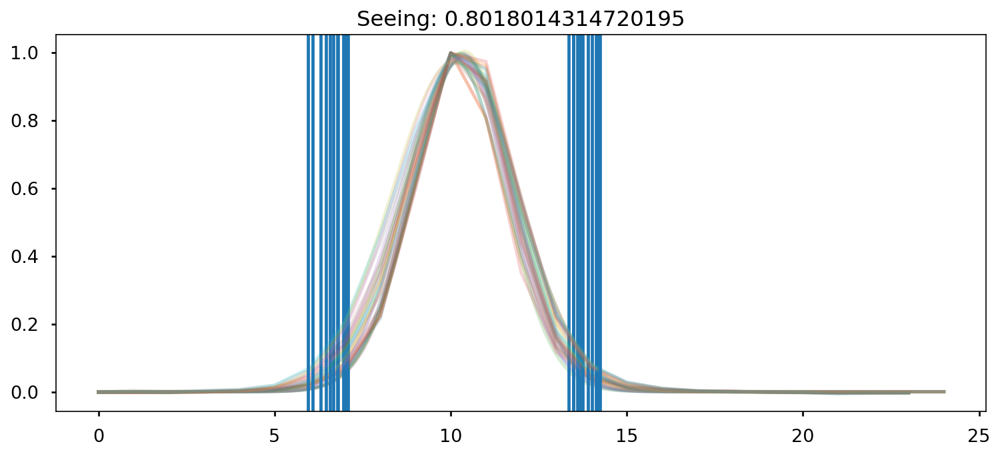

Mediana espectro estrella:  125.794495
Mediana fluxcal:  3.496225786572614e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.31986841]
calib Data:  [0.94432908]


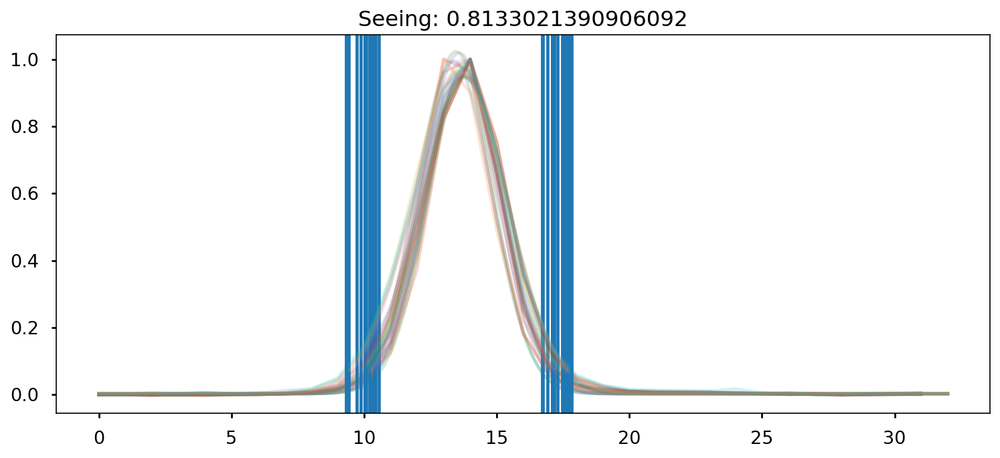

Mediana espectro estrella:  49.965973
Mediana fluxcal:  3.5420672289369285e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.33858315]
calib Data:  [0.98746397]
Fcalib :  [4.00271977e-18 4.00183248e-18 4.00094562e-18 ... 5.86305186e-18
 5.86460057e-18 5.86614971e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0220/obj_clean008_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0220
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0220/obj_clean008_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0220
mask2_1


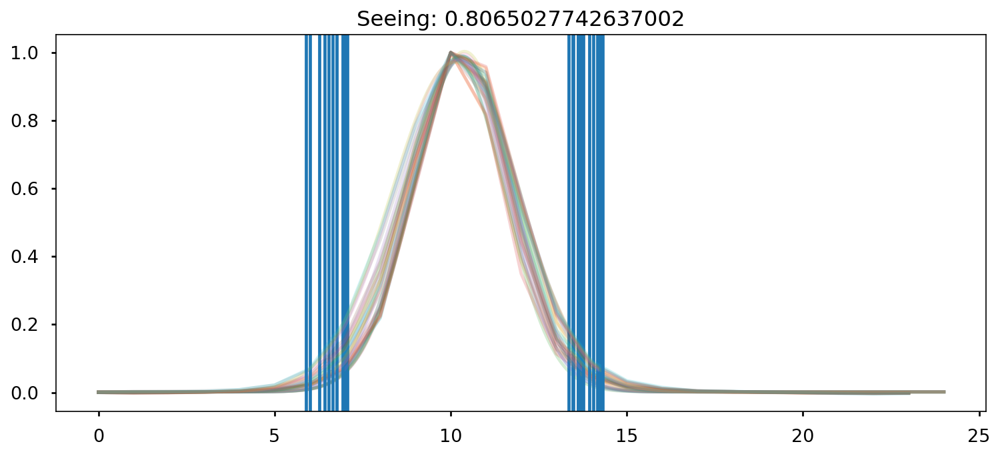

Mediana espectro estrella:  125.63991
Mediana fluxcal:  3.522975037876904e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.32228607]
calib Data:  [0.9464342]


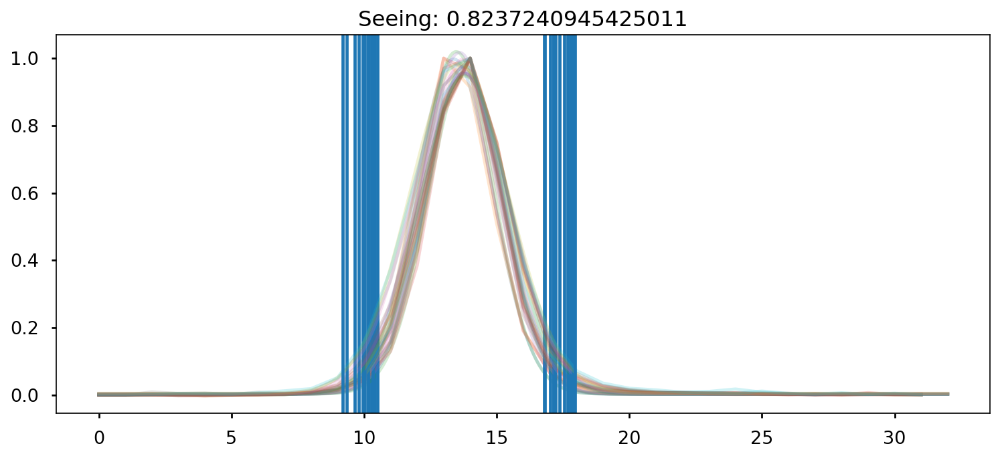

Mediana espectro estrella:  49.814056
Mediana fluxcal:  3.560037682447698e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.33926225]
calib Data:  [0.9880818]
Fcalib :  [4.05716117e-18 4.05625032e-18 4.05533991e-18 ... 5.86637299e-18
 5.86792710e-18 5.86948164e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0220/obj_clean009_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0220
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0220/obj_clean009_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0220
mask2_1


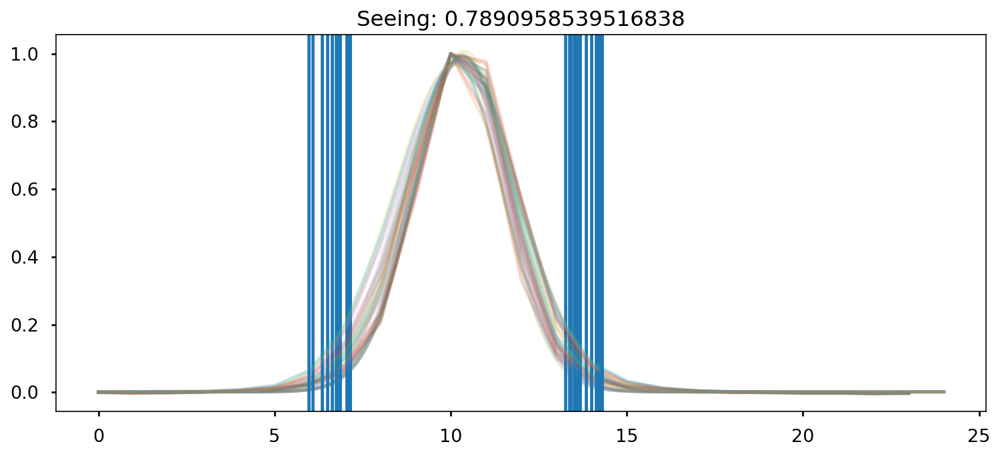

Mediana espectro estrella:  128.1488
Mediana fluxcal:  3.4582014898637697e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.31659407]
calib Data:  [0.94148548]


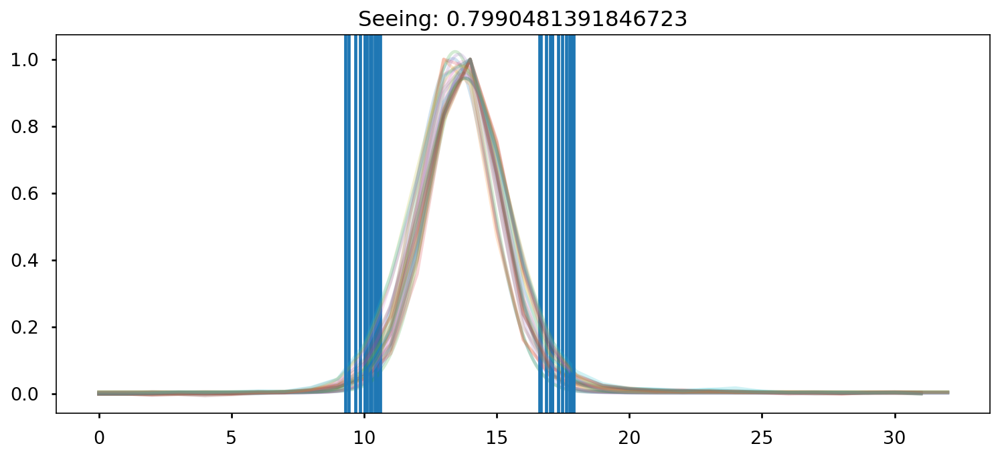

Mediana espectro estrella:  51.587692
Mediana fluxcal:  3.4460819823489076e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.34065163]
calib Data:  [0.98934703]
Fcalib :  [4.00244806e-18 4.00150054e-18 4.00055348e-18 ... 5.81718696e-18
 5.81877971e-18 5.82037291e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0220/obj_clean010_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0220
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0220/obj_clean010_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0220
mask2_1


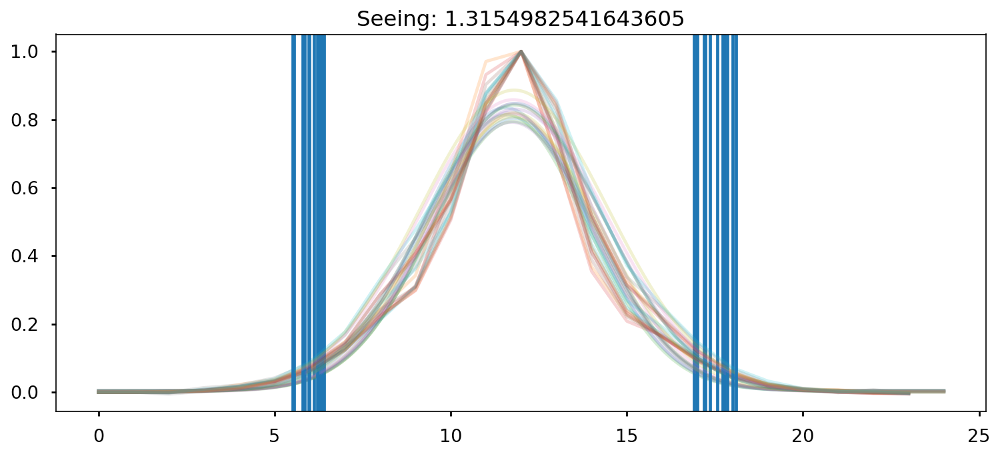

Mediana espectro estrella:  48.97123
Mediana fluxcal:  8.262873951356804e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.36273112]
calib Data:  [0.98235497]


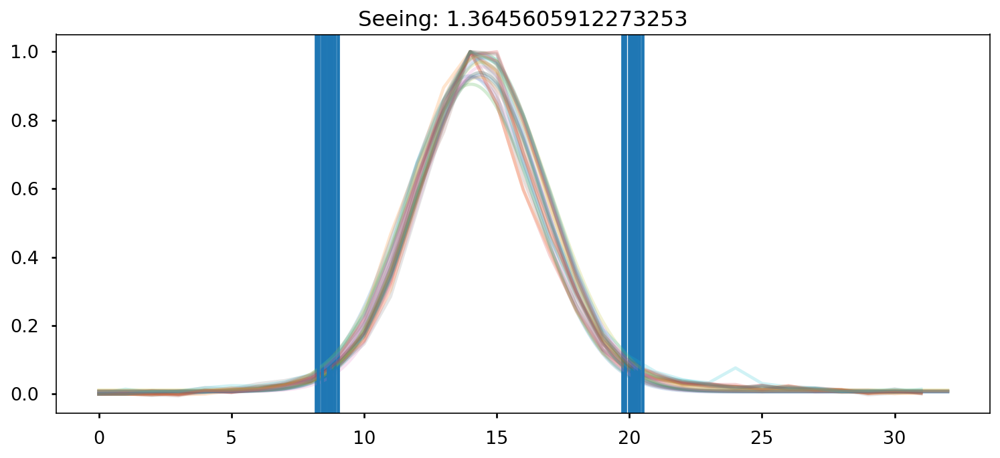

Mediana espectro estrella:  28.246508
Mediana fluxcal:  6.5819906924171926e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.24709574]
calib Data:  [0.90766648]
Fcalib :  [7.94923130e-18 7.94958492e-18 7.94993819e-18 ... 4.49095629e-18
 4.48937360e-18 4.48779056e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0315/obj_clean000_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0315
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0315/obj_clean000_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0315
mask2_1


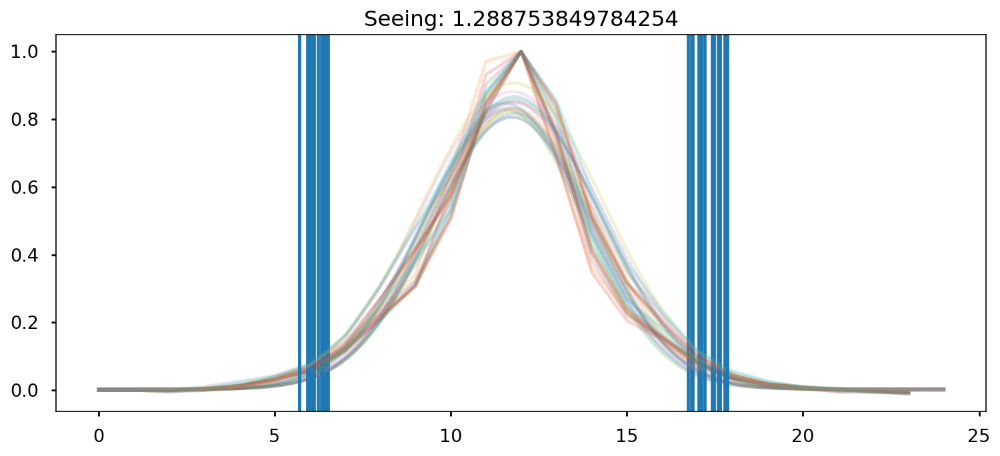

Mediana espectro estrella:  48.2126
Mediana fluxcal:  8.366799213102686e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.37337634]
calib Data:  [0.99203395]


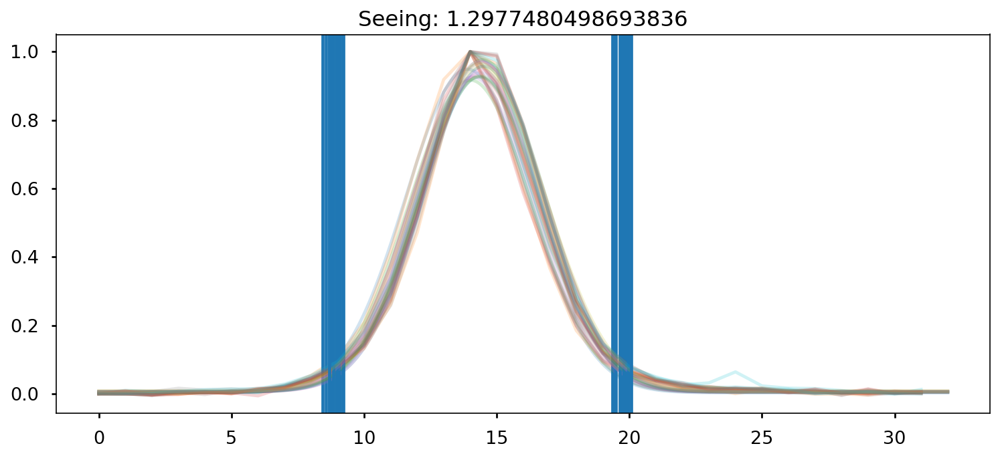

Mediana espectro estrella:  26.583817
Mediana fluxcal:  7.010062084337174e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.24389627]
calib Data:  [0.90499568]
Fcalib :  [8.16090533e-18 8.16133949e-18 8.16177328e-18 ... 4.65540454e-18
 4.65372448e-18 4.65204405e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0315/obj_clean001_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0315
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0315/obj_clean001_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0315
mask2_1


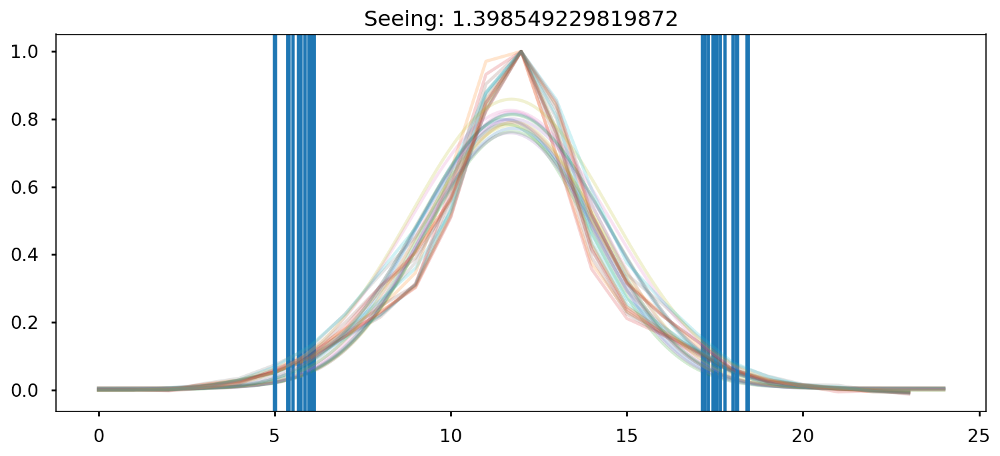

Mediana espectro estrella:  52.04389
Mediana fluxcal:  7.780802708938763e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.37561849]
calib Data:  [0.99408472]


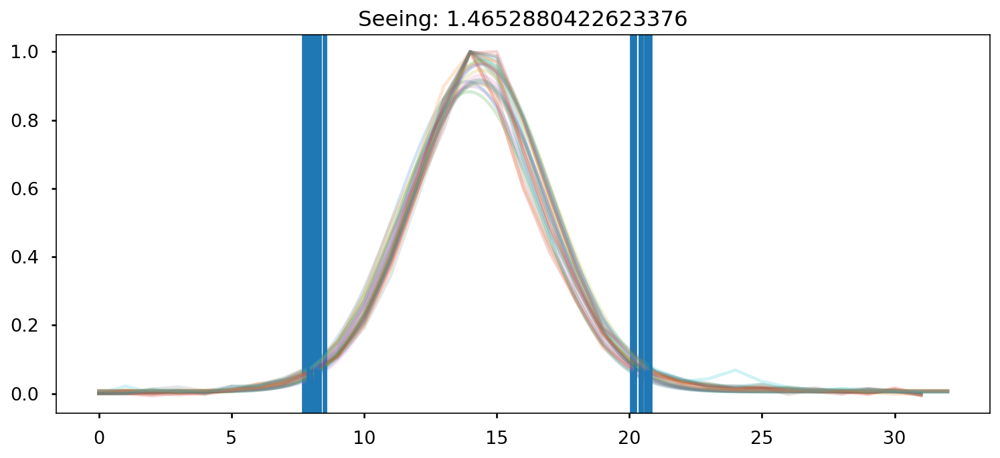

Mediana espectro estrella:  29.840618
Mediana fluxcal:  6.3348089595273355e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.2429155]
calib Data:  [0.90417855]
Fcalib :  [7.32556983e-18 7.32628359e-18 7.32699685e-18 ... 3.38987229e-18
 3.38775966e-18 3.38564653e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0315/obj_clean002_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0315
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0315/obj_clean002_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0315
mask2_1


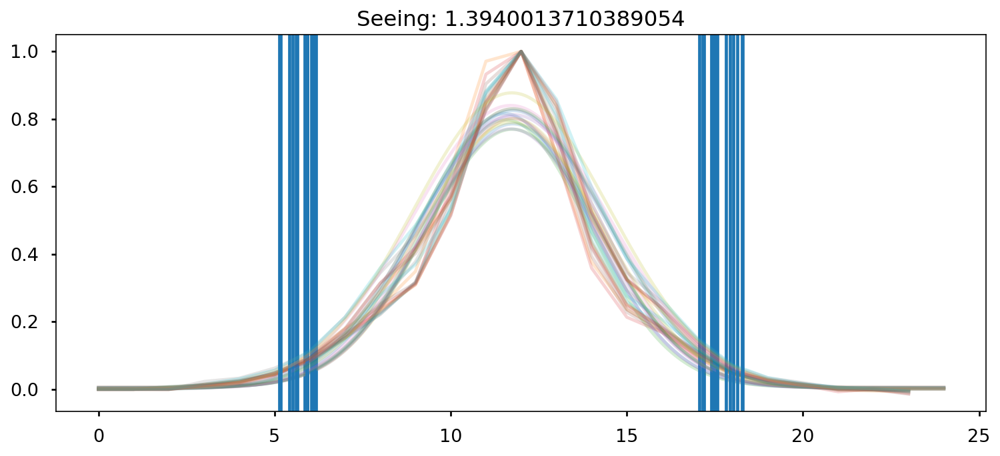

Mediana espectro estrella:  52.80213
Mediana fluxcal:  7.675748045255e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.36582745]
calib Data:  [0.98516048]


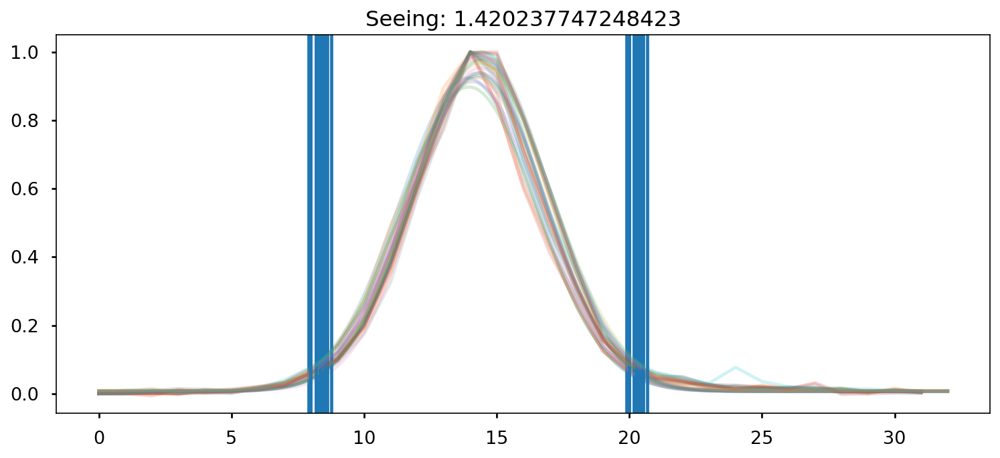

Mediana espectro estrella:  29.786457
Mediana fluxcal:  6.408925840331606e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.19935319]
calib Data:  [0.8686189]
Fcalib :  [7.25449136e-18 7.25536545e-18 7.25623895e-18 ... 2.94939536e-18
 2.94699108e-18 2.94458622e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0315/obj_clean003_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0315
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0315/obj_clean003_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0315
mask2_1


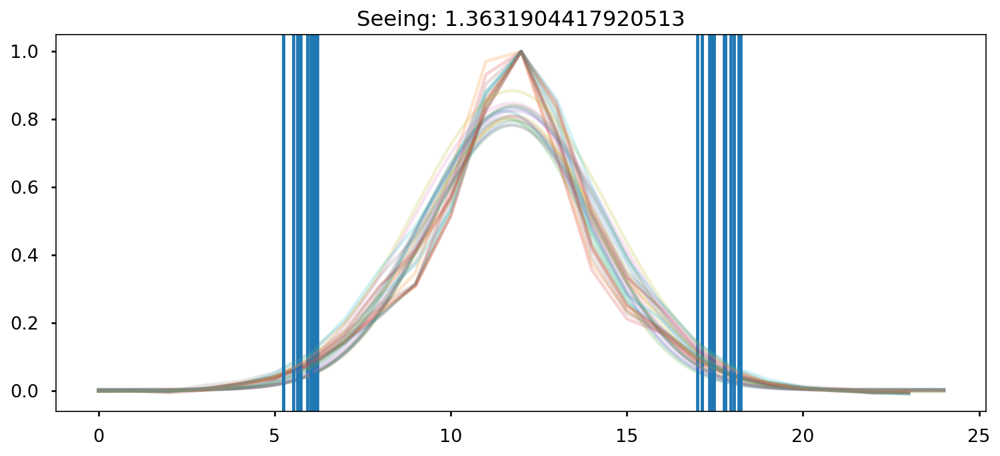

Mediana espectro estrella:  52.663475
Mediana fluxcal:  7.717537761679222e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.36489077]
calib Data:  [0.98431093]


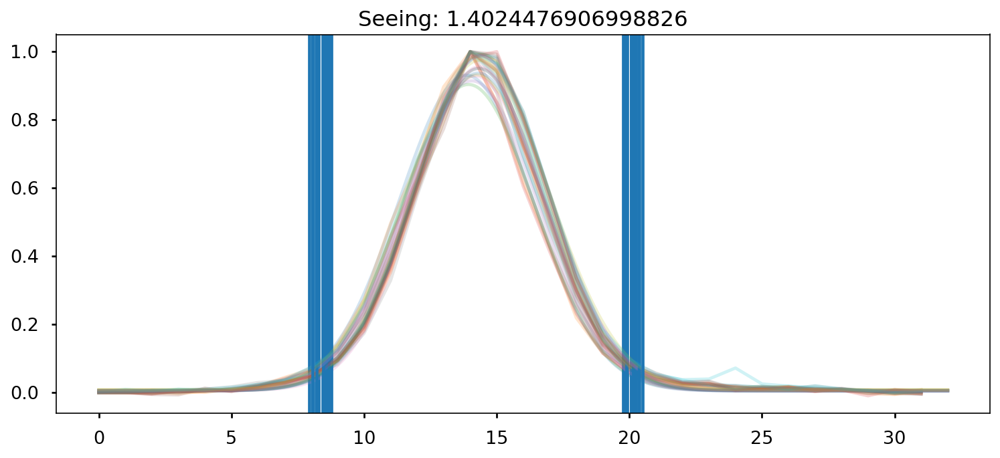

Mediana espectro estrella:  29.650177
Mediana fluxcal:  5.916677766537953e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31469658]
calib Data:  [0.96597666]
Fcalib :  [7.95855471e-18 7.95814444e-18 7.95773418e-18 ... 5.70378097e-18
 5.70339011e-18 5.70299926e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0315/obj_clean004_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0315
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0315/obj_clean004_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0315
mask2_1


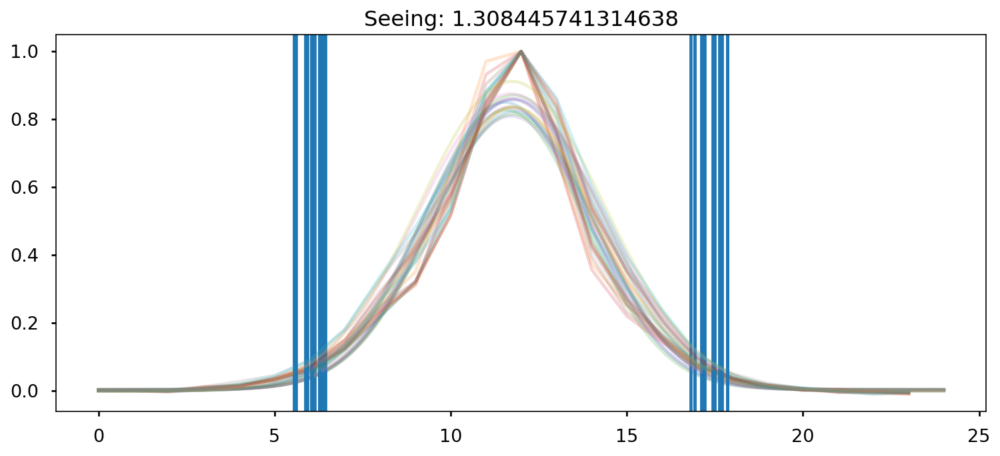

Mediana espectro estrella:  50.340015
Mediana fluxcal:  8.035519835590759e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.36130993]
calib Data:  [0.98106995]


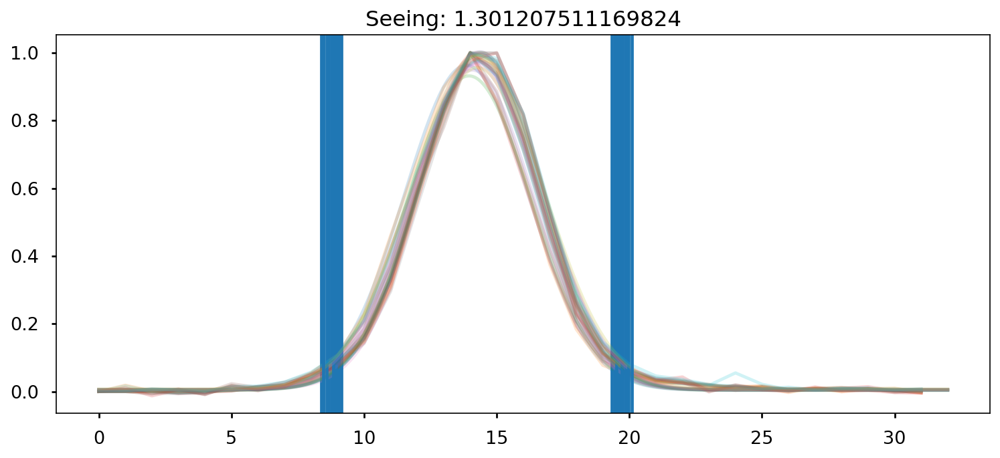

Mediana espectro estrella:  27.554745
Mediana fluxcal:  6.3726759904074585e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.30660199]
calib Data:  [0.9588017]
Fcalib :  [8.45441026e-18 8.45391647e-18 8.45342272e-18 ... 6.23435211e-18
 6.23405714e-18 6.23376220e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0315/obj_clean005_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0315
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0315/obj_clean005_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0315
mask2_1


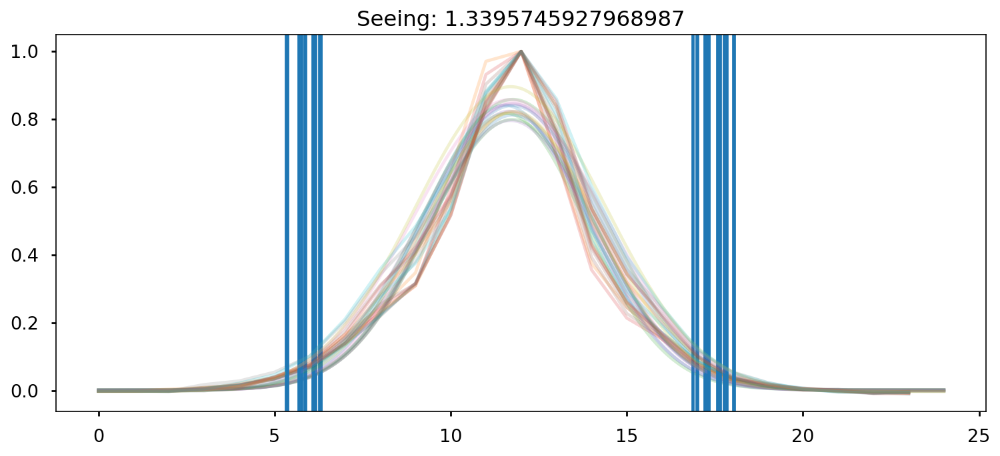

Mediana espectro estrella:  52.42943
Mediana fluxcal:  7.722151605115657e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.36016467]
calib Data:  [0.98003564]


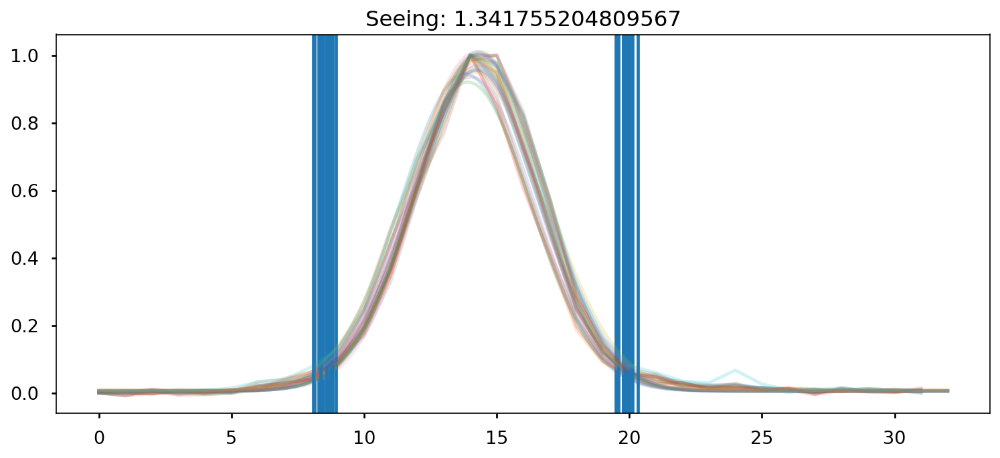

Mediana espectro estrella:  29.043293
Mediana fluxcal:  6.4750316129473625e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.24897903]
calib Data:  [0.90924226]
Fcalib :  [7.76687220e-18 7.76706984e-18 7.76726720e-18 ... 4.36723947e-18
 4.36583365e-18 4.36442754e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0315/obj_clean006_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0315
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0315/obj_clean006_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0315
mask2_1


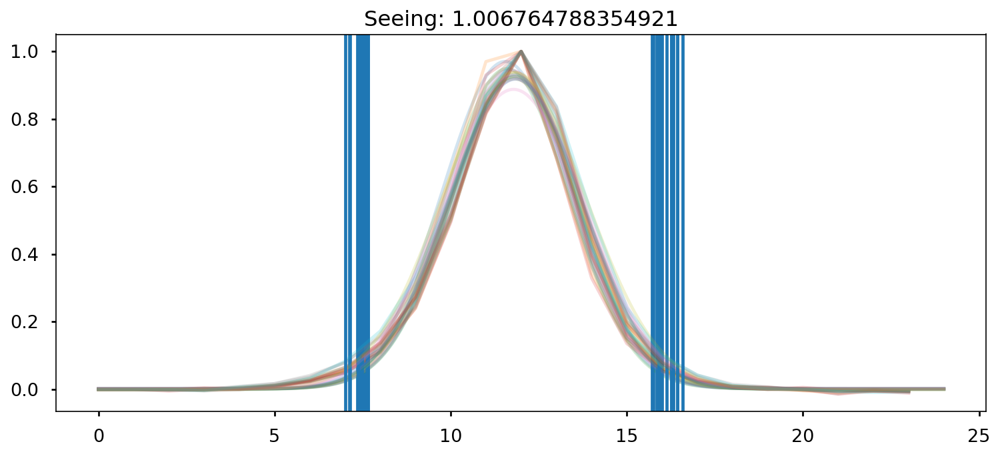

Mediana espectro estrella:  40.187023
Mediana fluxcal:  1.0373455579256403e-17
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.36054404]
calib Data:  [0.98037813]


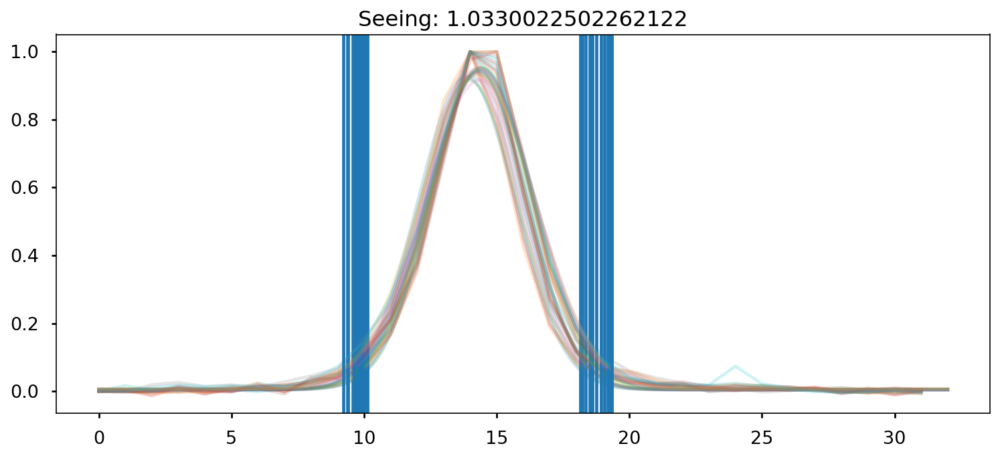

Mediana espectro estrella:  15.768147
Mediana fluxcal:  1.092246855761121e-17
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.32518294]
calib Data:  [0.97535155]
Fcalib :  [1.14555086e-17 1.14546210e-17 1.14537339e-17 ... 1.18969655e-17
 1.18980102e-17 1.18990552e-17]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0315/obj_clean007_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0315
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0315/obj_clean007_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0315
mask2_1


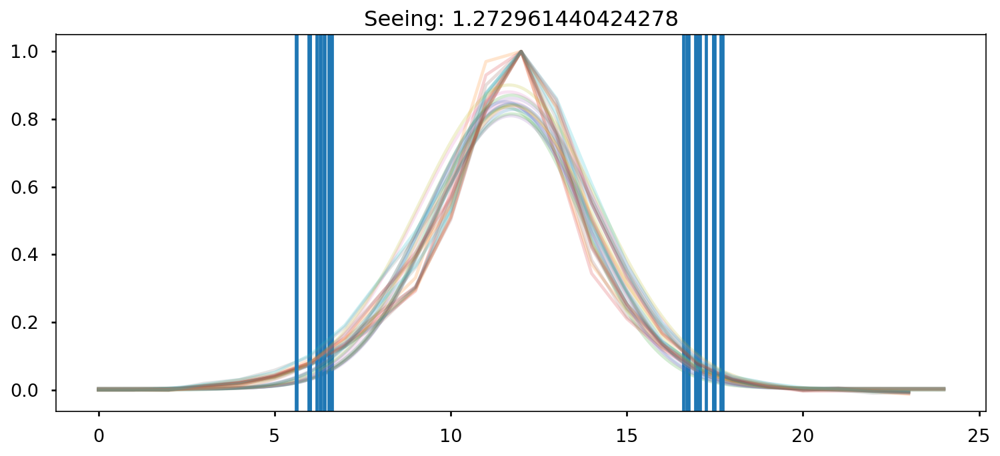

Mediana espectro estrella:  48.09577
Mediana fluxcal:  8.398886864033023e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.36104933]
calib Data:  [0.9808345]


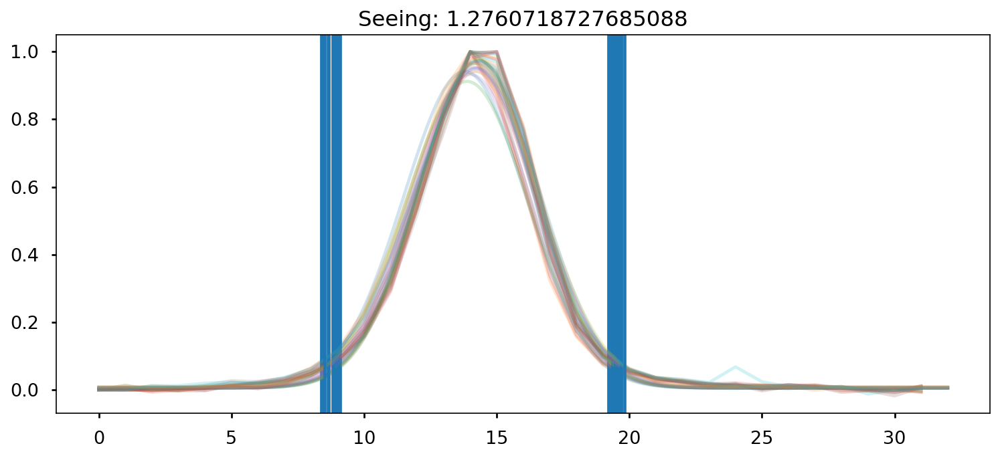

Mediana espectro estrella:  25.557549
Mediana fluxcal:  7.231773373768597e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.2615575]
calib Data:  [0.91983726]
Fcalib :  [8.79258797e-18 8.79237451e-18 8.79216094e-18 ... 6.03972810e-18
 6.03896337e-18 6.03819854e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0315/obj_clean008_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0315
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0315/obj_clean008_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0315
mask2_1


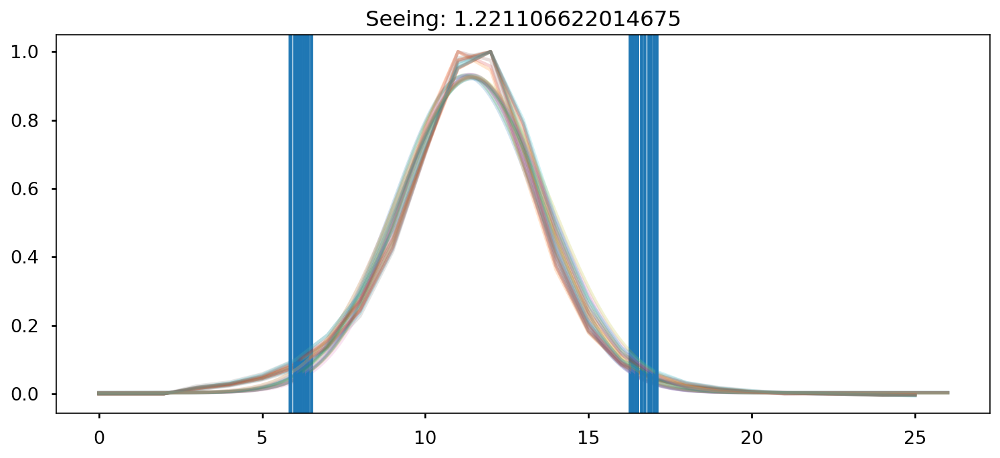

Mediana espectro estrella:  109.4039
Mediana fluxcal:  3.806176610389418e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.35640388]
calib Data:  [0.97664684]


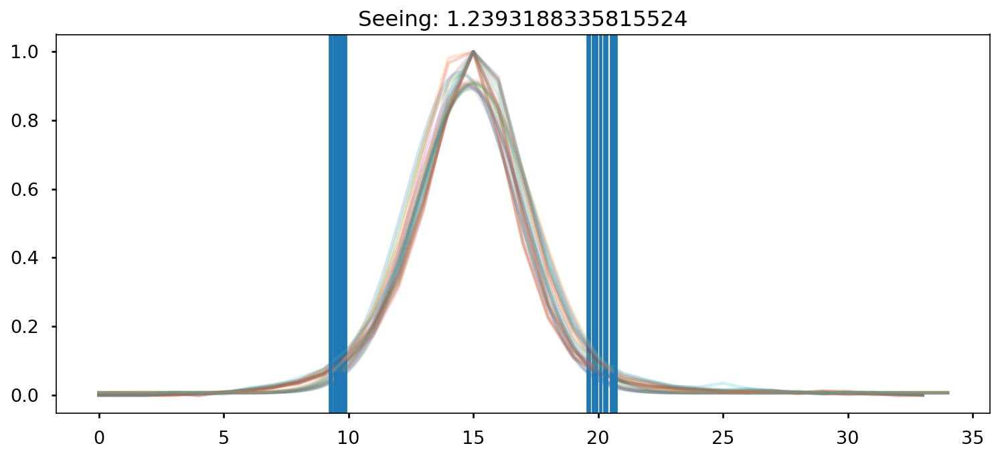

Mediana espectro estrella:  43.992676
Mediana fluxcal:  3.934246153875941e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31024664]
calib Data:  [0.96202566]
Fcalib :  [4.01738486e-18 4.01726551e-18 4.01714619e-18 ... 3.88015342e-18
 3.88022405e-18 3.88029471e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0316/obj_clean000_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0316
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0316/obj_clean000_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0316
mask2_1


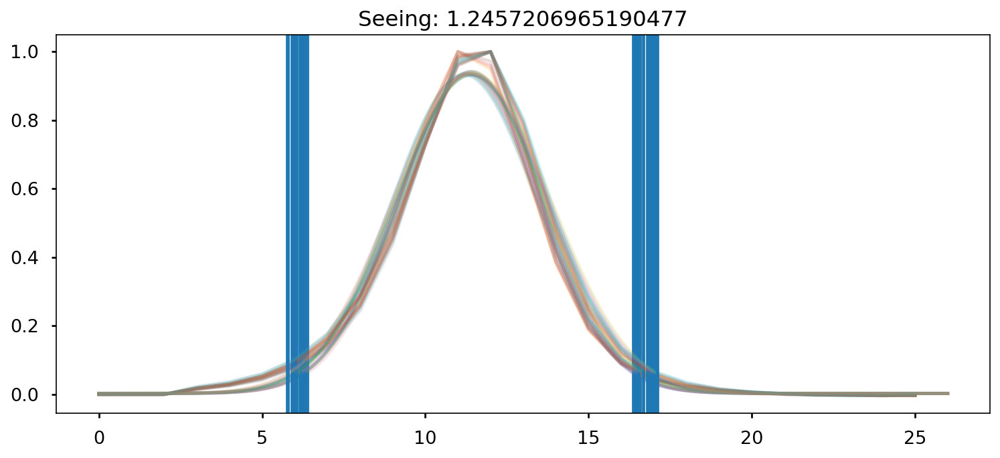

Mediana espectro estrella:  108.354385
Mediana fluxcal:  3.843285964496747e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.35834845]
calib Data:  [0.97839761]


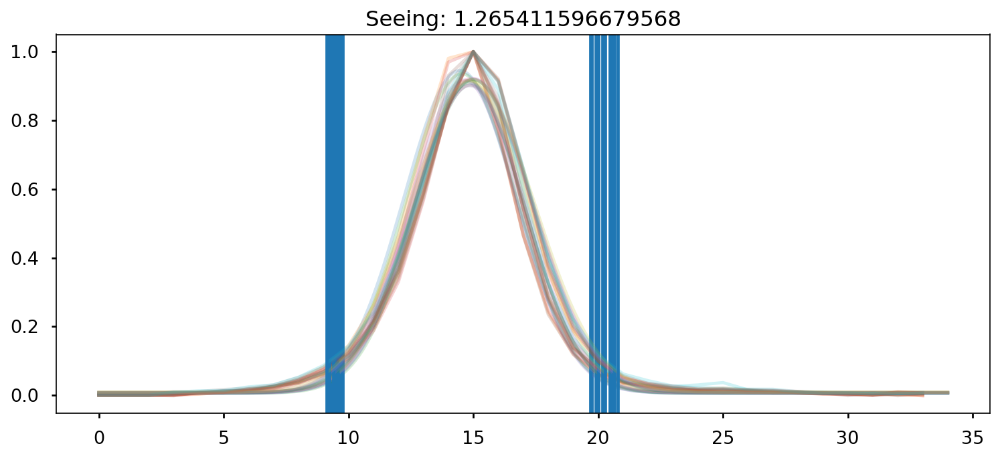

Mediana espectro estrella:  43.879124
Mediana fluxcal:  3.9407649507330865e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31476572]
calib Data:  [0.96603818]
Fcalib :  [4.04184757e-18 4.04172418e-18 4.04160082e-18 ... 3.91602346e-18
 3.91610218e-18 3.91618094e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0316/obj_clean001_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0316
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0316/obj_clean001_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0316
mask2_1


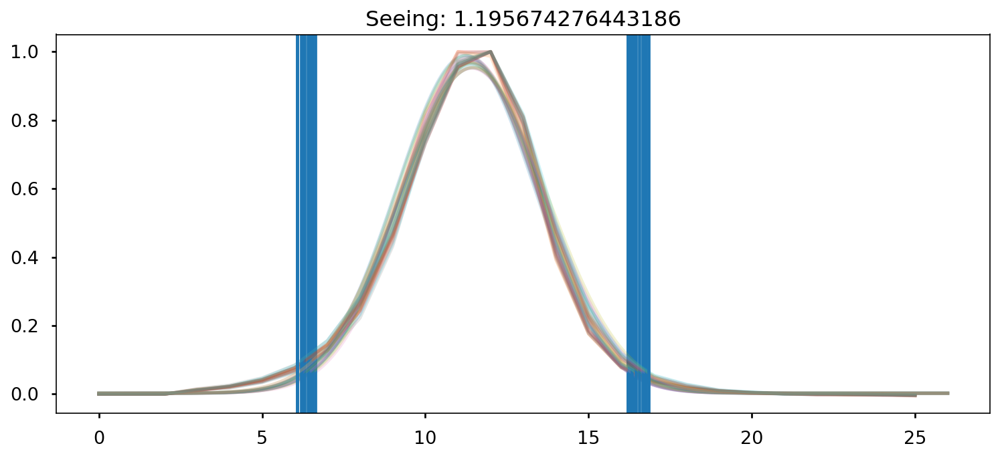

Mediana espectro estrella:  115.243256
Mediana fluxcal:  3.615570457849202e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.36163676]
calib Data:  [0.98136531]


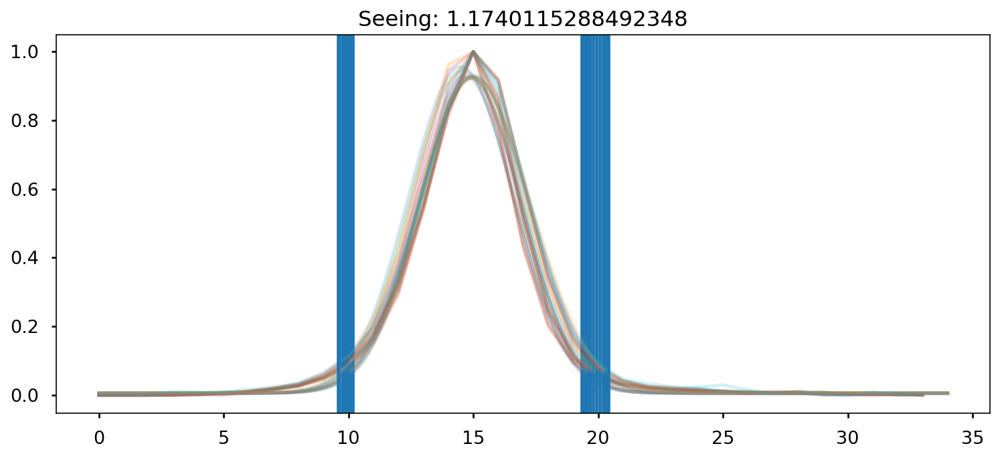

Mediana espectro estrella:  47.826744
Mediana fluxcal:  3.645435528091899e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31005246]
calib Data:  [0.96185362]
Fcalib :  [3.84163272e-18 3.84152847e-18 3.84142423e-18 ... 3.44080212e-18
 3.44076397e-18 3.44072582e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0316/obj_clean002_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0316
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0316/obj_clean002_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0316
mask2_1


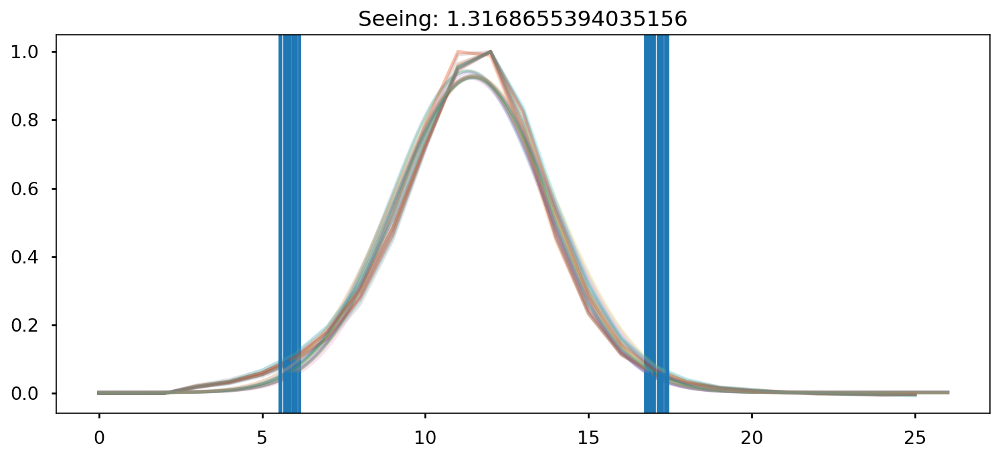

Mediana espectro estrella:  103.08304
Mediana fluxcal:  4.03946254586276e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.35594001]
calib Data:  [0.97622967]


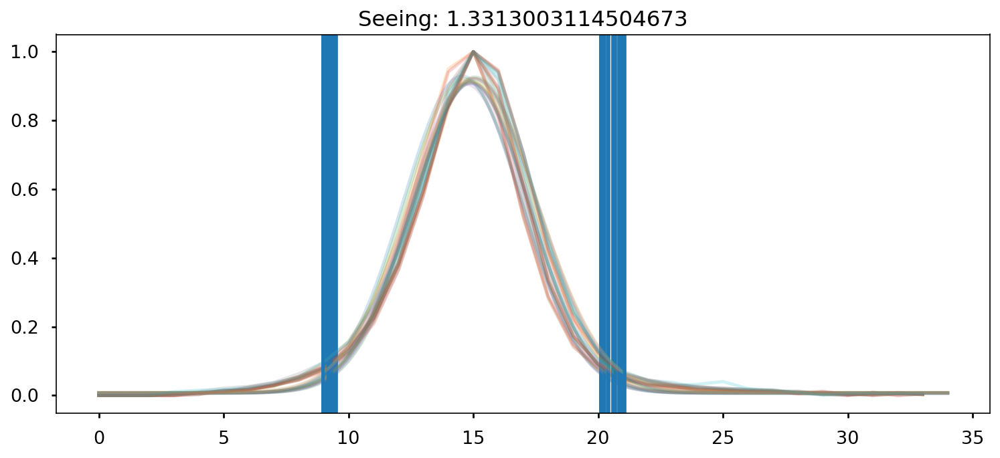

Mediana espectro estrella:  43.72345
Mediana fluxcal:  3.975434891061899e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31611793]
calib Data:  [0.96724205]
Fcalib :  [4.16927083e-18 4.16915835e-18 4.16904589e-18 ... 3.93256487e-18
 3.93259327e-18 3.93262170e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0316/obj_clean003_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0316
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0316/obj_clean003_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0316
mask2_1


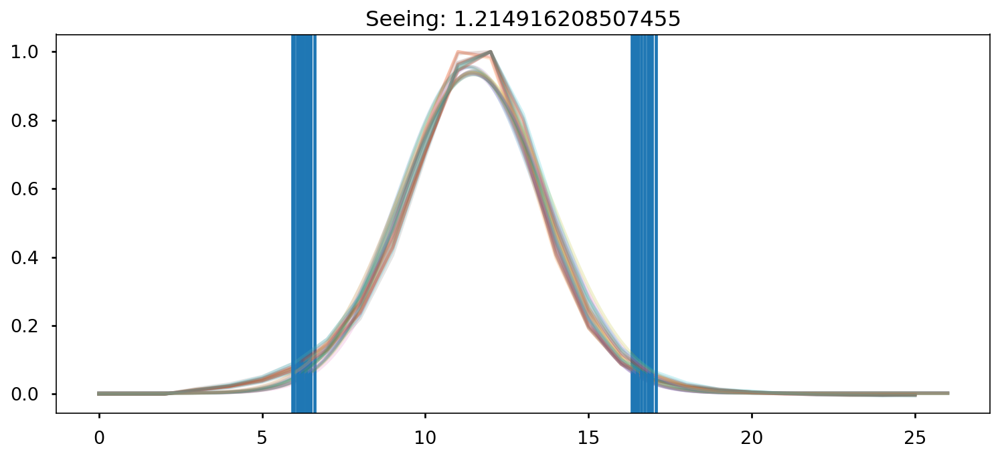

Mediana espectro estrella:  112.5553
Mediana fluxcal:  3.721481476213209e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.35489041]
calib Data:  [0.97528639]


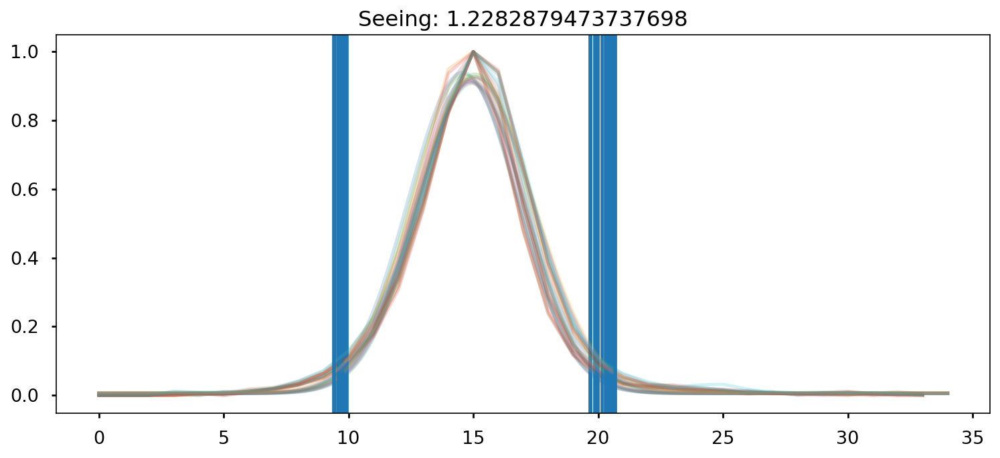

Mediana espectro estrella:  45.39415
Mediana fluxcal:  3.800538917488316e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.30982206]
calib Data:  [0.96164953]
Fcalib :  [3.93423213e-18 3.93409707e-18 3.93396205e-18 ... 3.79488392e-18
 3.79496950e-18 3.79505513e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0316/obj_clean004_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0316
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0316/obj_clean004_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0316
mask2_1


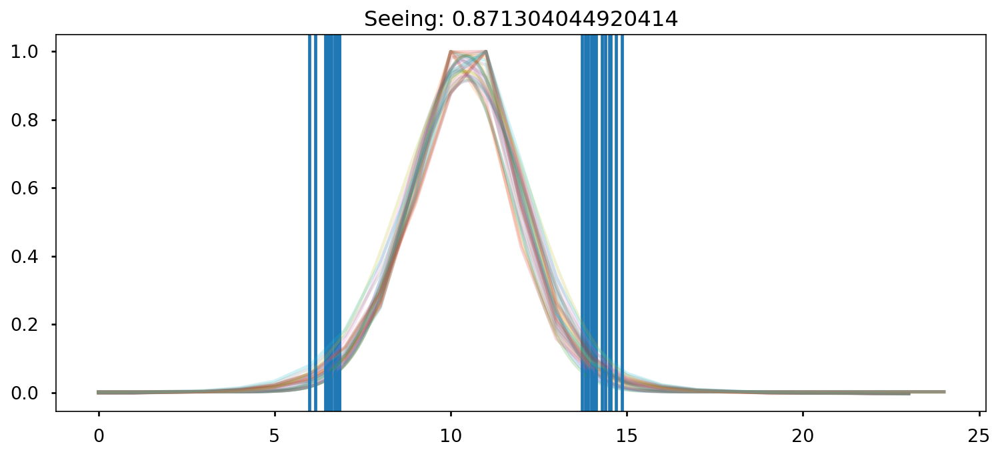

Mediana espectro estrella:  123.46965
Mediana fluxcal:  3.5515630667679945e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.28982736]
calib Data:  [0.91855876]


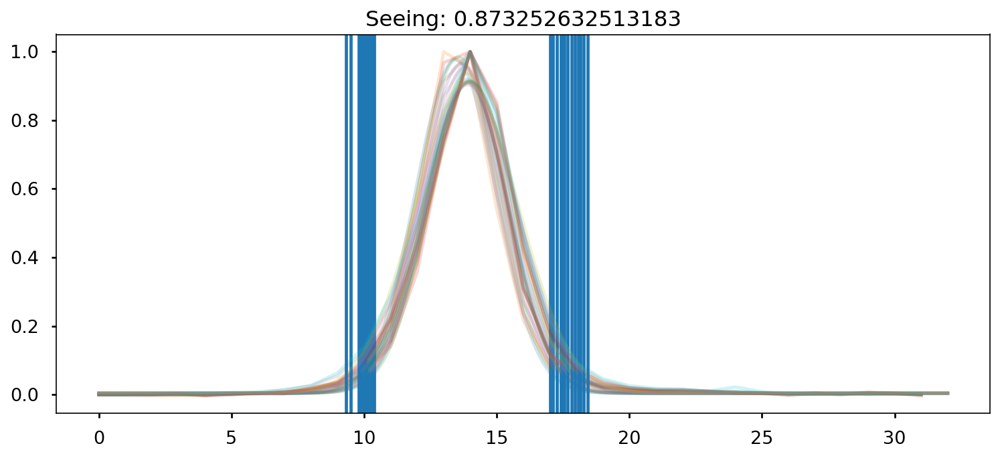

Mediana espectro estrella:  50.982323
Mediana fluxcal:  3.4316477290300138e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.28606503]
calib Data:  [0.94083618]
Fcalib :  [3.93064085e-18 3.93018330e-18 3.92972591e-18 ... 4.03275874e-18
 4.03325275e-18 4.03374692e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0317/obj_clean000_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0317
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0317/obj_clean000_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0317
mask2_1


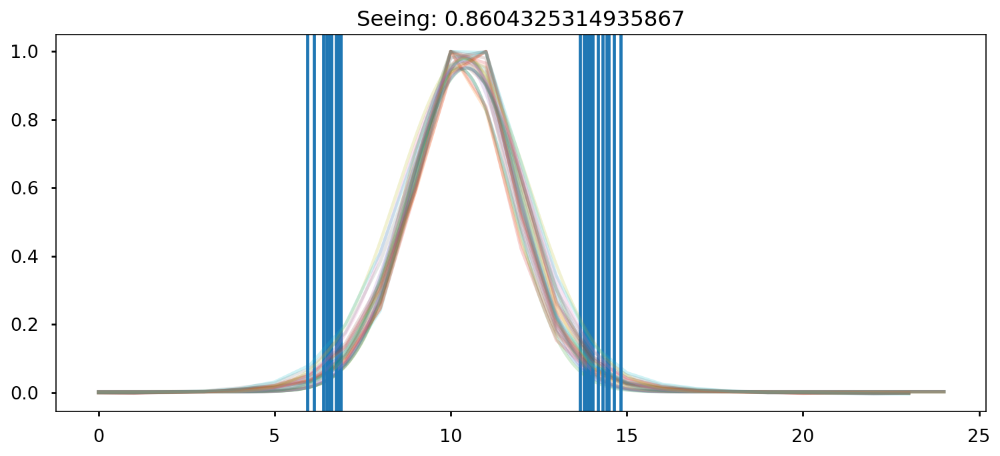

Mediana espectro estrella:  127.827156
Mediana fluxcal:  3.501458821290103e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.26872983]
calib Data:  [0.90088205]


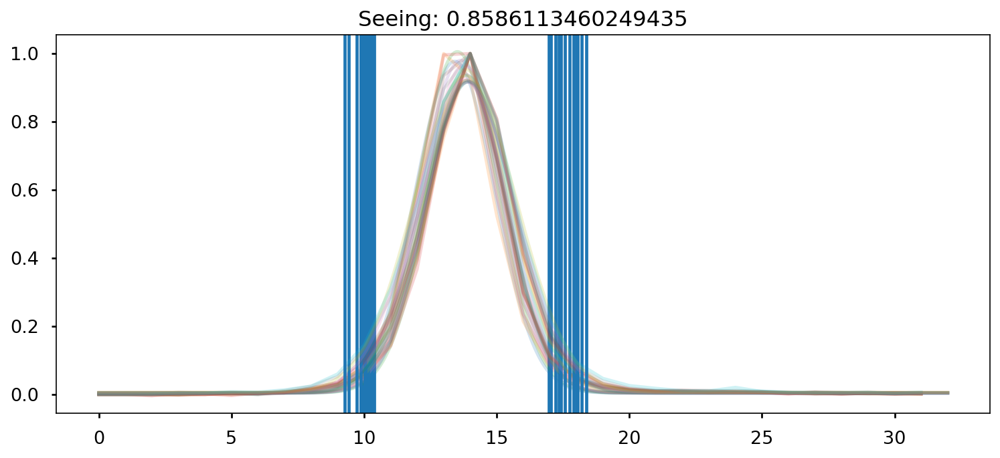

Mediana espectro estrella:  52.97232
Mediana fluxcal:  3.29680988262463e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.29297219]
calib Data:  [0.94684061]
Fcalib :  [3.98773993e-18 3.98706381e-18 3.98638796e-18 ... 4.41031001e-18
 4.41113654e-18 4.41196333e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0317/obj_clean001_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0317
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0317/obj_clean001_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0317
mask2_1


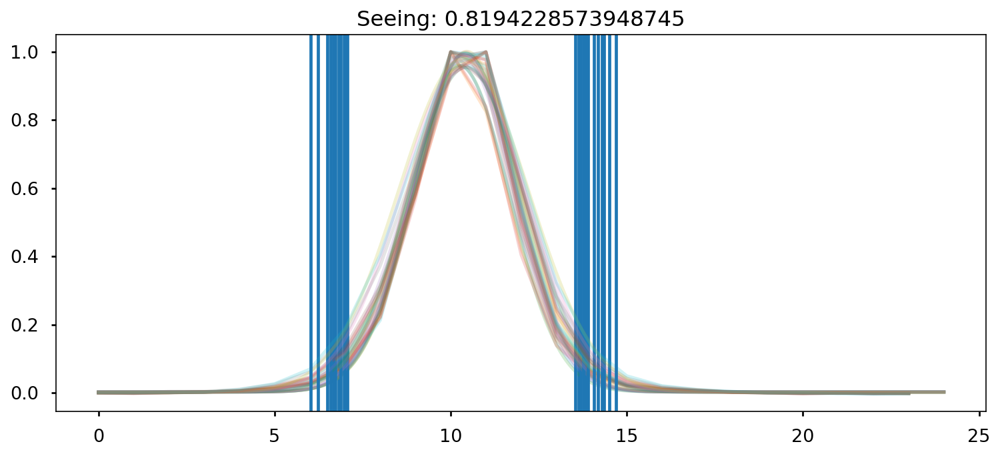

Mediana espectro estrella:  119.476974
Mediana fluxcal:  3.477247197926534e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.36183394]
calib Data:  [0.98154355]


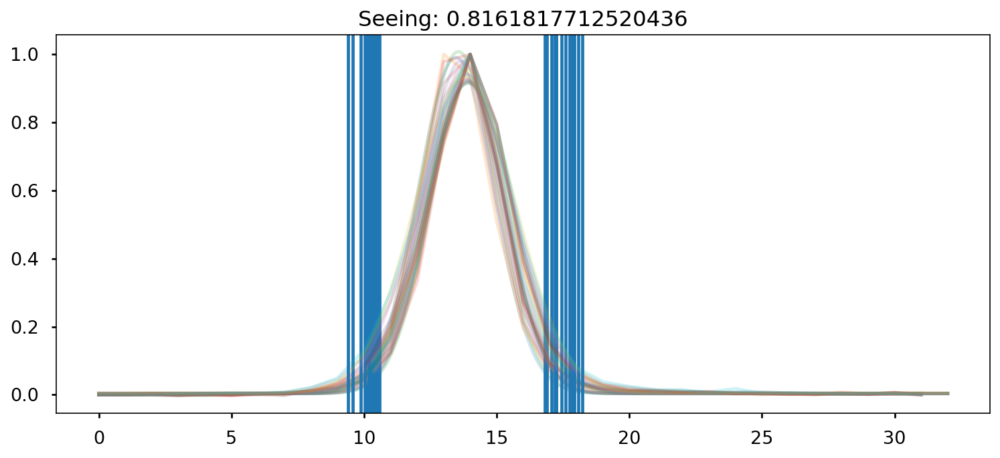

Mediana espectro estrella:  47.906662
Mediana fluxcal:  3.653147498891276e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.33693271]
calib Data:  [0.98596405]
Fcalib :  [3.79944098e-18 3.79901868e-18 3.79859659e-18 ... 4.65975229e-18
 4.66048046e-18 4.66120884e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0317/obj_clean002_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0317
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0317/obj_clean002_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0317
mask2_1


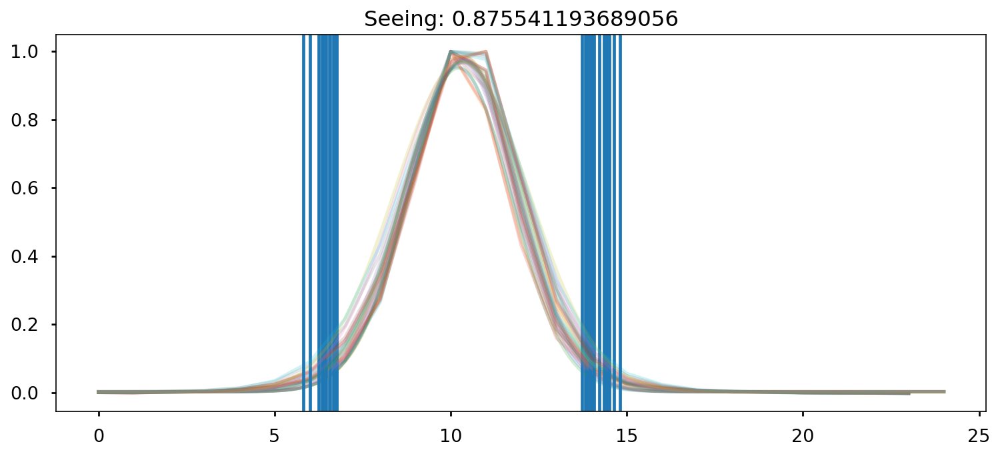

Mediana espectro estrella:  126.085014
Mediana fluxcal:  3.470535924408647e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.29279254]
calib Data:  [0.92107081]


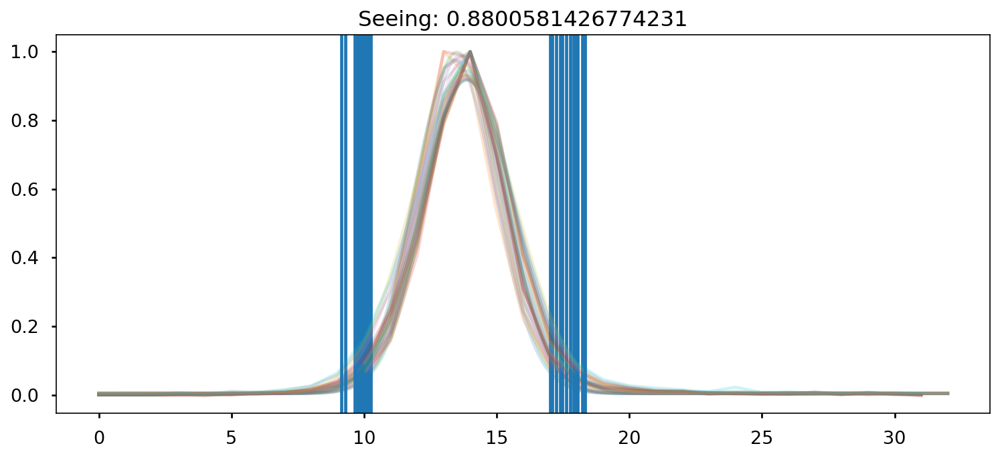

Mediana espectro estrella:  52.296013
Mediana fluxcal:  3.3405192425171485e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.29617399]
calib Data:  [0.94963693]
Fcalib :  [3.82372747e-18 3.82324014e-18 3.82275301e-18 ... 4.15205910e-18
 4.15266328e-18 4.15326766e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0317/obj_clean003_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0317
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0317/obj_clean003_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0317
mask2_1


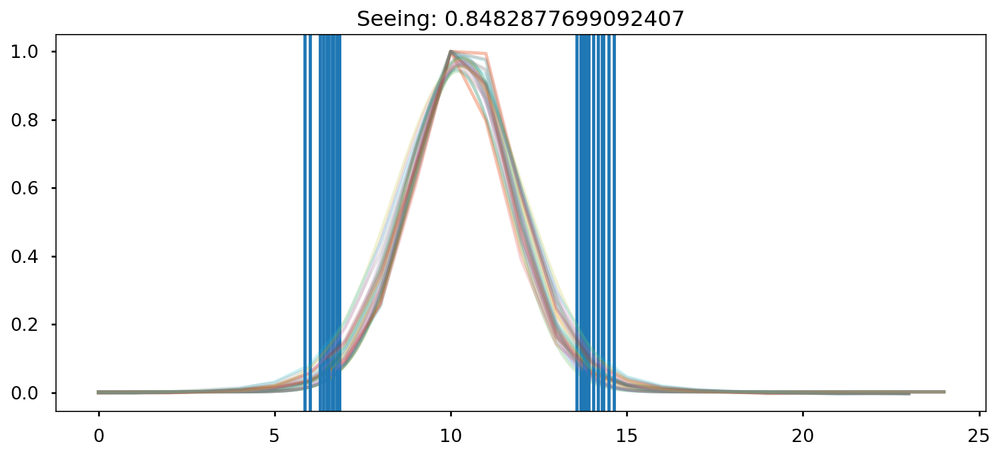

Mediana espectro estrella:  128.47208
Mediana fluxcal:  3.46963605445264e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.26812318]
calib Data:  [0.90037882]


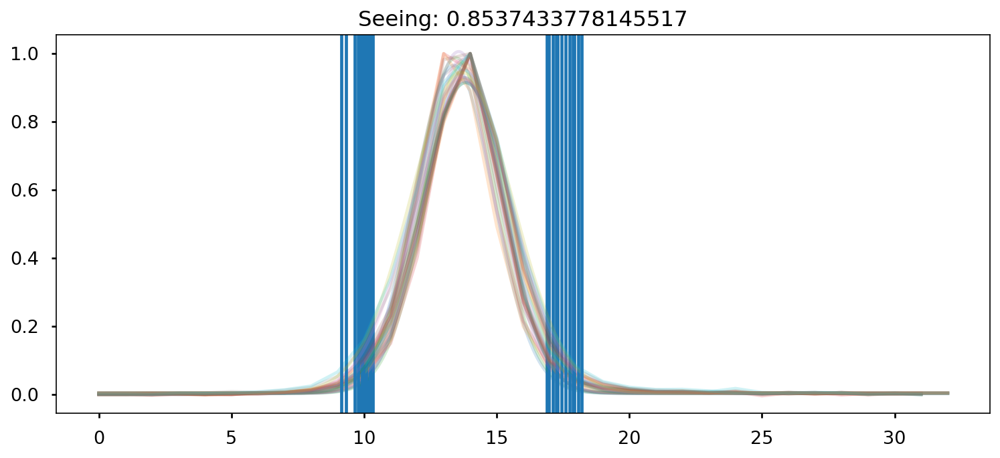

Mediana espectro estrella:  53.156975
Mediana fluxcal:  3.2732956277579118e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.29408834]
calib Data:  [0.94781447]
Fcalib :  [3.90788560e-18 3.90725211e-18 3.90661887e-18 ... 4.36934600e-18
 4.37014371e-18 4.37094166e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0317/obj_clean004_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0317
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0317/obj_clean004_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0317
mask2_1


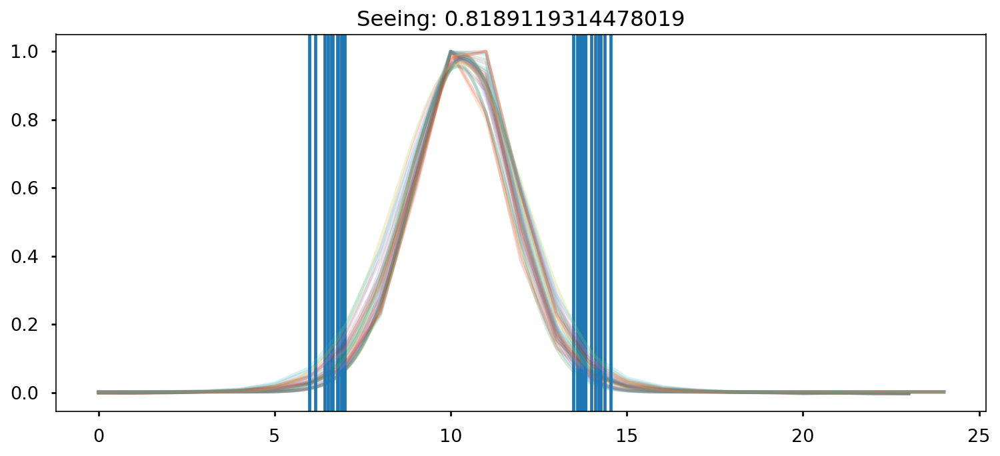

Mediana espectro estrella:  116.80174
Mediana fluxcal:  3.535847324347493e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.36406511]
calib Data:  [0.98356269]


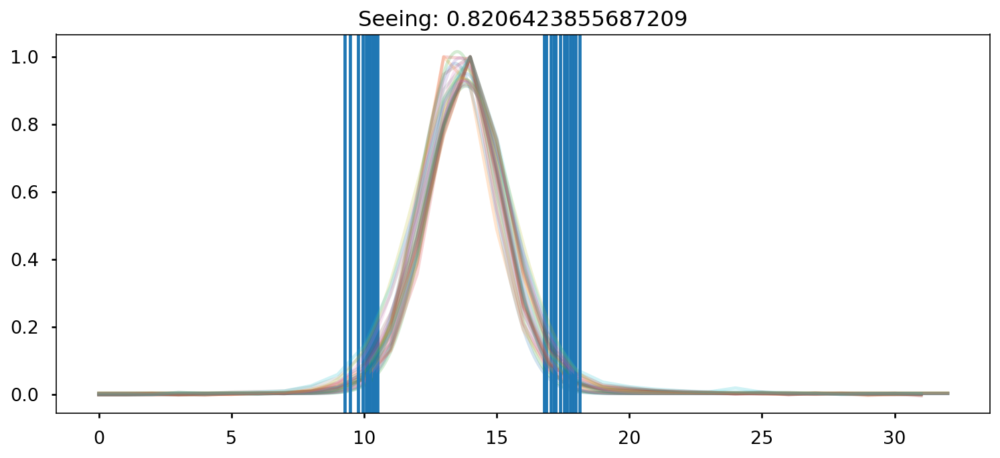

Mediana espectro estrella:  46.476265
Mediana fluxcal:  3.746562312615844e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.33581141]
calib Data:  [0.98494632]
Fcalib :  [3.84933696e-18 3.84891458e-18 3.84849241e-18 ... 4.84561682e-18
 4.84639340e-18 4.84717018e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0317/obj_clean005_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0317
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0317/obj_clean005_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0317
mask2_1


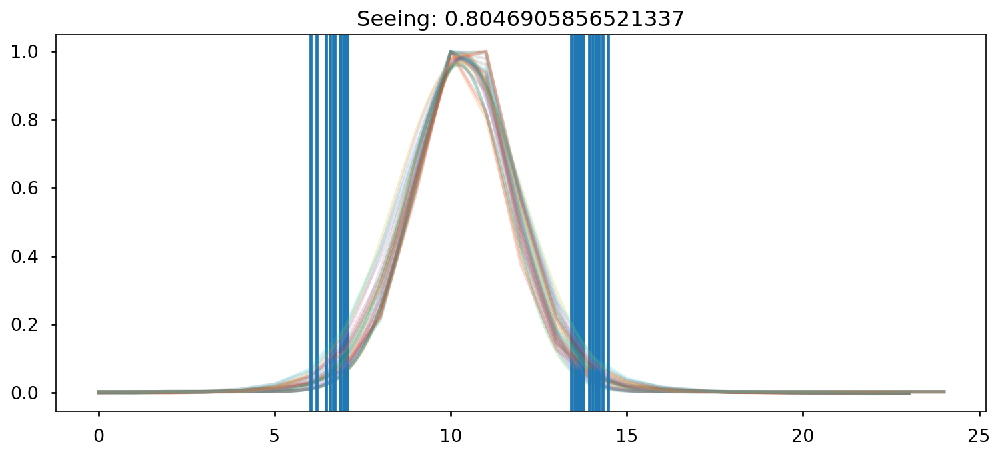

Mediana espectro estrella:  115.12396
Mediana fluxcal:  3.5904789409824165e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.36503406]
calib Data:  [0.98444084]


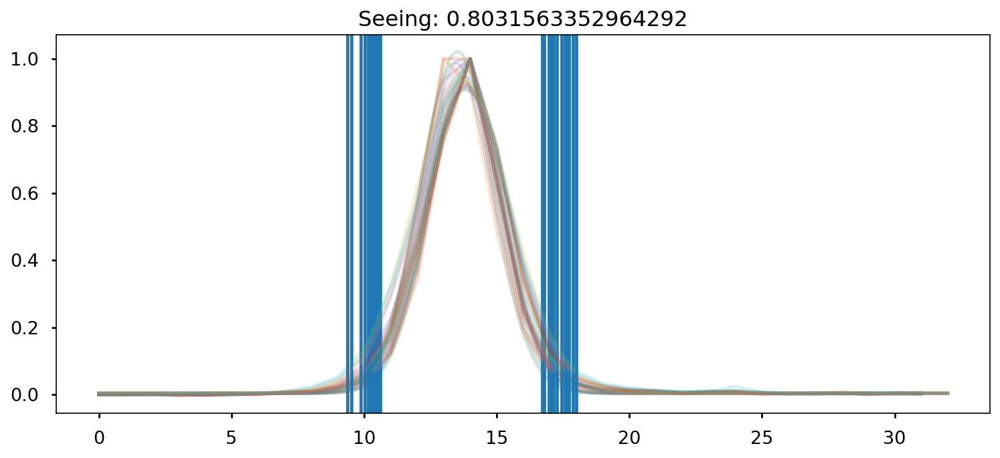

Mediana espectro estrella:  46.106445
Mediana fluxcal:  3.7737877038807295e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.33469971]
calib Data:  [0.98393834]
Fcalib :  [3.86952415e-18 3.86910432e-18 3.86868470e-18 ... 4.96581008e-18
 4.96661965e-18 4.96742943e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0317/obj_clean006_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0317
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0317/obj_clean006_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0317
mask2_1


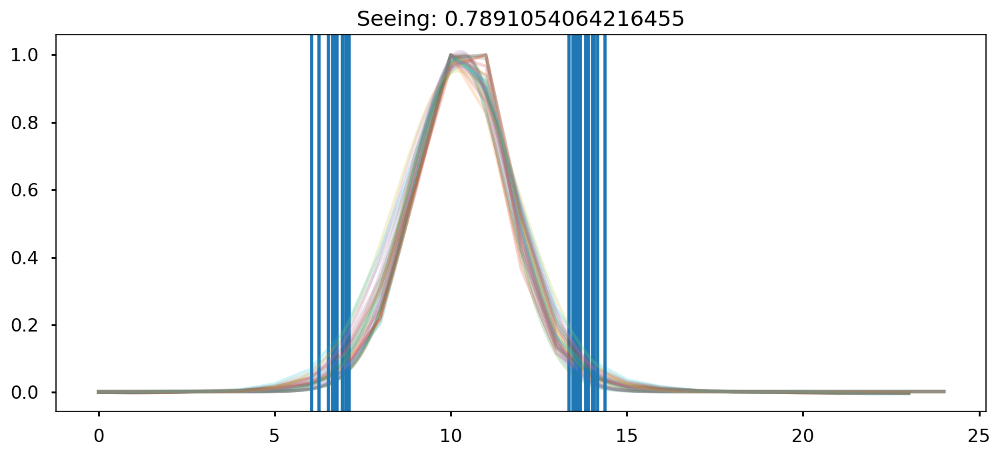

Mediana espectro estrella:  115.32637
Mediana fluxcal:  3.622368267233981e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.36692942]
calib Data:  [0.98616087]


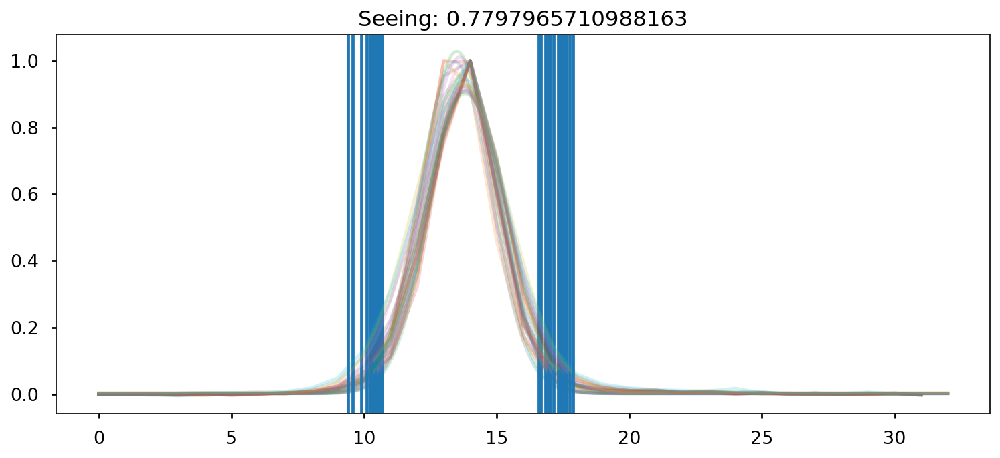

Mediana espectro estrella:  46.401024
Mediana fluxcal:  3.760915008565942e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.33488749]
calib Data:  [0.98410853]
Fcalib :  [3.91008781e-18 3.90965066e-18 3.90921372e-18 ... 4.92364237e-18
 4.92443987e-18 4.92523758e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0317/obj_clean007_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0317
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0317/obj_clean007_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0317
mask2_1


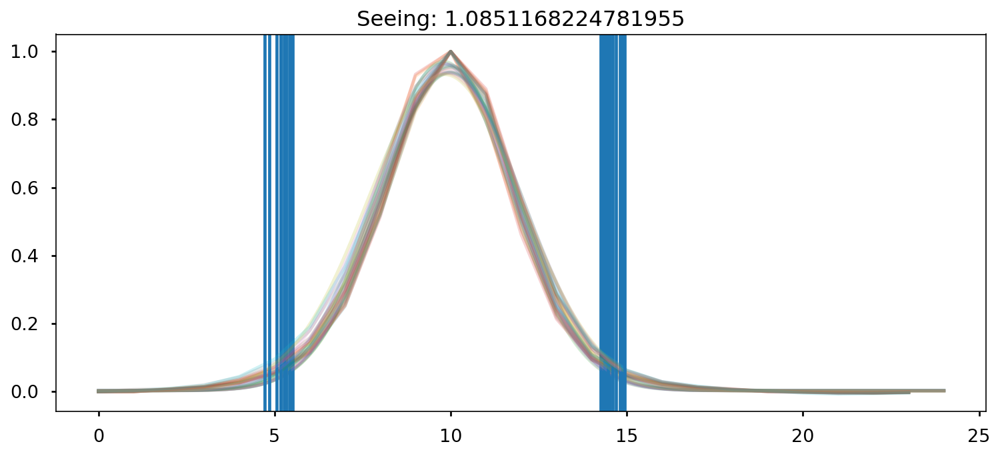

Mediana espectro estrella:  104.946976
Mediana fluxcal:  4.0495261790749934e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.36757676]
calib Data:  [0.98674902]


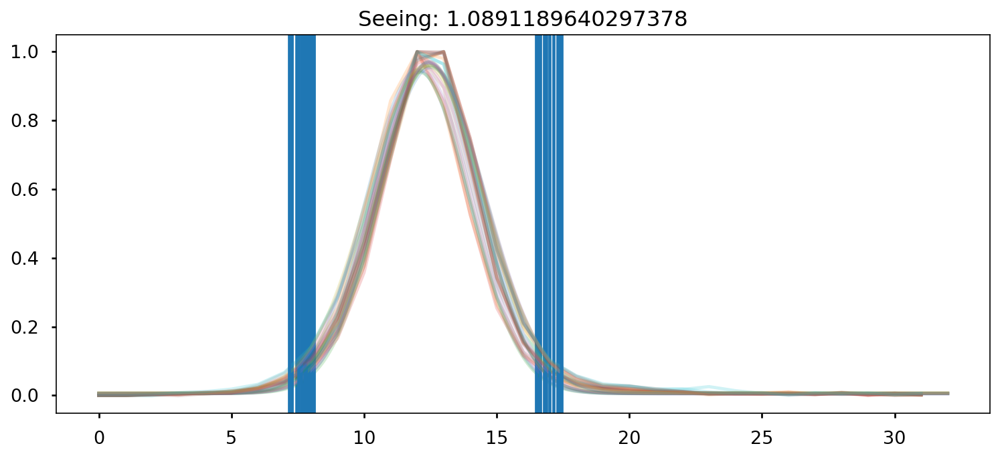

Mediana espectro estrella:  40.287773
Mediana fluxcal:  4.517939283616432e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.26279062]
calib Data:  [0.92088256]
Fcalib :  [4.32165607e-18 4.32168026e-18 4.32170442e-18 ... 4.03000838e-18
 4.02988054e-18 4.02975267e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0319/obj_clean000_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0319
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0319/obj_clean000_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0319
mask2_1


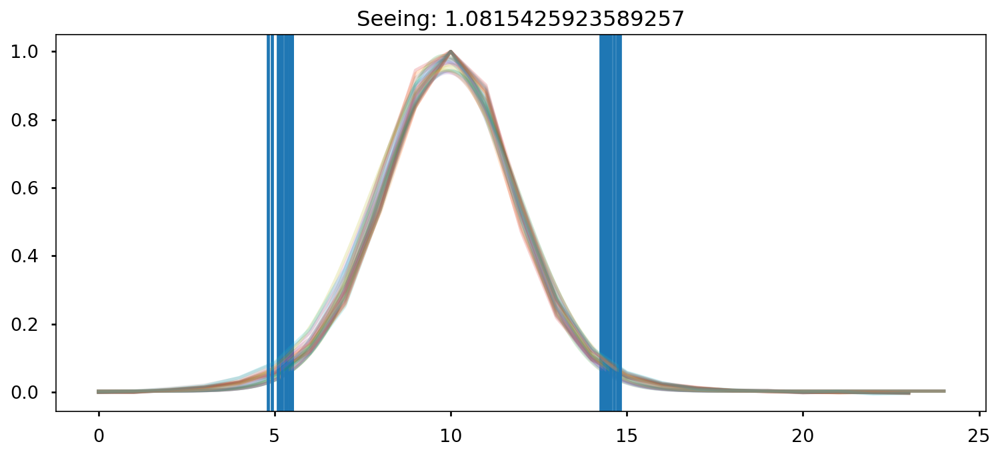

Mediana espectro estrella:  105.38787
Mediana fluxcal:  4.043881911835919e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.36654941]
calib Data:  [0.98581578]


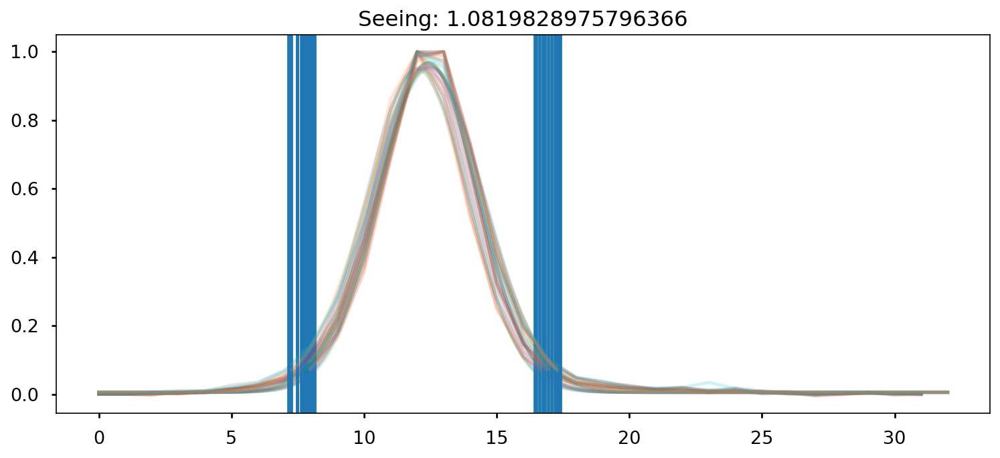

Mediana espectro estrella:  40.6618
Mediana fluxcal:  4.484031261920954e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.25506597]
calib Data:  [0.91435404]
Fcalib :  [4.31704632e-18 4.31707373e-18 4.31710110e-18 ... 3.95033582e-18
 3.95017808e-18 3.95002032e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0319/obj_clean001_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0319
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0319/obj_clean001_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0319
mask2_1


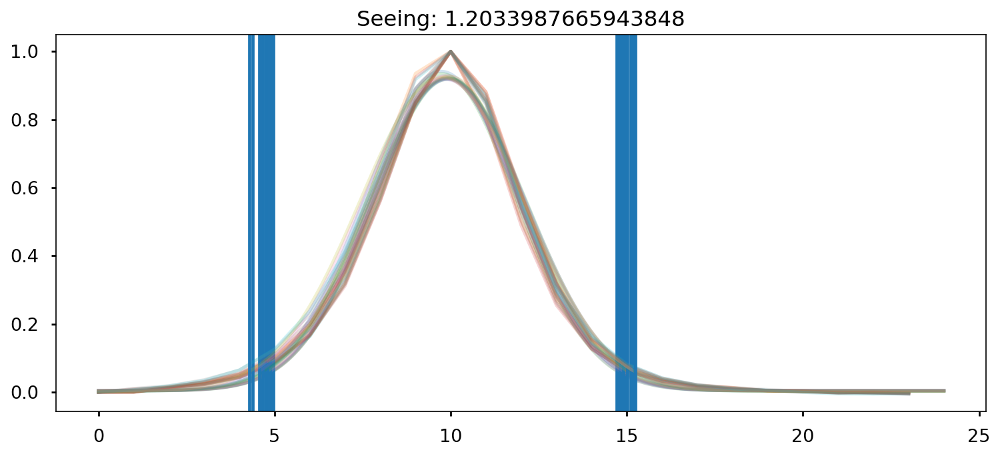

Mediana espectro estrella:  96.87013
Mediana fluxcal:  4.3590618490190565e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.36652301]
calib Data:  [0.98579181]


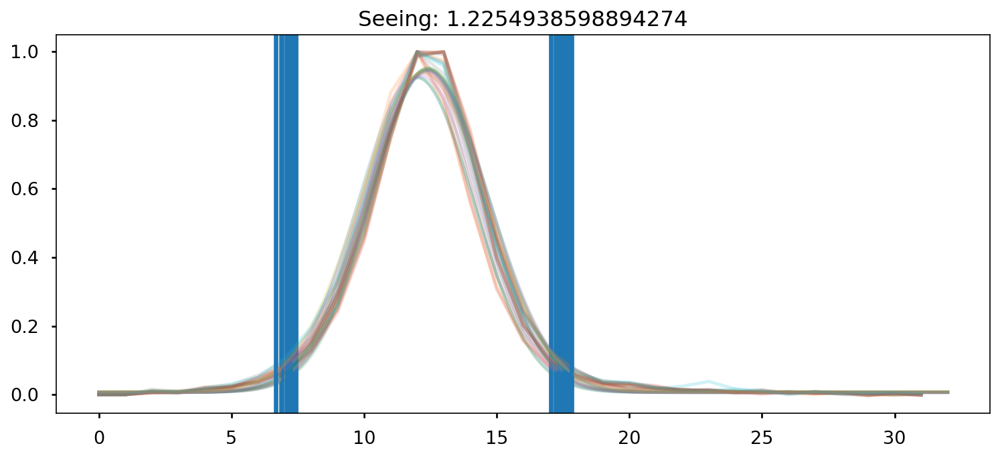

Mediana espectro estrella:  36.313538
Mediana fluxcal:  4.978056617244848e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.28393665]
calib Data:  [0.93899366]
Fcalib :  [4.80951737e-18 4.80934897e-18 4.80918064e-18 ... 4.89912198e-18
 4.89932228e-18 4.89952265e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0319/obj_clean002_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0319
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0319/obj_clean002_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0319
mask2_1


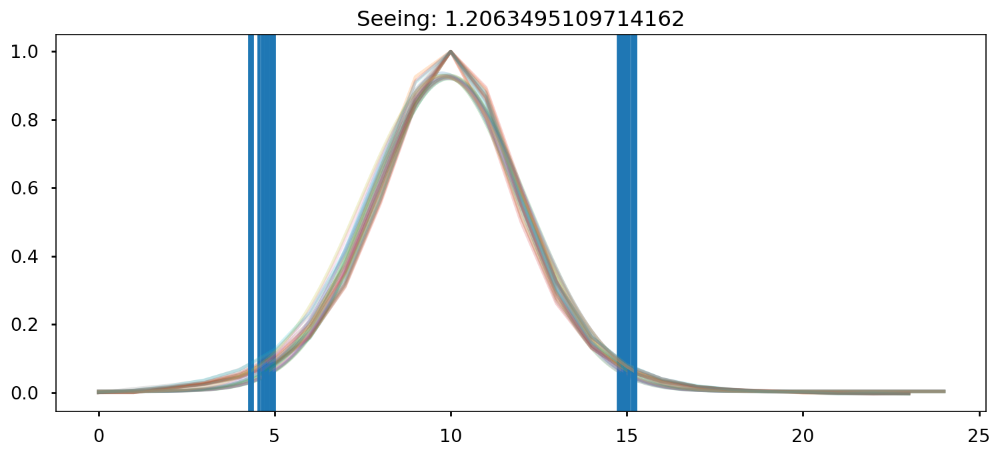

Mediana espectro estrella:  97.694534
Mediana fluxcal:  4.333658820099123e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [16.36518346]
calib Data:  [0.98457632]


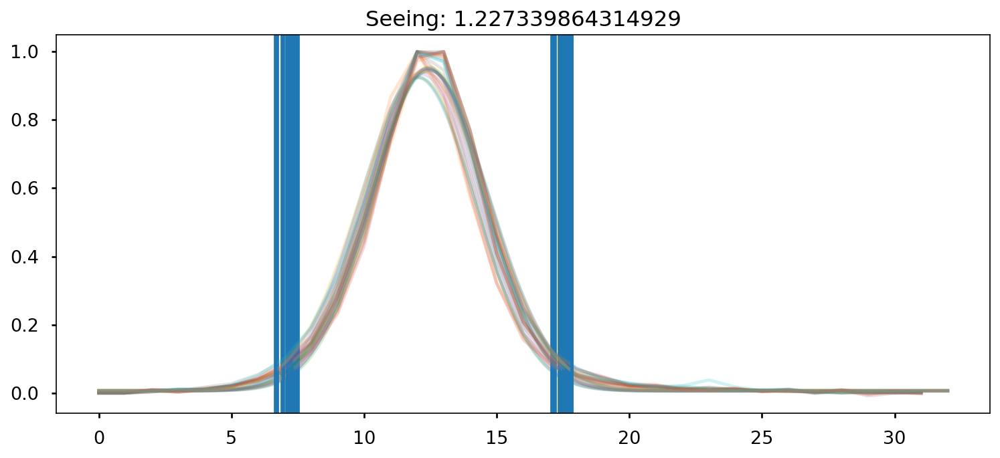

Mediana espectro estrella:  36.569122
Mediana fluxcal:  4.9474358066450735e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.27096008]
calib Data:  [0.92783773]
Fcalib :  [4.69792975e-18 4.69786547e-18 4.69780122e-18 ... 4.72067269e-18
 4.72074507e-18 4.72081748e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0319/obj_clean003_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0319
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0319/obj_clean003_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_1/0319
mask2_2


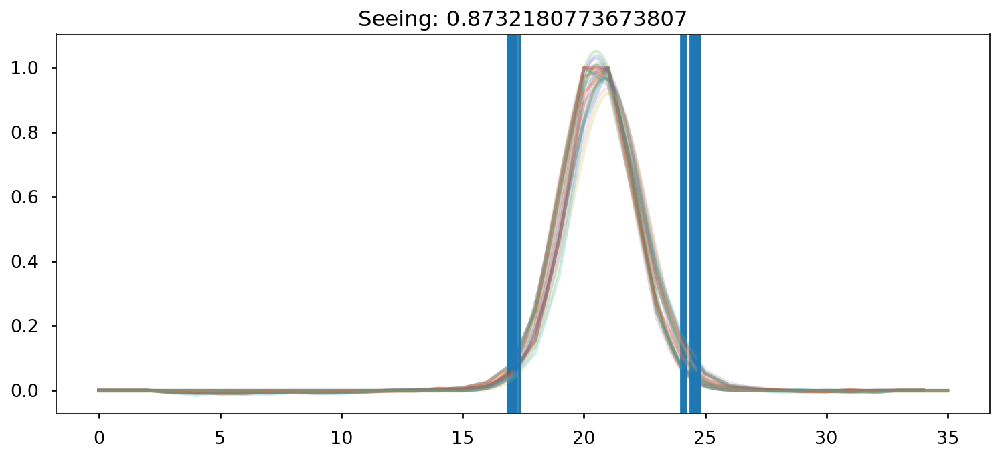

Mediana espectro estrella:  34.898506
Mediana fluxcal:  5.167403466759999e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.30742644]
calib Data:  [1.00924028]


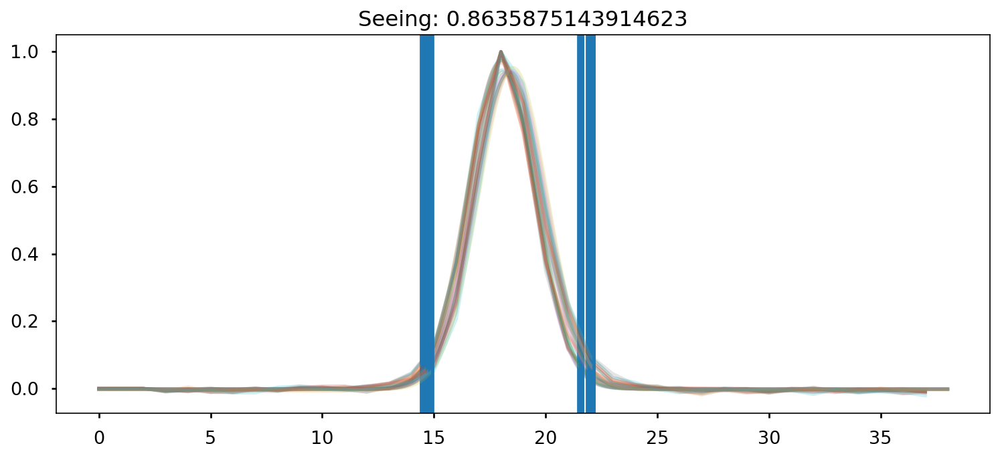

Mediana espectro estrella:  20.333498
Mediana fluxcal:  5.209666658523558e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.88947639]
calib Data:  [0.99409195]
Fcalib :  [5.60863379e-18 5.60789447e-18 5.60715550e-18 ... 7.06174168e-18
 7.06299765e-18 7.06425398e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean000_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean000_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
mask2_2


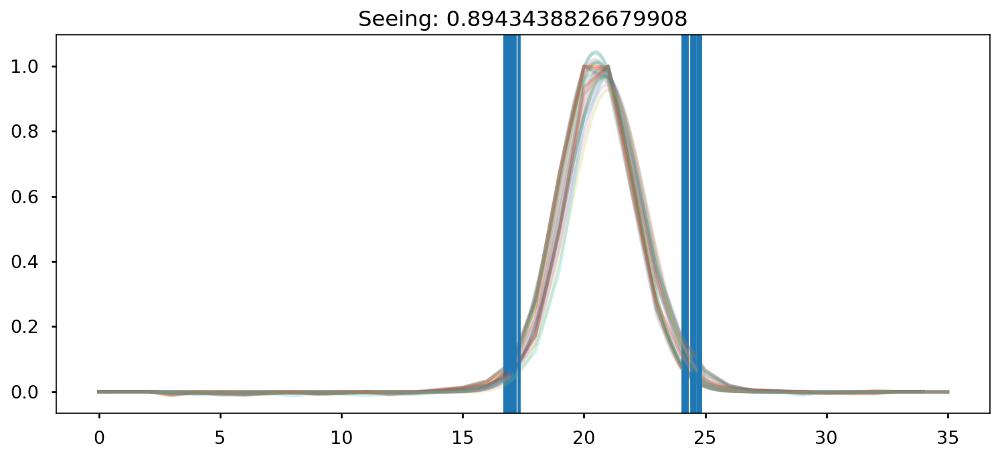

Mediana espectro estrella:  35.476196
Mediana fluxcal:  5.0745338105824825e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.30443985]
calib Data:  [1.00646793]


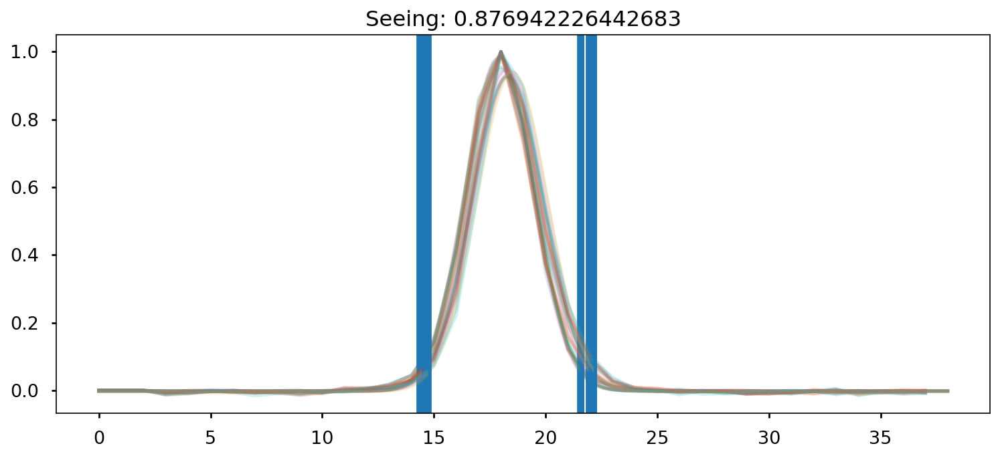

Mediana espectro estrella:  20.787086
Mediana fluxcal:  5.102176300355092e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.88649509]
calib Data:  [0.99136603]
Fcalib :  [5.51806934e-18 5.51732318e-18 5.51657738e-18 ... 6.95590946e-18
 6.95716685e-18 6.95842459e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean001_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean001_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
mask2_2


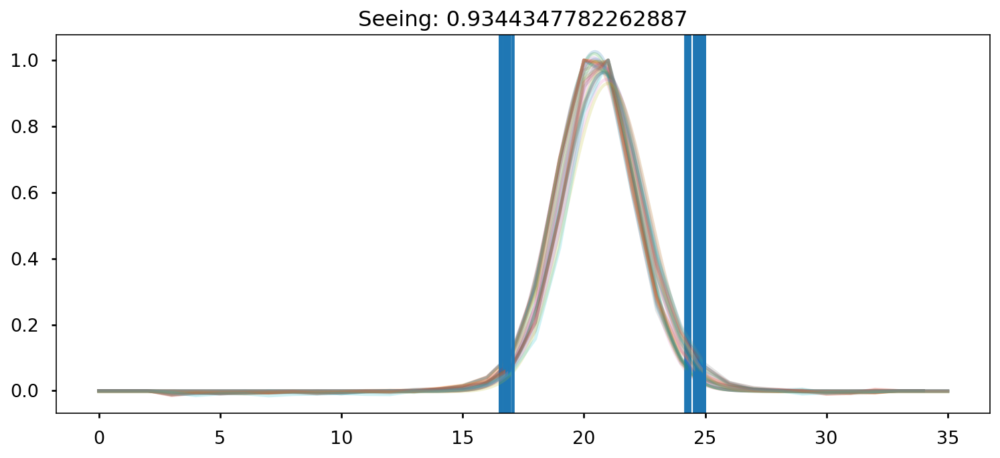

Mediana espectro estrella:  36.522873
Mediana fluxcal:  4.9252286516739825e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.30750706]
calib Data:  [1.00931523]


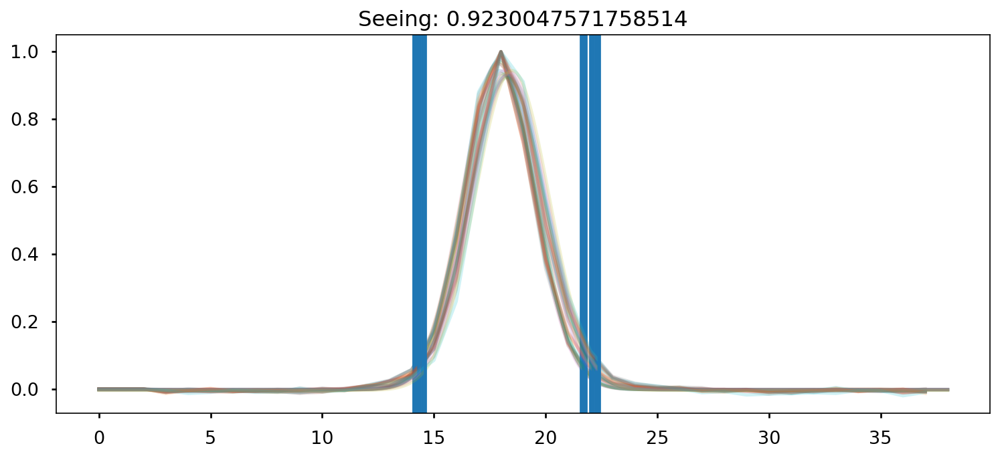

Mediana espectro estrella:  21.00956
Mediana fluxcal:  5.0328364537823234e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.89172482]
calib Data:  [0.99615273]
Fcalib :  [5.36586929e-18 5.36516366e-18 5.36445837e-18 ... 6.82371421e-18
 6.82493816e-18 6.82616245e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean002_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean002_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
mask2_2


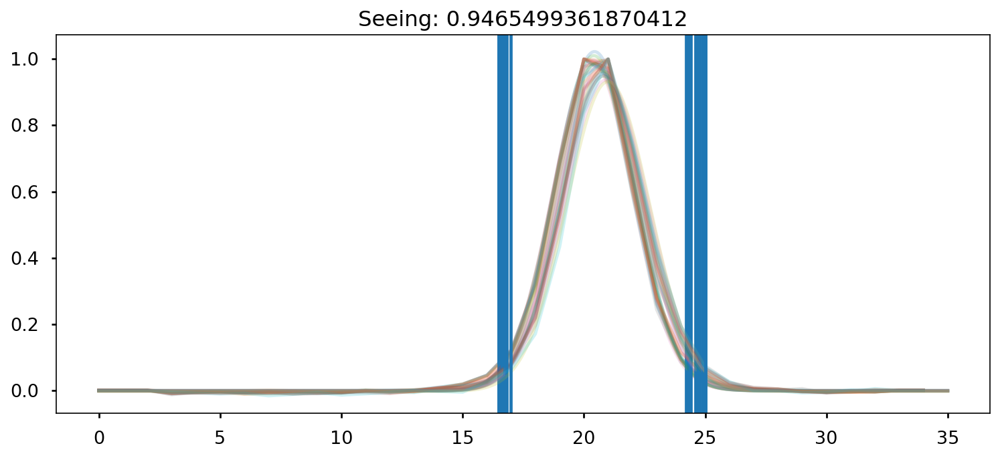

Mediana espectro estrella:  36.16513
Mediana fluxcal:  4.951516810687856e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31200779]
calib Data:  [1.01350784]


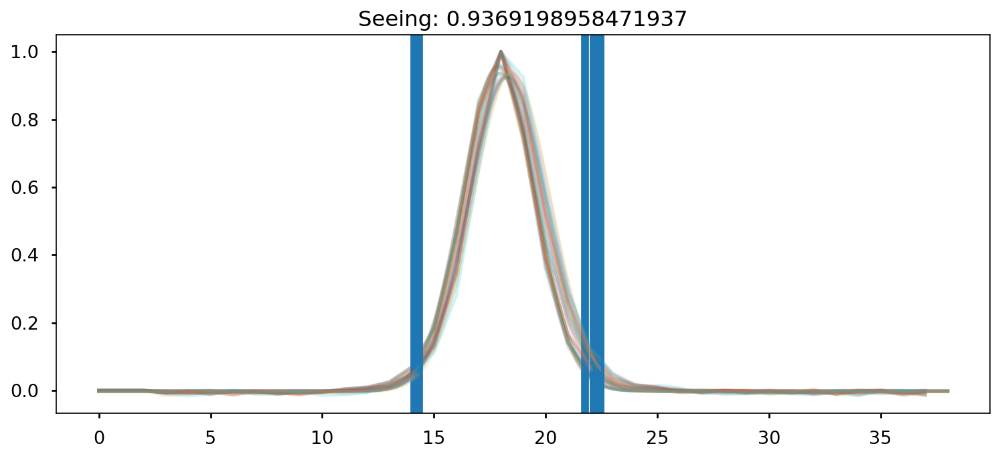

Mediana espectro estrella:  20.848158
Mediana fluxcal:  5.074308776507681e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.88533373]
calib Data:  [0.99030618]
Fcalib :  [5.35687713e-18 5.35619397e-18 5.35551116e-18 ... 6.92789066e-18
 6.92913234e-18 6.93037437e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean003_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean003_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
mask2_2


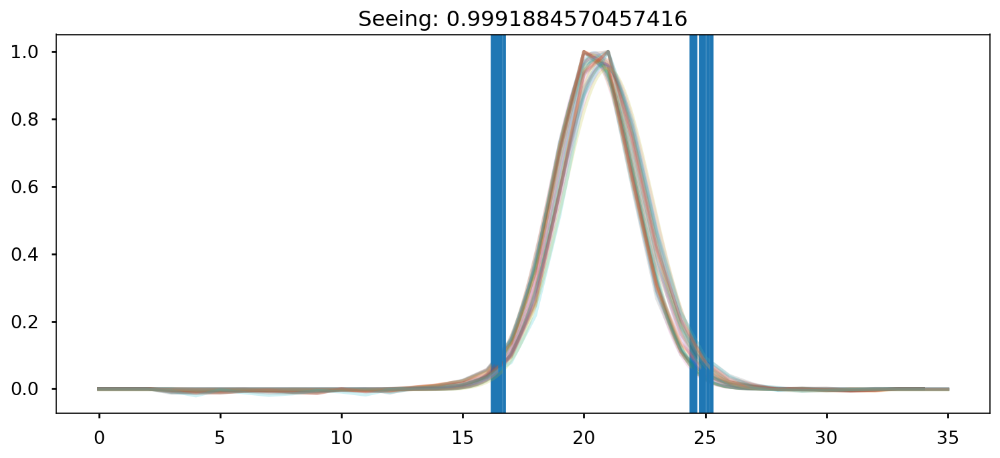

Mediana espectro estrella:  36.31852
Mediana fluxcal:  4.891277639972669e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.3116439]
calib Data:  [1.01316822]


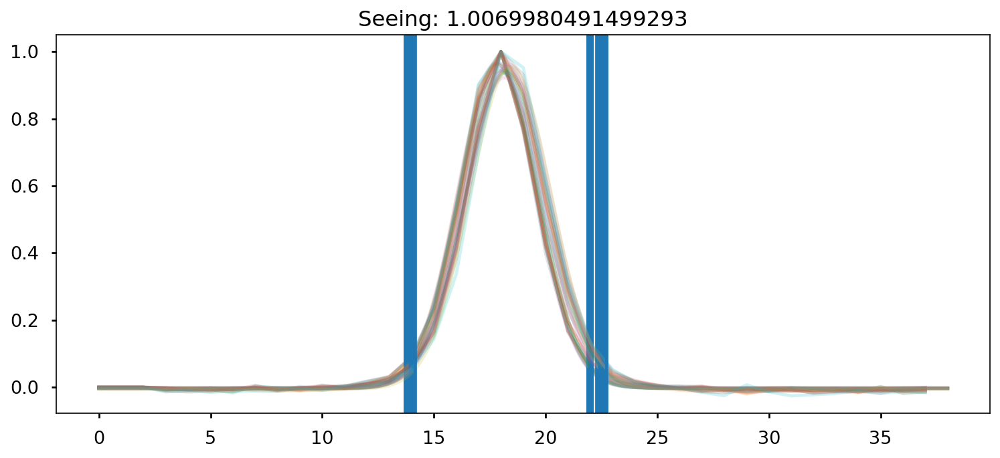

Mediana espectro estrella:  20.69831
Mediana fluxcal:  5.06910256819374e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.88370692]
calib Data:  [0.98882348]
Fcalib :  [5.27321416e-18 5.27259307e-18 5.27197230e-18 ... 6.80777336e-18
 6.80894000e-18 6.81010696e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean004_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean004_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
mask2_2


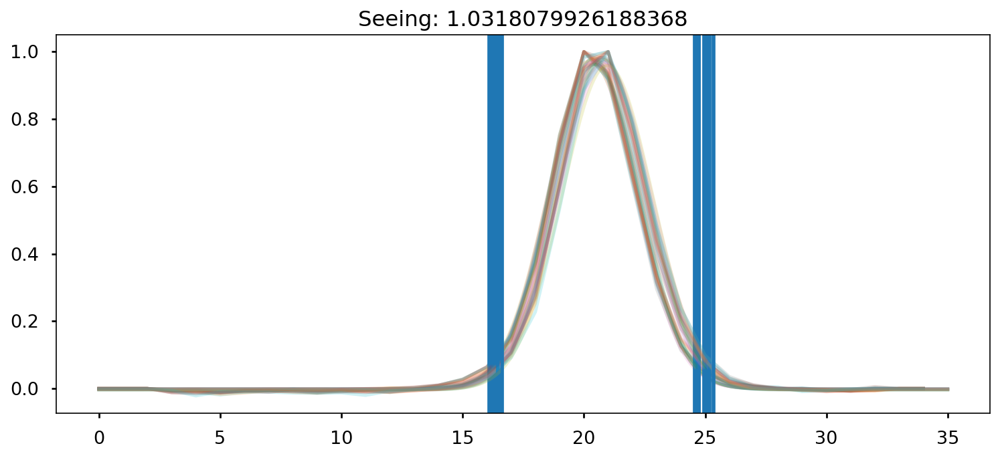

Mediana espectro estrella:  34.985504
Mediana fluxcal:  5.0918414700945696e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31180279]
calib Data:  [1.0133165]


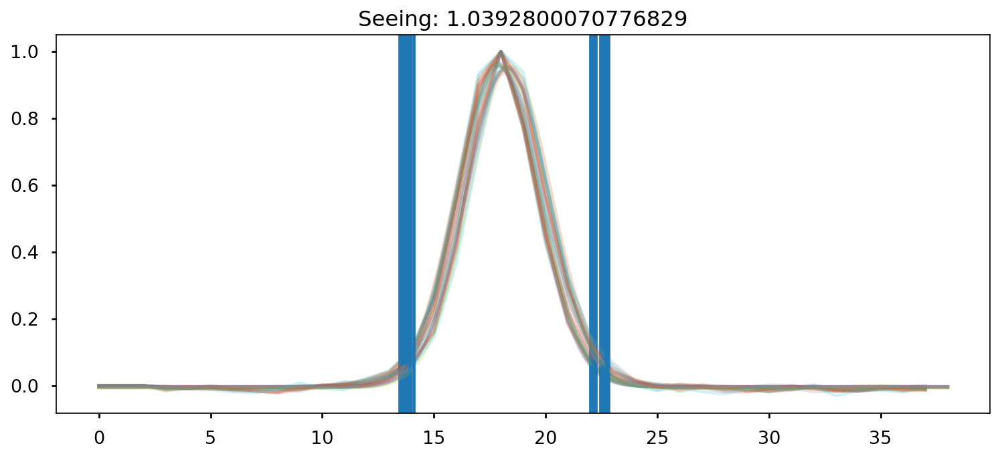

Mediana espectro estrella:  19.884436
Mediana fluxcal:  5.297032140625399e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.89372001]
calib Data:  [0.99798498]
Fcalib :  [5.49204066e-18 5.49141392e-18 5.49078751e-18 ... 7.03158207e-18
 7.03275613e-18 7.03393051e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean005_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean005_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
mask2_2


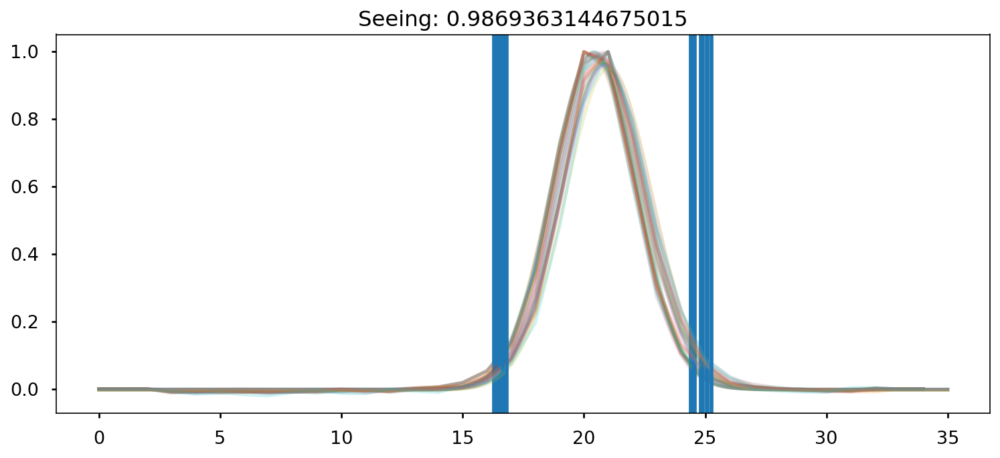

Mediana espectro estrella:  37.466793
Mediana fluxcal:  4.799670979261991e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31363897]
calib Data:  [1.01503166]


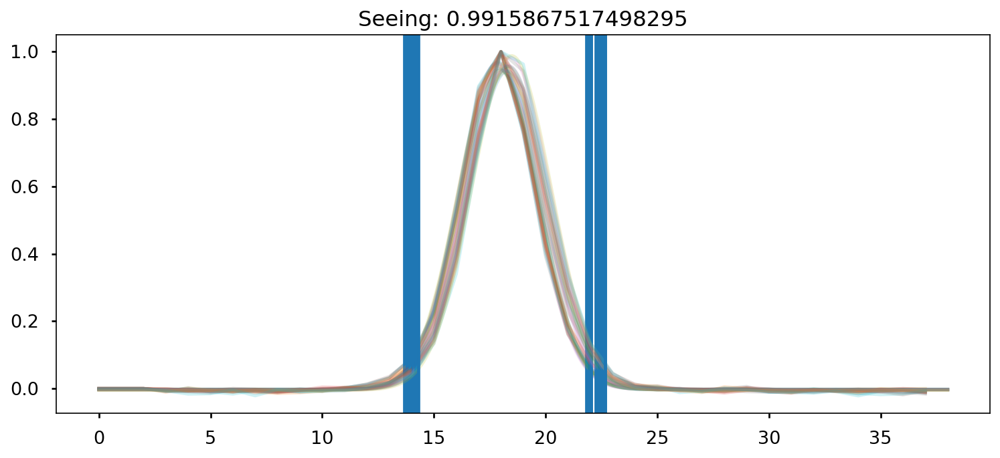

Mediana espectro estrella:  21.393604
Mediana fluxcal:  4.963018133924775e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.90335919]
calib Data:  [1.00688455]
Fcalib :  [5.23737114e-18 5.23669250e-18 5.23601420e-18 ... 6.72220979e-18
 6.72341633e-18 6.72462320e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean006_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean006_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
mask2_2


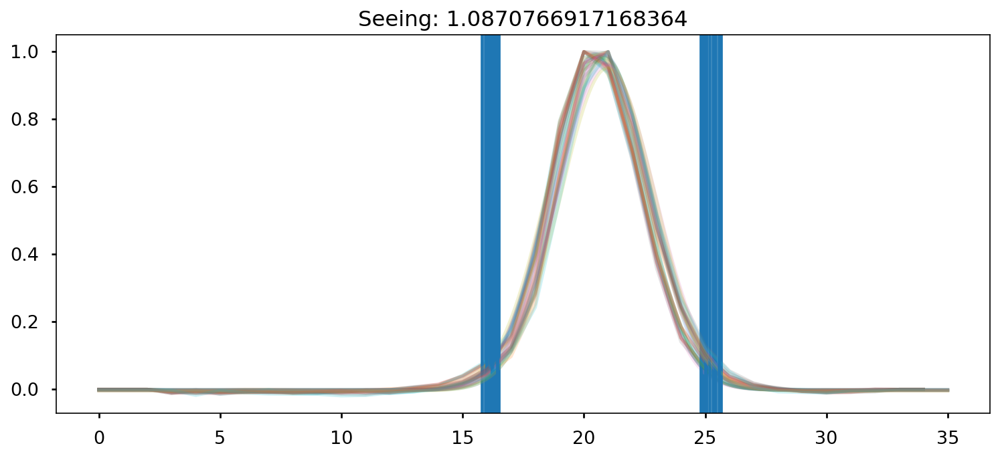

Mediana espectro estrella:  35.127296
Mediana fluxcal:  5.137503777227677e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.29437207]
calib Data:  [0.99717832]


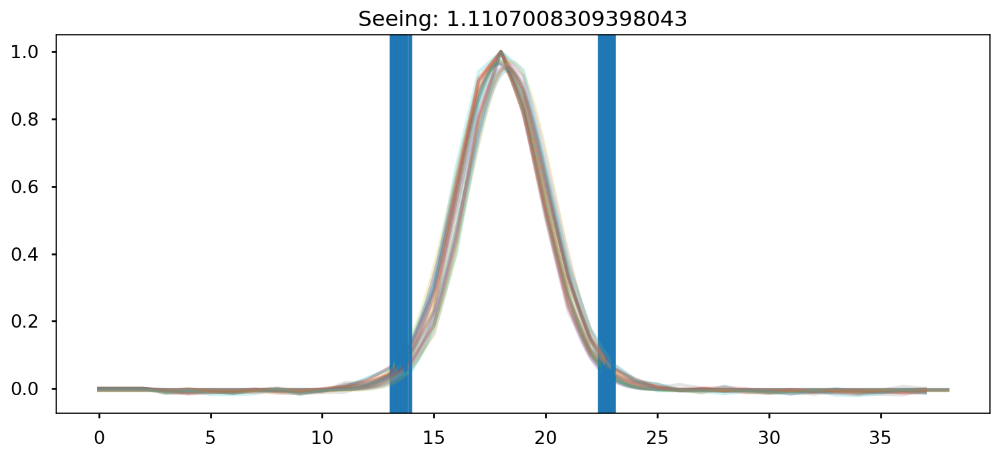

Mediana espectro estrella:  20.212788
Mediana fluxcal:  5.261891371832775e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.88063753]
calib Data:  [0.986032]
Fcalib :  [5.62073041e-18 5.62004309e-18 5.61935610e-18 ... 6.82293362e-18
 6.82404840e-18 6.82516351e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean007_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean007_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
mask2_2


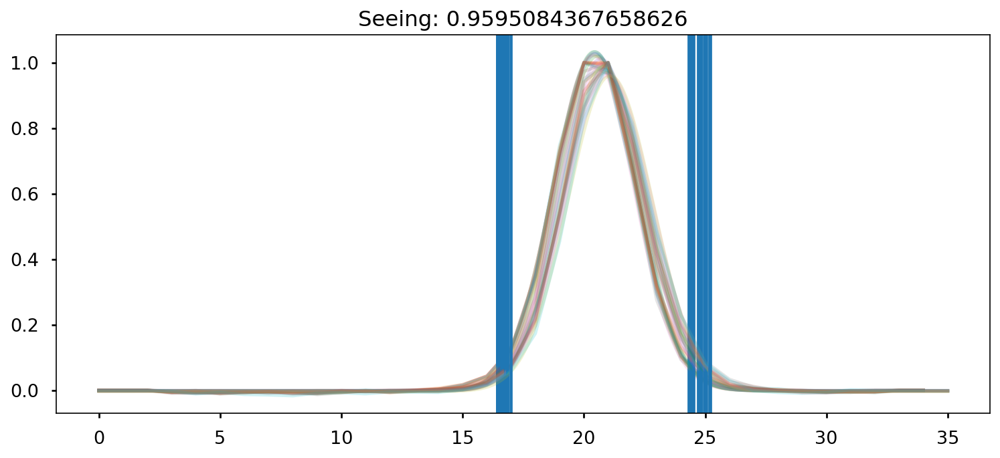

Mediana espectro estrella:  38.35435
Mediana fluxcal:  4.743099632340766e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31048882]
calib Data:  [1.01209091]


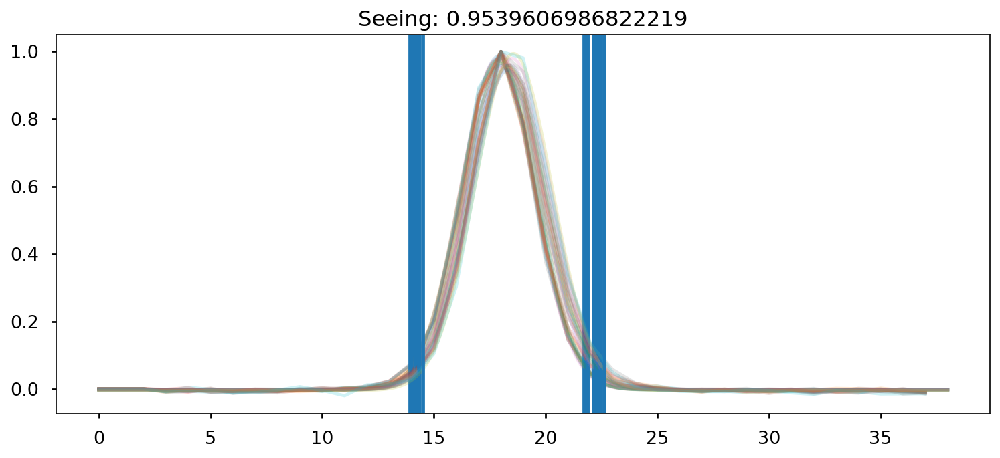

Mediana espectro estrella:  22.153965
Mediana fluxcal:  4.822900557469452e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.89322724]
calib Data:  [0.99753214]
Fcalib :  [5.21117782e-18 5.21048629e-18 5.20979508e-18 ... 6.39793255e-18
 6.39904606e-18 6.40015989e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean008_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean008_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
mask2_2


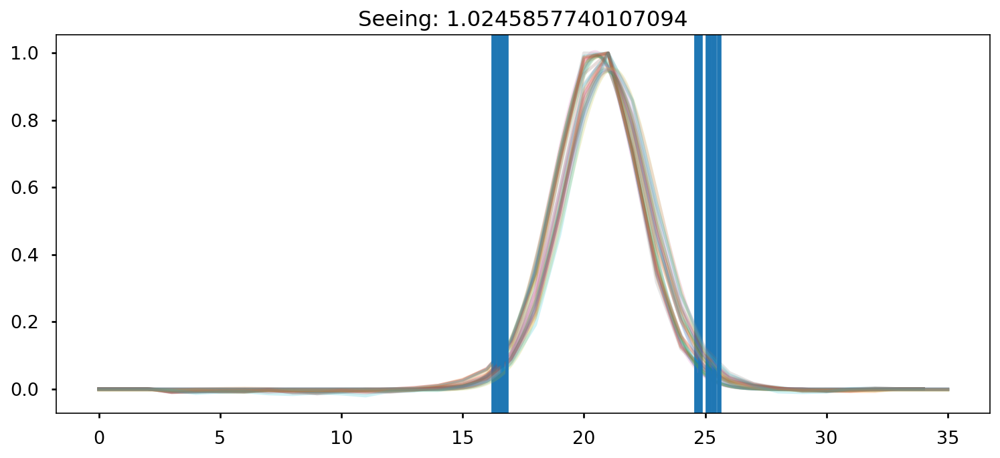

Mediana espectro estrella:  36.37356
Mediana fluxcal:  4.9431001019323995e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.30939852]
calib Data:  [1.01107508]


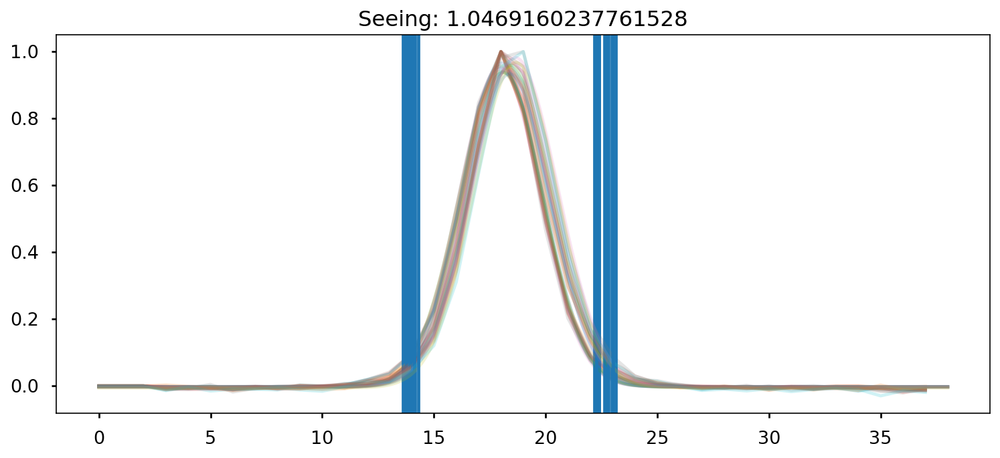

Mediana espectro estrella:  20.963848
Mediana fluxcal:  5.0945150198692774e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.87880204]
calib Data:  [0.98436648]
Fcalib :  [5.43643481e-18 5.43572247e-18 5.43501046e-18 ... 6.77583475e-18
 6.77702333e-18 6.77821224e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean009_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean009_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
mask2_2


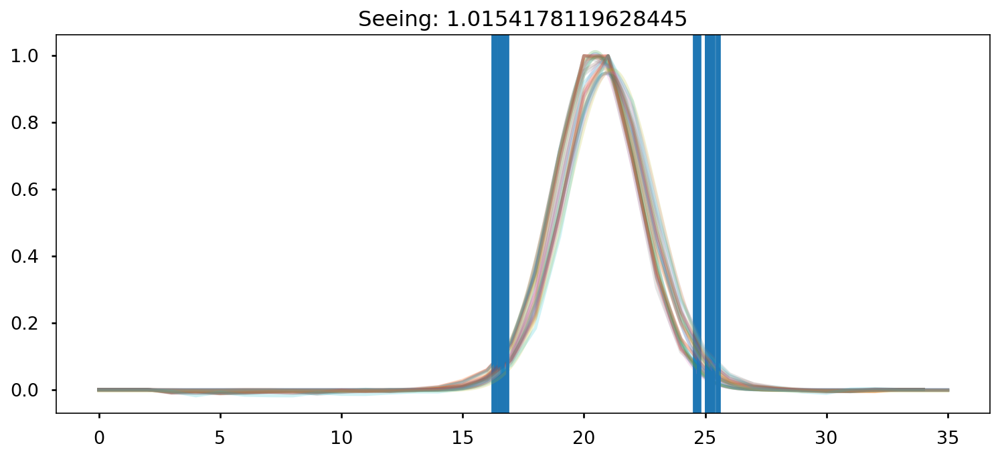

Mediana espectro estrella:  36.869644
Mediana fluxcal:  4.896156581944745e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.30493734]
calib Data:  [1.00692921]


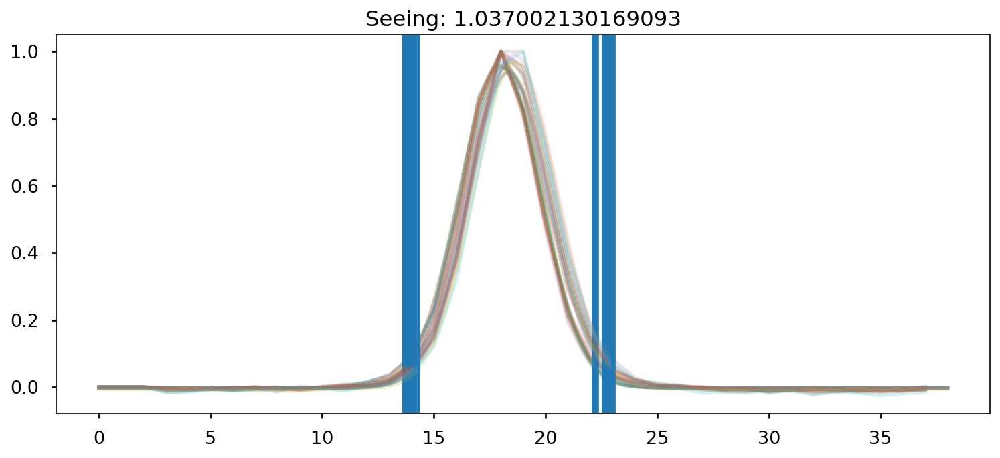

Mediana espectro estrella:  21.14626
Mediana fluxcal:  5.054335730829258e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.88119946]
calib Data:  [0.98654246]
Fcalib :  [5.38407524e-18 5.38334605e-18 5.38261721e-18 ... 6.84692573e-18
 6.84817503e-18 6.84942467e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean010_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean010_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
mask2_2


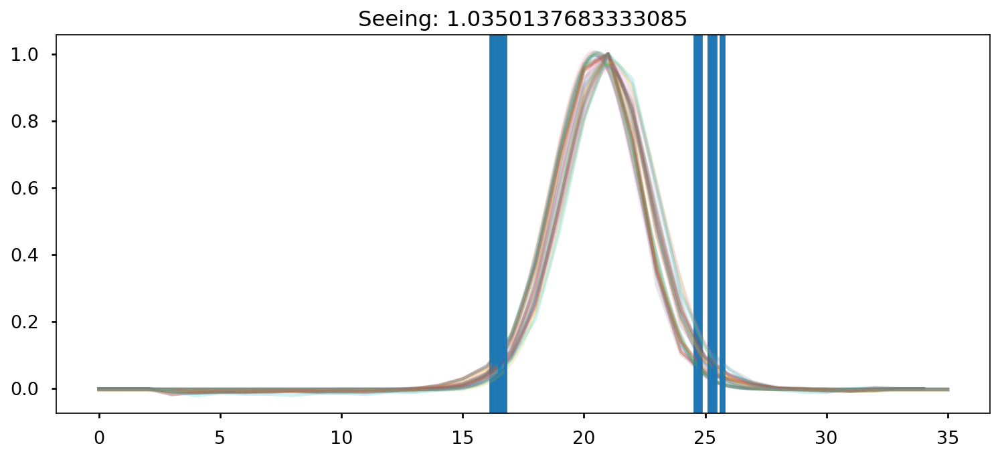

Mediana espectro estrella:  33.615772
Mediana fluxcal:  5.399213624648442e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.30003447]
calib Data:  [1.00239245]


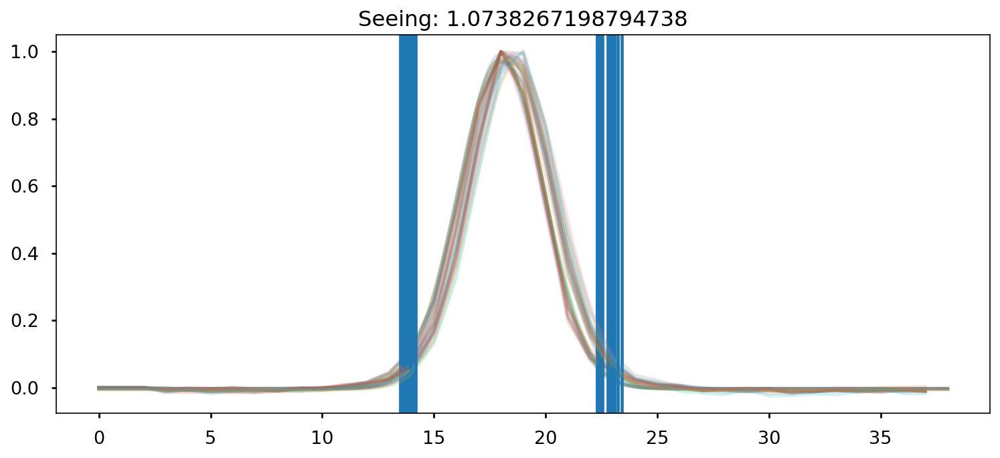

Mediana espectro estrella:  19.743849
Mediana fluxcal:  5.451539669100354e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.87909093]
calib Data:  [0.98462843]
Fcalib :  [6.01971695e-18 6.01883175e-18 6.01794695e-18 ... 7.32565144e-18
 7.32700103e-18 7.32835102e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean011_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0320/obj_clean011_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0320
mask2_2


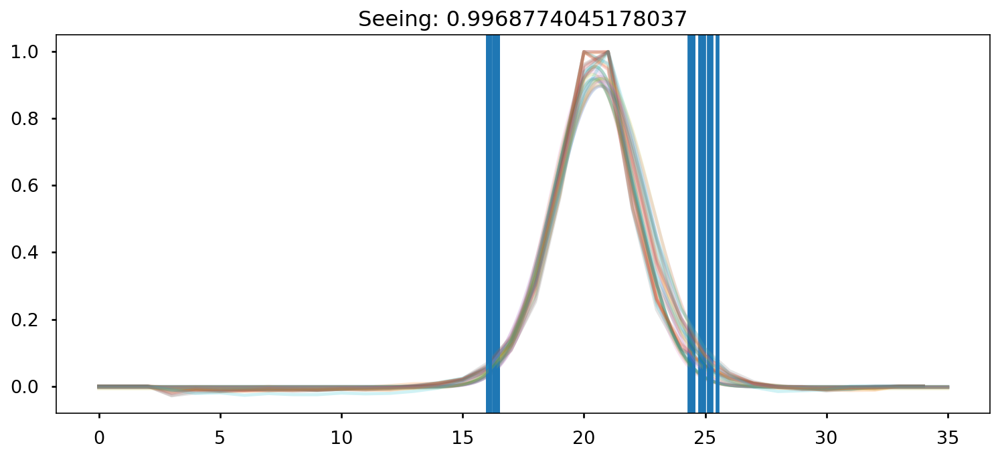

Mediana espectro estrella:  33.754765
Mediana fluxcal:  5.480651084564601e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31227224]
calib Data:  [1.01375474]


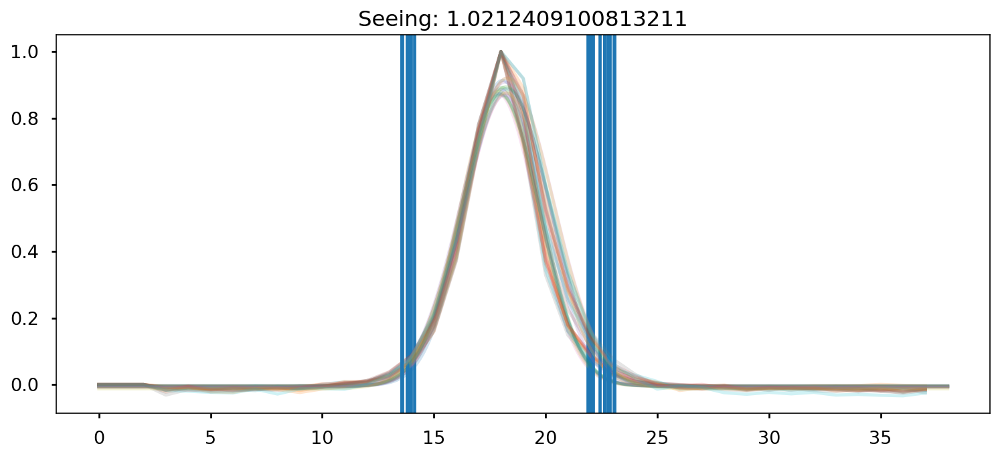

Mediana espectro estrella:  19.570385
Mediana fluxcal:  5.5528257390156646e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.89821497]
calib Data:  [1.00212521]
Fcalib :  [6.19732917e-18 6.19631979e-18 6.19531086e-18 ... 7.67031835e-18
 7.67185154e-18 7.67338518e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean000_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean000_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
mask2_2


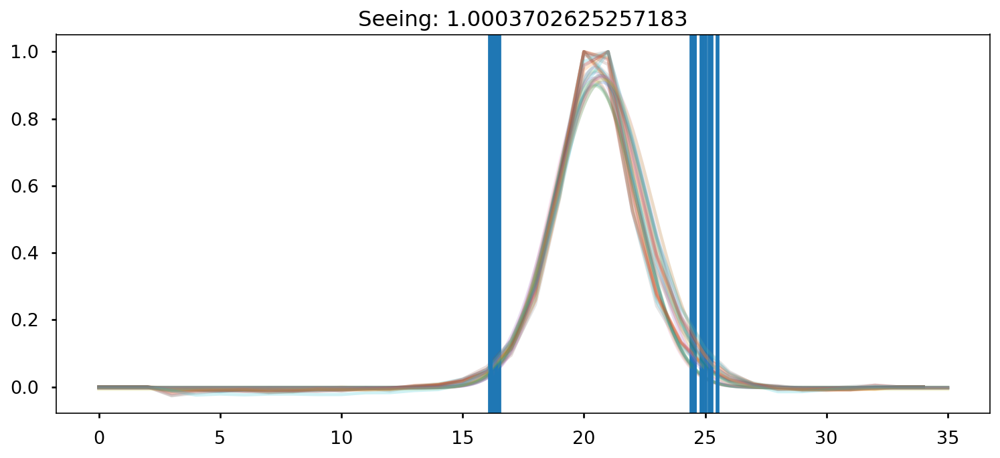

Mediana espectro estrella:  34.694702
Mediana fluxcal:  5.354064813513724e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31163048]
calib Data:  [1.0131557]


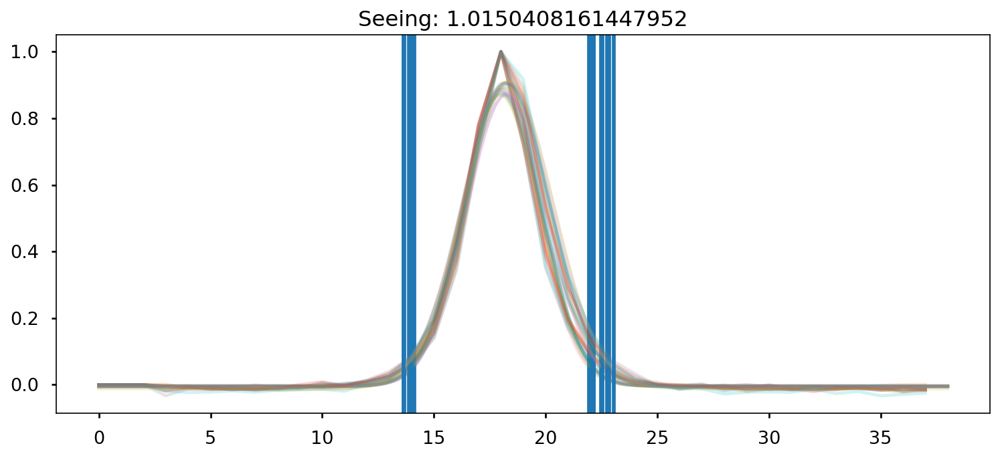

Mediana espectro estrella:  20.255924
Mediana fluxcal:  5.38120915692419e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.89825066]
calib Data:  [1.00215815]
Fcalib :  [6.02439106e-18 6.02339112e-18 6.02239162e-18 ... 7.56405176e-18
 7.56559921e-18 7.56714711e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean001_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean001_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
mask2_2


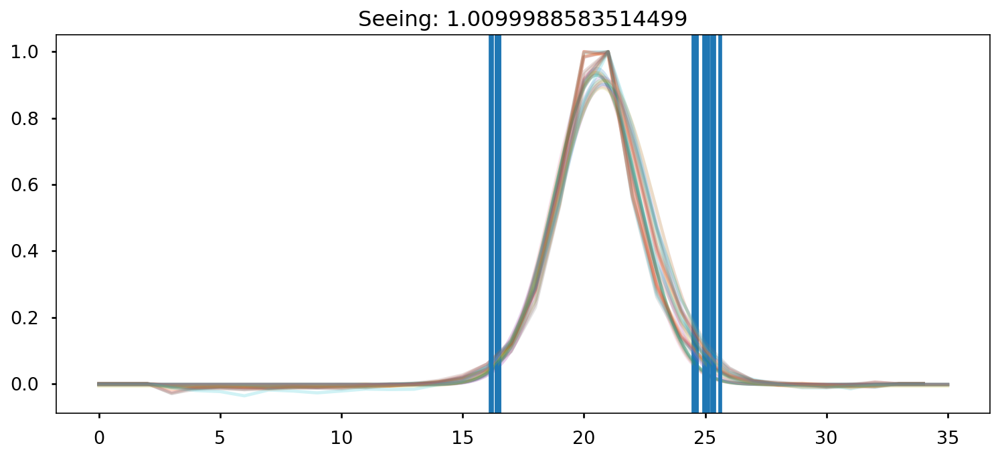

Mediana espectro estrella:  34.336906
Mediana fluxcal:  5.428871917847842e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31387151]
calib Data:  [1.01524908]


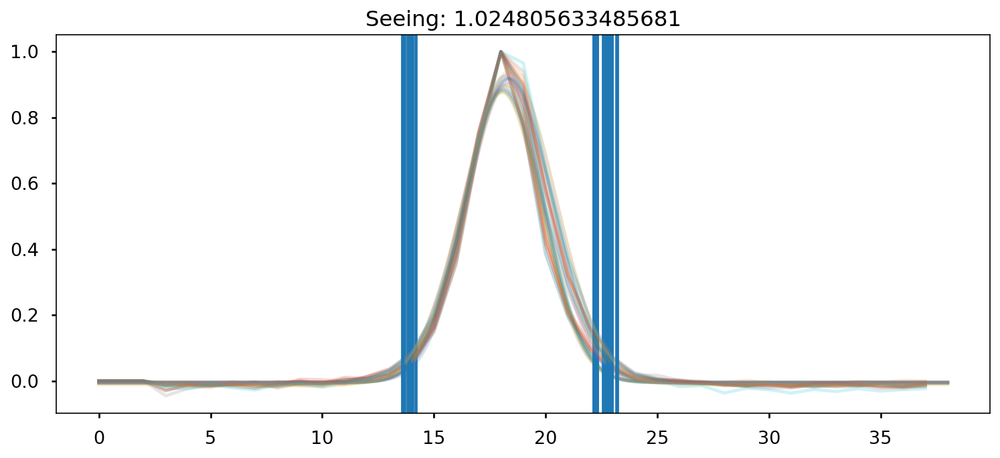

Mediana espectro estrella:  19.891712
Mediana fluxcal:  5.4422879335431715e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.89731809]
calib Data:  [1.00129774]
Fcalib :  [6.06343295e-18 6.06239850e-18 6.06136454e-18 ... 7.90021473e-18
 7.90190227e-18 7.90359030e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean002_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean002_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
mask2_2


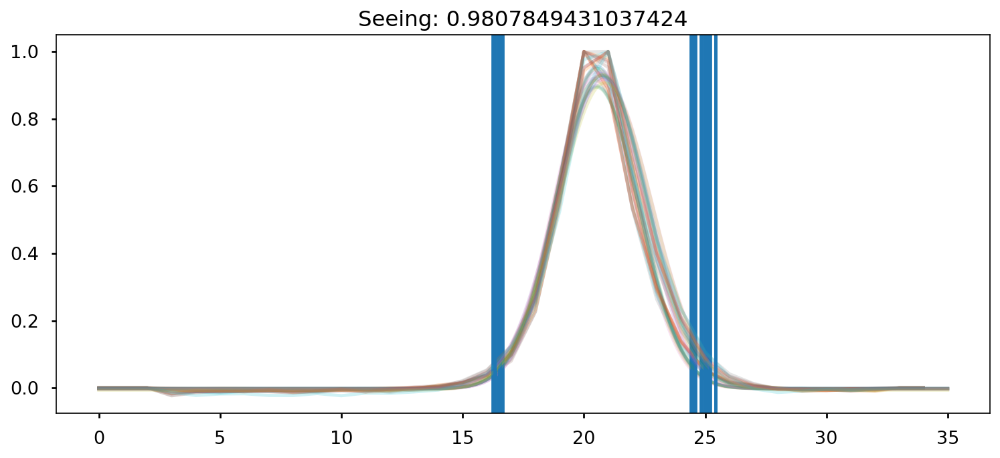

Mediana espectro estrella:  34.966343
Mediana fluxcal:  5.302429294217039e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.30626931]
calib Data:  [1.00816525]


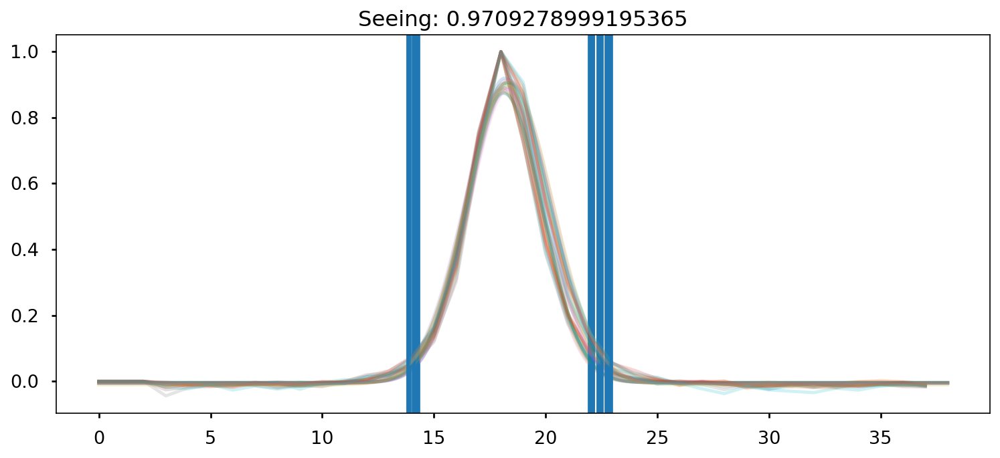

Mediana espectro estrella:  20.494488
Mediana fluxcal:  5.2934278427535995e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.88757559]
calib Data:  [0.99235311]
Fcalib :  [5.90748169e-18 5.90652441e-18 5.90556757e-18 ... 7.47266196e-18
 7.47417579e-18 7.47569006e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean003_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean003_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
mask2_2


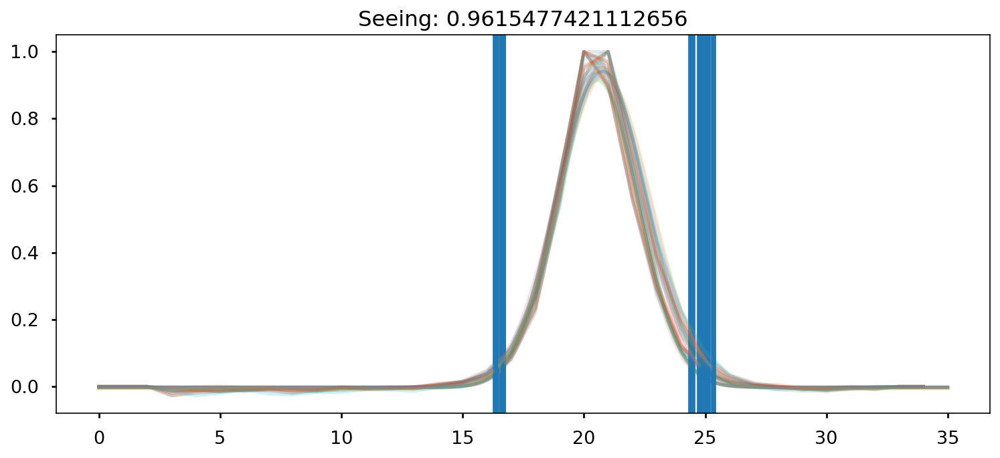

Mediana espectro estrella:  35.431606
Mediana fluxcal:  5.233038626058725e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31749322]
calib Data:  [1.01864132]


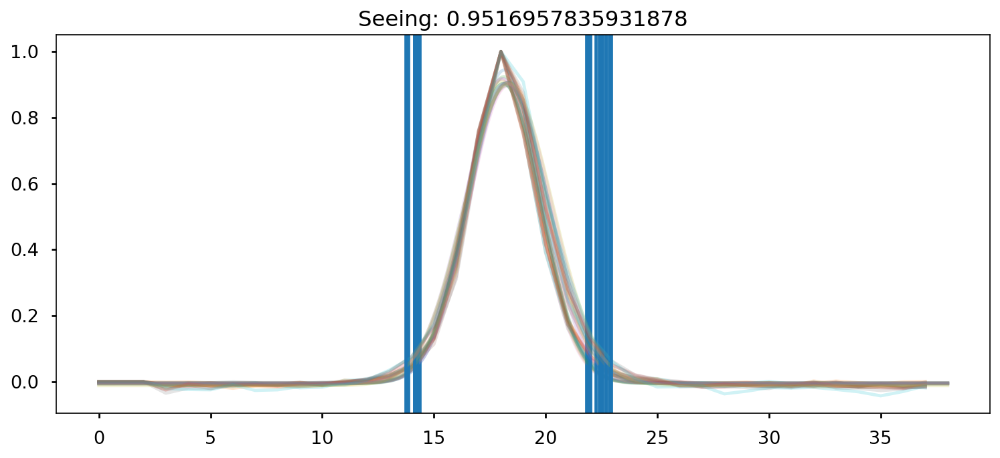

Mediana espectro estrella:  20.553772
Mediana fluxcal:  5.257062809923719e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.91831078]
calib Data:  [1.02084619]
Fcalib :  [5.75882976e-18 5.75789239e-18 5.75695548e-18 ... 7.70109505e-18
 7.70272296e-18 7.70435134e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean004_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean004_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
mask2_2


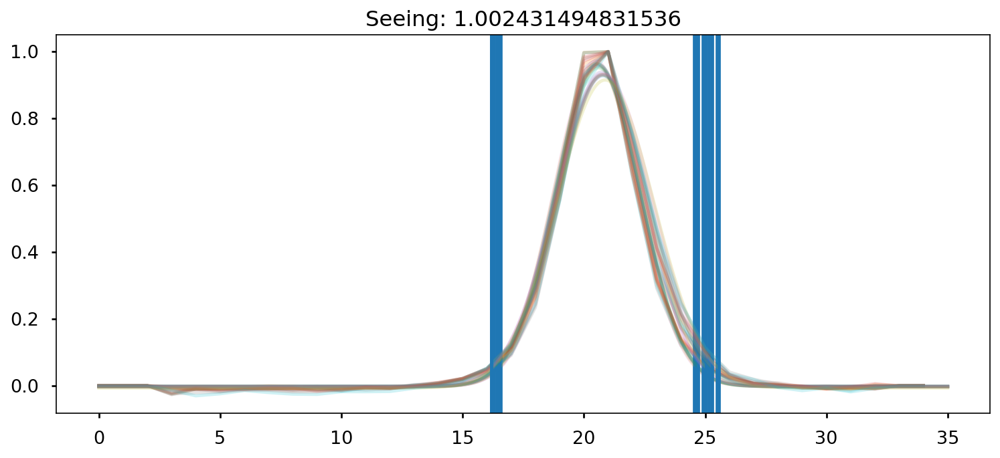

Mediana espectro estrella:  34.473804
Mediana fluxcal:  5.2613743942864046e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31747133]
calib Data:  [1.01862078]


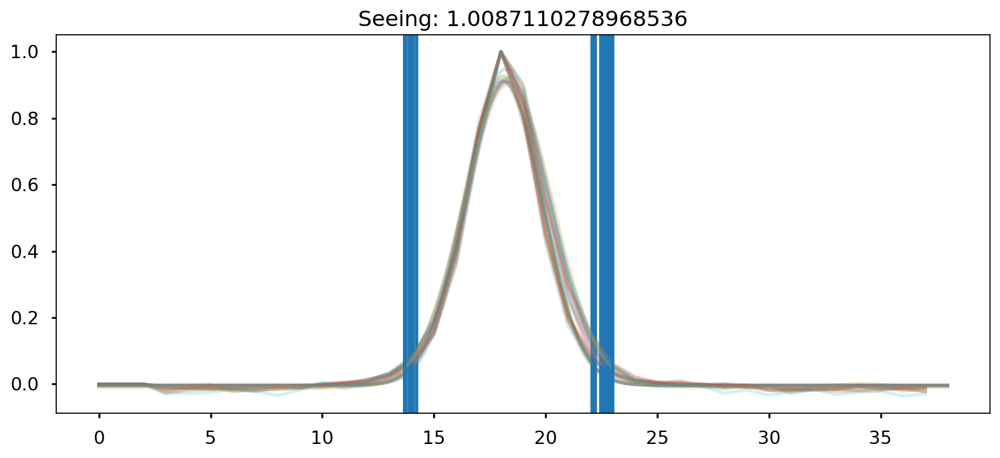

Mediana espectro estrella:  19.973766
Mediana fluxcal:  5.413337305480057e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.89518619]
calib Data:  [0.99933357]
Fcalib :  [5.74186389e-18 5.74092176e-18 5.73998012e-18 ... 8.29008611e-18
 8.29193412e-18 8.29378264e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean005_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean005_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
mask2_2


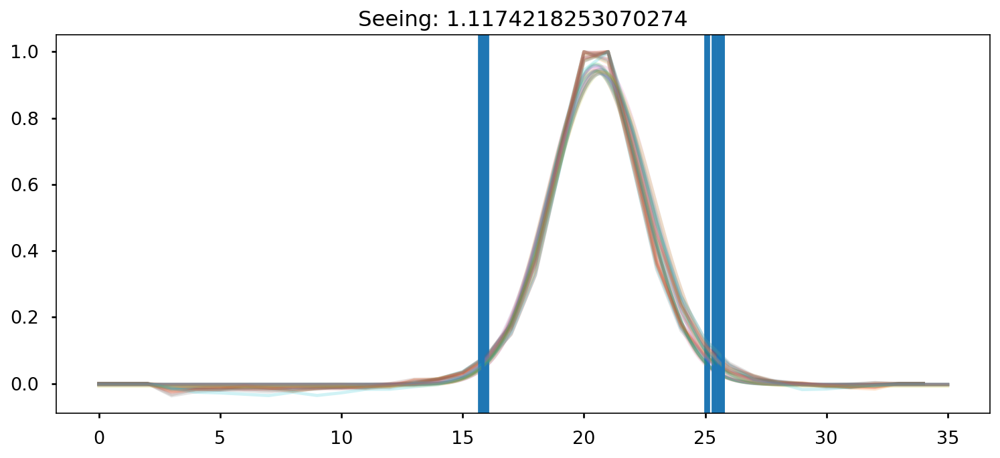

Mediana espectro estrella:  32.47965
Mediana fluxcal:  5.598088465361538e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31740128]
calib Data:  [1.01855506]


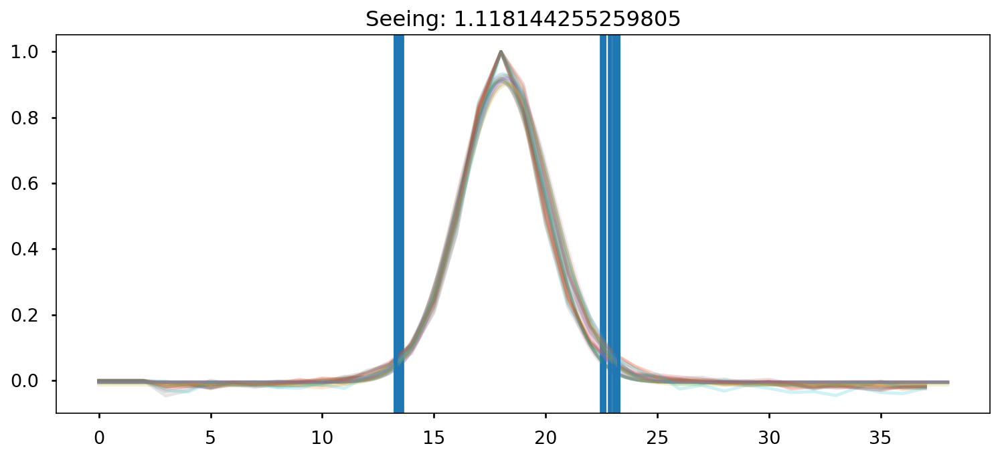

Mediana espectro estrella:  18.648766
Mediana fluxcal:  5.7453666325106905e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.89068881]
calib Data:  [0.99520265]


<ipython-input-21-0b12572c6f73>:34: RuntimeWarning: invalid value encountered in power
  transmission_function = np.interp(wave-alpha, wave, trans_std)**beta


Fcalib :  [6.07402449e-18 6.07310483e-18 6.07218565e-18 ... 8.52119758e-18
 8.52298721e-18 8.52477732e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean006_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean006_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
mask2_2


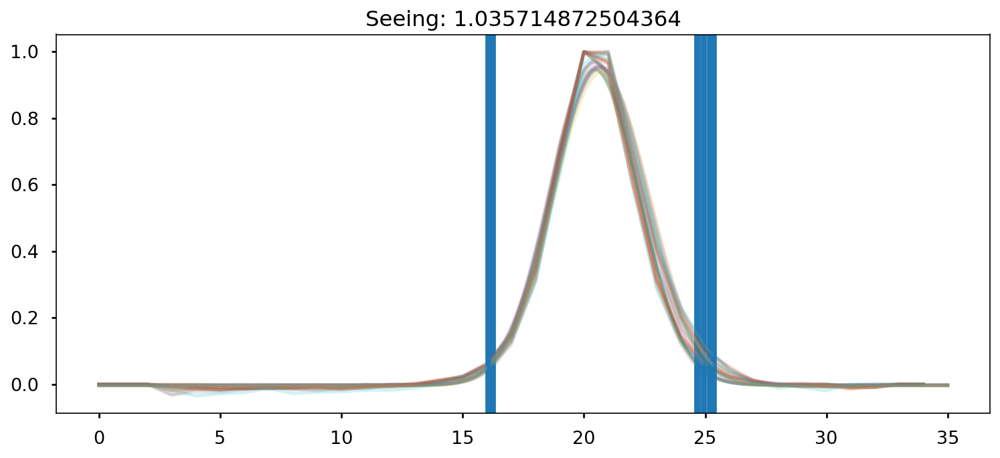

Mediana espectro estrella:  33.353065
Mediana fluxcal:  5.44091023447718e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31320743]
calib Data:  [1.0146283]


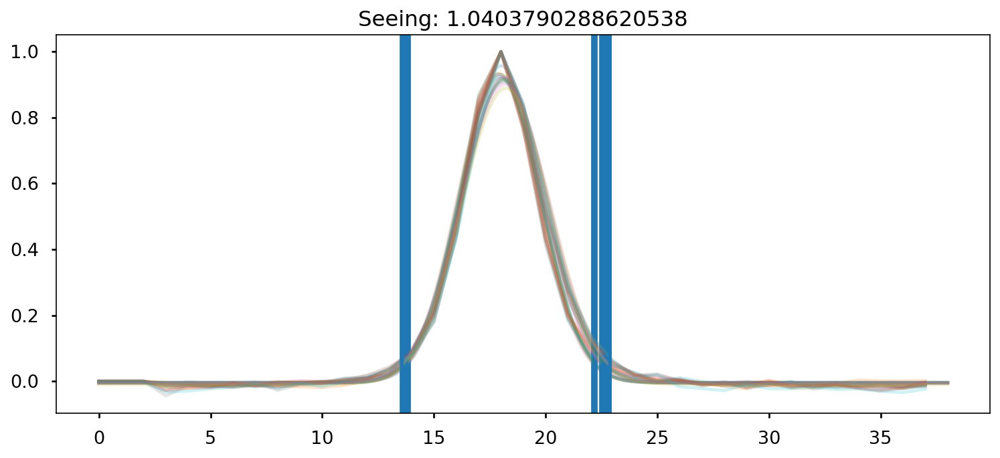

Mediana espectro estrella:  19.145515
Mediana fluxcal:  5.571007259116236e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.8907122]
calib Data:  [0.99522409]
Fcalib :  [5.86870360e-18 5.86781511e-18 5.86692709e-18 ... 8.37949160e-18
 8.38127265e-18 8.38305418e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean007_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean007_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
mask2_2


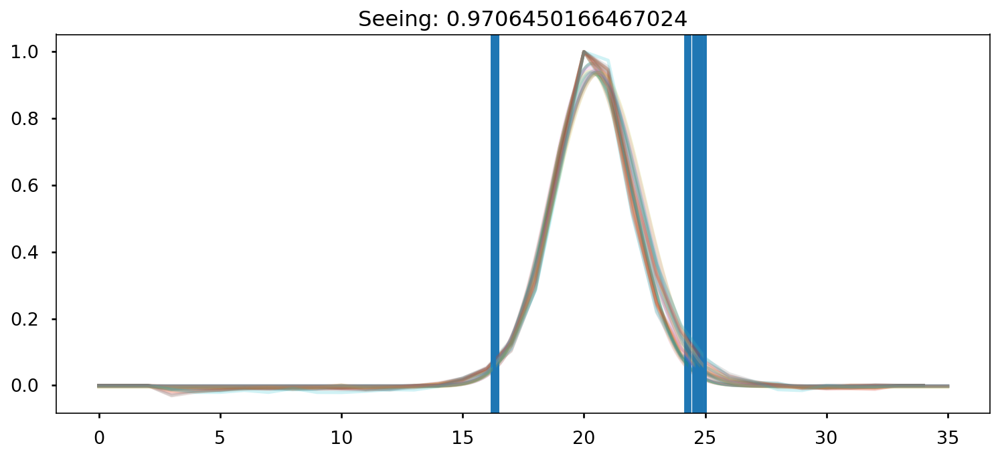

Mediana espectro estrella:  34.401
Mediana fluxcal:  5.265982447400717e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.32023215]
calib Data:  [1.02121424]


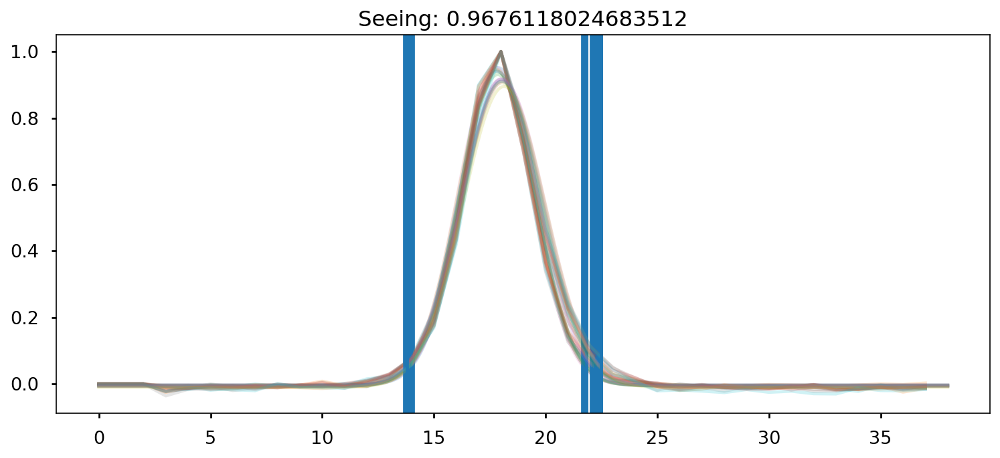

Mediana espectro estrella:  19.502
Mediana fluxcal:  5.467659101386216e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.89979556]
calib Data:  [1.00358514]
Fcalib :  [5.73174130e-18 5.73084250e-18 5.72994418e-18 ... 8.28315437e-18
 8.28496018e-18 8.28676646e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean008_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean008_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
mask2_2


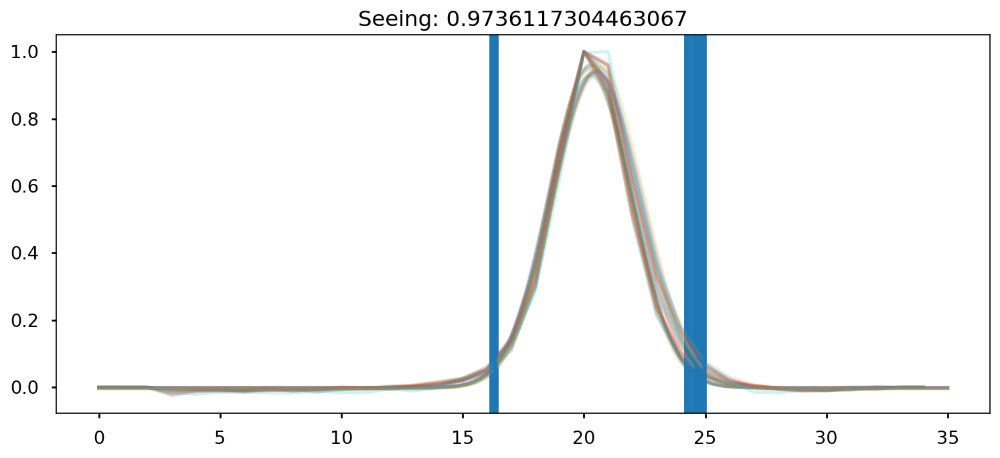

Mediana espectro estrella:  34.621635
Mediana fluxcal:  5.25332493357465e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.32282516]
calib Data:  [1.02365606]


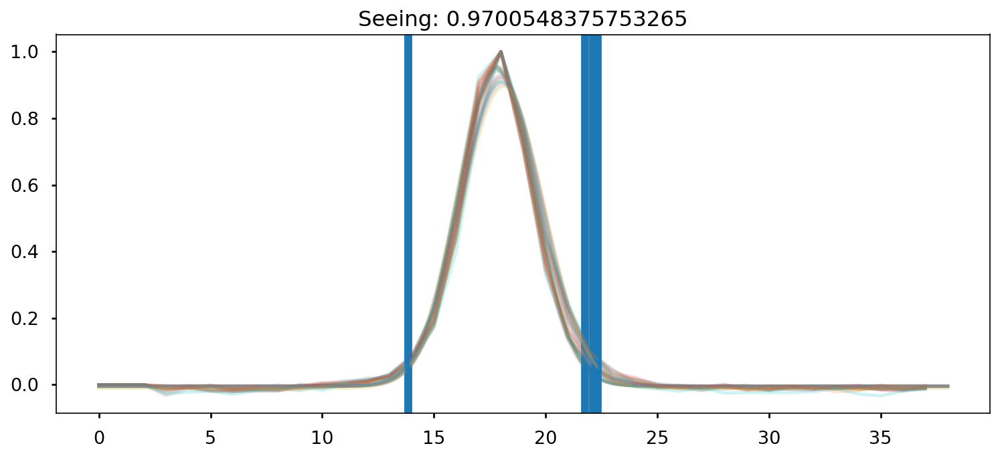

Mediana espectro estrella:  19.591686
Mediana fluxcal:  5.45990493291524e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.90095013]
calib Data:  [1.00465292]
Fcalib :  [5.74053881e-18 5.73957693e-18 5.73861558e-18 ... 8.50888856e-18
 8.51083456e-18 8.51278107e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean009_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean009_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
mask2_2


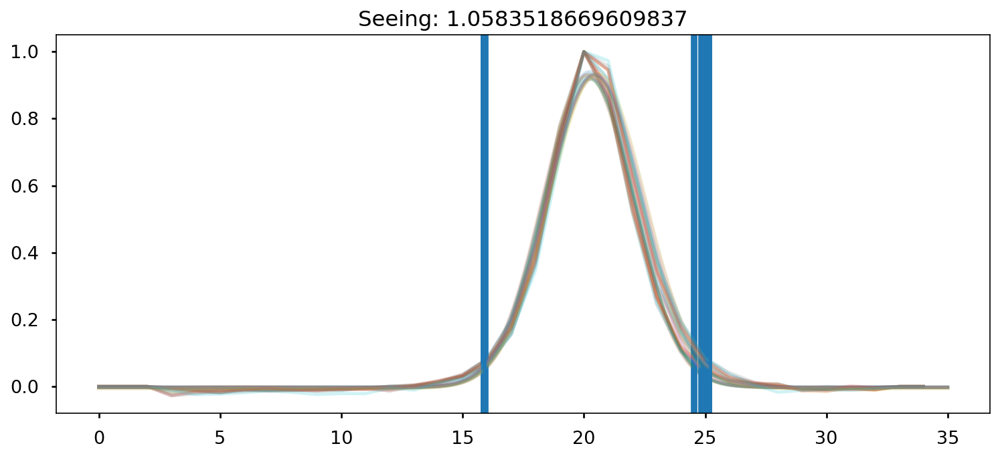

Mediana espectro estrella:  33.233128
Mediana fluxcal:  5.4529811822555564e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31462875]
calib Data:  [1.01595741]


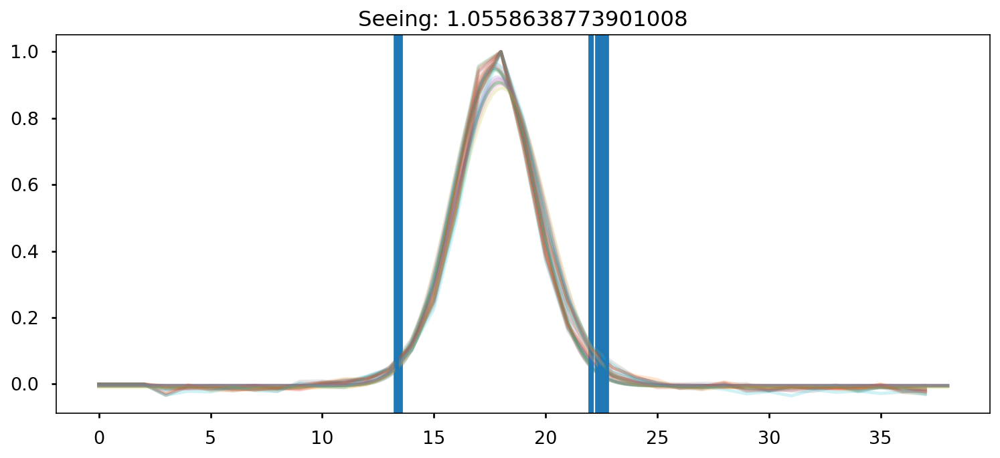

Mediana espectro estrella:  18.802525
Mediana fluxcal:  5.691754806552002e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.89139585]
calib Data:  [0.99585095]
Fcalib :  [5.96511417e-18 5.96416645e-18 5.96321923e-18 ... 8.60930220e-18
 8.61118991e-18 8.61307813e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean010_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean010_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
mask2_2


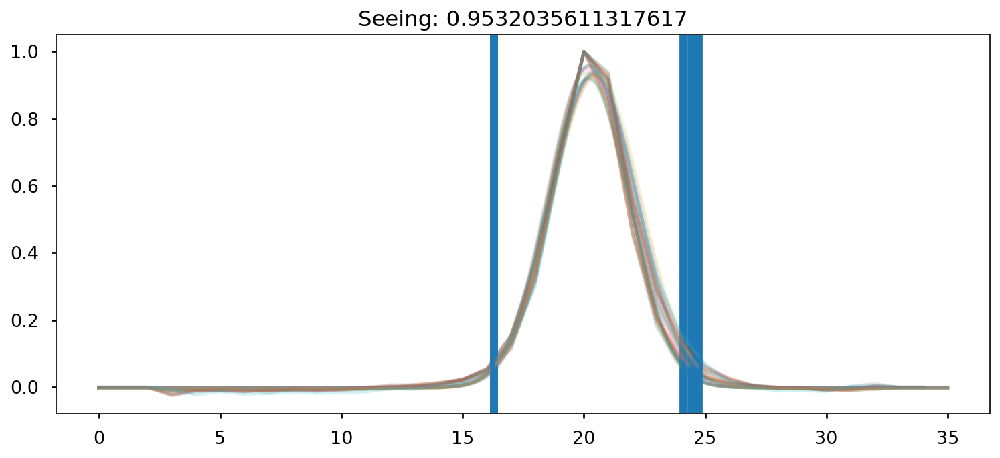

Mediana espectro estrella:  36.07885
Mediana fluxcal:  5.087985600152933e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.30944428]
calib Data:  [1.0111177]


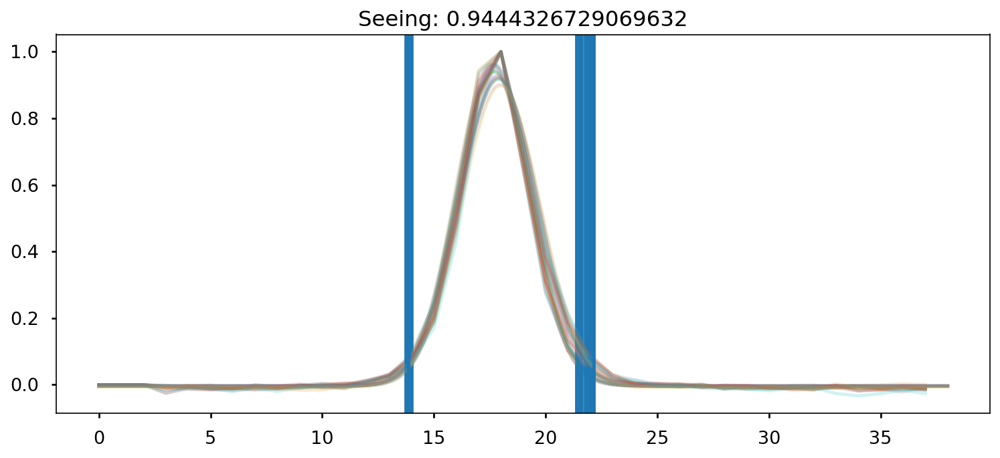

Mediana espectro estrella:  20.807959
Mediana fluxcal:  5.1542870516930804e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.8949353]
calib Data:  [0.99910267]
Fcalib :  [5.58341396e-18 5.58249413e-18 5.58157477e-18 ... 7.70274694e-18
 7.70442024e-18 7.70609399e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean011_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0323/obj_clean011_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0323
mask2_2


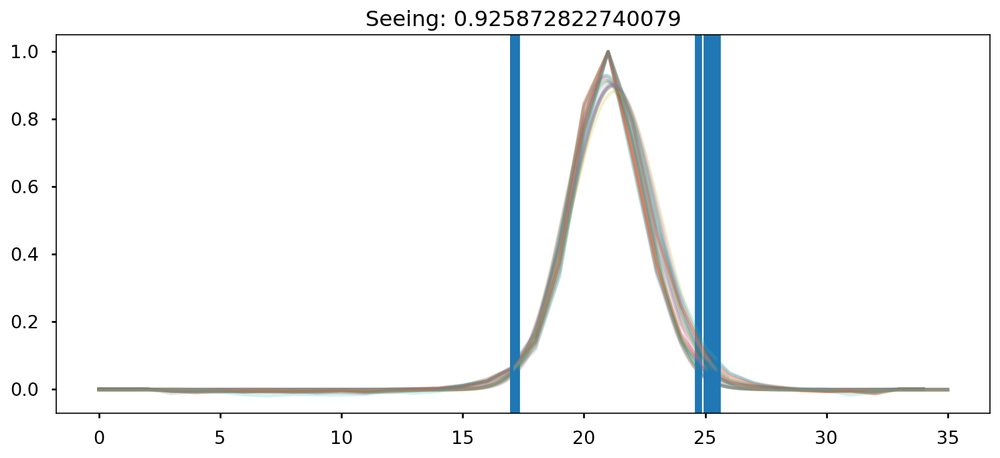

Mediana espectro estrella:  39.251556
Mediana fluxcal:  4.846949037742391e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.3253412]
calib Data:  [1.026031]


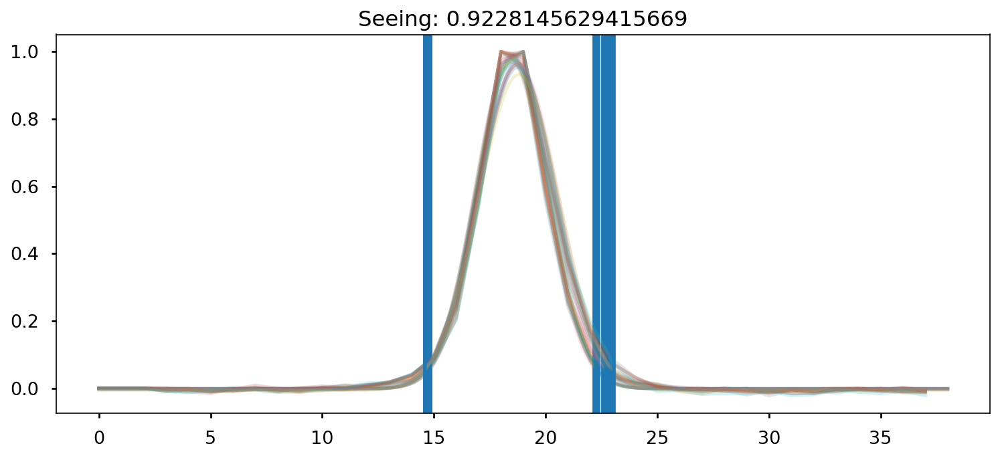

Mediana espectro estrella:  22.327332
Mediana fluxcal:  4.784225991479041e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.89436199]
calib Data:  [0.99857524]
Fcalib :  [5.34839494e-18 5.34716770e-18 5.34594111e-18 ... 8.63471256e-18
 8.63710808e-18 8.63950424e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean000_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean000_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
mask2_2


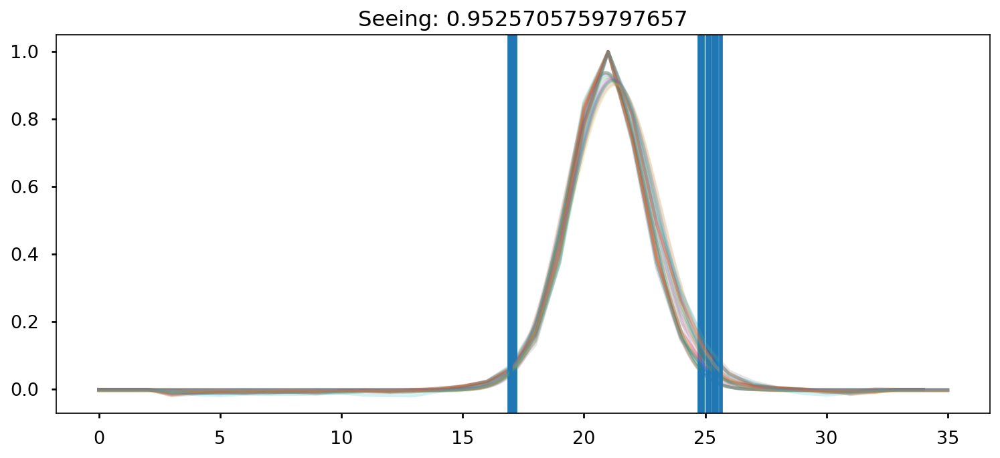

Mediana espectro estrella:  36.817585
Mediana fluxcal:  4.891243675741419e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31539909]
calib Data:  [1.0166785]


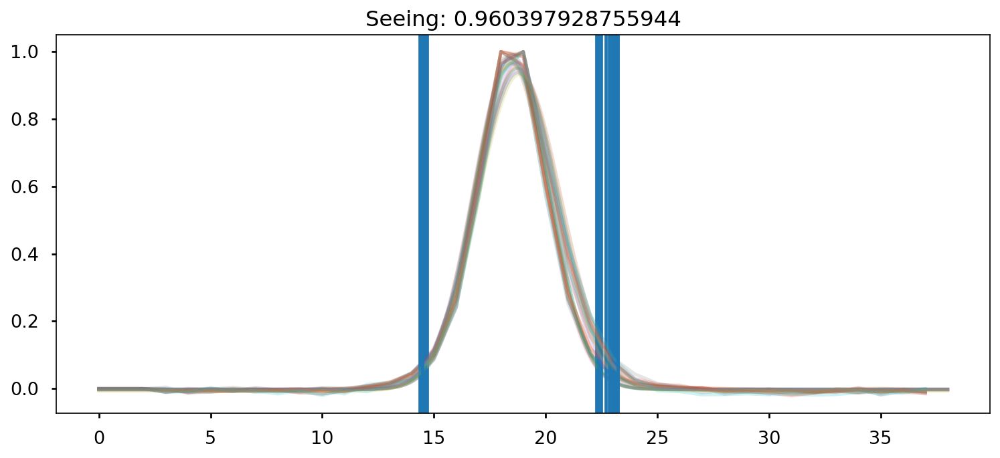

Mediana espectro estrella:  21.0989
Mediana fluxcal:  5.038406643914163e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.89872432]
calib Data:  [1.00259545]
Fcalib :  [5.29065072e-18 5.28972896e-18 5.28880771e-18 ... 8.19378117e-18
 8.19573493e-18 8.19768921e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean001_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean001_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
mask2_2


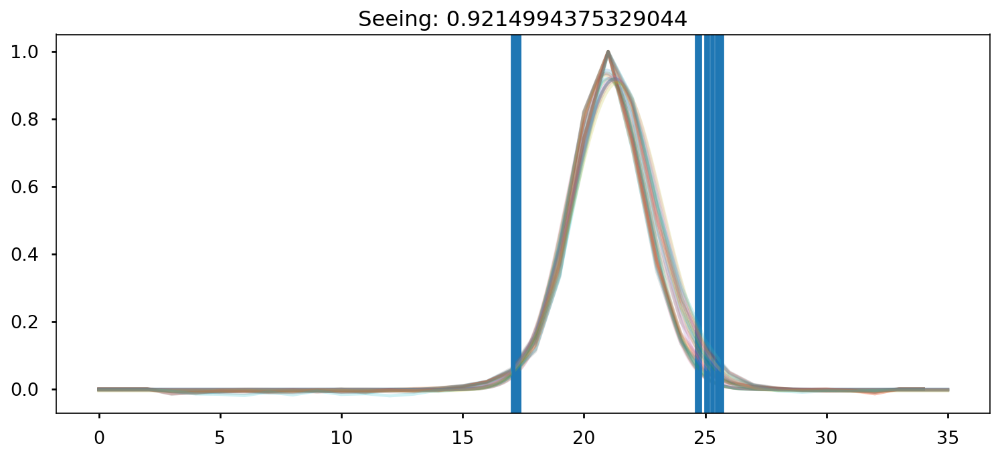

Mediana espectro estrella:  37.056206
Mediana fluxcal:  4.886624886327669e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.32674927]
calib Data:  [1.0273625]


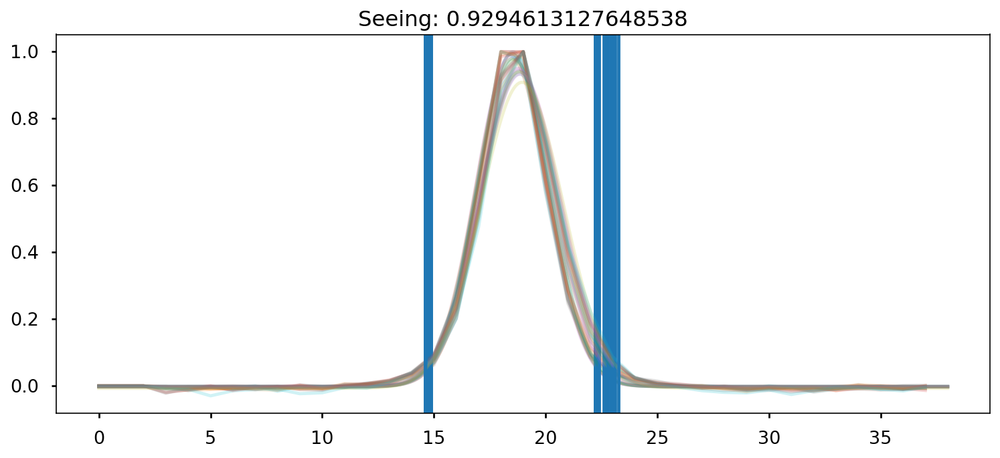

Mediana espectro estrella:  21.0307
Mediana fluxcal:  4.998808771062558e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.8961275]
calib Data:  [1.00020035]
Fcalib :  [5.27281242e-18 5.27190884e-18 5.27100576e-18 ... 8.05466514e-18
 8.05655762e-18 8.05845059e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean002_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean002_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
mask2_2


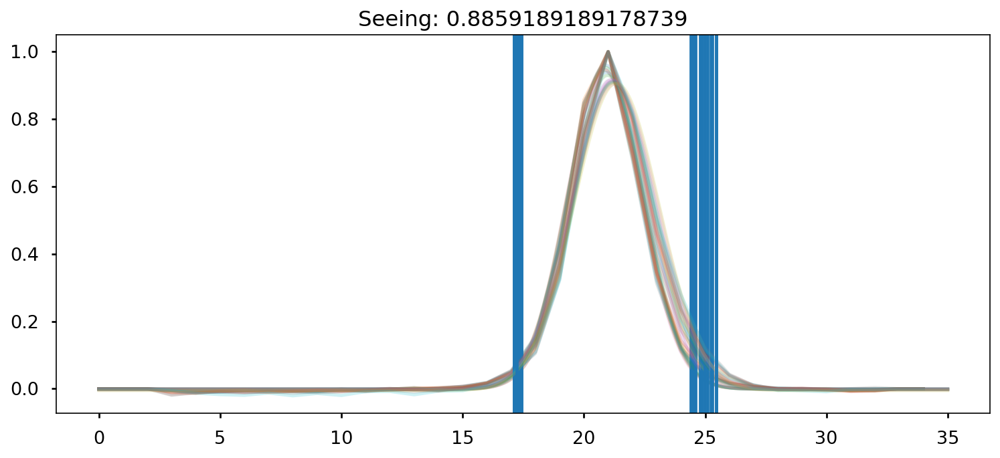

Mediana espectro estrella:  37.59037
Mediana fluxcal:  4.804318552373119e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.32244264]
calib Data:  [1.02329548]


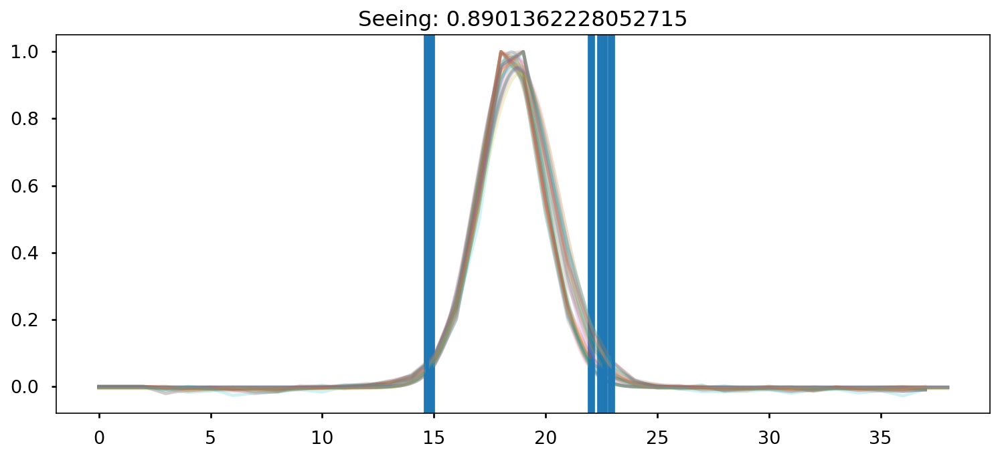

Mediana espectro estrella:  21.422848
Mediana fluxcal:  4.925633118900492e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.90292104]
calib Data:  [1.0064783]
Fcalib :  [5.18468361e-18 5.18382439e-18 5.18296564e-18 ... 7.79443252e-18
 7.79621946e-18 7.79800687e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean003_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean003_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
mask2_2


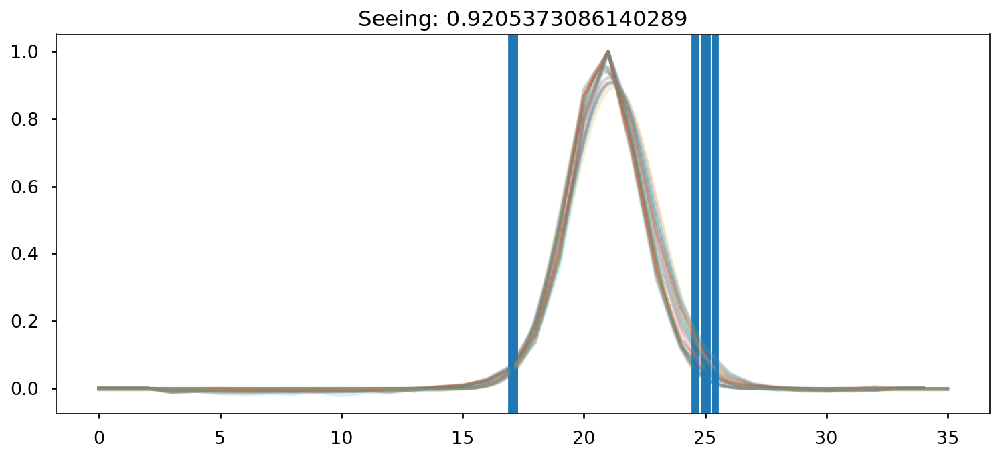

Mediana espectro estrella:  36.44097
Mediana fluxcal:  4.946076175419931e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31266582]
calib Data:  [1.01412229]


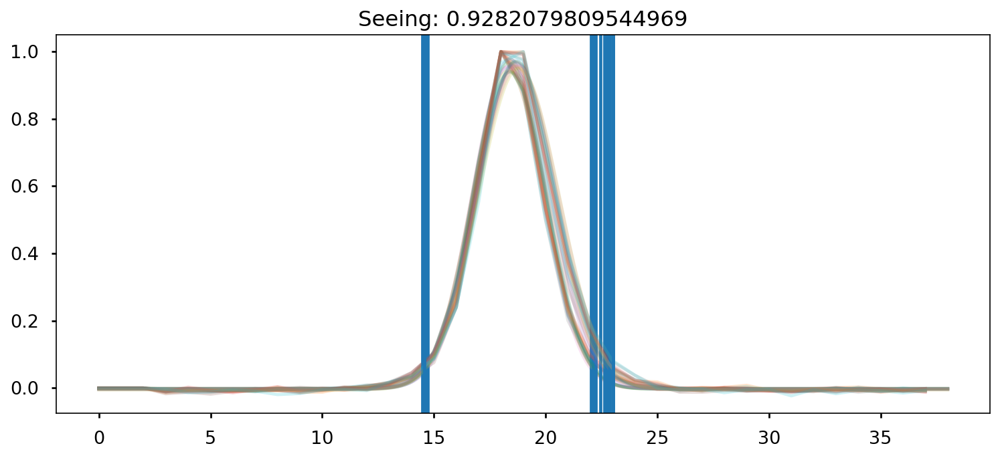

Mediana espectro estrella:  20.776043
Mediana fluxcal:  5.07035456041941e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.91744892]
calib Data:  [1.02003616]
Fcalib :  [5.32314316e-18 5.32223467e-18 5.32132669e-18 ... 8.22212506e-18
 8.22406407e-18 8.22600359e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean004_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean004_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
mask2_2


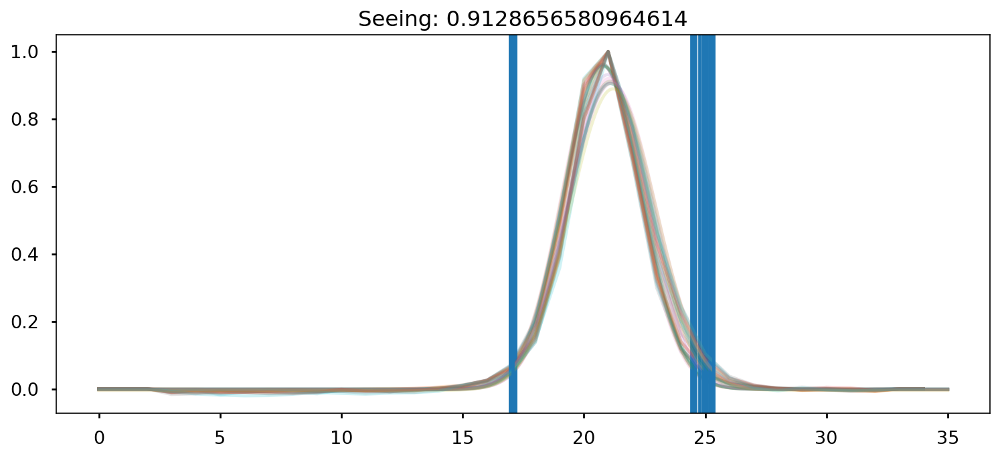

Mediana espectro estrella:  37.604126
Mediana fluxcal:  4.7872861530832225e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.32370638]
calib Data:  [1.02448723]


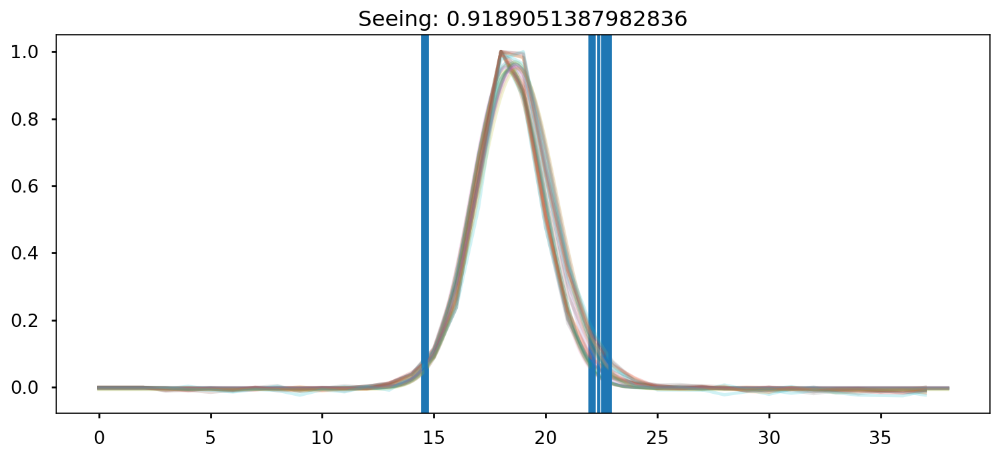

Mediana espectro estrella:  21.537556
Mediana fluxcal:  4.891132659132754e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.89190719]
calib Data:  [0.99632006]
Fcalib :  [5.14635373e-18 5.14546652e-18 5.14457981e-18 ... 7.97932628e-18
 7.98122054e-18 7.98311530e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean005_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean005_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
mask2_2


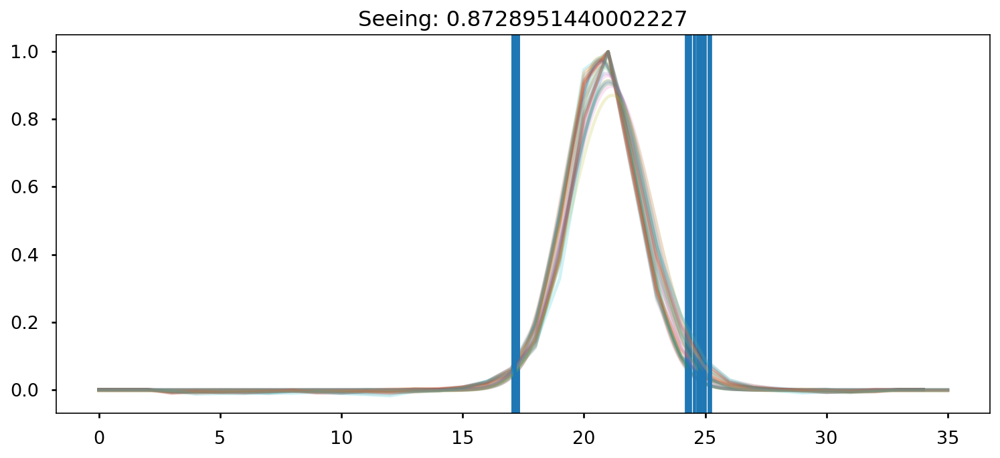

Mediana espectro estrella:  36.757782
Mediana fluxcal:  4.92118675900487e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.3149489]
calib Data:  [1.01625702]


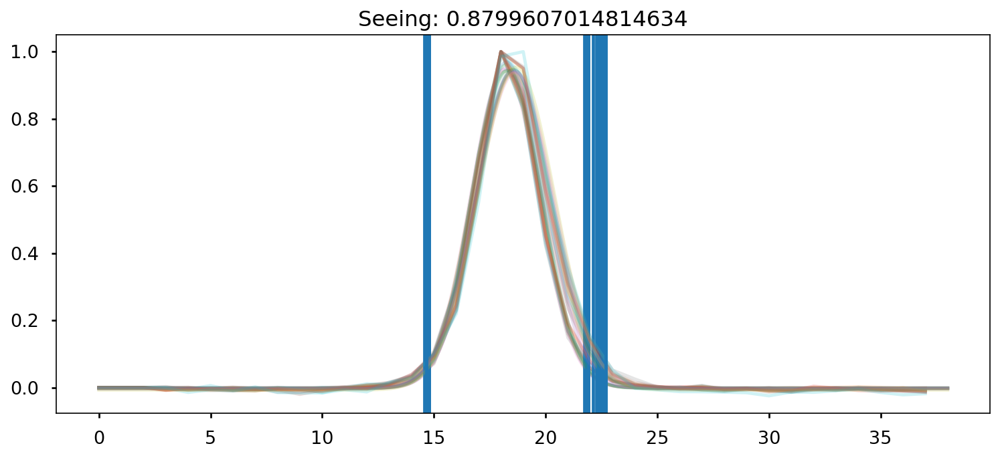

Mediana espectro estrella:  20.965544
Mediana fluxcal:  5.0295174721041674e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.8957855]
calib Data:  [0.99988534]
Fcalib :  [5.29949414e-18 5.29858255e-18 5.29767146e-18 ... 8.15891090e-18
 8.16083896e-18 8.16276752e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean006_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean006_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
mask2_2


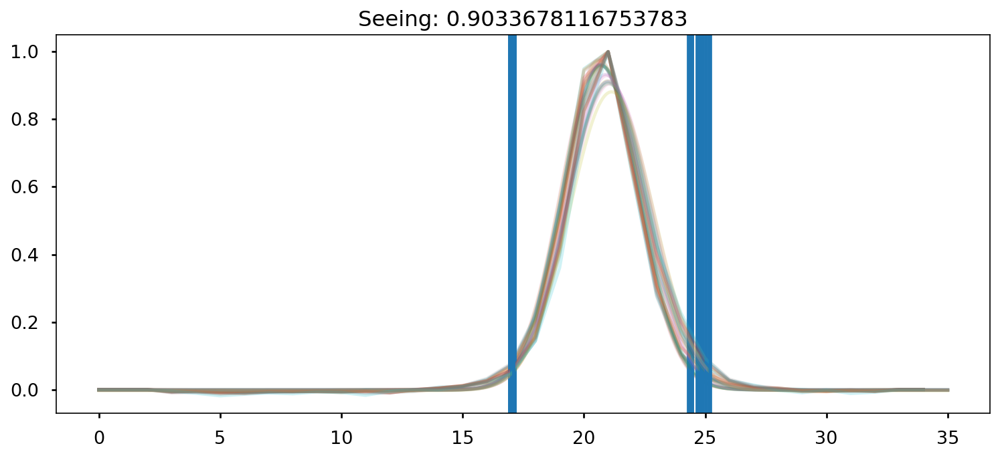

Mediana espectro estrella:  39.83909
Mediana fluxcal:  4.559482172663663e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.32080084]
calib Data:  [1.02174927]


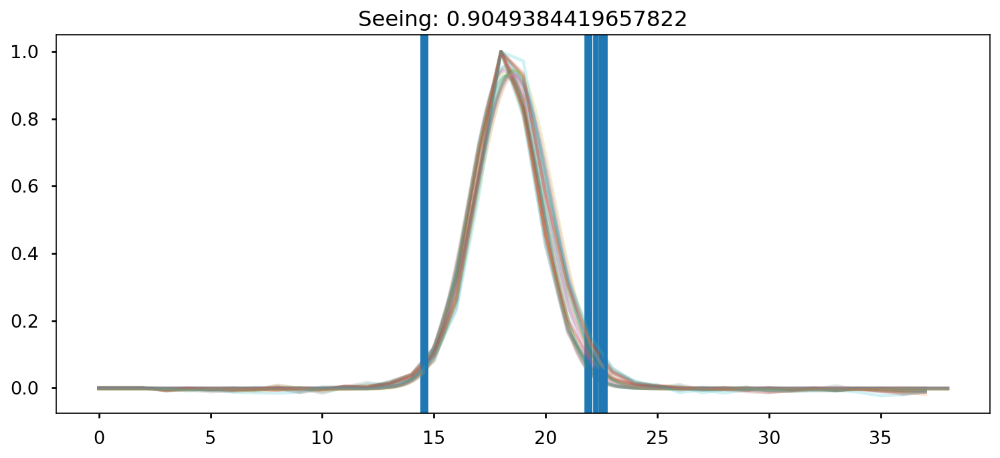

Mediana espectro estrella:  22.9058
Mediana fluxcal:  4.6258590567646706e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.90944551]
calib Data:  [1.01254469]
Fcalib :  [4.93323543e-18 4.93235931e-18 4.93148367e-18 ... 7.50808254e-18
 7.50987398e-18 7.51166590e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean007_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean007_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
mask2_2


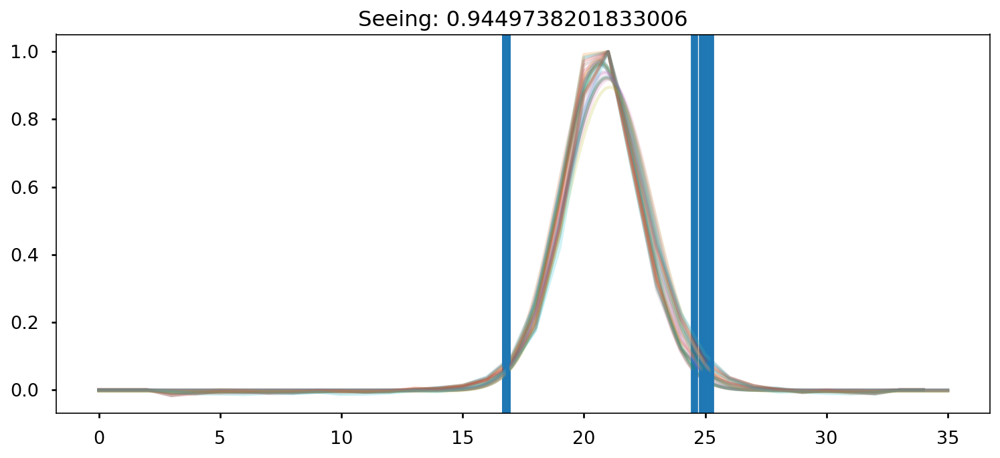

Mediana espectro estrella:  38.35638
Mediana fluxcal:  4.8977390354621966e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.32581066]
calib Data:  [1.02647473]


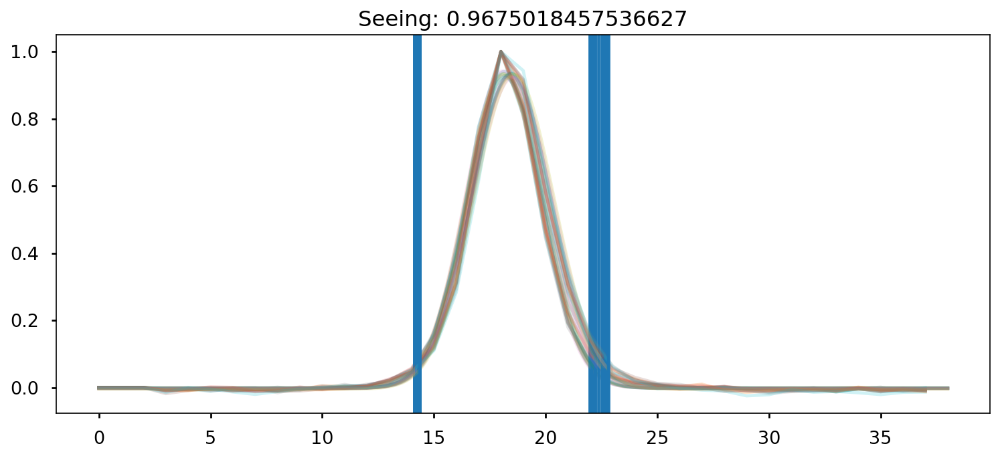

Mediana espectro estrella:  21.835728
Mediana fluxcal:  4.860747757108543e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.90000166]
calib Data:  [1.00377567]
Fcalib :  [5.34284645e-18 5.34164562e-18 5.34044545e-18 ... 8.89090115e-18
 8.89336326e-18 8.89582603e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean008_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean008_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
mask2_2


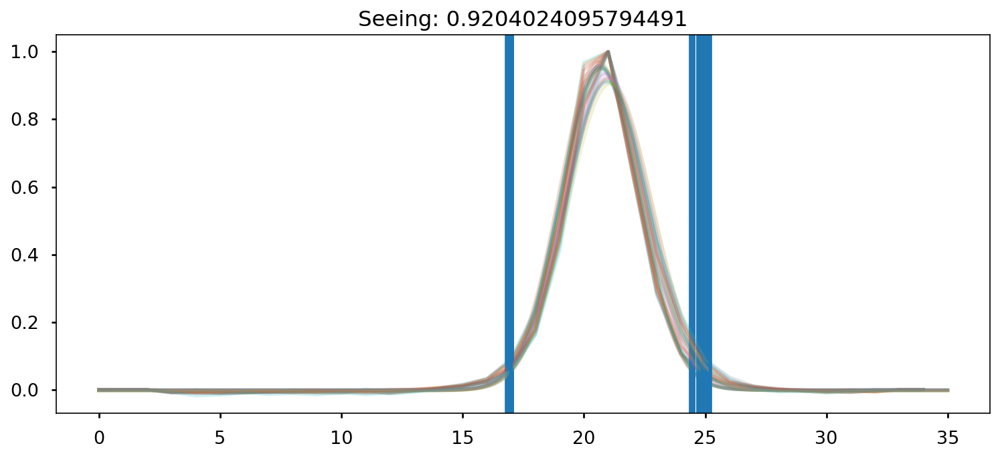

Mediana espectro estrella:  40.078716
Mediana fluxcal:  4.56673768145925e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31689103]
calib Data:  [1.0180765]


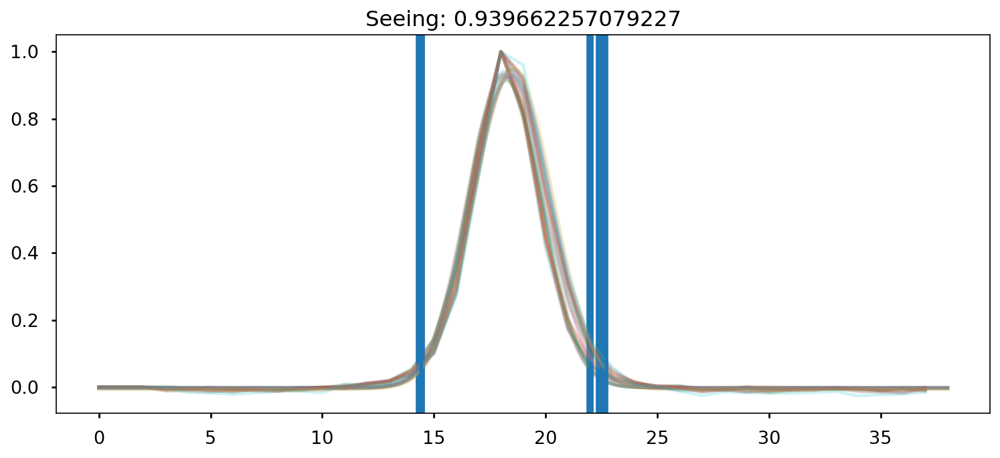

Mediana espectro estrella:  22.805347
Mediana fluxcal:  4.649168801418241e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.90627379]
calib Data:  [1.0095911]
Fcalib :  [4.98043084e-18 4.97954193e-18 4.97865350e-18 ... 7.43703021e-18
 7.43879243e-18 7.44055511e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean009_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean009_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
mask2_2


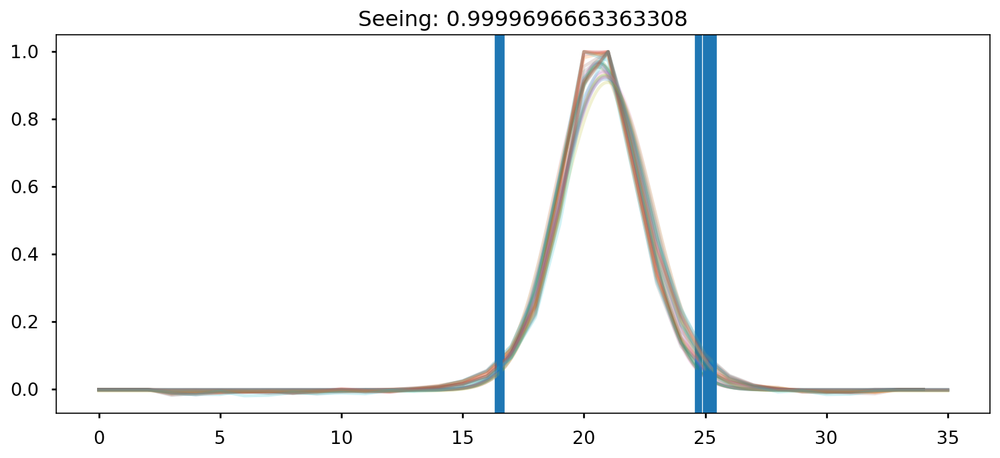

Mediana espectro estrella:  36.454872
Mediana fluxcal:  5.100731731390371e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.32297944]
calib Data:  [1.02380154]


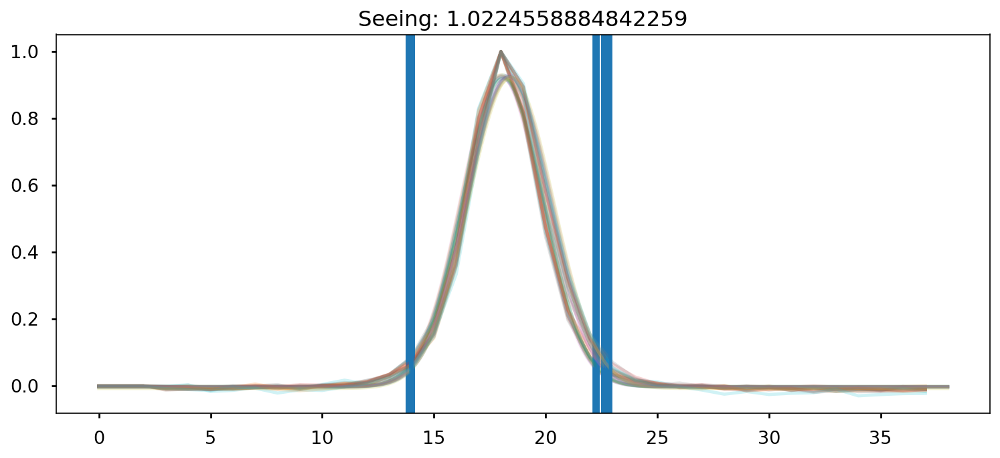

Mediana espectro estrella:  20.857634
Mediana fluxcal:  5.141168701628785e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.89741953]
calib Data:  [1.0013913]
Fcalib :  [5.60227940e-18 5.60120321e-18 5.60012758e-18 ... 8.40536601e-18
 8.40743870e-18 8.40951196e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean010_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean010_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
mask2_2


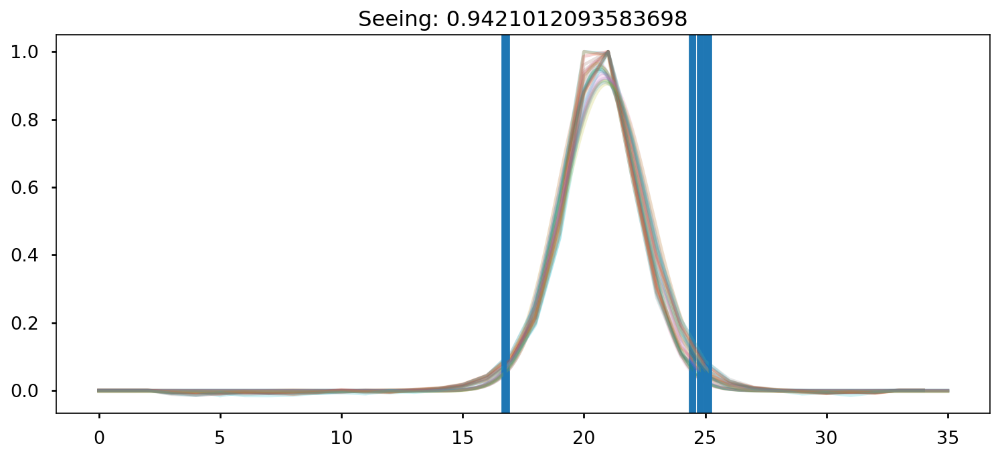

Mediana espectro estrella:  39.027756
Mediana fluxcal:  4.7247905008944085e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.32190157]
calib Data:  [1.02278566]


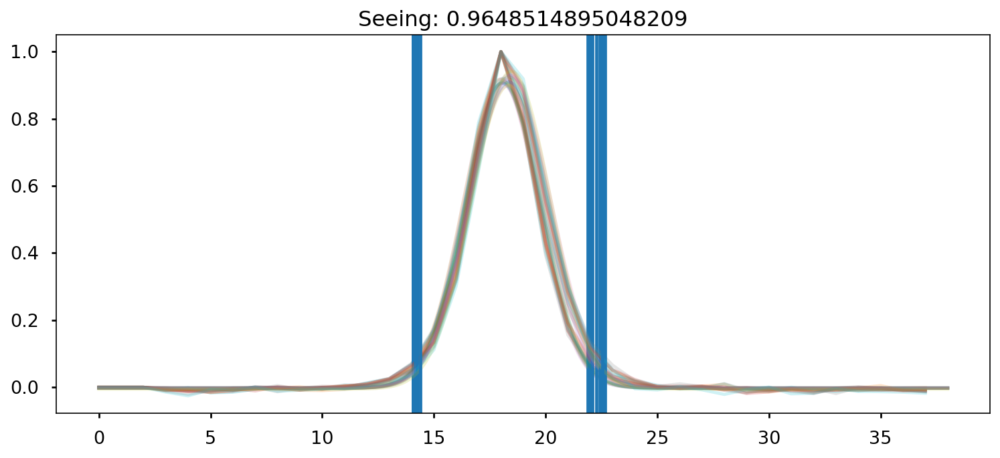

Mediana espectro estrella:  22.341793
Mediana fluxcal:  4.8124413790993514e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.89420421]
calib Data:  [0.99843014]
Fcalib :  [5.23954069e-18 5.23857954e-18 5.23761886e-18 ... 7.51817399e-18
 7.51994524e-18 7.52171697e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean011_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0411/obj_clean011_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0411
mask2_2


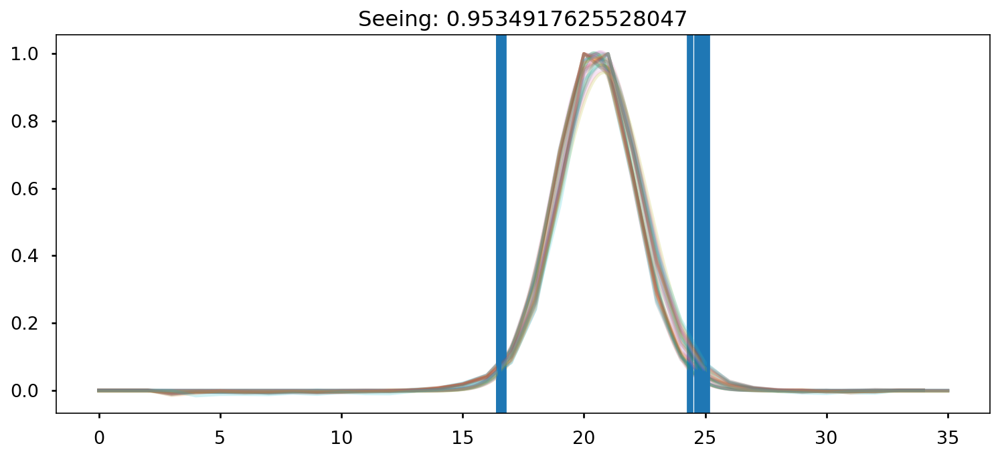

Mediana espectro estrella:  47.914536
Mediana fluxcal:  3.8853018855425175e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31404743]
calib Data:  [1.01541359]


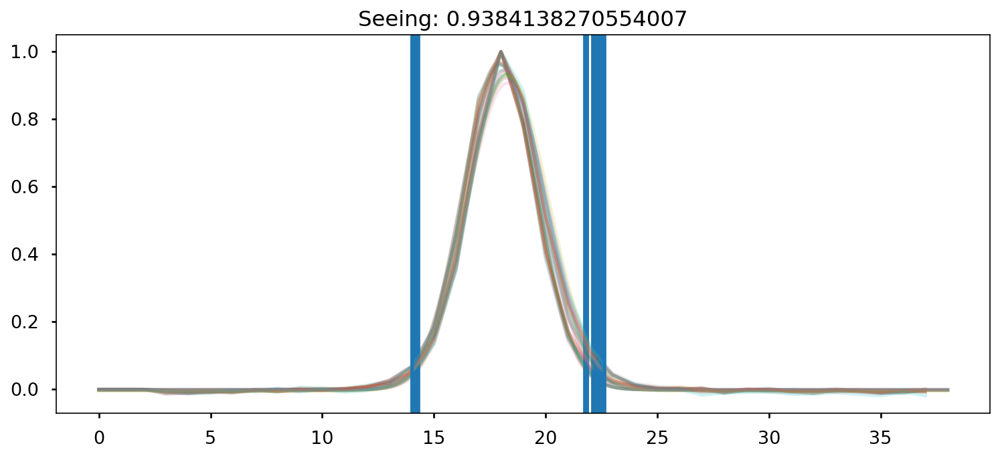

Mediana espectro estrella:  28.506262
Mediana fluxcal:  3.840371833600335e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.88946548]
calib Data:  [0.99408196]
Fcalib :  [4.32413817e-18 4.32332972e-18 4.32252165e-18 ... 5.90320365e-18
 5.90457354e-18 5.90594381e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0413/obj_clean000_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0413
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0413/obj_clean000_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0413
mask2_2


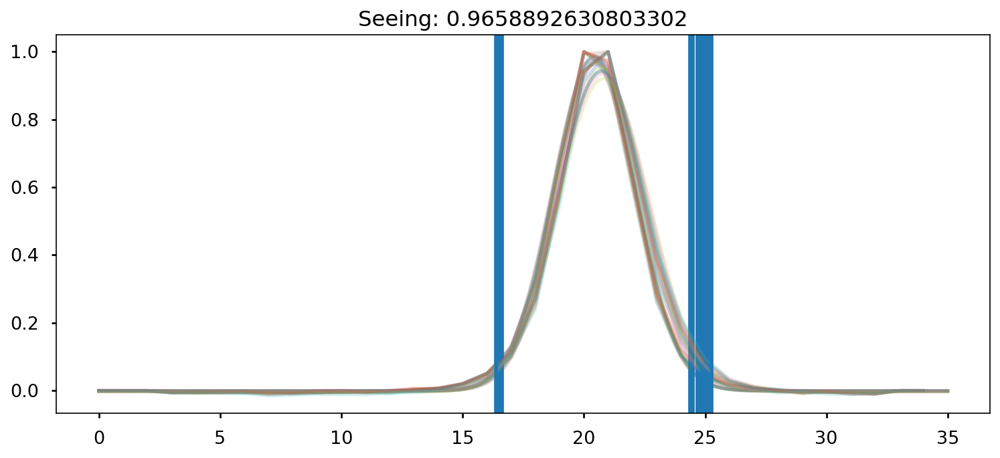

Mediana espectro estrella:  46.241764
Mediana fluxcal:  3.951940298019867e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31429789]
calib Data:  [1.01564786]


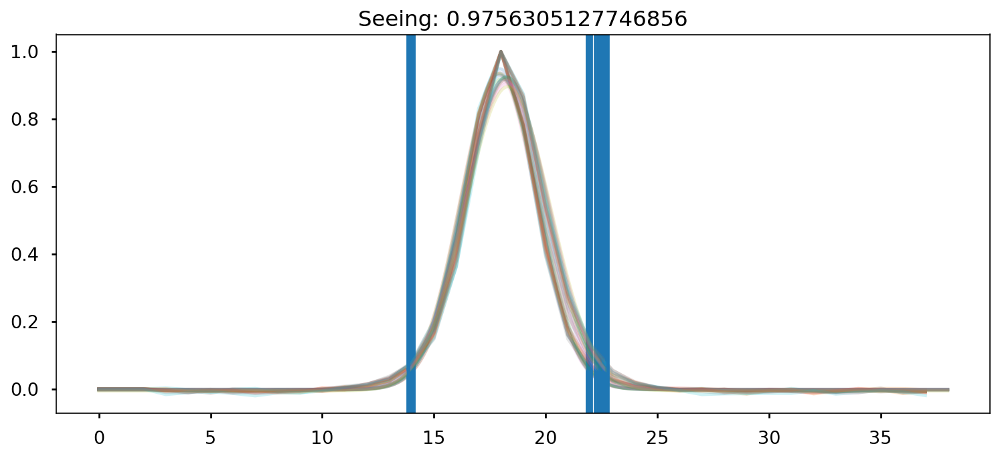

Mediana espectro estrella:  27.150833
Mediana fluxcal:  1.0468522979486442e-16
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [nan]
calib Data:  [nan]


/Users/gonzalo/opt/anaconda3/lib/python3.8/site-packages/sedpy/observate.py:412: RuntimeWarning: invalid value encountered in log10
  return -2.5 * np.log10(counts / self.ab_zero_counts)
 [astropy.modeling.fitting]


Fcalib :  [1.14869918e-16 1.14688390e-16 1.14506964e-16 ... 7.08527345e-16
 7.08919904e-16 7.09312564e-16]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0413/obj_clean001_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0413
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0413/obj_clean001_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0413
mask2_2


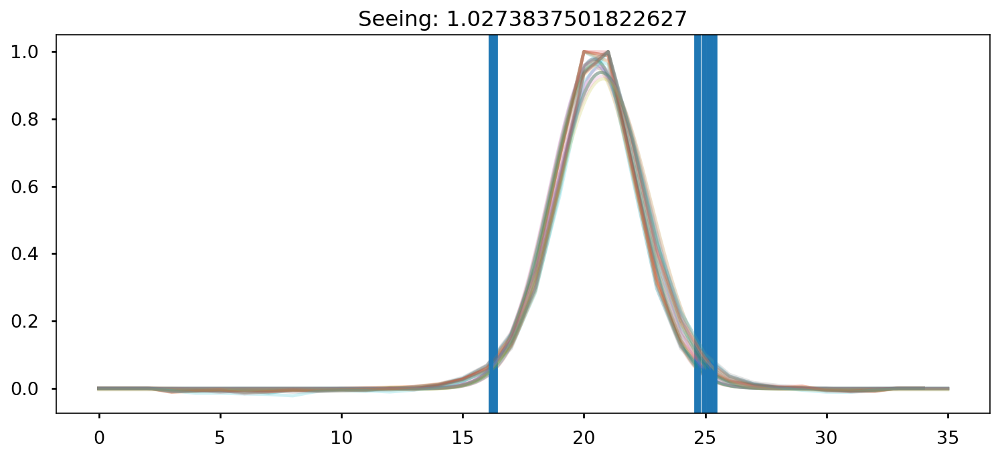

Mediana espectro estrella:  41.27456
Mediana fluxcal:  4.421745914326246e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31659071]
calib Data:  [1.01779493]


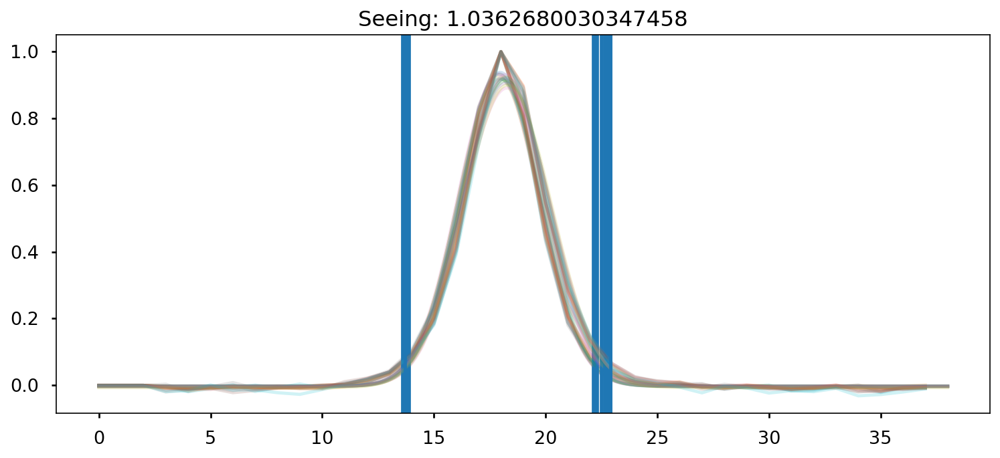

Mediana espectro estrella:  23.967258
Mediana fluxcal:  4.5108283878979395e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.88912745]
calib Data:  [0.99377252]
Fcalib :  [4.84853164e-18 4.84767402e-18 4.84681685e-18 ... 7.09244049e-18
 7.09409582e-18 7.09575160e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0413/obj_clean002_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0413
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0413/obj_clean002_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0413
mask2_2


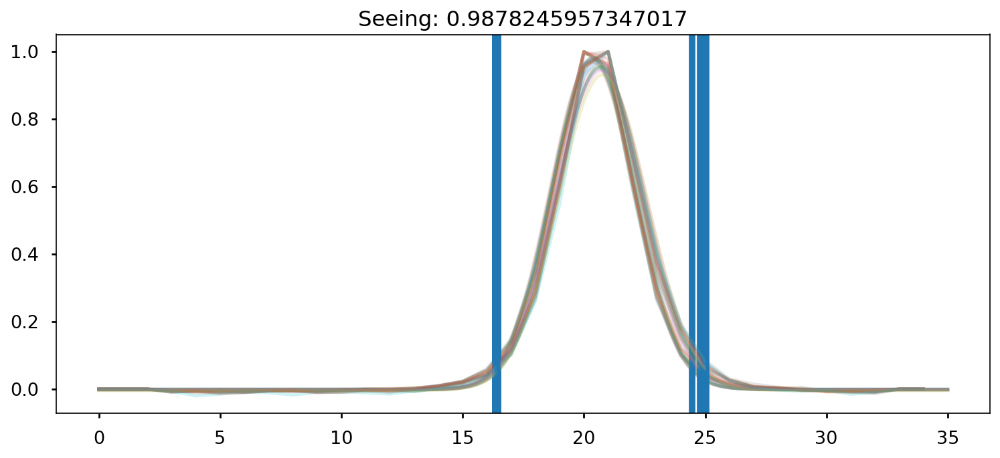

Mediana espectro estrella:  44.511013
Mediana fluxcal:  4.0997461093006895e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31778116]
calib Data:  [1.0189115]


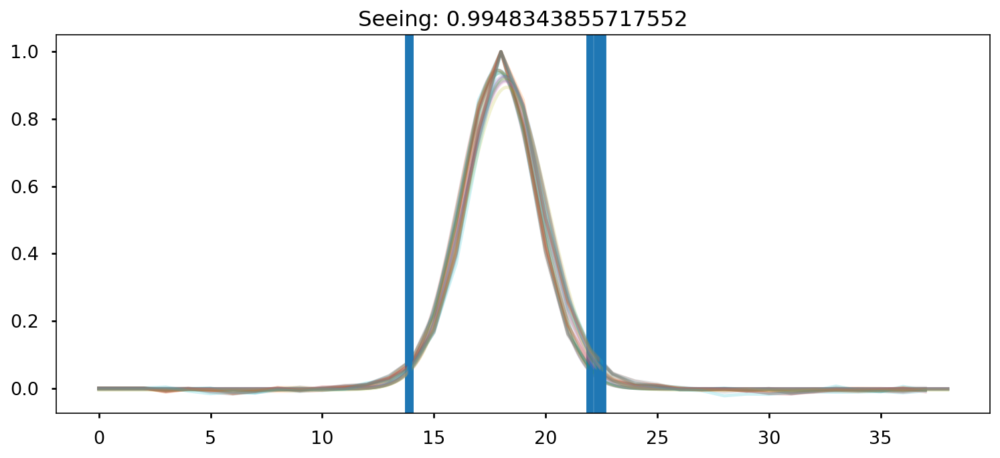

Mediana espectro estrella:  25.998463
Mediana fluxcal:  4.1598564969755714e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.88537962]
calib Data:  [0.99034804]
Fcalib :  [4.50465967e-18 4.50386983e-18 4.50308039e-18 ... 6.45043488e-18
 6.45191647e-18 6.45339845e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0413/obj_clean003_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0413
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0413/obj_clean003_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0413
mask2_2


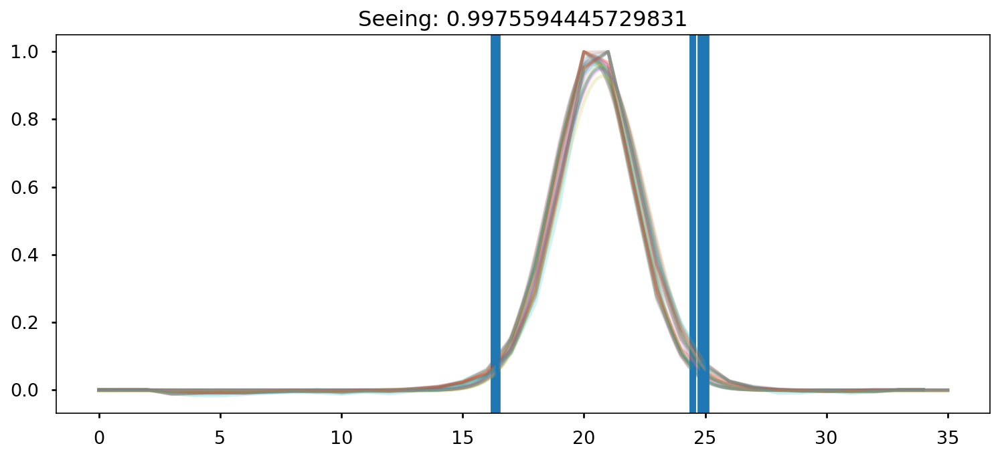

Mediana espectro estrella:  45.714493
Mediana fluxcal:  3.979095339712754e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31122434]
calib Data:  [1.01277678]


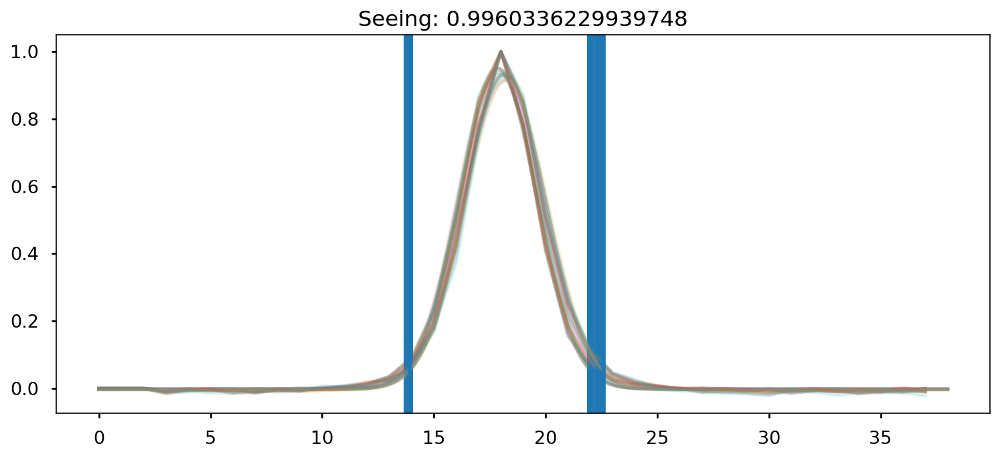

Mediana espectro estrella:  26.75044
Mediana fluxcal:  4.044362441291271e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.89667244]
calib Data:  [1.00070248]
Fcalib :  [4.35491484e-18 4.35417243e-18 4.35343040e-18 ... 6.23093957e-18
 6.23234892e-18 6.23375865e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0413/obj_clean004_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0413
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0413/obj_clean004_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0413
mask2_2


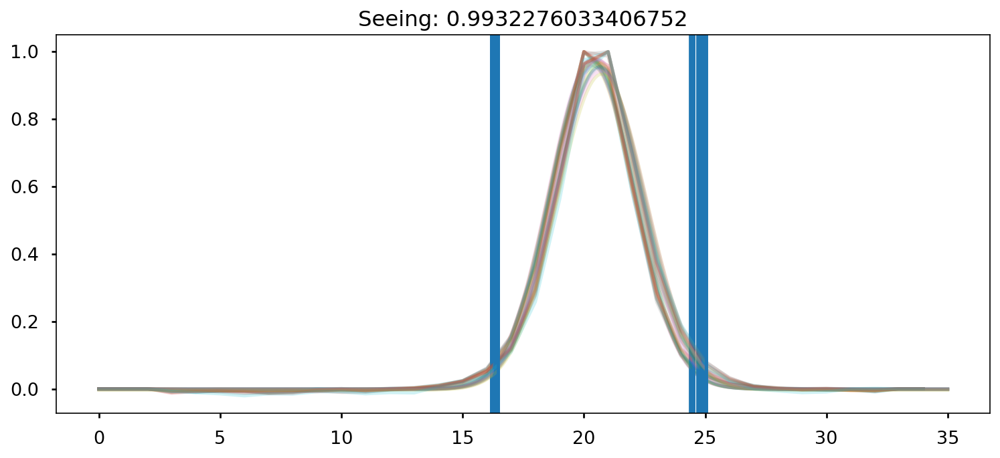

Mediana espectro estrella:  45.489494
Mediana fluxcal:  4.00369466930395e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31331145]
calib Data:  [1.01472551]


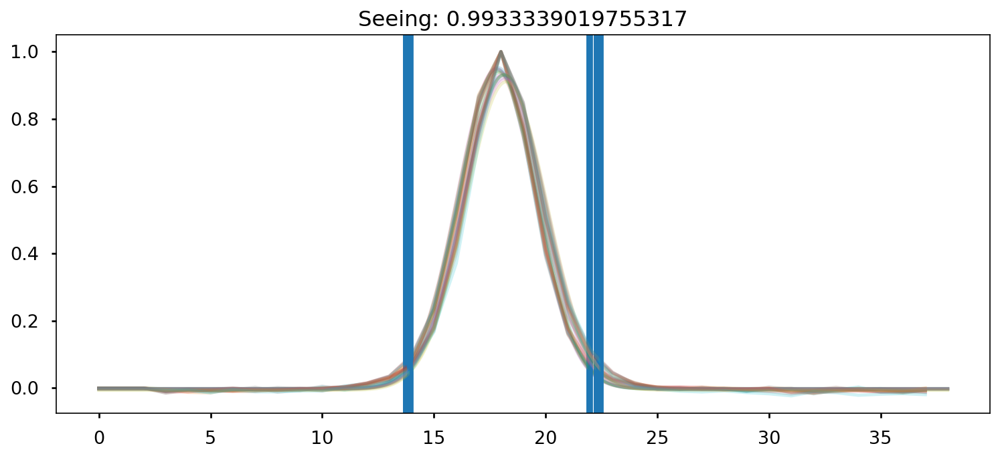

Mediana espectro estrella:  26.433243
Mediana fluxcal:  4.094469781865857e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.8913828]
calib Data:  [0.99583898]
Fcalib :  [4.41553354e-18 4.41476192e-18 4.41399069e-18 ... 6.31206169e-18
 6.31350755e-18 6.31495380e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0413/obj_clean005_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0413
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0413/obj_clean005_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0413
mask2_2


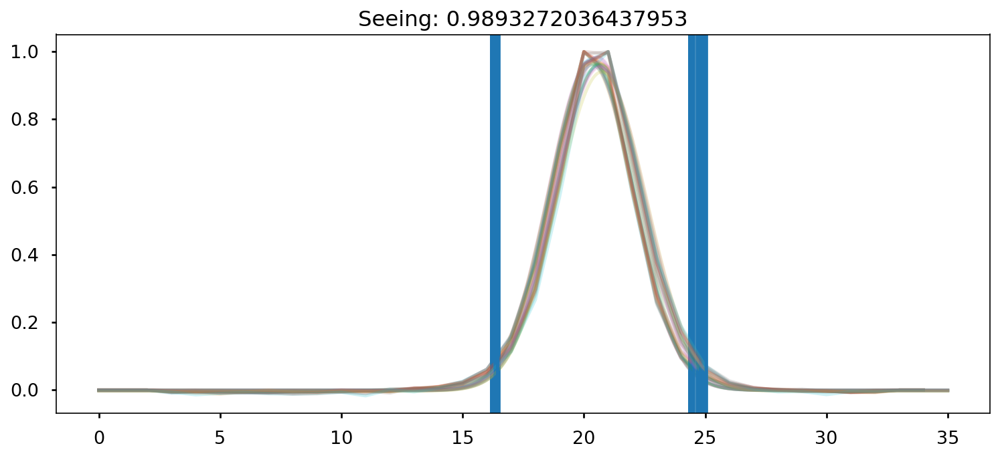

Mediana espectro estrella:  45.196754
Mediana fluxcal:  4.02323502811033e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31517539]
calib Data:  [1.01646905]


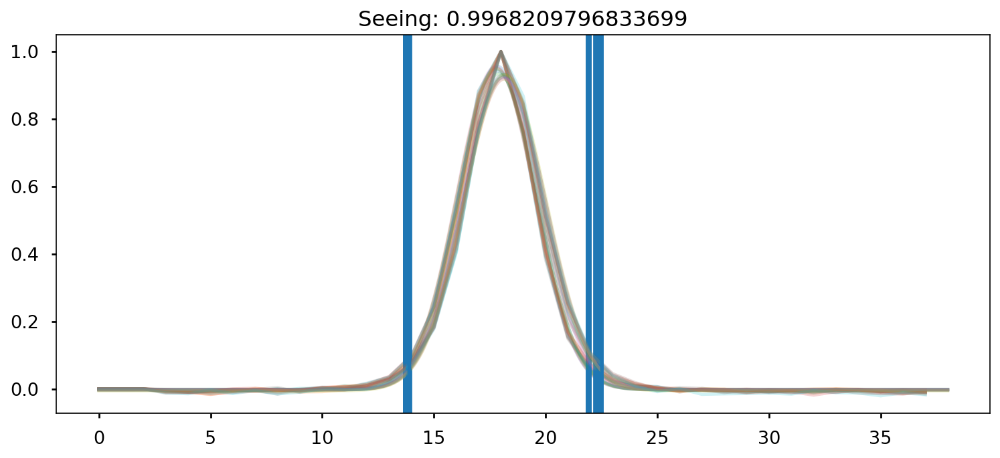

Mediana espectro estrella:  26.43435
Mediana fluxcal:  4.112797399047731e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.87889488]
calib Data:  [0.98445065]
Fcalib :  [4.45955921e-18 4.45878172e-18 4.45800463e-18 ... 6.25596911e-18
 6.25738526e-18 6.25880179e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0413/obj_clean006_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0413
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0413/obj_clean006_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0413
mask2_2


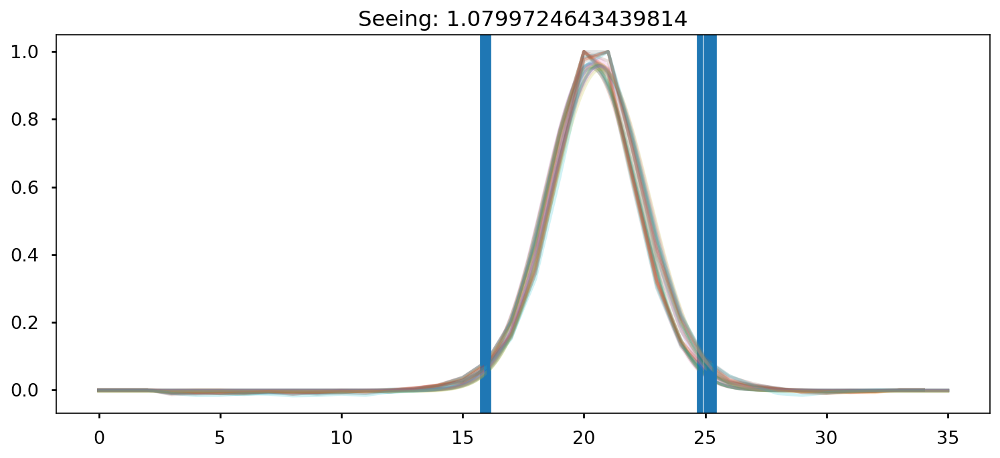

Mediana espectro estrella:  41.382835
Mediana fluxcal:  4.389692810145366e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31509744]
calib Data:  [1.01639607]


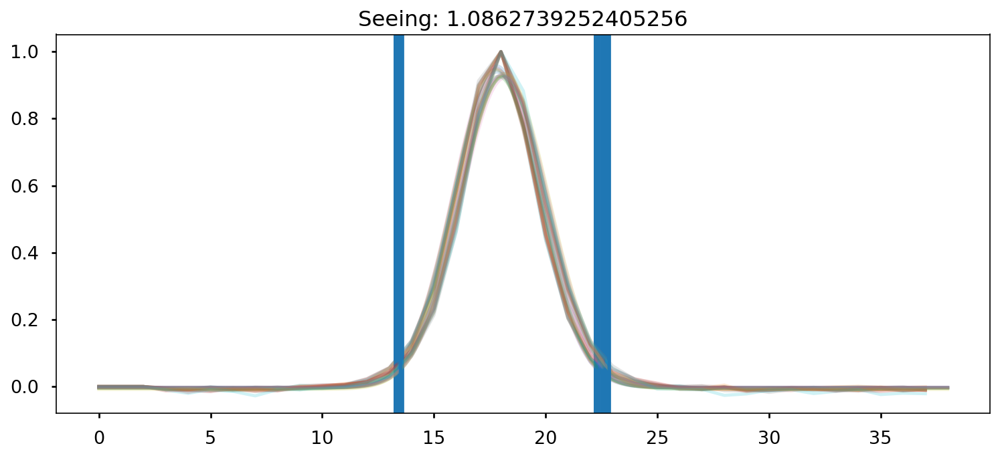

Mediana espectro estrella:  24.808552
Mediana fluxcal:  4.345746062249679e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.8862577]
calib Data:  [0.9911493]
Fcalib :  [4.73182453e-18 4.73108133e-18 4.73033851e-18 ... 6.49651852e-18
 6.49788909e-18 6.49926004e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0413/obj_clean007_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0413
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0413/obj_clean007_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0413
mask2_2


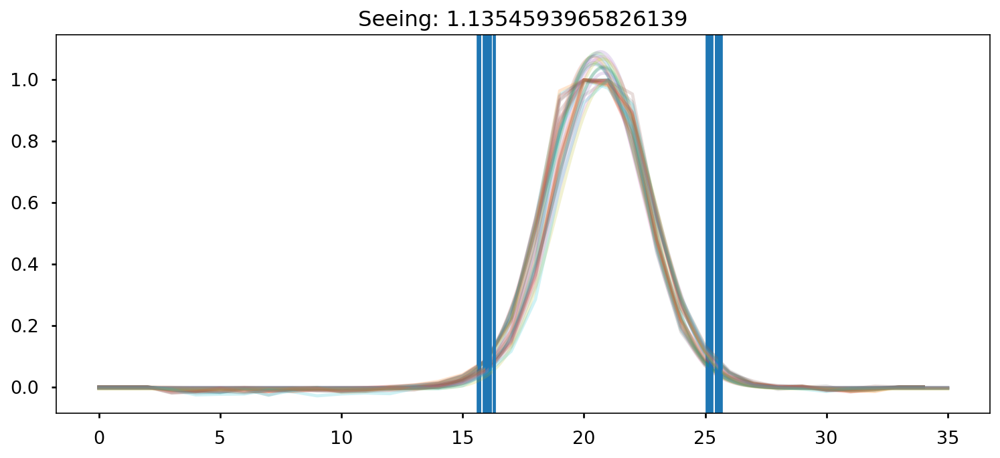

Mediana espectro estrella:  31.52671
Mediana fluxcal:  5.881364744716122e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.3171768]
calib Data:  [1.0183445]


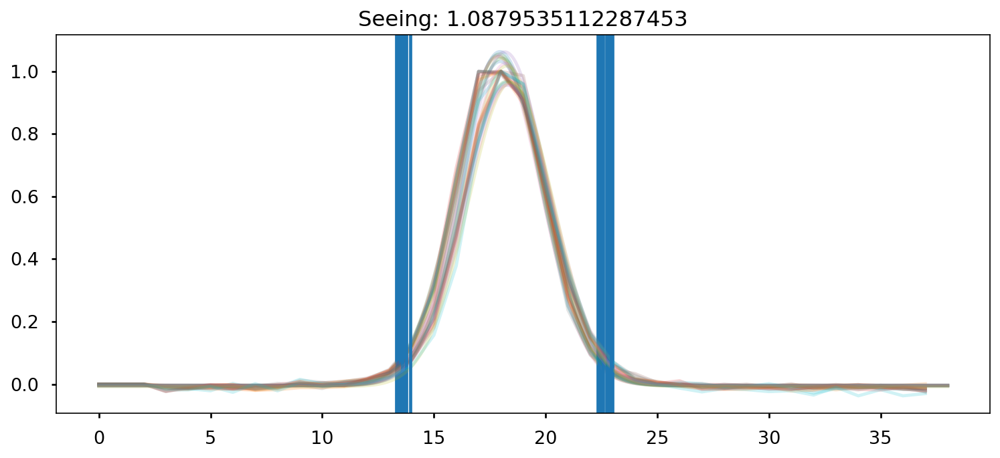

Mediana espectro estrella:  19.035467
Mediana fluxcal:  5.736485199126473e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.87795714]
calib Data:  [0.98360076]


<ipython-input-21-0b12572c6f73>:34: RuntimeWarning: invalid value encountered in power
  transmission_function = np.interp(wave-alpha, wave, trans_std)**beta


Fcalib :  [6.53364001e-18 6.53259109e-18 6.53154263e-18 ... 7.98582956e-18
 7.98739492e-18 7.98896074e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean000_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean000_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
mask2_2


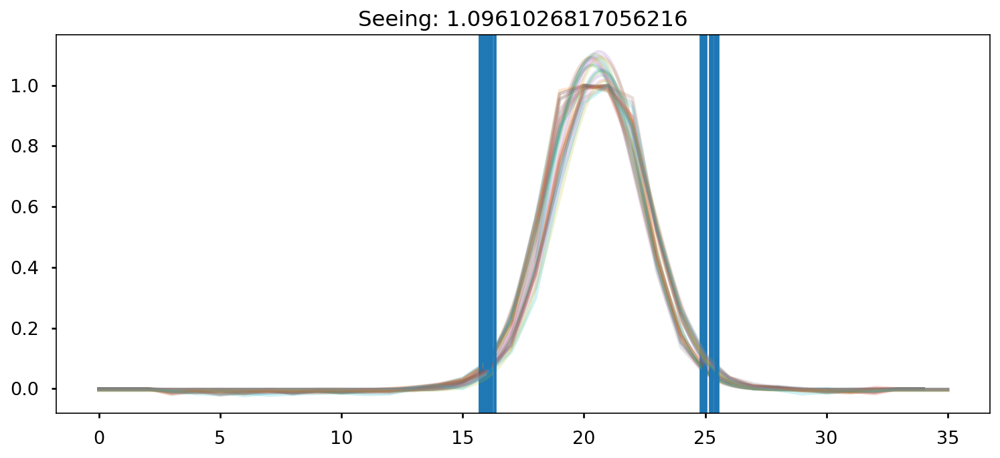

Mediana espectro estrella:  30.895145
Mediana fluxcal:  5.9828104240197716e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.32200124]
calib Data:  [1.02287955]


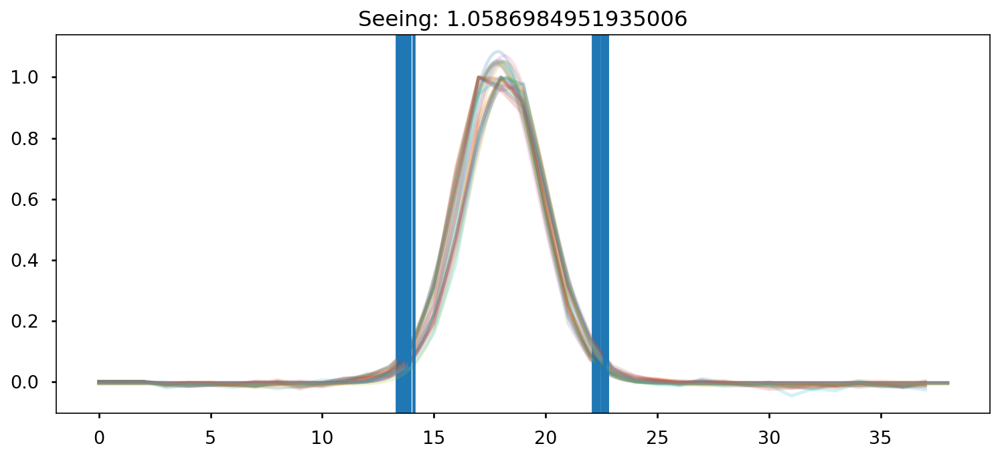

Mediana espectro estrella:  18.23966
Mediana fluxcal:  5.988431578345737e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.87641988]
calib Data:  [0.9822091]


<ipython-input-21-0b12572c6f73>:34: RuntimeWarning: invalid value encountered in power
  transmission_function = np.interp(wave-alpha, wave, trans_std)**beta


Fcalib :  [6.78494323e-18 6.78385817e-18 6.78277357e-18 ... 8.07012146e-18
 8.07166362e-18 8.07320625e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean001_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean001_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
mask2_2


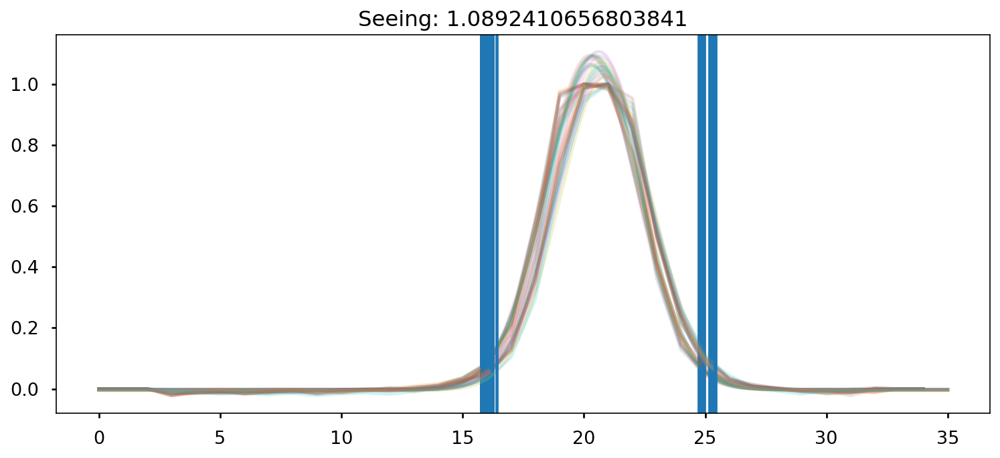

Mediana espectro estrella:  30.581875
Mediana fluxcal:  6.021355428622254e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.3175454]
calib Data:  [1.01869028]


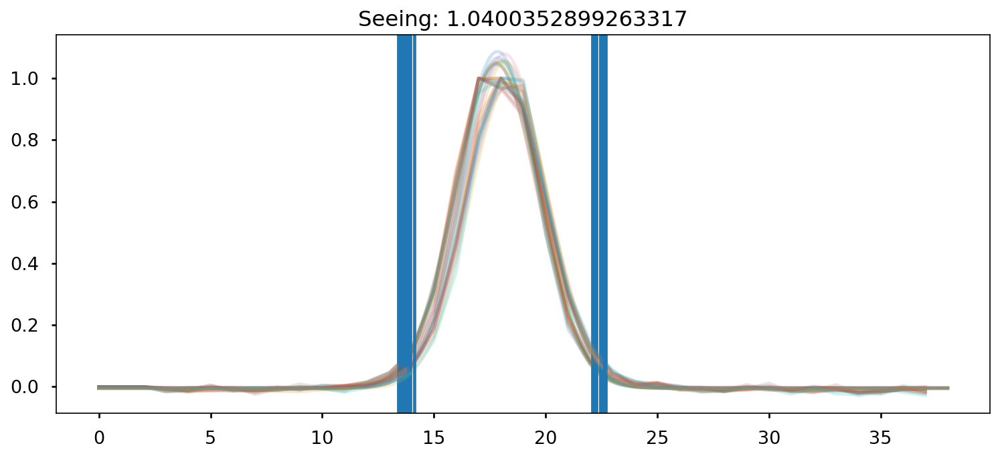

Mediana espectro estrella:  18.17464
Mediana fluxcal:  6.023761969286961e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.87094473]
calib Data:  [0.97726848]
Fcalib :  [6.85806830e-18 6.85695333e-18 6.85583883e-18 ... 8.11794289e-18
 8.11950597e-18 8.12106953e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean002_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean002_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
mask2_2


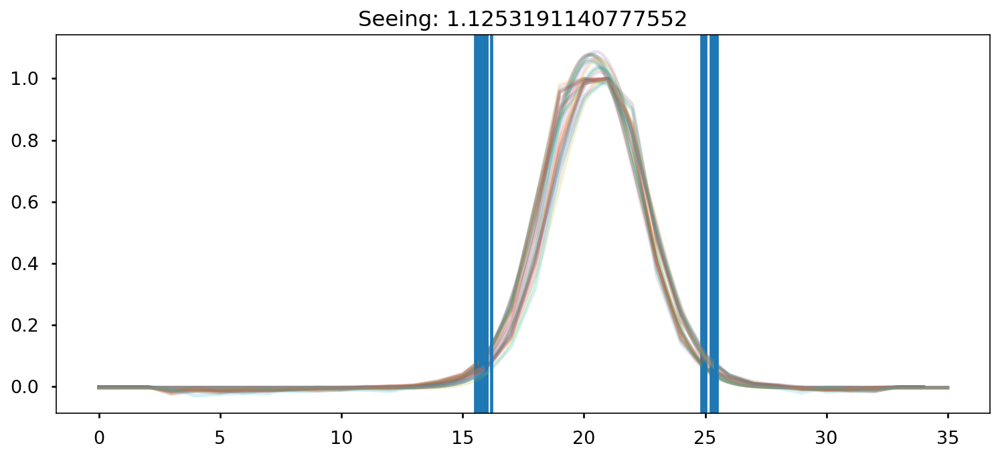

Mediana espectro estrella:  31.454529
Mediana fluxcal:  5.860825675901882e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.30181389]
calib Data:  [1.00403662]


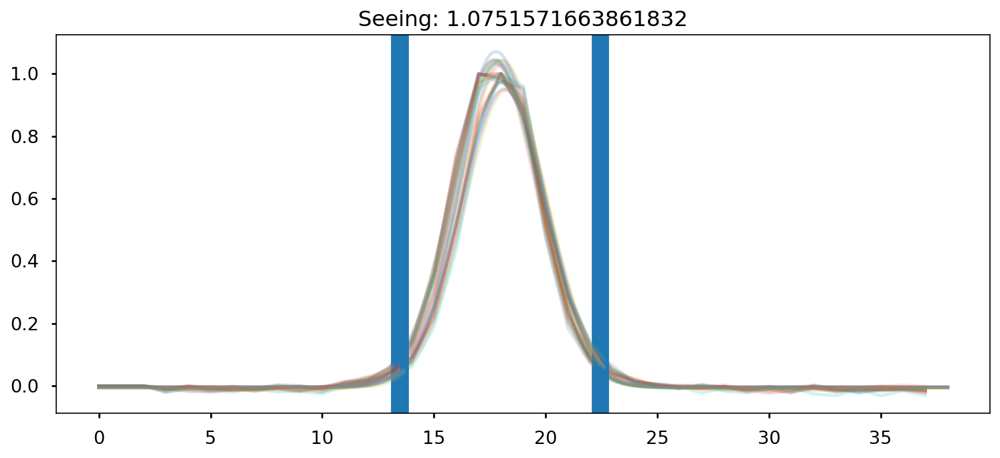

Mediana espectro estrella:  18.448723
Mediana fluxcal:  5.917796296528725e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.8953059]
calib Data:  [0.99944376]
Fcalib :  [6.66708101e-18 6.66601256e-18 6.66494456e-18 ... 7.97222196e-18
 7.97375459e-18 7.97528769e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean003_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean003_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
mask2_2


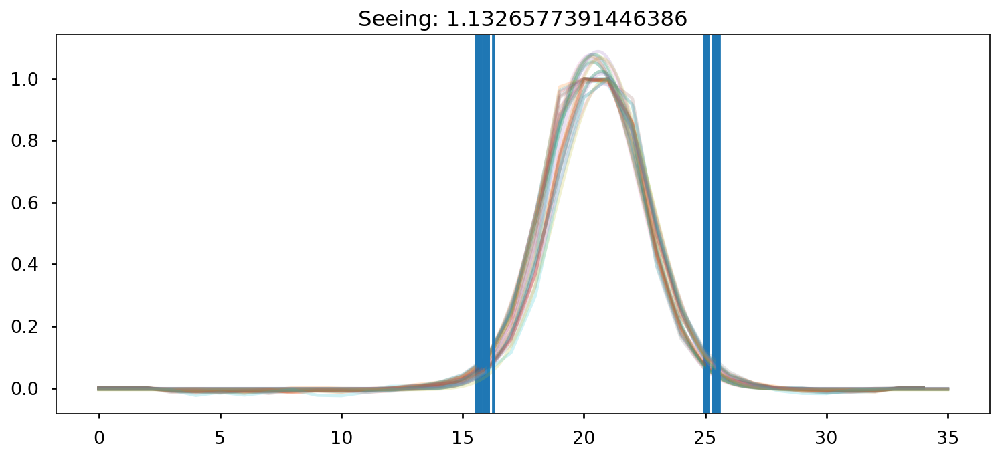

Mediana espectro estrella:  31.171043
Mediana fluxcal:  5.910744458206039e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31732502]
calib Data:  [1.01848352]


<ipython-input-21-0b12572c6f73>:34: RuntimeWarning: invalid value encountered in power
  transmission_function = np.interp(wave-alpha, wave, trans_std)**beta


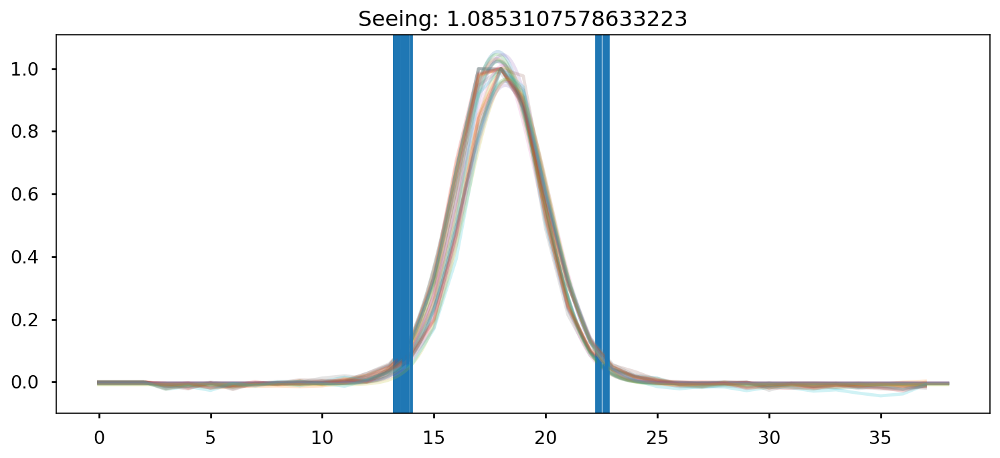

Mediana espectro estrella:  18.725231
Mediana fluxcal:  5.7694623532337296e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.88655679]
calib Data:  [0.99142237]
Fcalib :  [6.51829413e-18 6.51731389e-18 6.51633408e-18 ... 7.87122197e-18
 7.87268335e-18 7.87414516e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]


<ipython-input-21-0b12572c6f73>:34: RuntimeWarning: invalid value encountered in power
  transmission_function = np.interp(wave-alpha, wave, trans_std)**beta


/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean004_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean004_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
mask2_2


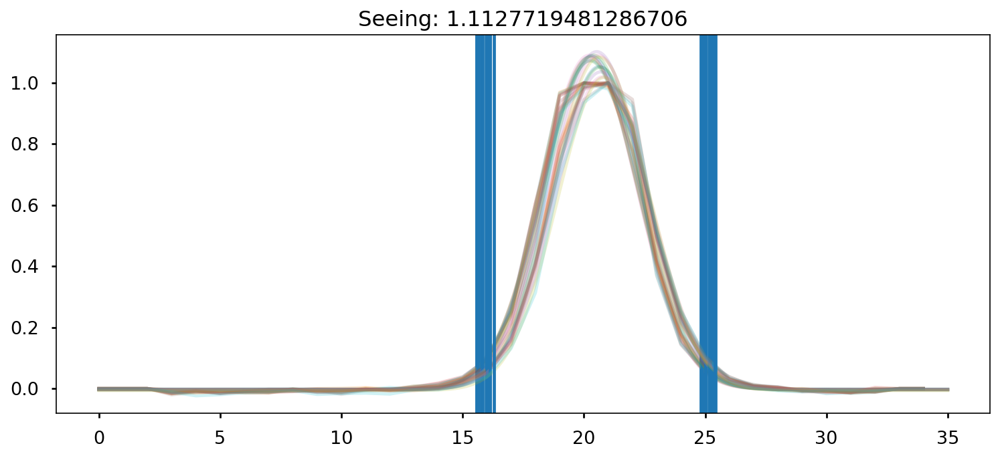

Mediana espectro estrella:  31.148472
Mediana fluxcal:  5.9074197525448905e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.32231731]
calib Data:  [1.02317737]


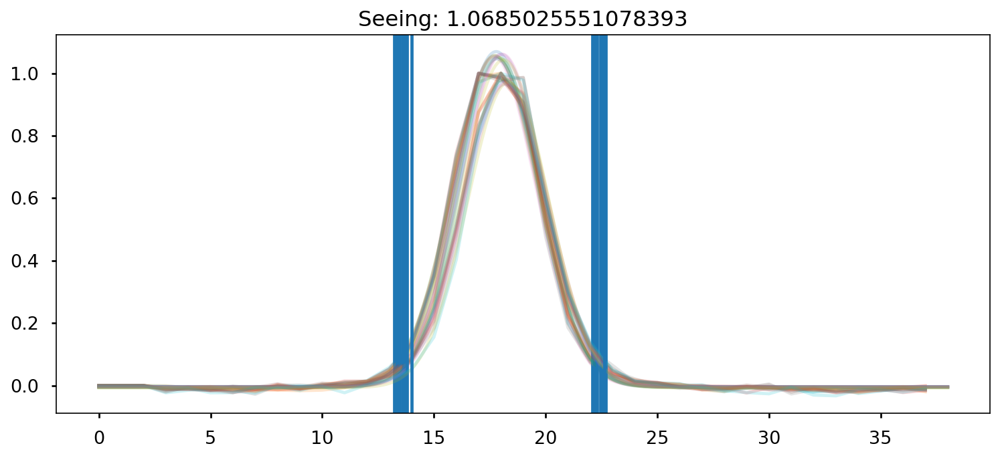

Mediana espectro estrella:  18.3937
Mediana fluxcal:  5.949283304881758e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.88897066]
calib Data:  [0.99362901]
Fcalib :  [6.69760566e-18 6.69656435e-18 6.69552348e-18 ... 7.92229215e-18
 7.92376904e-18 7.92524639e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean005_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean005_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
mask2_2


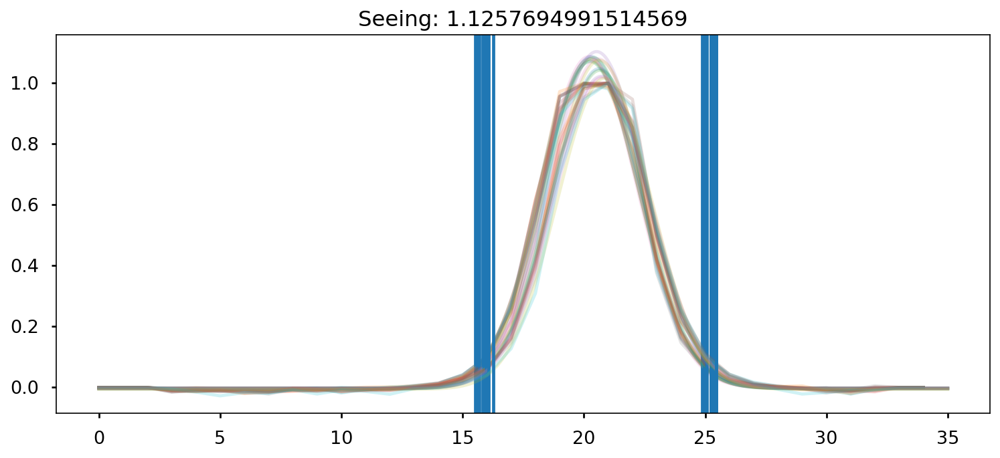

Mediana espectro estrella:  31.568272
Mediana fluxcal:  5.835367042124899e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.32476575]
calib Data:  [1.02548733]


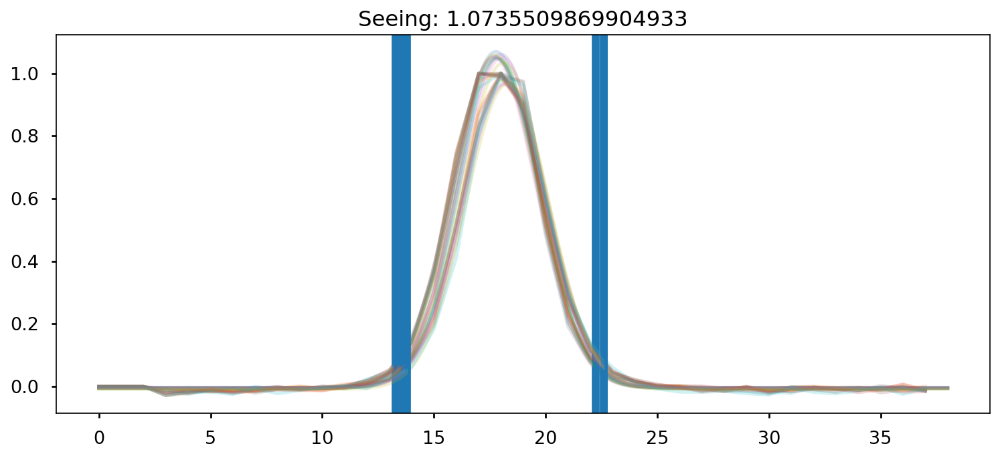

Mediana espectro estrella:  18.552298
Mediana fluxcal:  5.8731664240974206e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.88841462]
calib Data:  [0.99312028]
Fcalib :  [6.62815600e-18 6.62709470e-18 6.62603385e-18 ... 7.91936488e-18
 7.92088541e-18 7.92240640e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean006_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean006_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
mask2_2


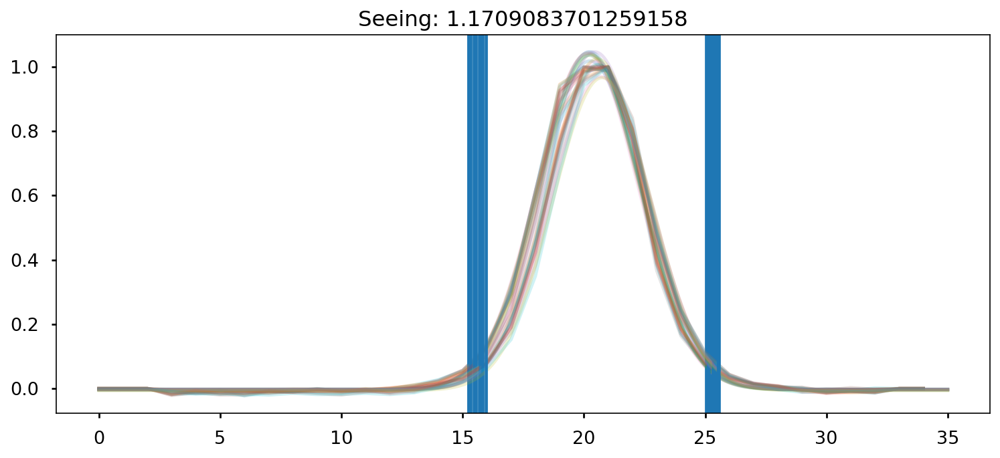

Mediana espectro estrella:  32.108086
Mediana fluxcal:  5.765778124223294e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31936439]
calib Data:  [1.02039837]


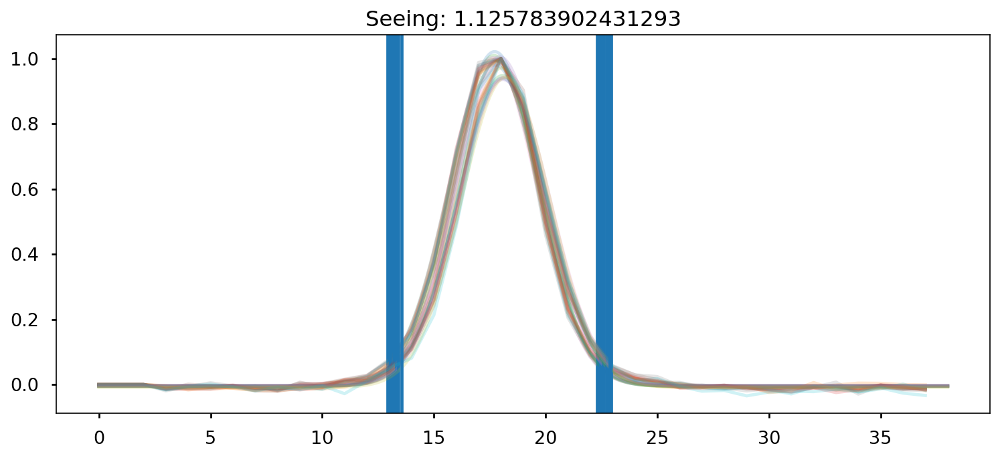

Mediana espectro estrella:  18.882706
Mediana fluxcal:  5.7401809904217015e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.8935552]
calib Data:  [0.9978335]


<ipython-input-21-0b12572c6f73>:34: RuntimeWarning: invalid value encountered in power
  transmission_function = np.interp(wave-alpha, wave, trans_std)**beta


Fcalib :  [6.36738283e-18 6.36638929e-18 6.36539622e-18 ... 8.07947718e-18
 8.08107948e-18 8.08268225e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean007_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean007_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
mask2_2


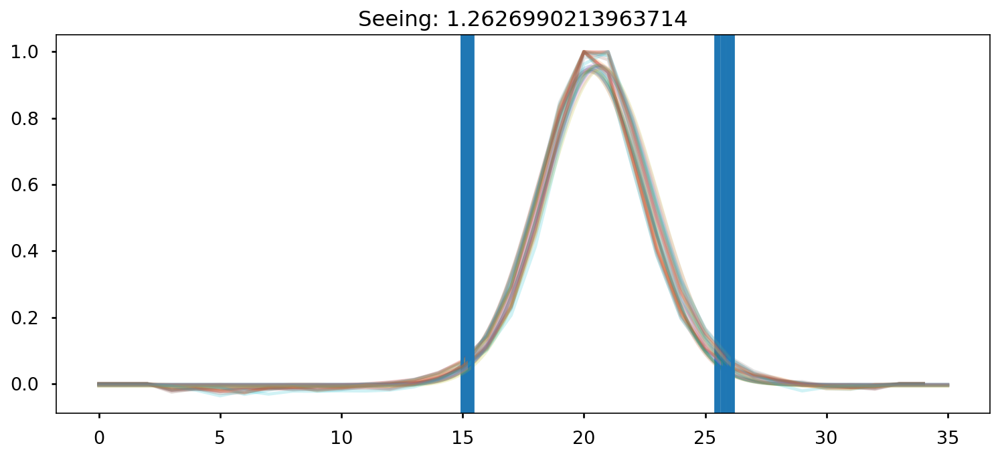

Mediana espectro estrella:  31.305302
Mediana fluxcal:  5.83545814508076e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.32023572]
calib Data:  [1.02121759]


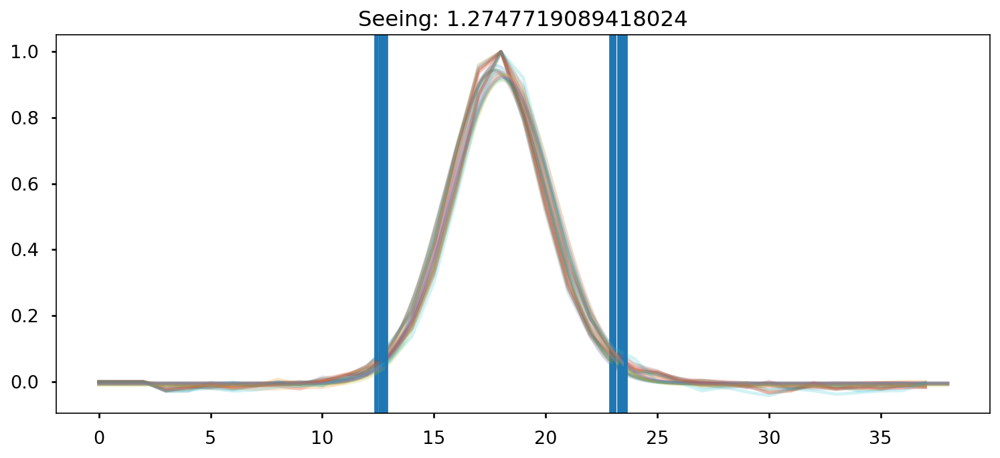

Mediana espectro estrella:  17.792429
Mediana fluxcal:  2.804281168703727e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.72764435]
calib Data:  [0.85643369]


<ipython-input-21-0b12572c6f73>:34: RuntimeWarning: invalid value encountered in power
  transmission_function = np.interp(wave-alpha, wave, trans_std)**beta


Fcalib :  [ 2.80786658e-18  2.81273318e-18  2.81759700e-18 ... -1.37804403e-17
 -1.37912036e-17 -1.38019696e-17]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean008_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean008_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
mask2_2


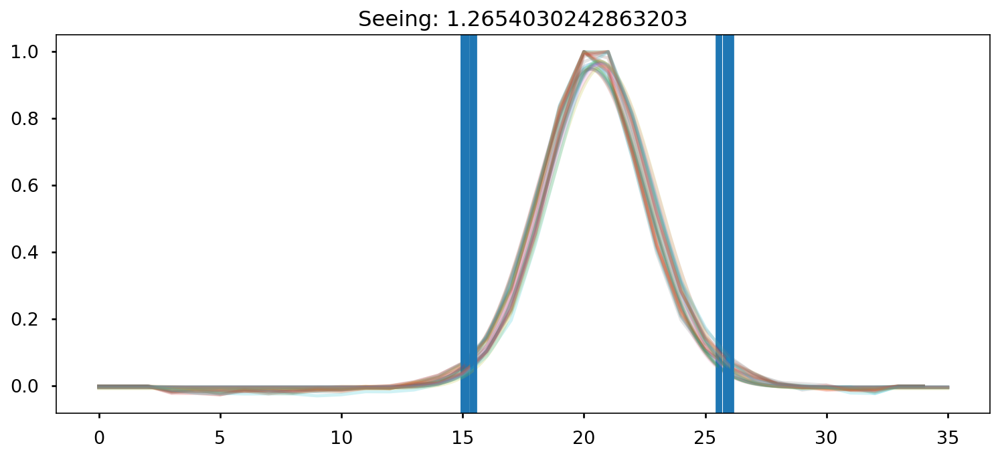

Mediana espectro estrella:  31.378452
Mediana fluxcal:  5.819511458433109e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31947136]
calib Data:  [1.02049891]


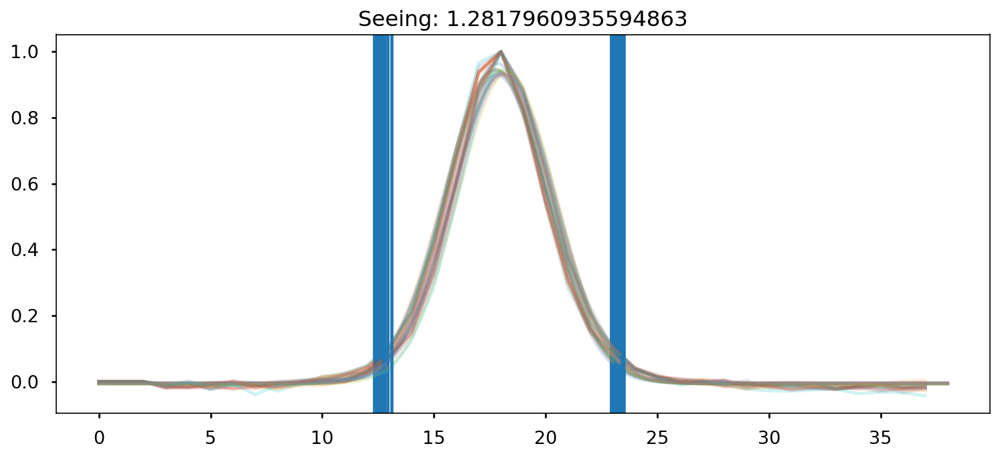

Mediana espectro estrella:  17.707445
Mediana fluxcal:  6.107979428461374e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.90375008]
calib Data:  [1.00724711]
Fcalib :  [6.41341080e-18 6.41236690e-18 6.41132355e-18 ... 9.22861868e-18
 9.23066338e-18 9.23270863e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean009_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean009_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
mask2_2


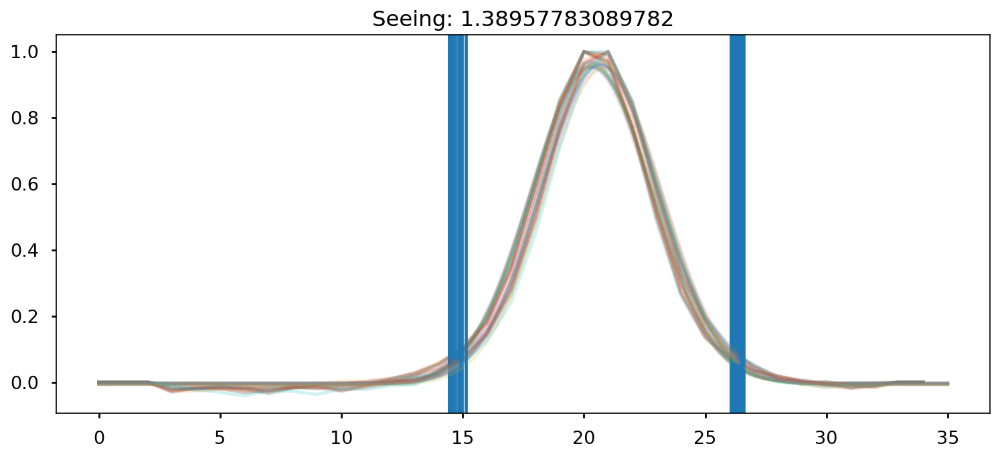

Mediana espectro estrella:  29.02809
Mediana fluxcal:  6.352048148835339e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31687553]
calib Data:  [1.01806196]


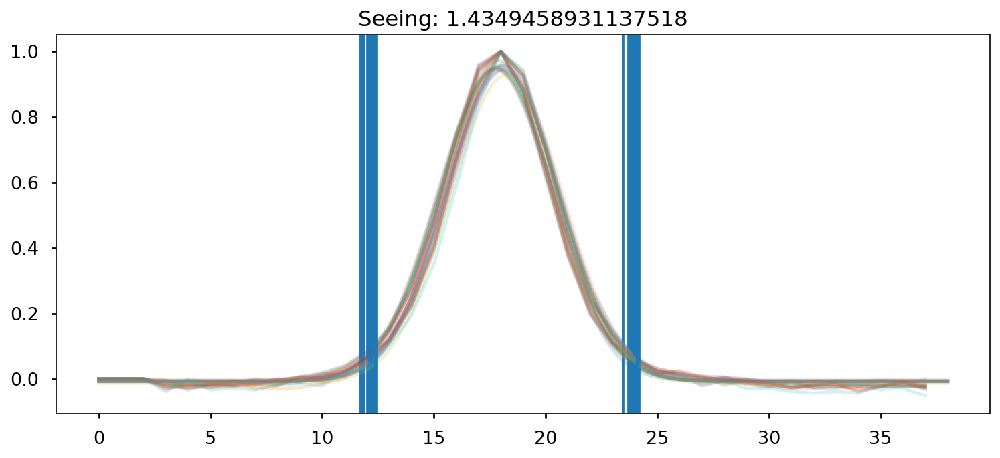

Mediana espectro estrella:  16.604061
Mediana fluxcal:  6.517267790500415e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.89089701]
calib Data:  [0.99539351]


<ipython-input-21-0b12572c6f73>:34: RuntimeWarning: invalid value encountered in power
  transmission_function = np.interp(wave-alpha, wave, trans_std)**beta


Fcalib :  [7.01146678e-18 7.01029057e-18 7.00911495e-18 ... 9.80080847e-18
 9.80297634e-18 9.80514480e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean010_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean010_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
mask2_2


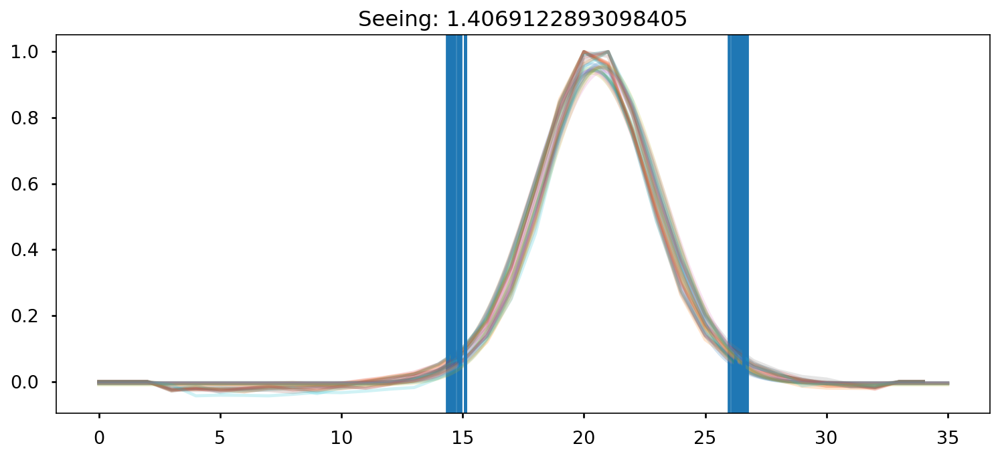

Mediana espectro estrella:  27.922241
Mediana fluxcal:  6.728169156934025e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.31883215]
calib Data:  [1.01989828]


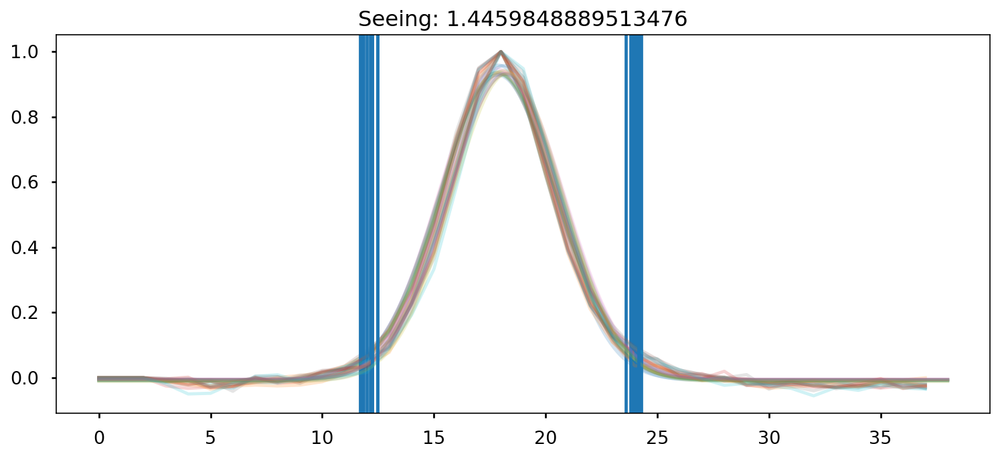

Mediana espectro estrella:  16.02288
Mediana fluxcal:  6.807495940221001e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.88206766]
calib Data:  [0.98733166]


<ipython-input-21-0b12572c6f73>:34: RuntimeWarning: invalid value encountered in power
  transmission_function = np.interp(wave-alpha, wave, trans_std)**beta


Fcalib :  [7.44382959e-18 7.44243183e-18 7.44103478e-18 ... 1.08082564e-17
 1.08108503e-17 1.08134449e-17]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean011_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0417/obj_clean011_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_2/0417
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


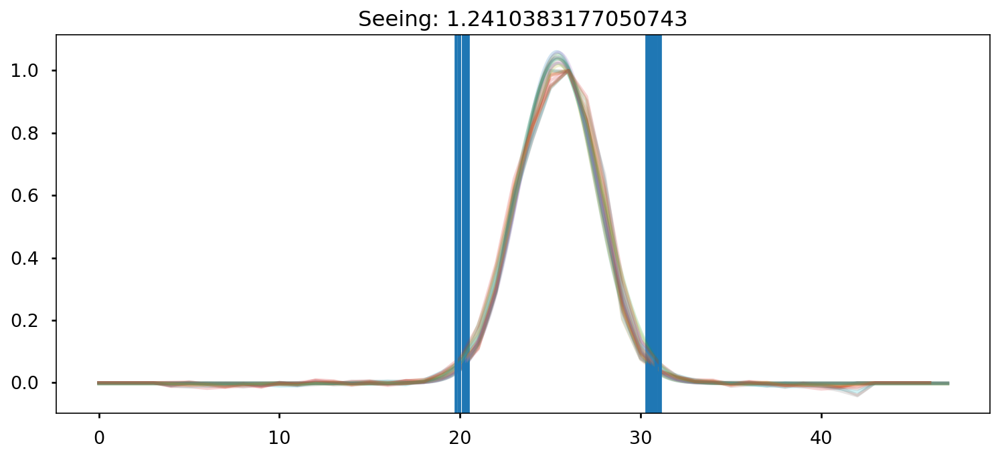

Mediana espectro estrella:  28.06663
Mediana fluxcal:  6.218146340679715e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.76271913]
calib Data:  [1.53501156]


<ipython-input-21-0b12572c6f73>:34: RuntimeWarning: invalid value encountered in power
  transmission_function = np.interp(wave-alpha, wave, trans_std)**beta
<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


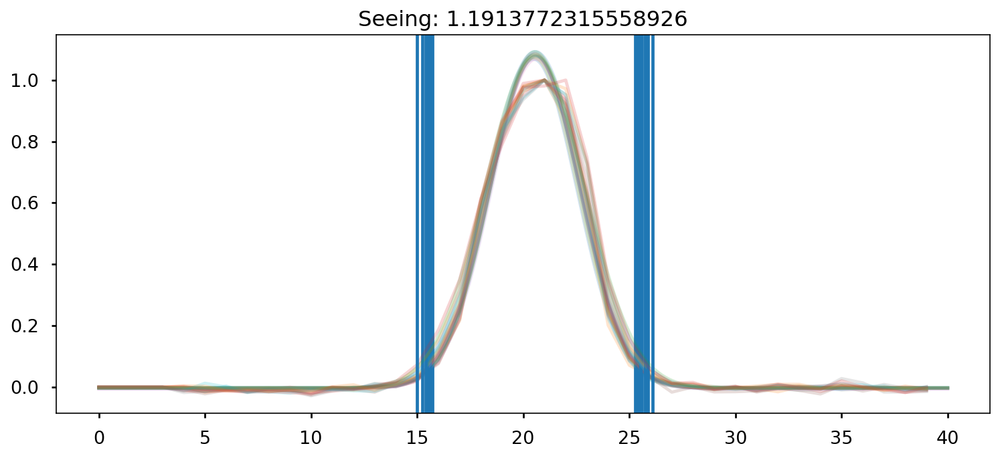

Mediana espectro estrella:  16.837511
Mediana fluxcal:  5.985165156411385e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.42422844]
calib Data:  [1.62677458]
Fcalib :  [8.36964217e-18 8.36702696e-18 8.36441280e-18 ... 1.00864222e-17
 1.00896485e-17 1.00928757e-17]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]


<ipython-input-21-0b12572c6f73>:34: RuntimeWarning: invalid value encountered in power
  transmission_function = np.interp(wave-alpha, wave, trans_std)**beta


/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0505/obj_clean000_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0505
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0505/obj_clean000_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0505
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


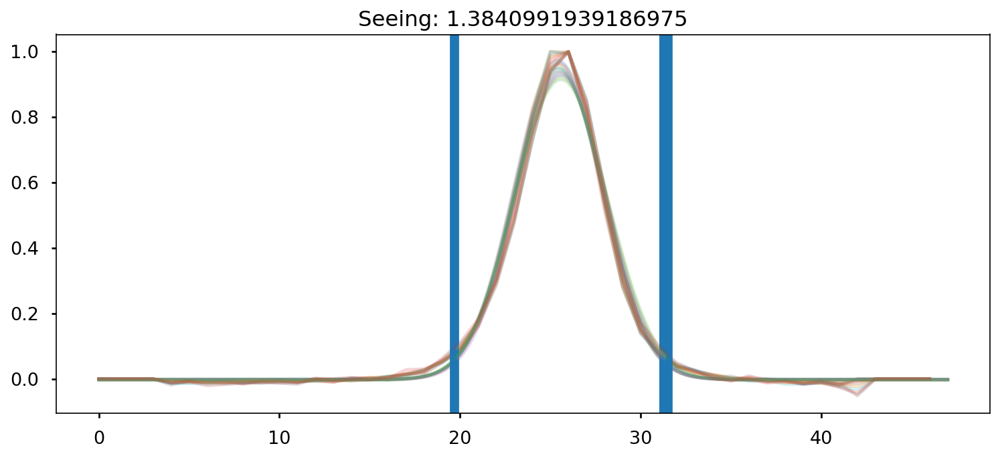

Mediana espectro estrella:  31.542355
Mediana fluxcal:  5.542879843060048e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.7582949]
calib Data:  [1.52876932]


<ipython-input-21-0b12572c6f73>:34: RuntimeWarning: invalid value encountered in power
  transmission_function = np.interp(wave-alpha, wave, trans_std)**beta
<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


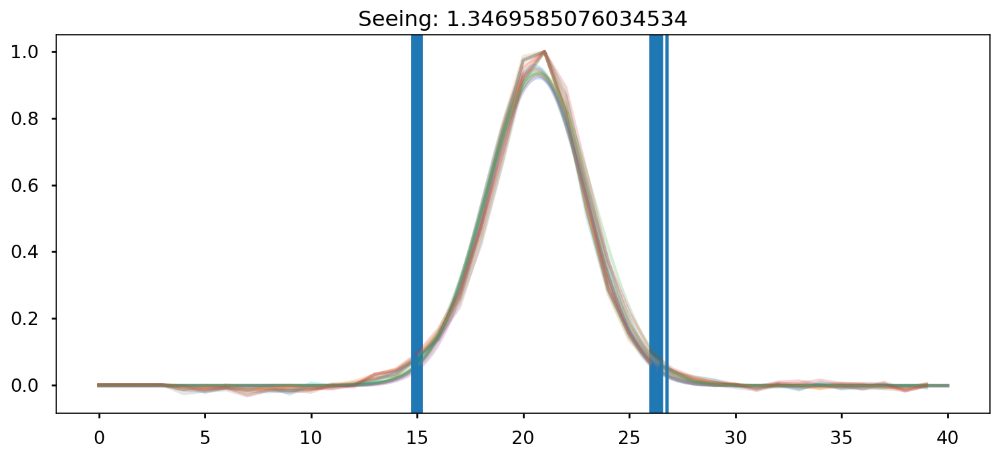

Mediana espectro estrella:  17.761478
Mediana fluxcal:  6.423908091193736e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.21246415]
calib Data:  [1.33851013]


<ipython-input-21-0b12572c6f73>:34: RuntimeWarning: invalid value encountered in power
  transmission_function = np.interp(wave-alpha, wave, trans_std)**beta


Fcalib :  [9.62516618e-18 9.62117338e-18 9.61718211e-18 ... 1.16261962e-17
 1.16309015e-17 1.16356084e-17]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0505/obj_clean001_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0505
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0505/obj_clean001_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0505
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


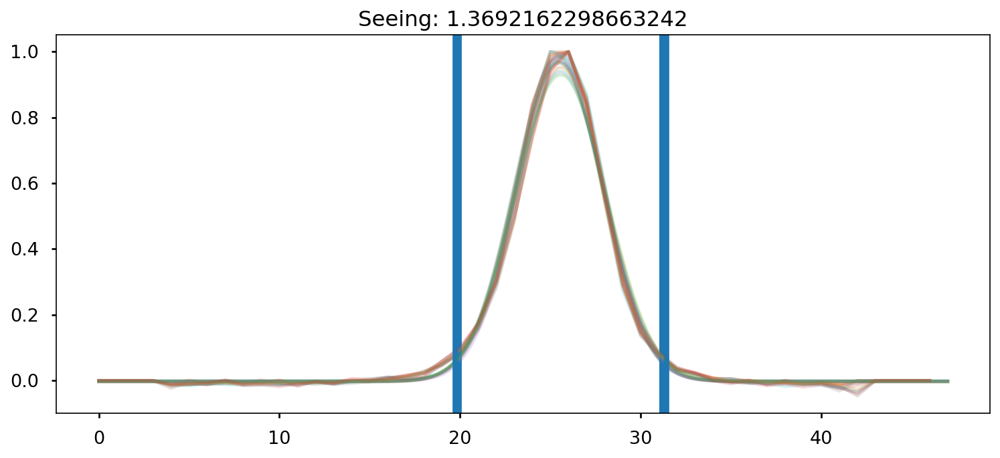

Mediana espectro estrella:  31.4612
Mediana fluxcal:  5.547284840831696e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.75842037]
calib Data:  [1.52894601]


<ipython-input-21-0b12572c6f73>:34: RuntimeWarning: invalid value encountered in power
  transmission_function = np.interp(wave-alpha, wave, trans_std)**beta
<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


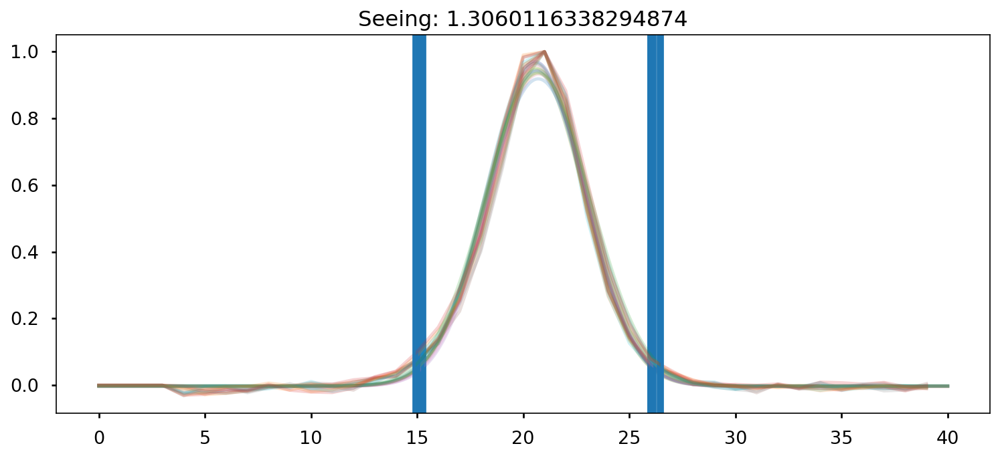

Mediana espectro estrella:  17.526241
Mediana fluxcal:  5.638740899504067e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.41172134]
calib Data:  [1.60814252]


<ipython-input-21-0b12572c6f73>:34: RuntimeWarning: invalid value encountered in power
  transmission_function = np.interp(wave-alpha, wave, trans_std)**beta


Fcalib :  [7.47760257e-18 7.47508771e-18 7.47257392e-18 ... 1.03351946e-17
 1.03387258e-17 1.03422581e-17]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0505/obj_clean002_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0505
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0505/obj_clean002_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0505
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


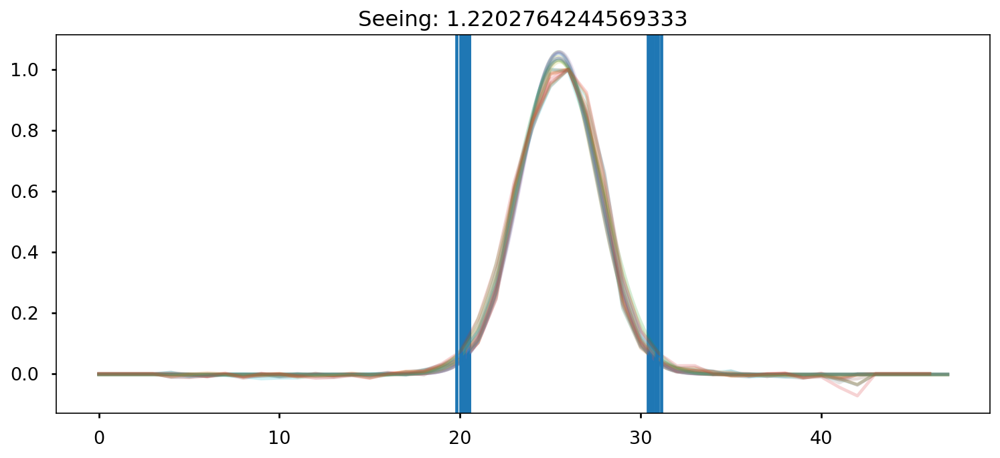

Mediana espectro estrella:  28.501377
Mediana fluxcal:  6.188091226730865e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.74796027]
calib Data:  [1.5142867]


<ipython-input-21-0b12572c6f73>:34: RuntimeWarning: invalid value encountered in power
  transmission_function = np.interp(wave-alpha, wave, trans_std)**beta
<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


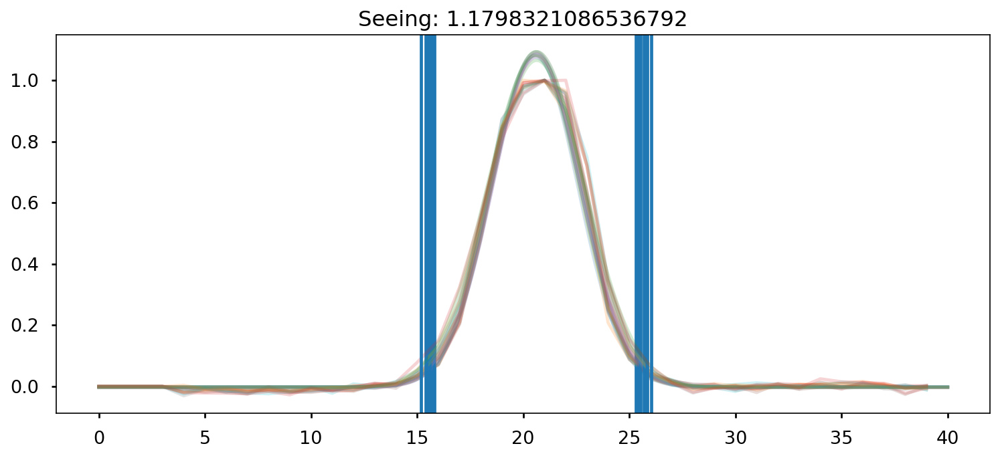

Mediana espectro estrella:  17.373585
Mediana fluxcal:  5.685522346009869e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.38645841]
calib Data:  [1.57115621]


<ipython-input-21-0b12572c6f73>:34: RuntimeWarning: invalid value encountered in power
  transmission_function = np.interp(wave-alpha, wave, trans_std)**beta


Fcalib :  [7.97454671e-18 7.97227501e-18 7.97000420e-18 ... 9.21752904e-18
 9.22024325e-18 9.22295836e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0505/obj_clean003_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0505
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0505/obj_clean003_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0505
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


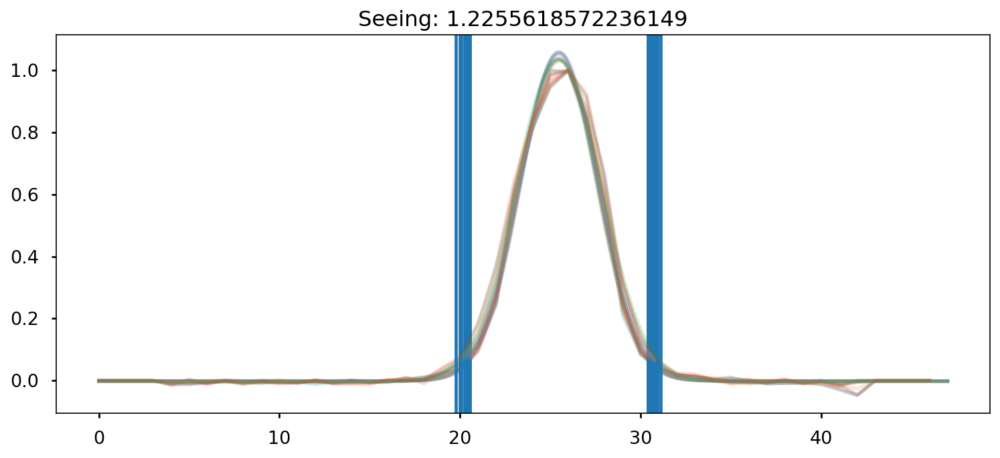

Mediana espectro estrella:  28.734825
Mediana fluxcal:  6.012522916070171e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.73310433]
calib Data:  [1.49370808]


<ipython-input-21-0b12572c6f73>:34: RuntimeWarning: invalid value encountered in power
  transmission_function = np.interp(wave-alpha, wave, trans_std)**beta
<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


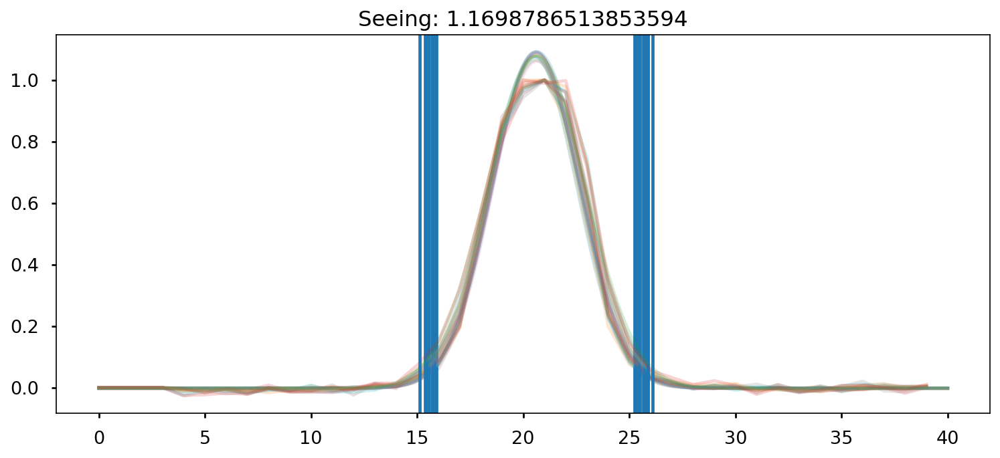

Mediana espectro estrella:  17.443398
Mediana fluxcal:  5.702931565270733e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.40199104]
calib Data:  [1.59379484]


<ipython-input-21-0b12572c6f73>:34: RuntimeWarning: invalid value encountered in power
  transmission_function = np.interp(wave-alpha, wave, trans_std)**beta


Fcalib :  [8.02606142e-18 8.02374093e-18 8.02142133e-18 ... 8.97451346e-18
 8.97717182e-18 8.97983106e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0505/obj_clean004_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0505
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0505/obj_clean004_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0505
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


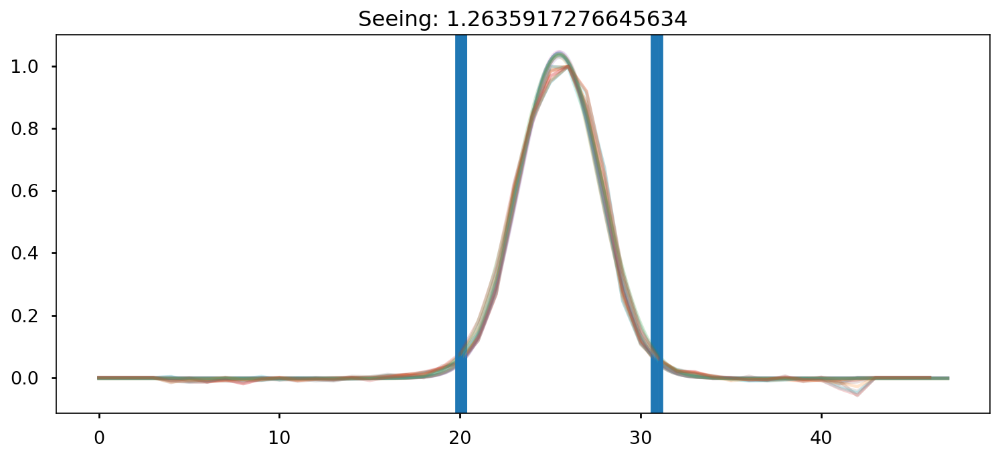

Mediana espectro estrella:  29.592445
Mediana fluxcal:  5.837954097622058e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.72708435]
calib Data:  [1.48544898]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


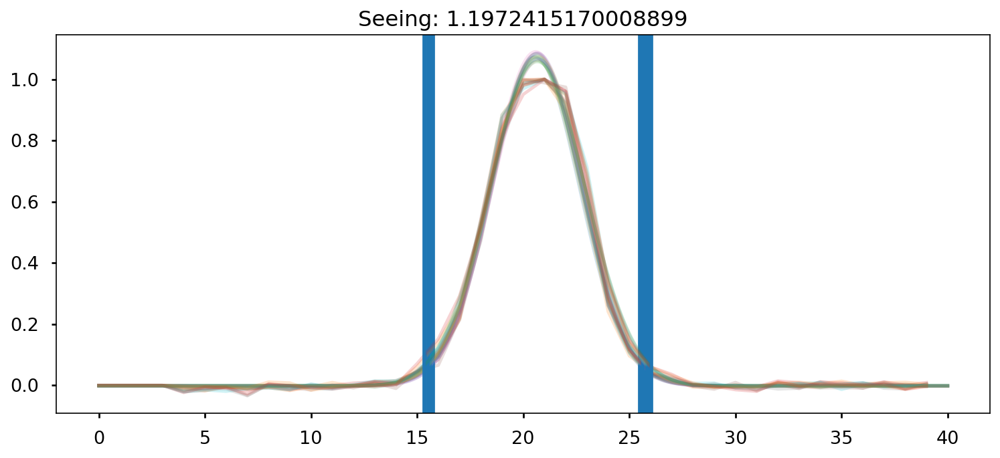

Mediana espectro estrella:  18.367886
Mediana fluxcal:  5.4267574313556115e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.3768884]
calib Data:  [1.55736841]
Fcalib :  [7.79868322e-18 7.79636940e-18 7.79405646e-18 ... 8.73046411e-18
 8.73310988e-18 8.73575653e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0505/obj_clean005_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0505
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0505/obj_clean005_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0505
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


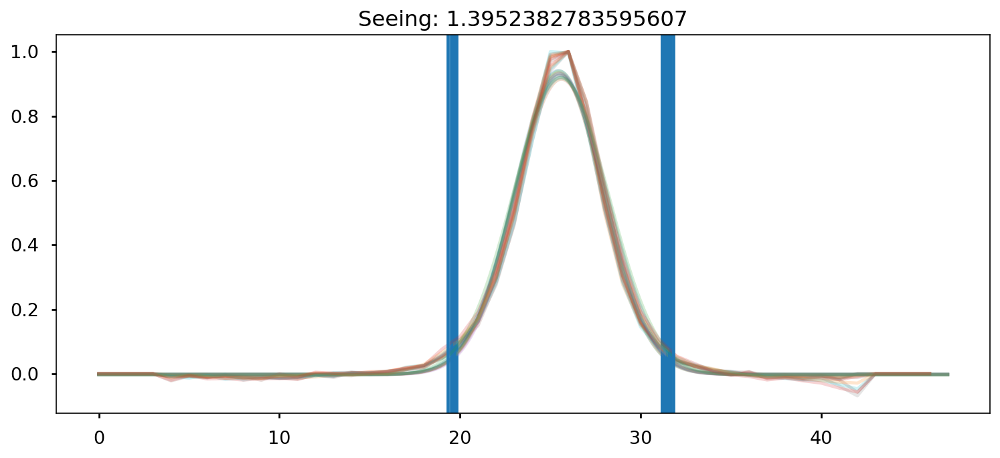

Mediana espectro estrella:  27.563555
Mediana fluxcal:  6.2810585174913534e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.73489998]
calib Data:  [1.4961805]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


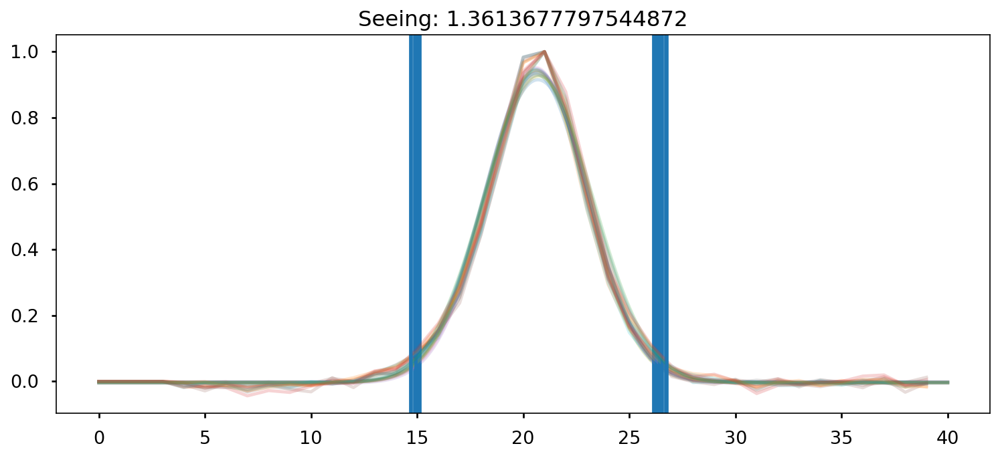

Mediana espectro estrella:  15.2583885
Mediana fluxcal:  5.515687517110359e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.71104893]
calib Data:  [2.11863222]


<ipython-input-21-0b12572c6f73>:34: RuntimeWarning: invalid value encountered in power
  transmission_function = np.interp(wave-alpha, wave, trans_std)**beta


Fcalib :  [6.11206346e-18 6.11047255e-18 6.10888256e-18 ... 1.17769830e-17
 1.17805875e-17 1.17841931e-17]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0505/obj_clean006_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0505
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0505/obj_clean006_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0505
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


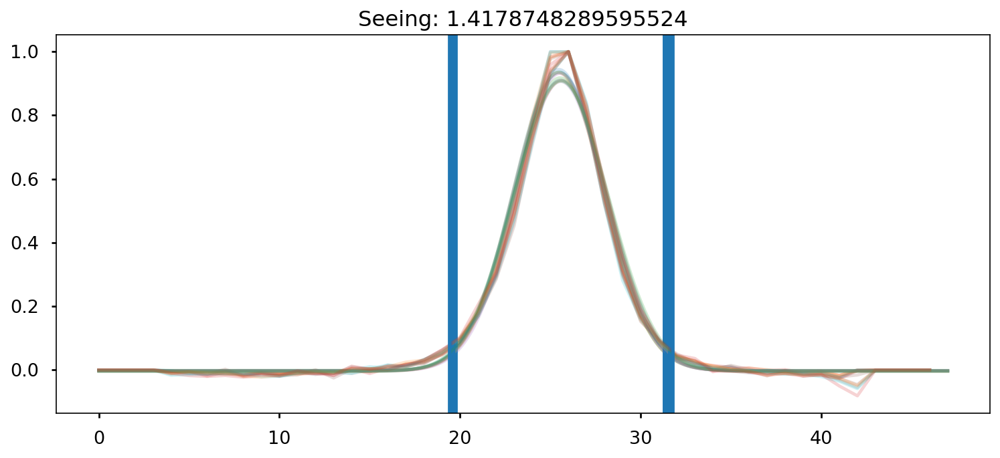

Mediana espectro estrella:  23.409027
Mediana fluxcal:  7.391832107145998e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.71373954]
calib Data:  [1.46730304]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


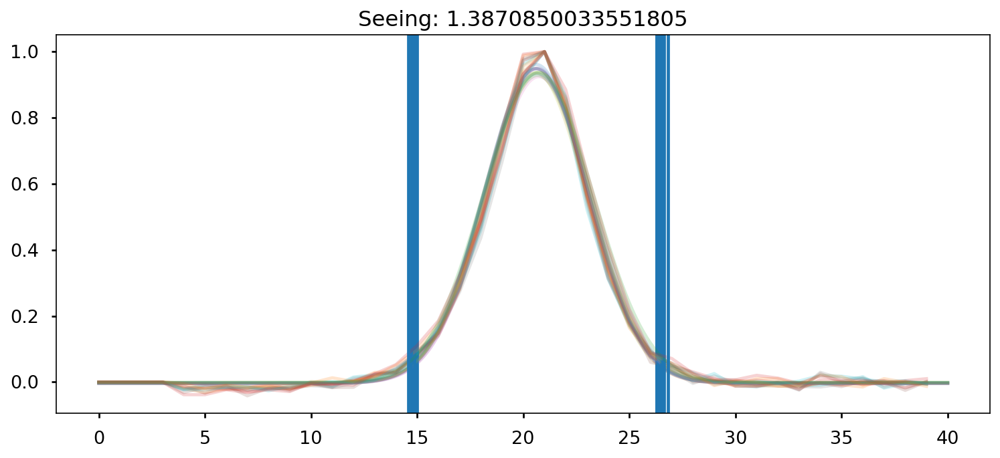

Mediana espectro estrella:  13.022801
Mediana fluxcal:  8.728845926475071e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.35590272]
calib Data:  [1.52755582]
Fcalib :  [1.07527695e-17 1.07483311e-17 1.07438948e-17 ... 1.88462920e-17
 1.88536081e-17 1.88609263e-17]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0505/obj_clean007_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0505
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0505/obj_clean007_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0505
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


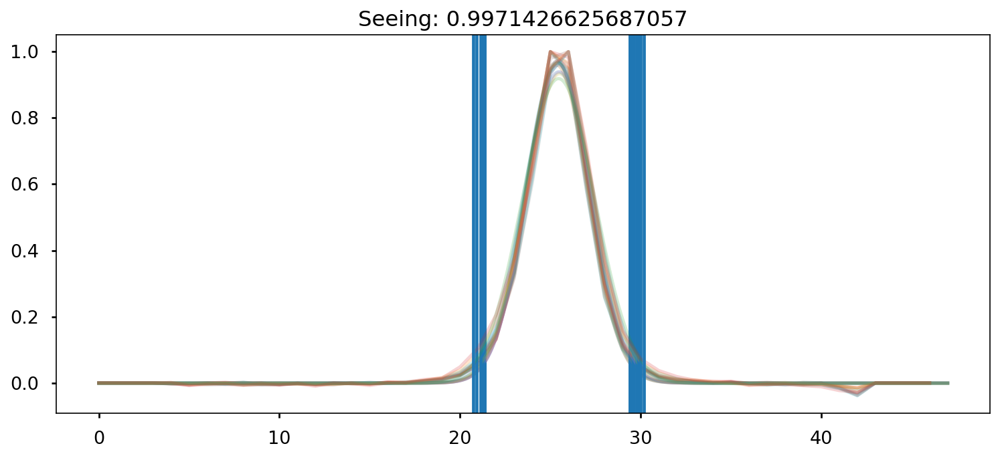

Mediana espectro estrella:  40.359585
Mediana fluxcal:  4.240329313839988e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.7385003]
calib Data:  [1.5011501]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


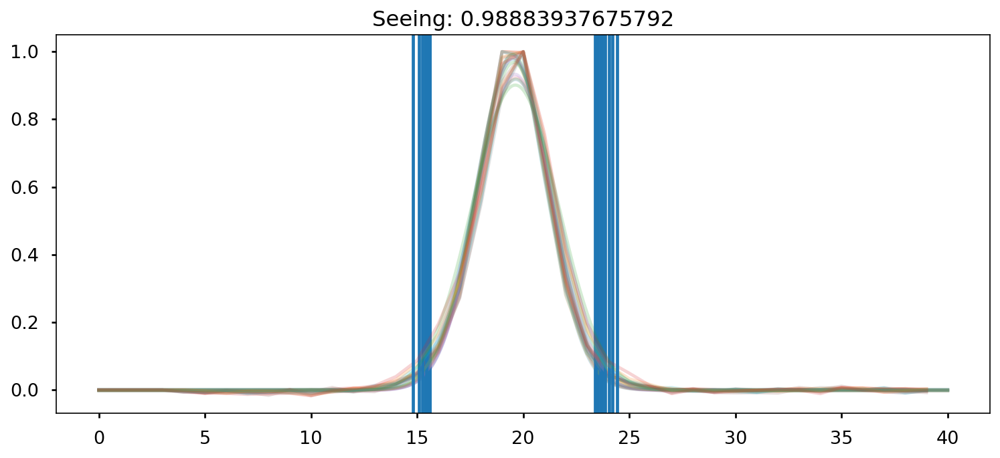

Mediana espectro estrella:  23.122343
Mediana fluxcal:  4.33578509275879e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.33379975]
calib Data:  [1.49677287]
Fcalib :  [6.06601390e-18 6.06368207e-18 6.06135122e-18 ... 8.57634923e-18
 8.57957398e-18 8.58279971e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean000_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean000_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


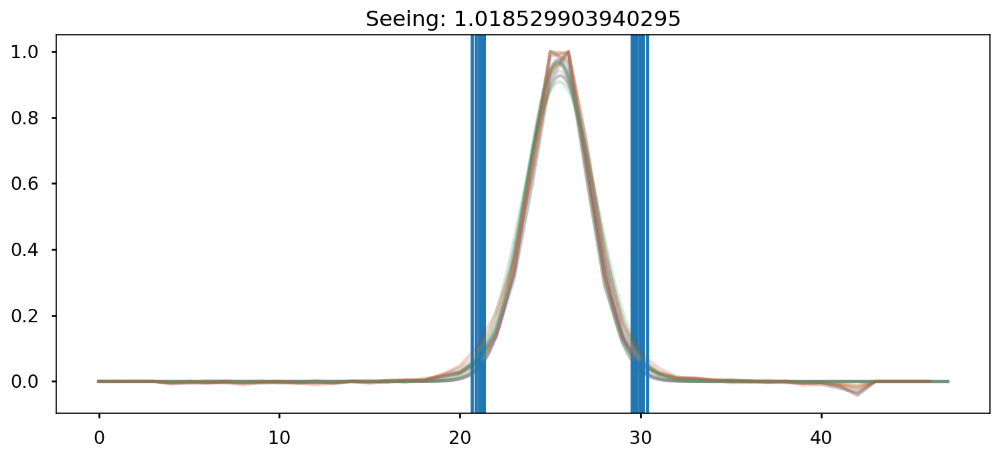

Mediana espectro estrella:  39.307404
Mediana fluxcal:  4.351881412625678e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.73601518]
calib Data:  [1.49771808]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


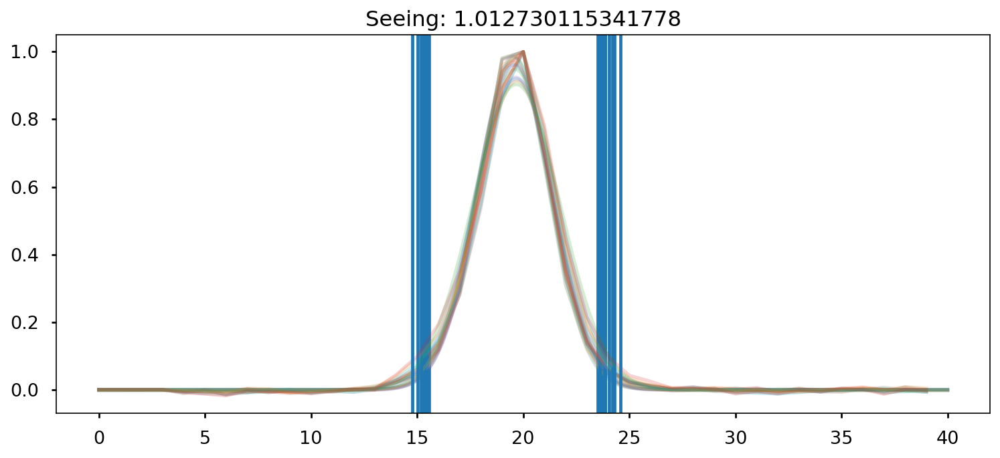

Mediana espectro estrella:  22.442028
Mediana fluxcal:  4.4928460936288535e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.32151136]
calib Data:  [1.47992785]
Fcalib :  [6.33106613e-18 6.32860355e-18 6.32614200e-18 ... 8.85660718e-18
 8.85996814e-18 8.86333012e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean001_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean001_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


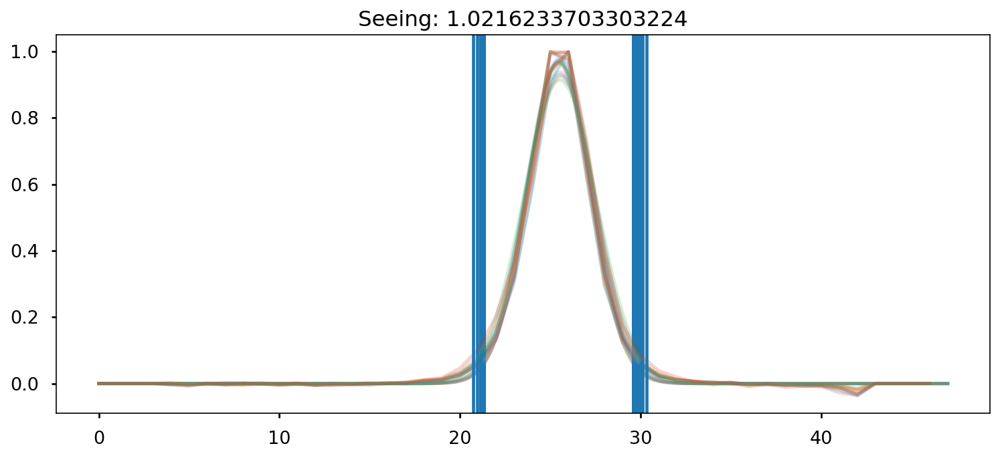

Mediana espectro estrella:  39.6476
Mediana fluxcal:  4.300393501100339e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.73538572]
calib Data:  [1.49685003]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


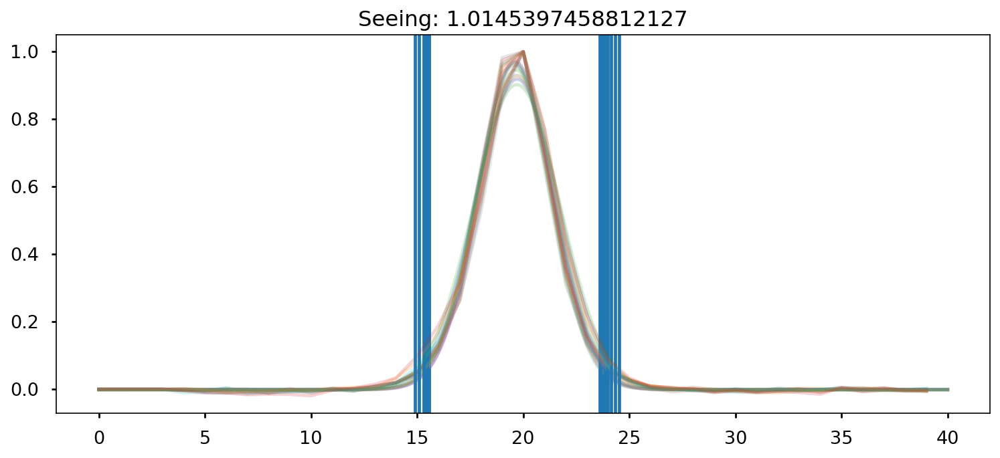

Mediana espectro estrella:  22.550468
Mediana fluxcal:  4.461192067543842e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.32227237]
calib Data:  [1.48096552]
Fcalib :  [6.26065234e-18 6.25822099e-18 6.25579067e-18 ... 8.77262892e-18
 8.77595380e-18 8.77927971e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean002_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean002_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


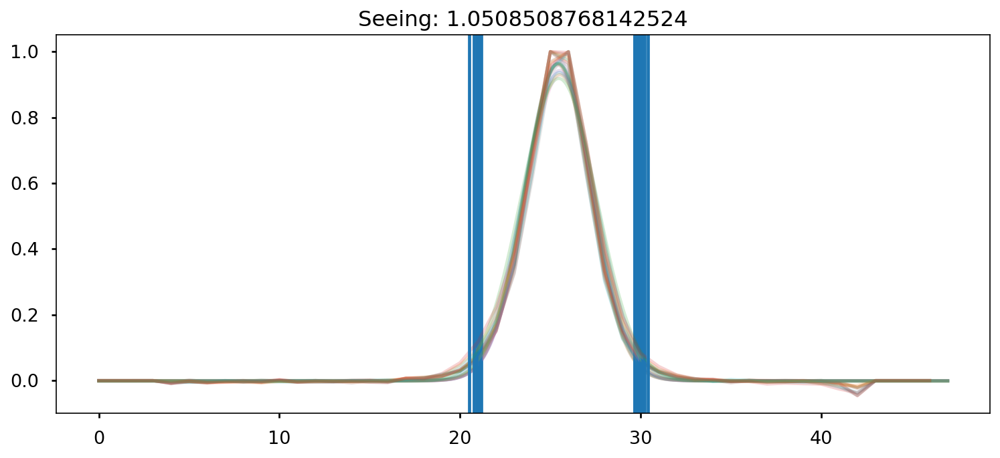

Mediana espectro estrella:  37.200043
Mediana fluxcal:  4.573231824202914e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.73613721]
calib Data:  [1.49788643]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


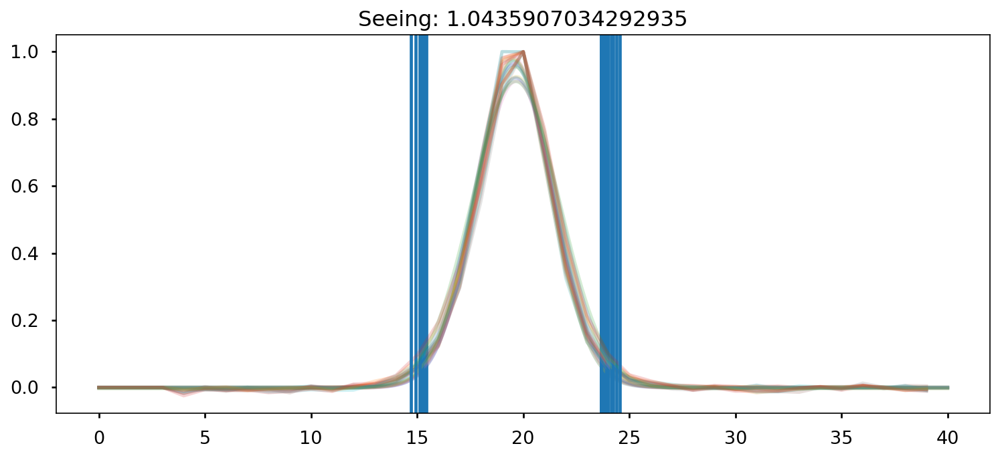

Mediana espectro estrella:  21.086817
Mediana fluxcal:  4.725719237302997e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.32986092]
calib Data:  [1.49135271]
Fcalib :  [6.62038202e-18 6.61781119e-18 6.61524144e-18 ... 9.34551354e-18
 9.34905371e-18 9.35259496e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean003_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean003_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


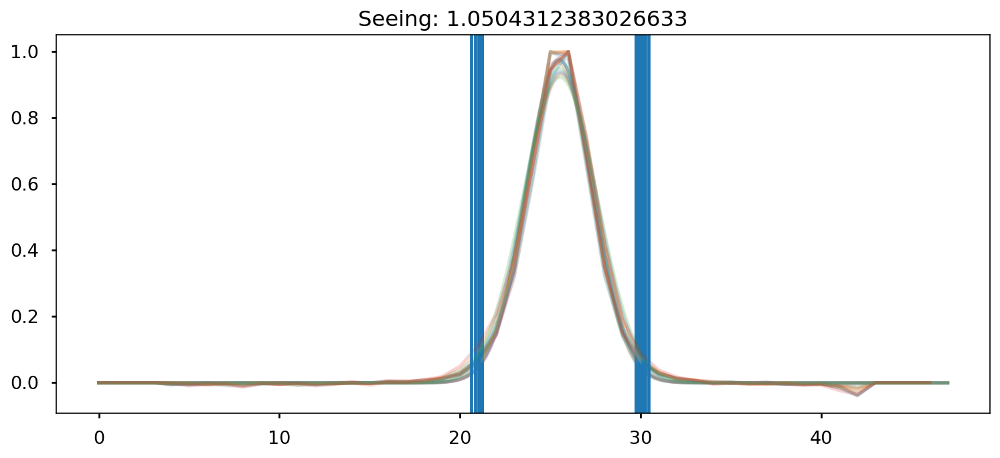

Mediana espectro estrella:  37.546455
Mediana fluxcal:  4.549073818681874e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.73957921]
calib Data:  [1.50264255]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


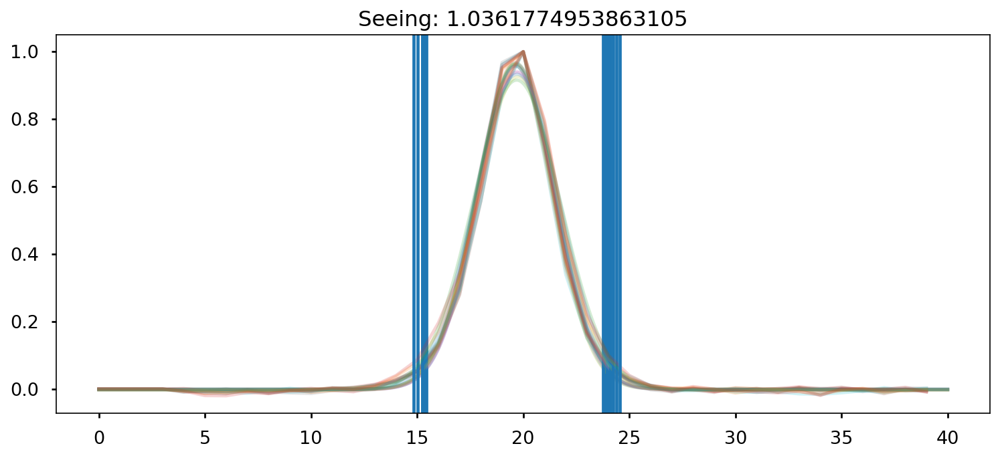

Mediana espectro estrella:  21.443867
Mediana fluxcal:  4.669998082290859e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.324645]
calib Data:  [1.48420537]
Fcalib :  [6.56224853e-18 6.55969619e-18 6.55714494e-18 ... 9.28022477e-18
 9.28374389e-18 9.28726409e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean004_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean004_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


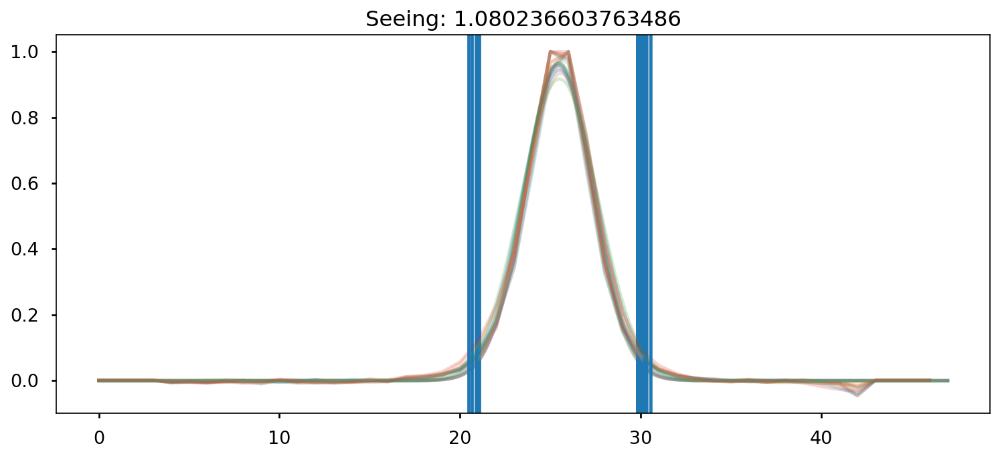

Mediana espectro estrella:  38.00518
Mediana fluxcal:  4.467390640818593e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.72756914]
calib Data:  [1.48611239]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


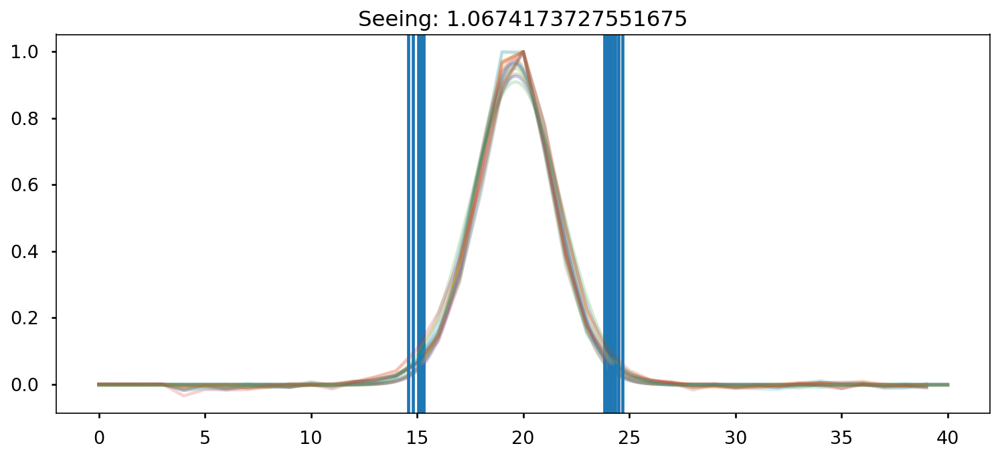

Mediana espectro estrella:  20.590137
Mediana fluxcal:  4.990669600078667e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.30610225]
calib Data:  [1.4590726]
Fcalib :  [6.89171110e-18 6.88898650e-18 6.88626303e-18 ... 9.47525106e-18
 9.47889474e-18 9.48253954e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean005_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean005_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


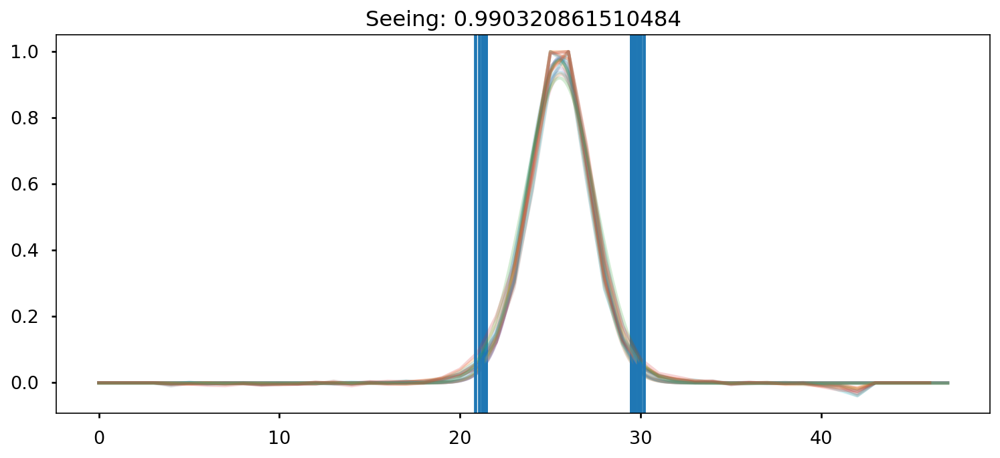

Mediana espectro estrella:  39.550423
Mediana fluxcal:  4.324514663898948e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.73102458]
calib Data:  [1.4908496]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


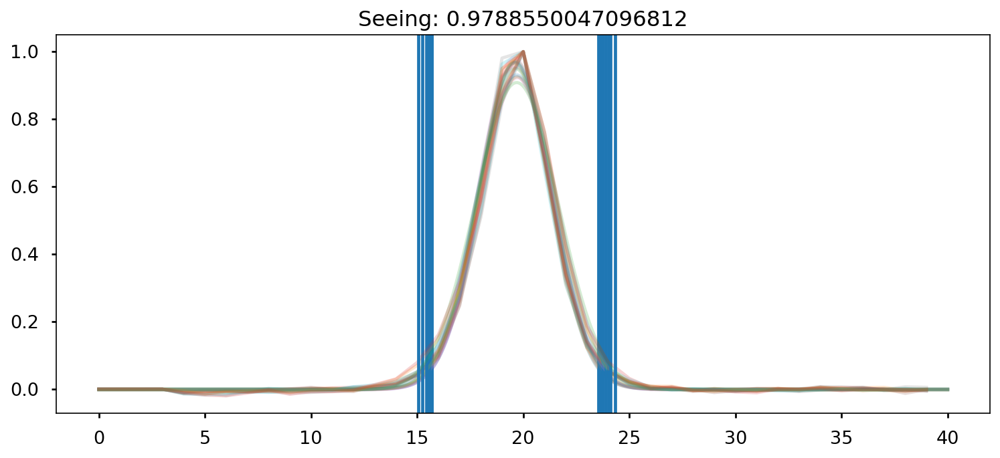

Mediana espectro estrella:  22.60423
Mediana fluxcal:  4.487957307334428e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.31363346]
calib Data:  [1.46922864]
Fcalib :  [6.32595646e-18 6.32346979e-18 6.32098418e-18 ... 8.90458286e-18
 8.90798677e-18 8.91139172e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean006_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean006_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


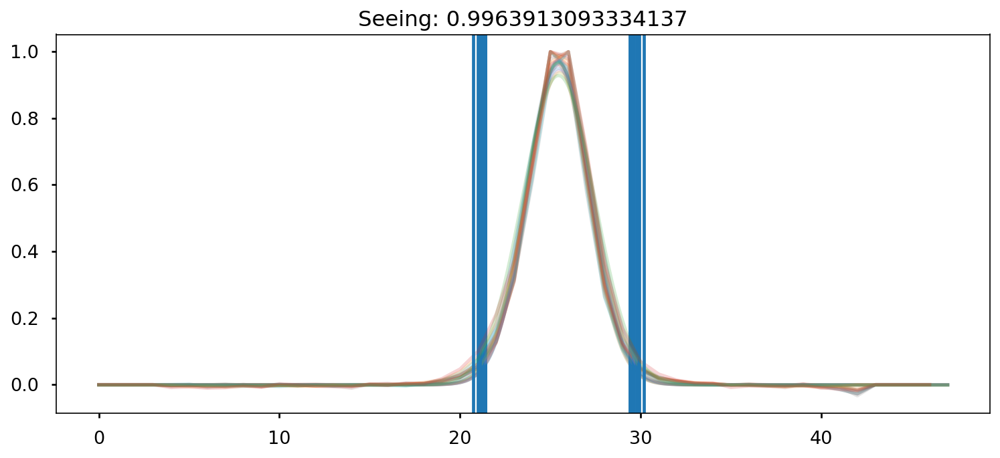

Mediana espectro estrella:  39.109016
Mediana fluxcal:  4.392550086838177e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.73768799]
calib Data:  [1.50002741]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


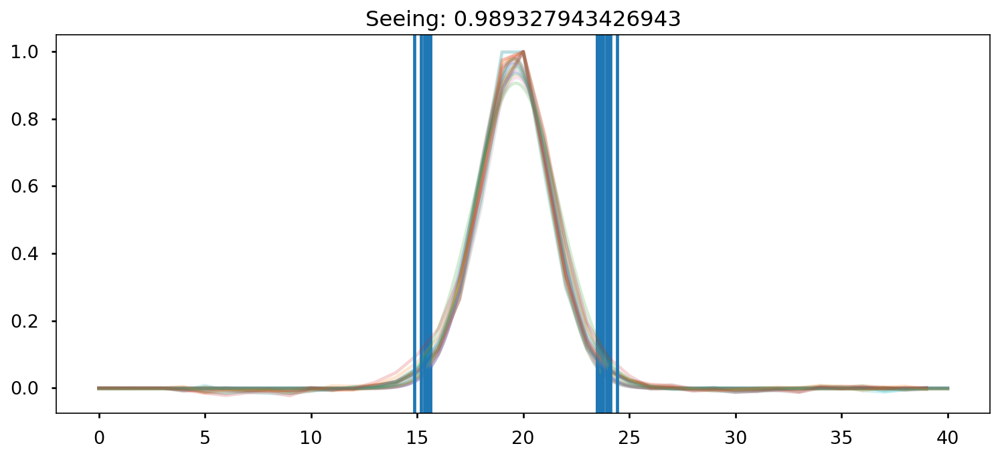

Mediana espectro estrella:  22.413895
Mediana fluxcal:  4.479655474816471e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.31111992]
calib Data:  [1.46583123]
Fcalib :  [6.34821704e-18 6.34573432e-18 6.34325265e-18 ... 8.94173726e-18
 8.94514251e-18 8.94854880e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean007_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean007_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


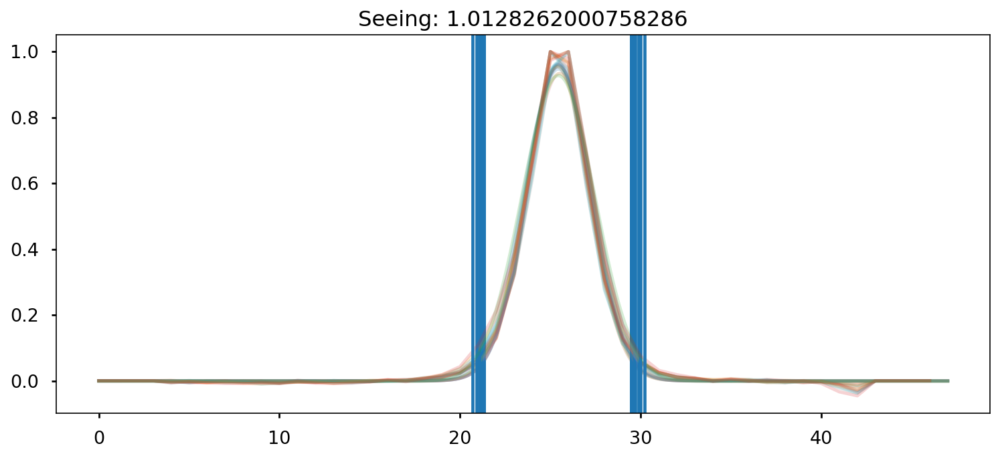

Mediana espectro estrella:  37.82
Mediana fluxcal:  4.509637512412827e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.71237071]
calib Data:  [1.46545431]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


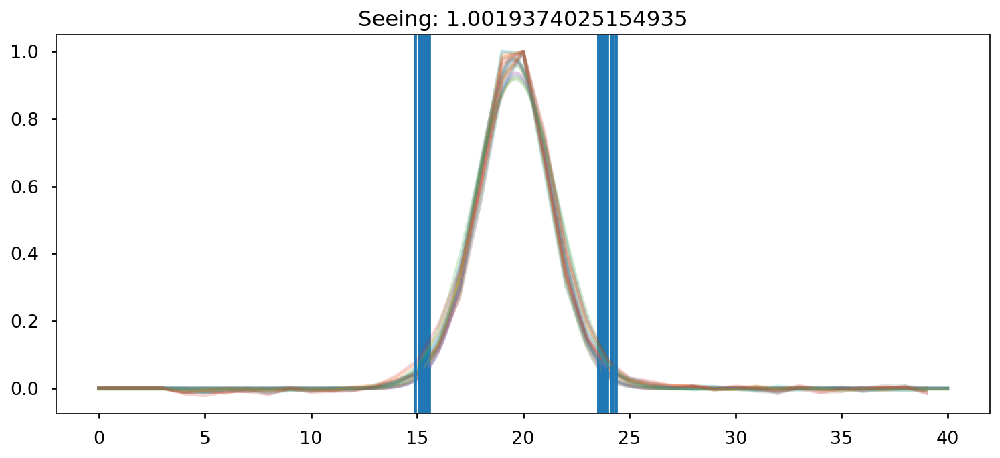

Mediana espectro estrella:  21.800987
Mediana fluxcal:  4.6215262903933926e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.29674517]
calib Data:  [1.44655207]
Fcalib :  [6.57721526e-18 6.57462711e-18 6.57204005e-18 ... 9.20858618e-18
 9.21211035e-18 9.21563561e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean008_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean008_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


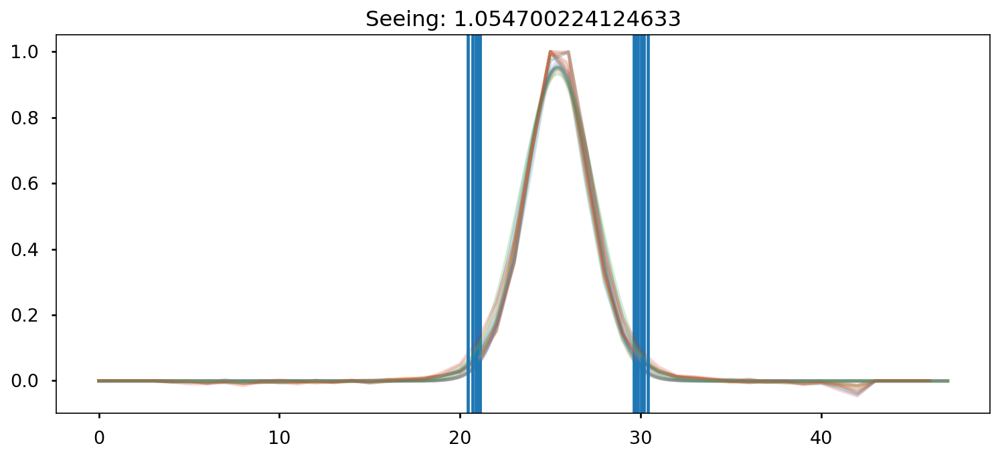

Mediana espectro estrella:  35.83417
Mediana fluxcal:  4.758290471125188e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.70164144]
calib Data:  [1.45104398]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


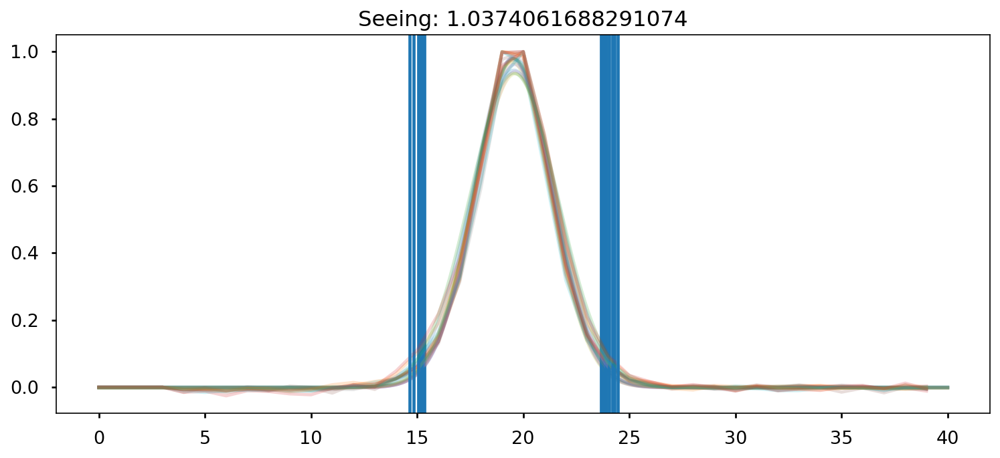

Mediana espectro estrella:  20.642189
Mediana fluxcal:  4.8319958031426475e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.30916828]
calib Data:  [1.46319872]
Fcalib :  [6.88925658e-18 6.88654623e-18 6.88383702e-18 ... 9.69252052e-18
 9.69622802e-18 9.69993665e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean009_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean009_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


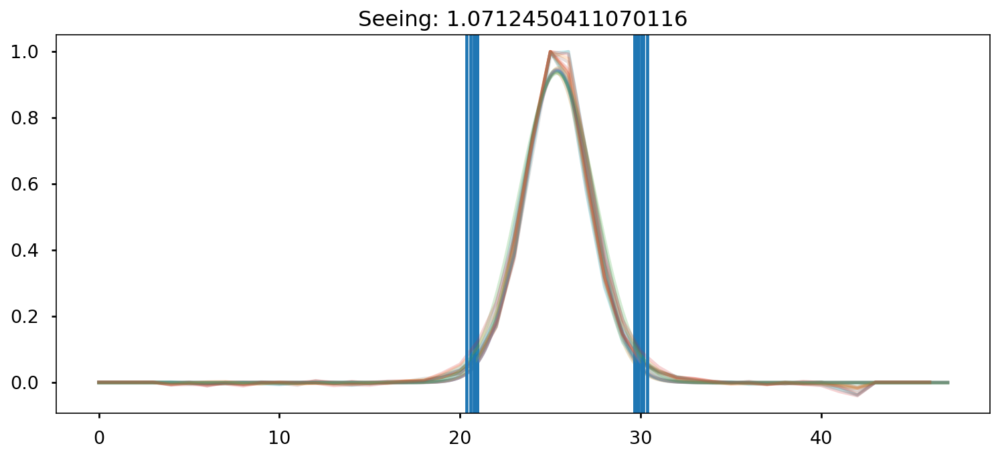

Mediana espectro estrella:  35.334583
Mediana fluxcal:  4.9104053289688614e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.69799268]
calib Data:  [1.44617574]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


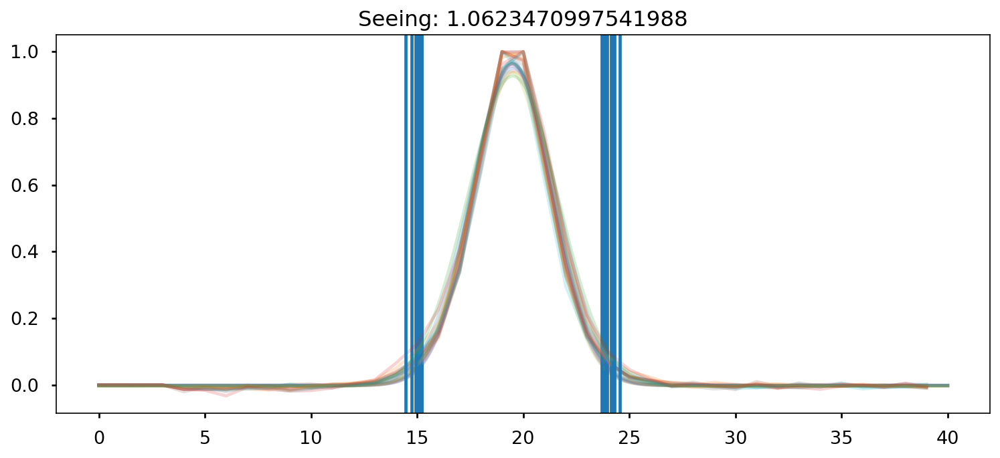

Mediana espectro estrella:  20.198471
Mediana fluxcal:  4.9262016129835424e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.312099]
calib Data:  [1.46715366]
Fcalib :  [7.04947791e-18 7.04670137e-18 7.04392601e-18 ... 9.97663022e-18
 9.98044795e-18 9.98426686e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean010_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean010_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


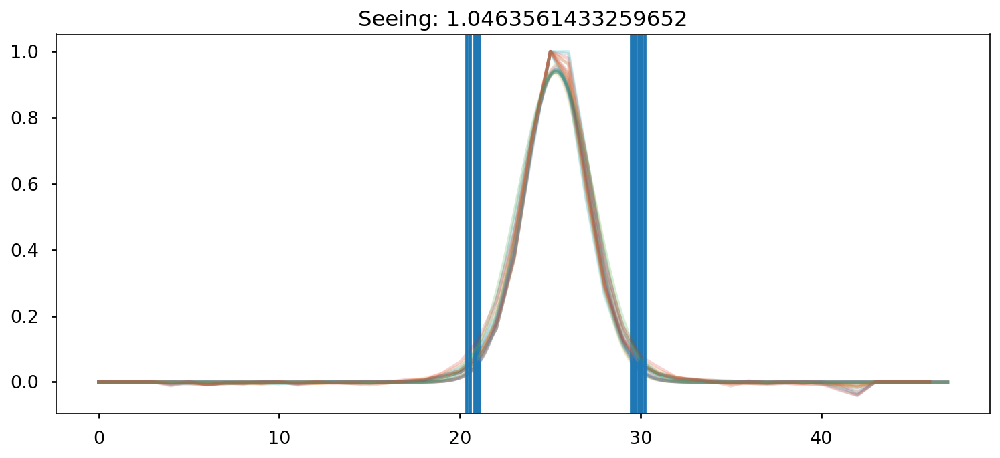

Mediana espectro estrella:  35.76763
Mediana fluxcal:  4.784915669959929e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.68631291]
calib Data:  [1.43070193]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


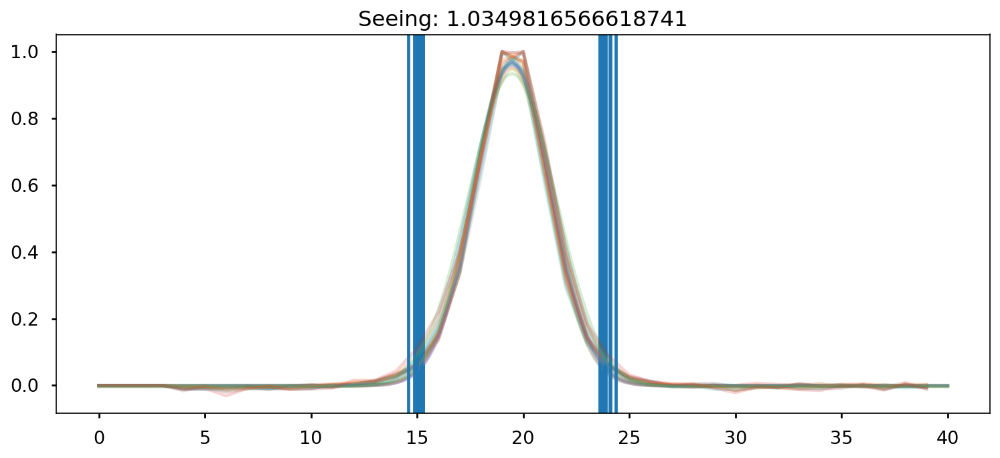

Mediana espectro estrella:  20.757568
Mediana fluxcal:  4.877099108186593e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.28296149]
calib Data:  [1.42830381]
Fcalib :  [7.07763071e-18 7.07478220e-18 7.07193487e-18 ... 9.84144397e-18
 9.84527566e-18 9.84910853e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean011_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0506/obj_clean011_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0506
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


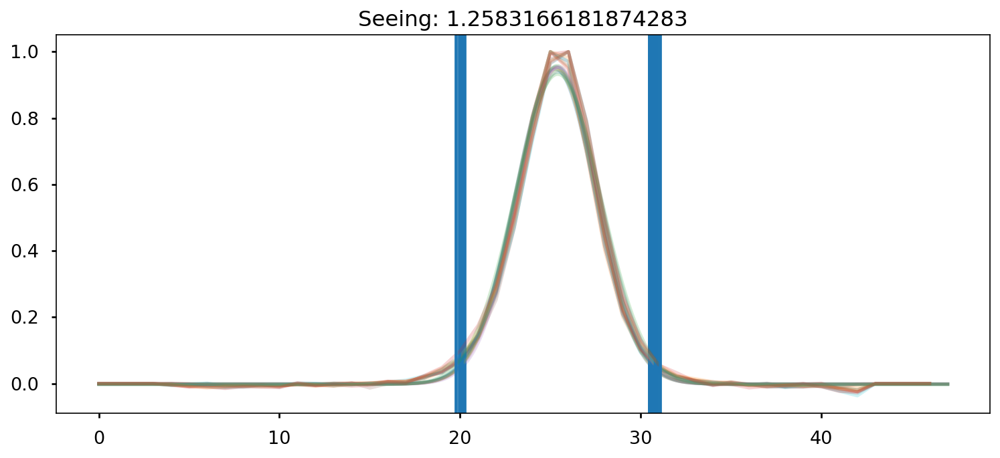

Mediana espectro estrella:  33.352764
Mediana fluxcal:  5.192939445117678e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.73687876]
calib Data:  [1.49890982]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


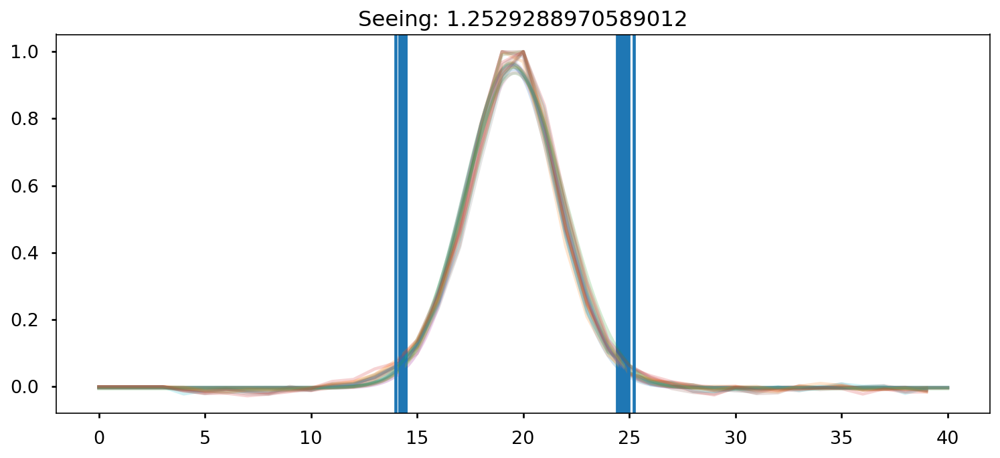

Mediana espectro estrella:  18.706905
Mediana fluxcal:  5.2253008990196756e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.37214843]
calib Data:  [1.55058426]
Fcalib :  [7.10435915e-18 7.10170634e-18 7.09905469e-18 ... 1.05075997e-17
 1.05114629e-17 1.05153272e-17]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0507/obj_clean000_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0507
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0507/obj_clean000_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0507
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


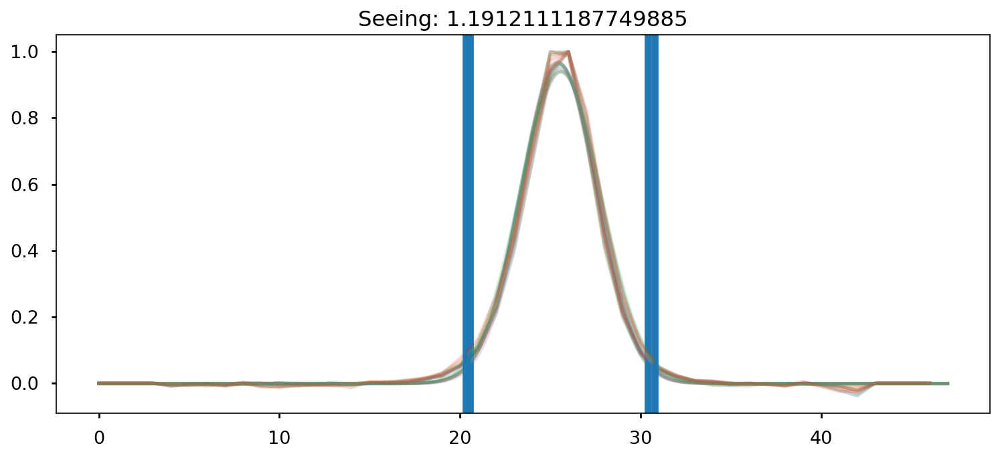

Mediana espectro estrella:  36.200737
Mediana fluxcal:  4.7781132203408e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.73087424]
calib Data:  [1.49064317]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


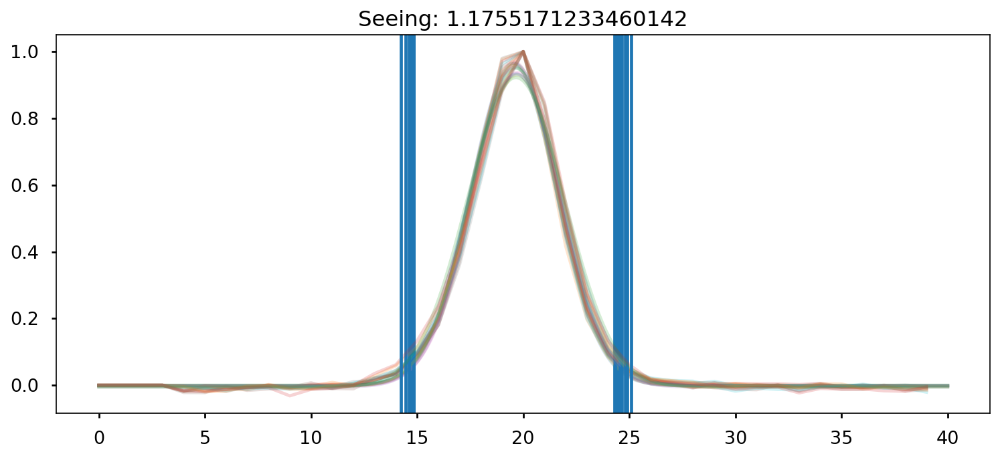

Mediana espectro estrella:  20.36881
Mediana fluxcal:  4.784942609148309e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.36961669]
calib Data:  [1.5469728]
Fcalib :  [6.56938282e-18 6.56693737e-18 6.56449298e-18 ... 9.52737584e-18
 9.53087333e-18 9.53437187e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0507/obj_clean001_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0507
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0507/obj_clean001_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0507
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


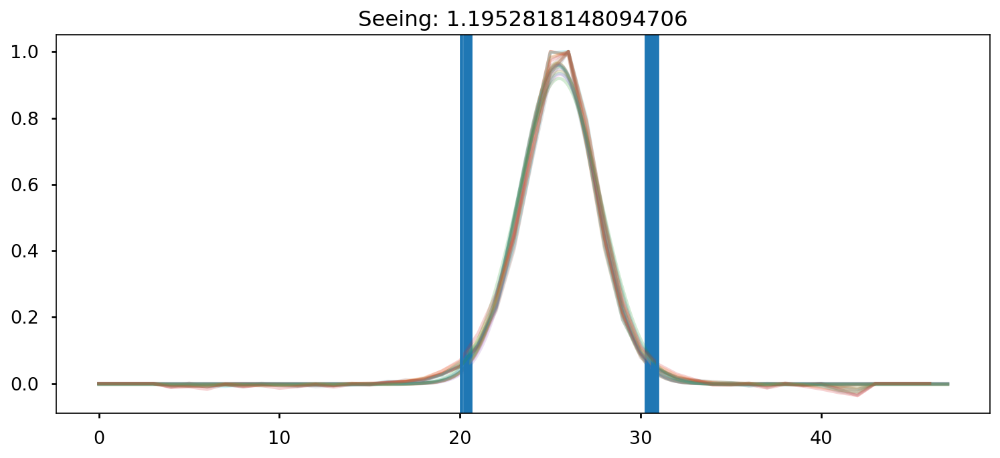

Mediana espectro estrella:  35.38208
Mediana fluxcal:  4.869319533893059e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.72634512]
calib Data:  [1.48443795]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


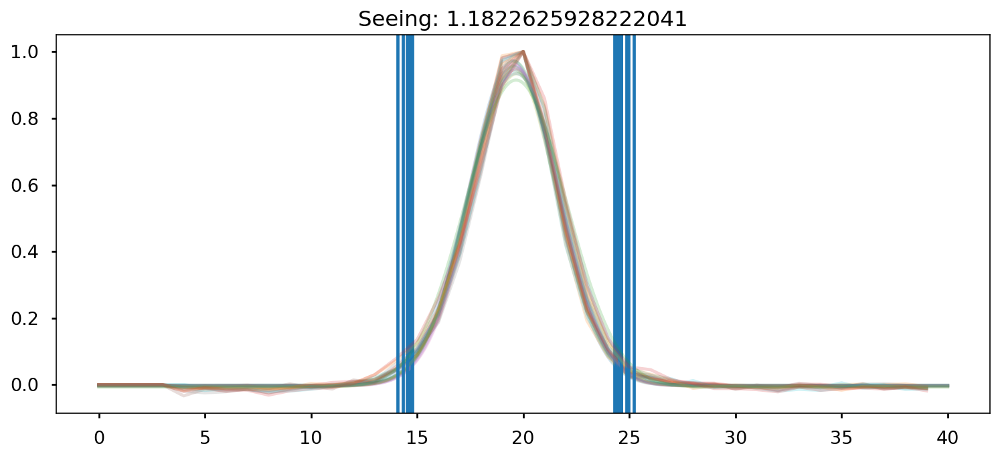

Mediana espectro estrella:  19.741196
Mediana fluxcal:  4.936235815497786e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.36105761]
calib Data:  [1.53482563]
Fcalib :  [6.70184425e-18 6.69933544e-18 6.69682773e-18 ... 9.89006910e-18
 9.89371178e-18 9.89735556e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0507/obj_clean002_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0507
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0507/obj_clean002_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0507
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


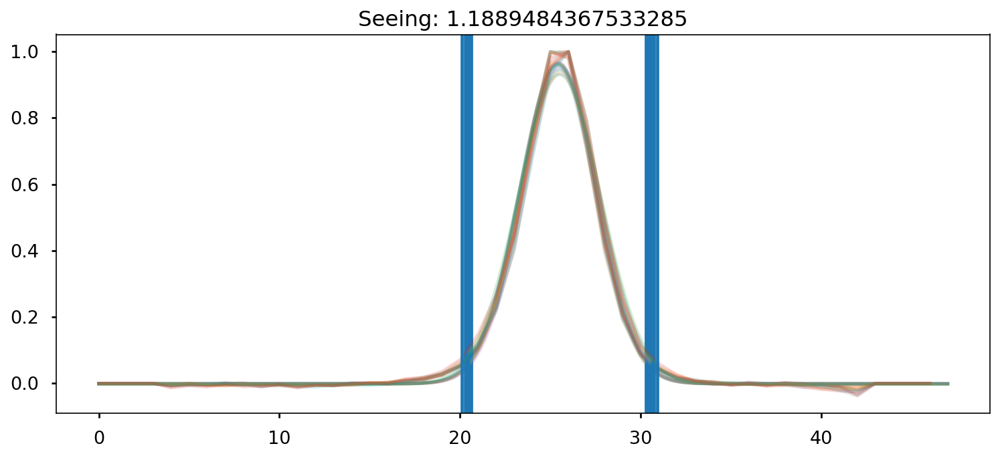

Mediana espectro estrella:  36.390144
Mediana fluxcal:  4.763792302388393e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.73122986]
calib Data:  [1.49113149]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


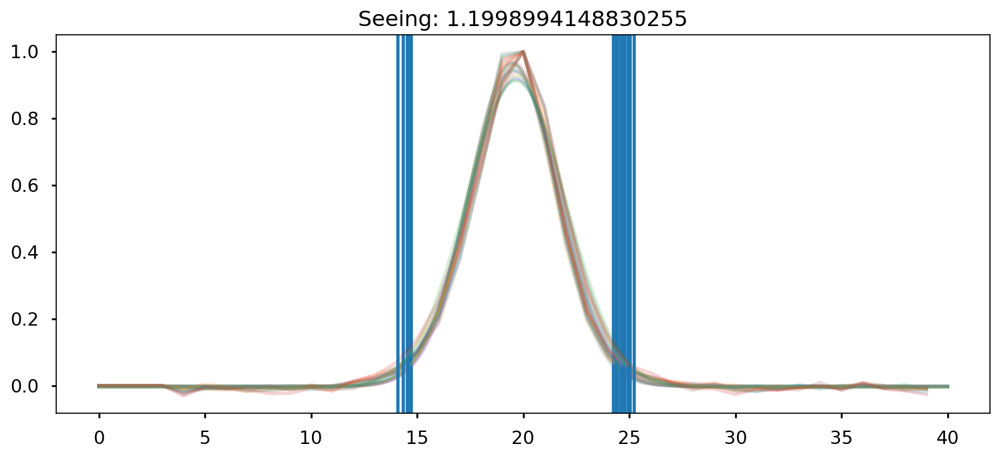

Mediana espectro estrella:  20.35205
Mediana fluxcal:  4.772037883841072e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.37730854]
calib Data:  [1.55797116]
Fcalib :  [6.50505372e-18 6.50263538e-18 6.50021808e-18 ... 9.56366582e-18
 9.56717196e-18 9.57067914e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0507/obj_clean003_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0507
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0507/obj_clean003_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0507
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


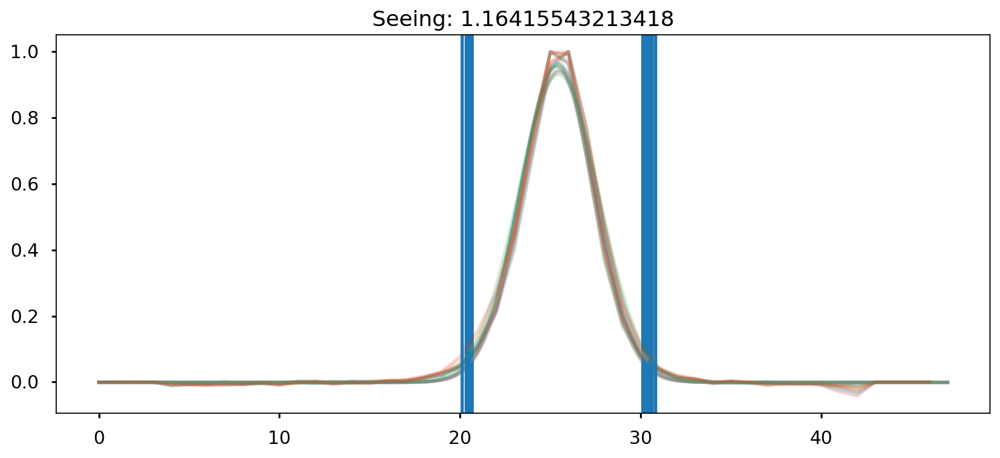

Mediana espectro estrella:  37.29849
Mediana fluxcal:  4.62556139301886e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.73816076]
calib Data:  [1.50068073]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


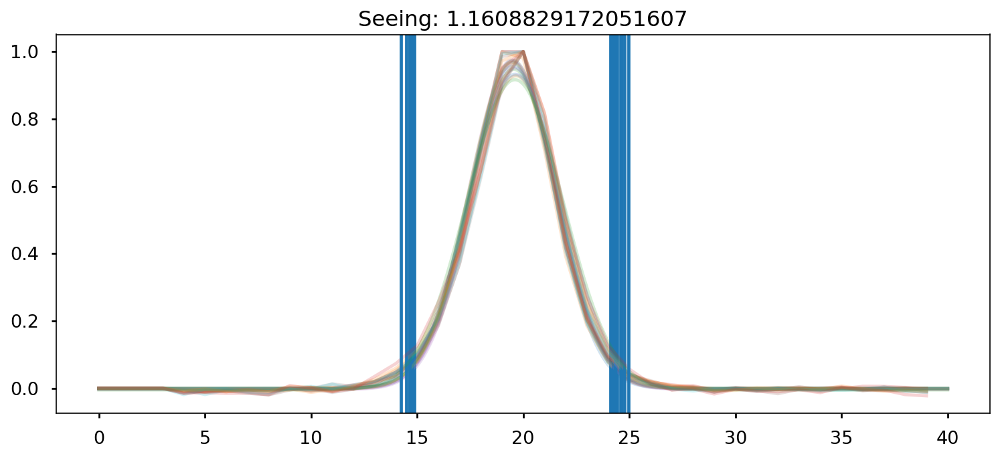

Mediana espectro estrella:  20.836472
Mediana fluxcal:  4.626388844557038e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.37025681]
calib Data:  [1.54788512]
Fcalib :  [6.15045028e-18 6.14828080e-18 6.14611227e-18 ... 9.05845906e-18
 9.06166271e-18 9.06486733e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0507/obj_clean004_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0507
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0507/obj_clean004_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0507
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


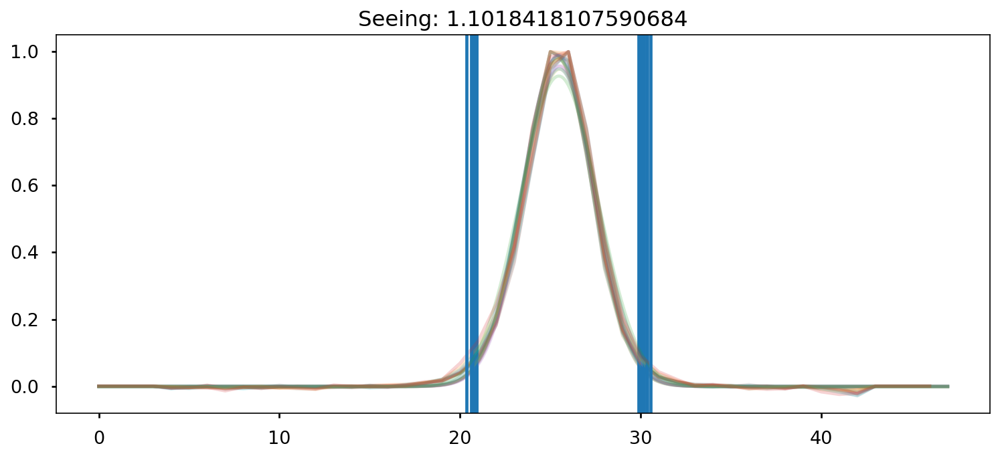

Mediana espectro estrella:  39.445015
Mediana fluxcal:  4.415315802138894e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.72275643]
calib Data:  [1.47953953]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


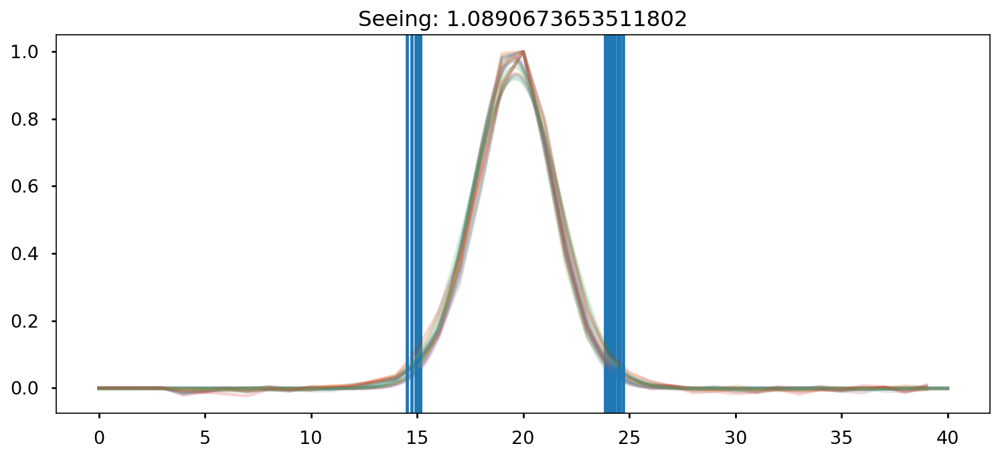

Mediana espectro estrella:  22.289135
Mediana fluxcal:  4.3565543813143224e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.36398581]
calib Data:  [1.53897061]
Fcalib :  [5.92263092e-18 5.92053140e-18 5.91843278e-18 ... 8.46648208e-18
 8.46948635e-18 8.47249152e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0507/obj_clean005_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0507
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0507/obj_clean005_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0507
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


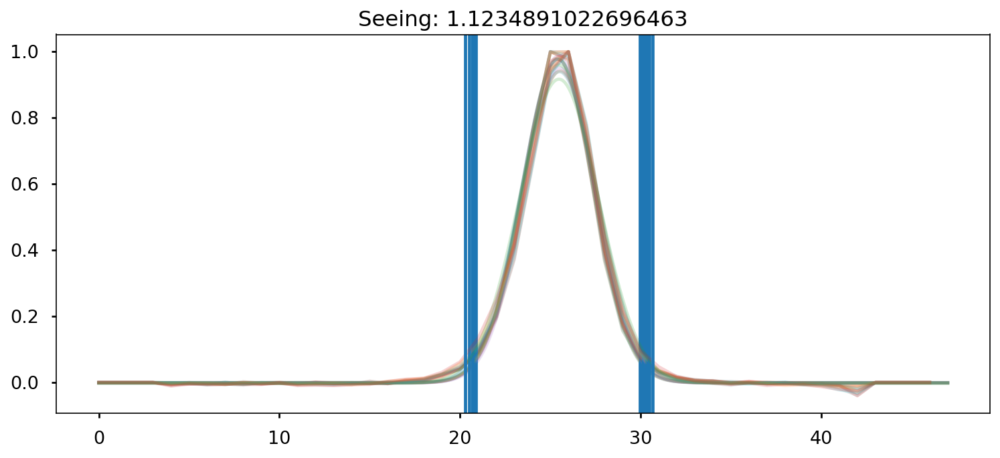

Mediana espectro estrella:  39.426254
Mediana fluxcal:  4.4200409599005235e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.7358176]
calib Data:  [1.49744555]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


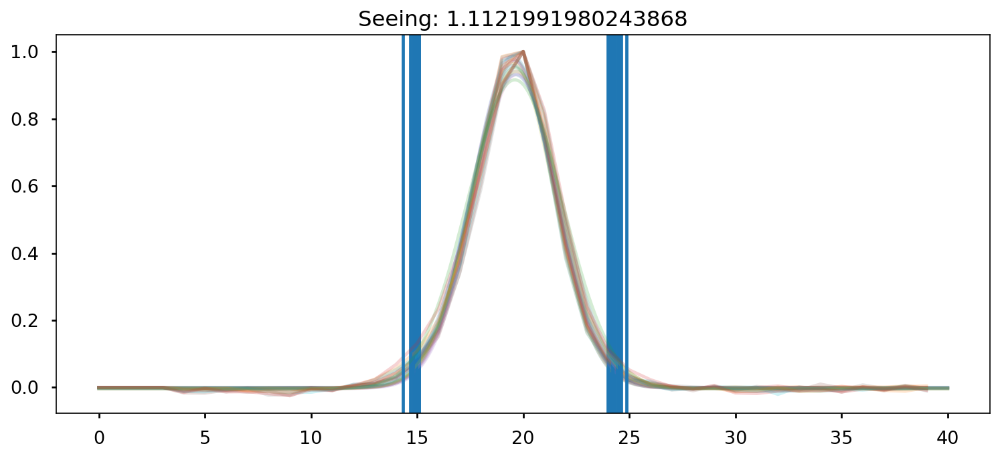

Mediana espectro estrella:  22.17609
Mediana fluxcal:  4.3767868076915115e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.3636316]
calib Data:  [1.53846862]
Fcalib :  [5.97706483e-18 5.97490594e-18 5.97274797e-18 ... 8.59415413e-18
 8.59724382e-18 8.60033444e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0507/obj_clean006_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0507
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0507/obj_clean006_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0507
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


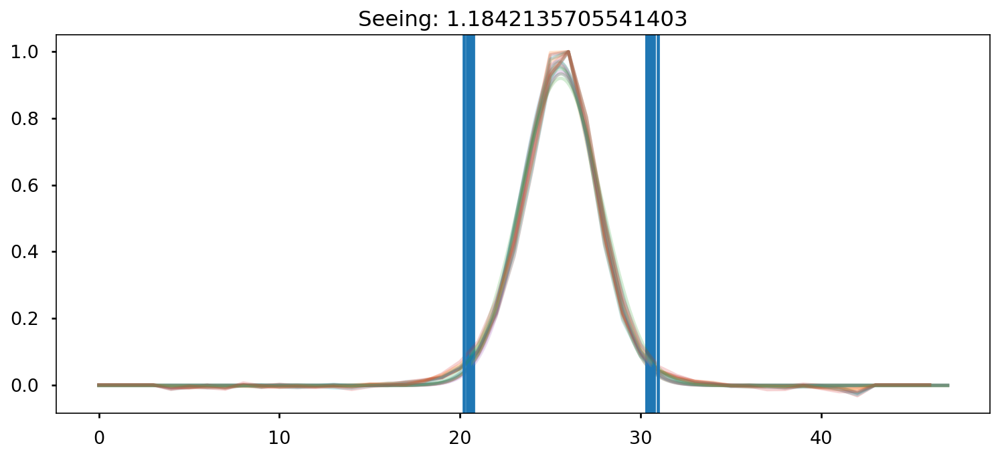

Mediana espectro estrella:  37.59056
Mediana fluxcal:  4.585736590585785e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.73256168]
calib Data:  [1.49296172]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


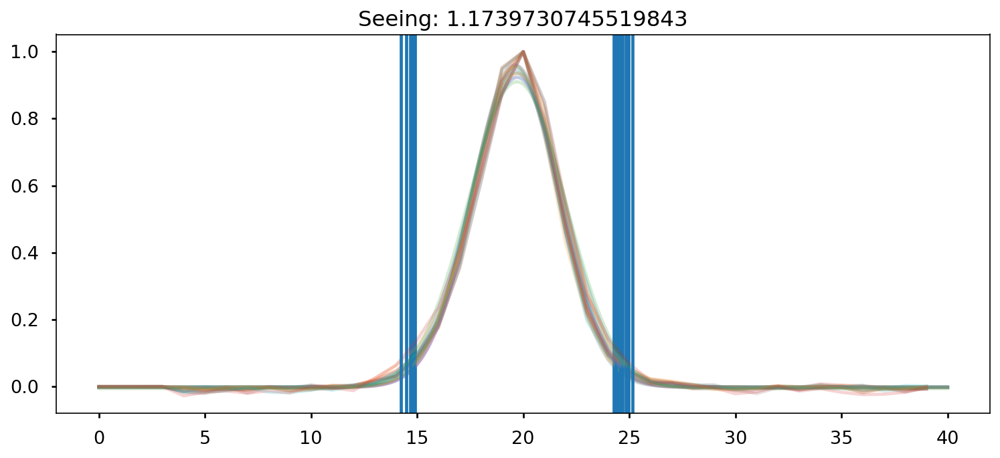

Mediana espectro estrella:  21.276539
Mediana fluxcal:  4.6072391202682474e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.34261278]
calib Data:  [1.50897176]
Fcalib :  [6.27288724e-18 6.27061562e-18 6.26834497e-18 ... 8.95526154e-18
 8.95848719e-18 8.96171382e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0507/obj_clean007_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0507
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0507/obj_clean007_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0507
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


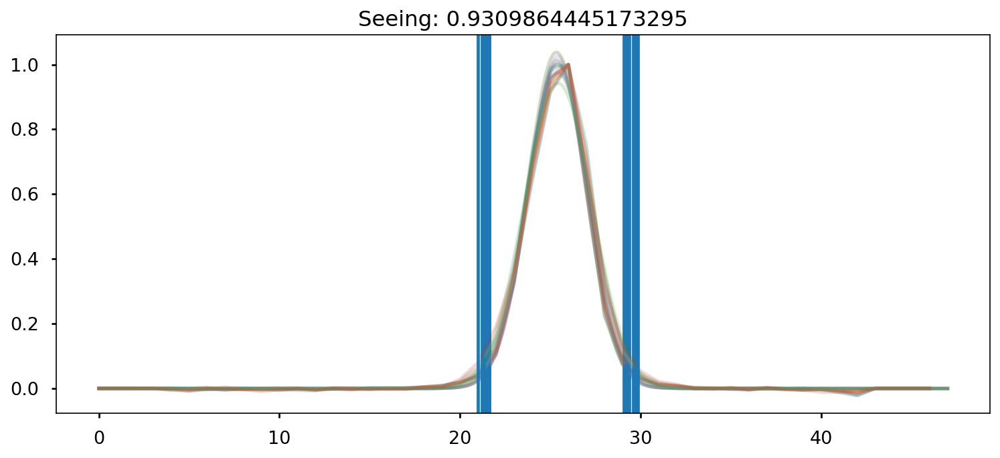

Mediana espectro estrella:  43.308136
Mediana fluxcal:  4.021049498901268e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.72515]
calib Data:  [1.48280486]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


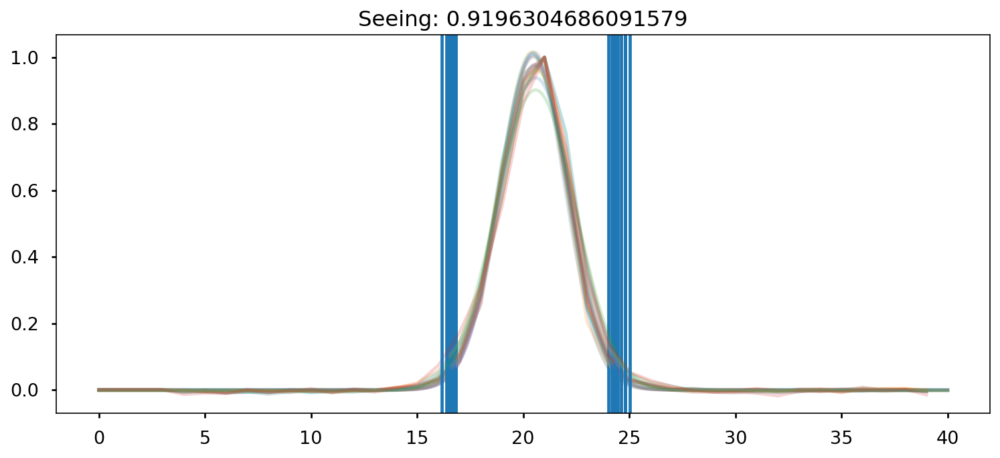

Mediana espectro estrella:  25.443457
Mediana fluxcal:  3.936818661109448e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.37658322]
calib Data:  [1.55693072]
Fcalib :  [5.18124790e-18 5.17985277e-18 5.17845819e-18 ... 6.13809097e-18
 6.13982662e-18 6.14156283e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean000_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean000_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


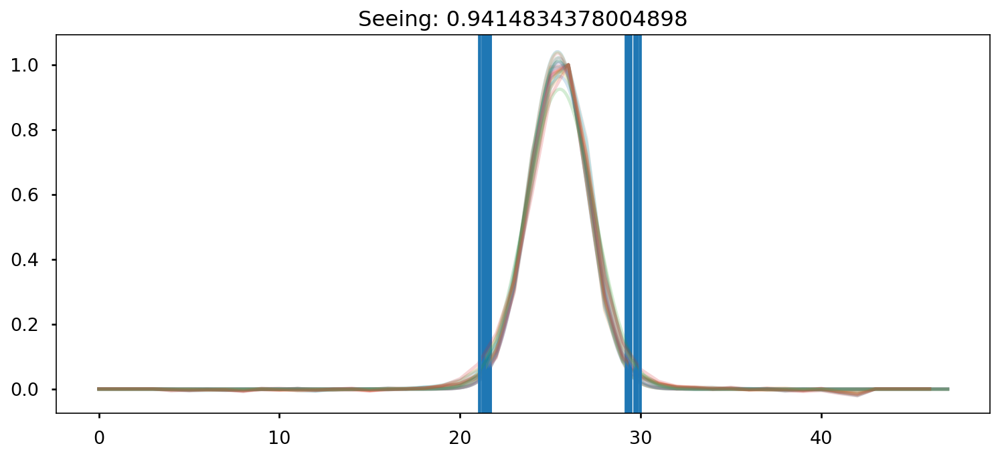

Mediana espectro estrella:  43.95642
Mediana fluxcal:  3.952661449063056e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.73556413]
calib Data:  [1.497096]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


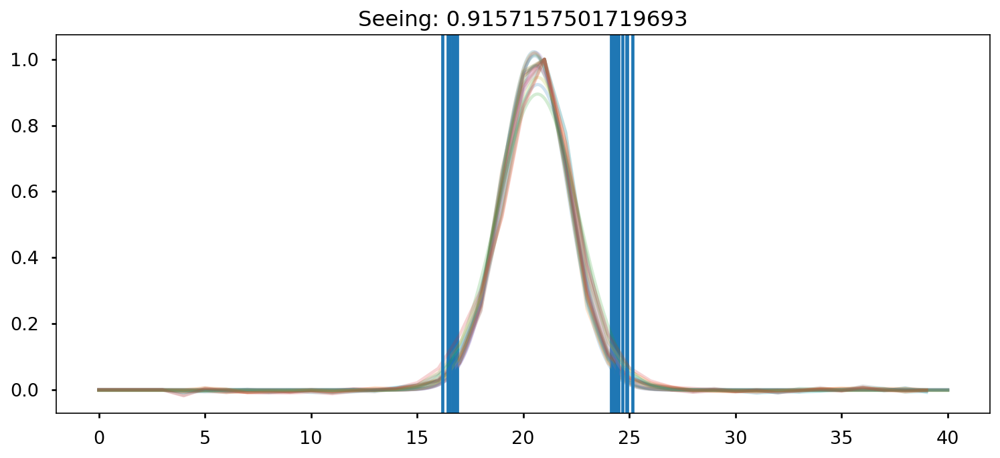

Mediana espectro estrella:  25.610718
Mediana fluxcal:  3.9223668128728494e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.36856341]
calib Data:  [1.54547279]
Fcalib :  [5.35513509e-18 5.35350793e-18 5.35188141e-18 ... 6.40232797e-18
 6.40432785e-18 6.40632838e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean001_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean001_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


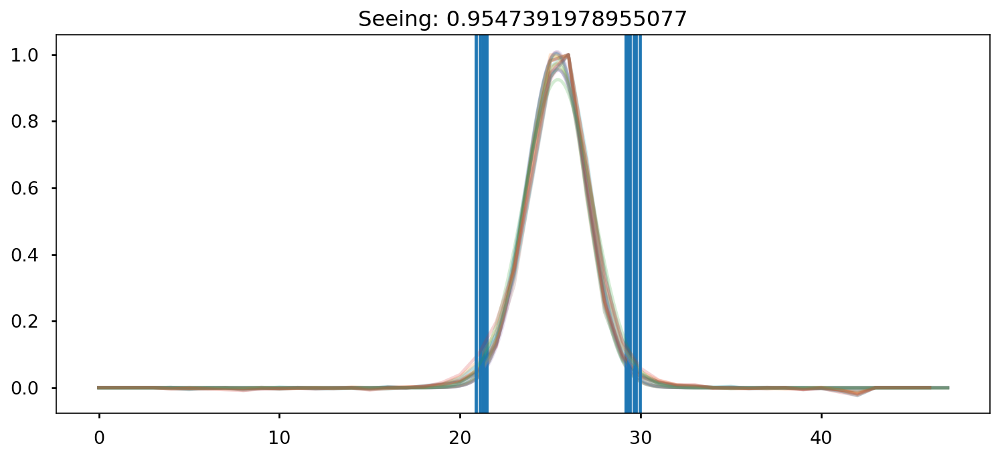

Mediana espectro estrella:  43.812325
Mediana fluxcal:  3.972043402633474e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.73554724]
calib Data:  [1.49707271]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


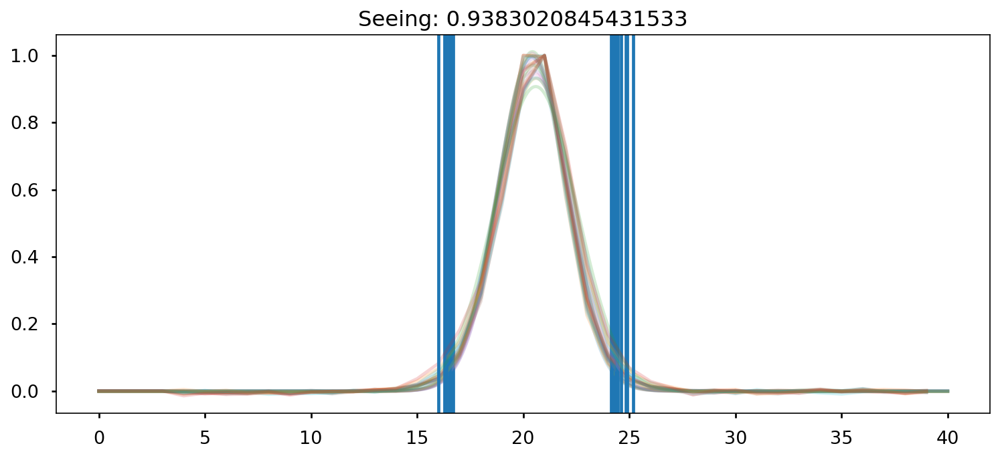

Mediana espectro estrella:  25.05709
Mediana fluxcal:  3.905947892936721e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.36591644]
calib Data:  [1.5417096]
Fcalib :  [5.29580110e-18 5.29412164e-18 5.29244287e-18 ... 6.78910561e-18
 6.79131633e-18 6.79352775e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean002_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean002_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


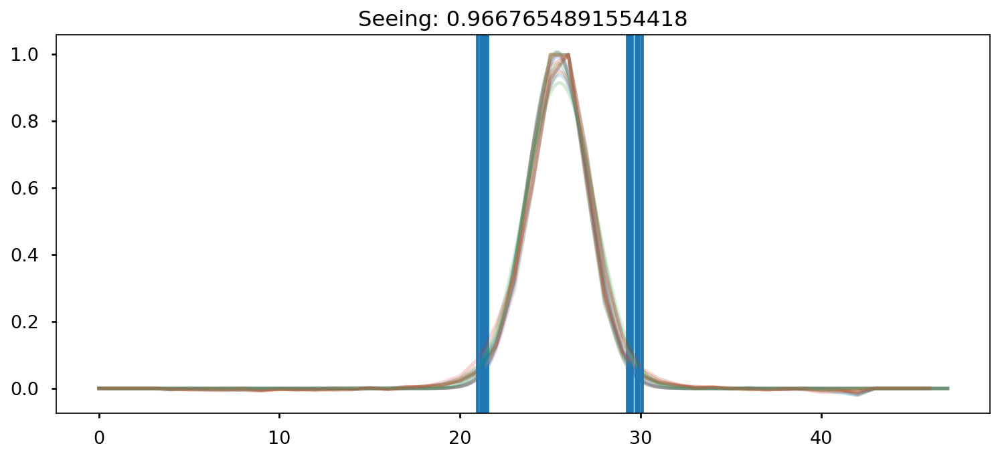

Mediana espectro estrella:  44.10803
Mediana fluxcal:  3.897056616094741e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.72948613]
calib Data:  [1.48873861]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


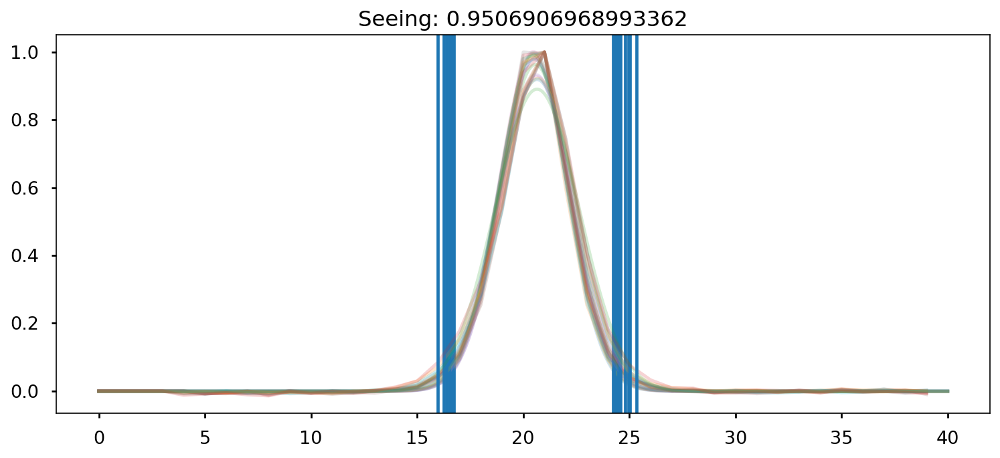

Mediana espectro estrella:  24.818077
Mediana fluxcal:  3.897702313326692e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.35148565]
calib Data:  [1.52135392]
Fcalib :  [5.22486335e-18 5.22317711e-18 5.22149157e-18 ... 6.86541058e-18
 6.86768041e-18 6.86995095e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean003_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean003_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


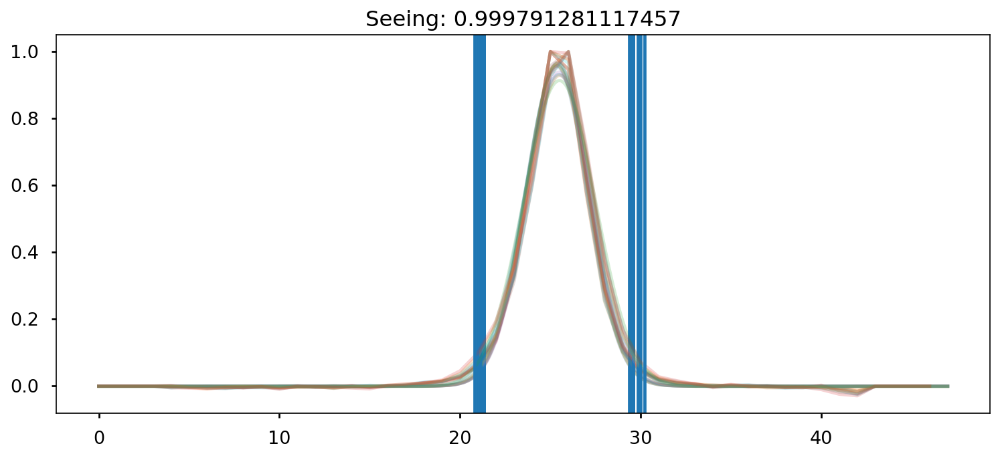

Mediana espectro estrella:  42.418457
Mediana fluxcal:  4.00411522618286e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.7236768]
calib Data:  [1.48079425]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


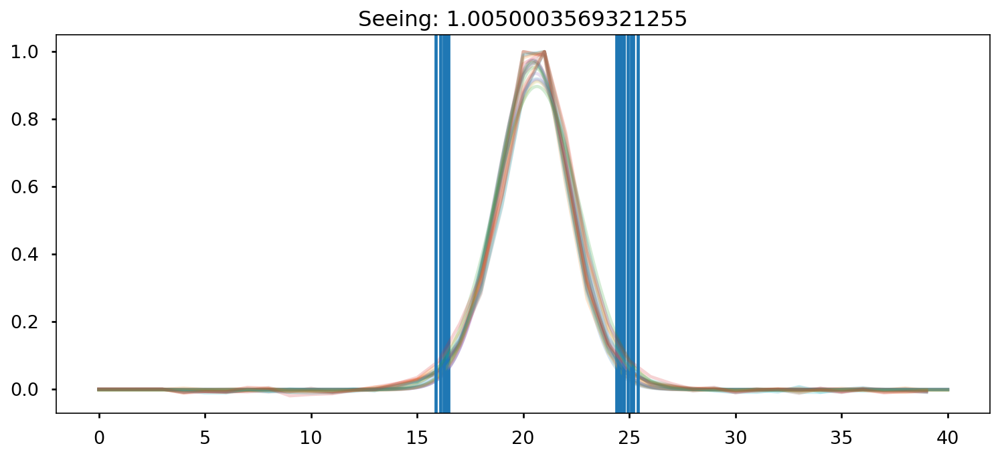

Mediana espectro estrella:  23.671688
Mediana fluxcal:  4.07586329060511e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.36372748]
calib Data:  [1.53860447]
Fcalib :  [5.46665330e-18 5.46482415e-18 5.46299576e-18 ... 7.29996308e-18
 7.30244438e-18 7.30492644e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean004_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean004_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


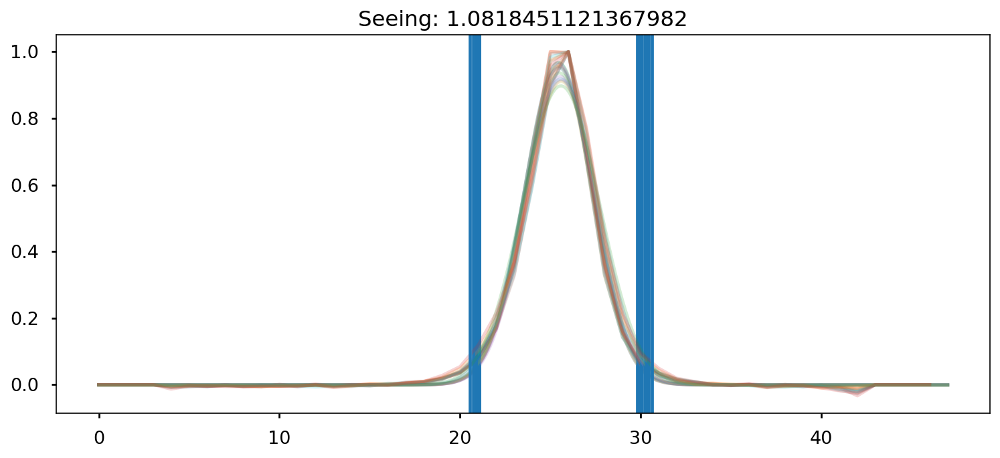

Mediana espectro estrella:  42.196327
Mediana fluxcal:  4.033939823769528e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.72850231]
calib Data:  [1.48739023]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


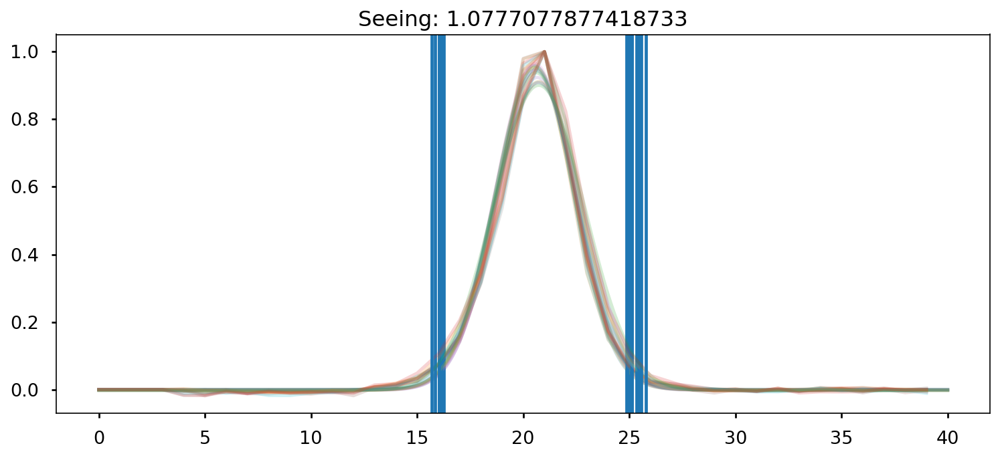

Mediana espectro estrella:  22.180658
Mediana fluxcal:  4.352409808875522e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.36026745]
calib Data:  [1.53370904]
Fcalib :  [5.78029704e-18 5.77833248e-18 5.77636873e-18 ... 7.52551734e-18
 7.52810279e-18 7.53068905e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean005_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean005_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


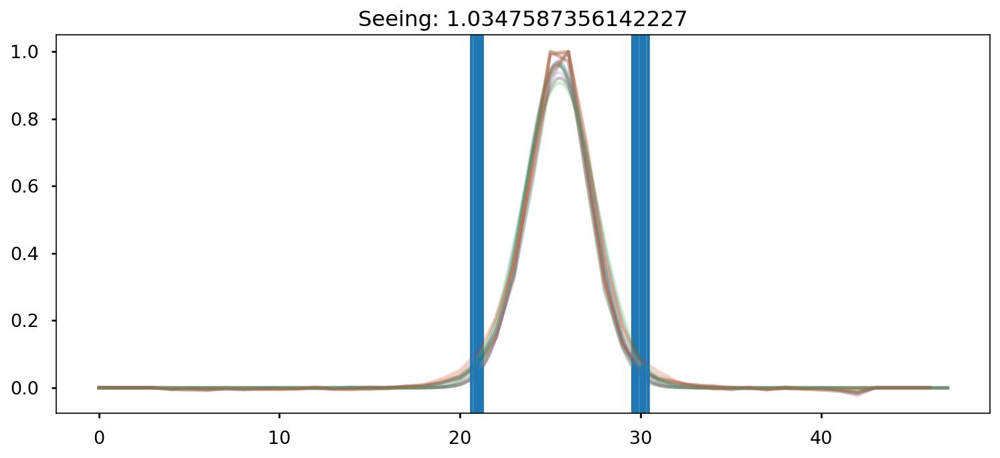

Mediana espectro estrella:  42.49353
Mediana fluxcal:  3.9654732323479035e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.72026483]
calib Data:  [1.47614811]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


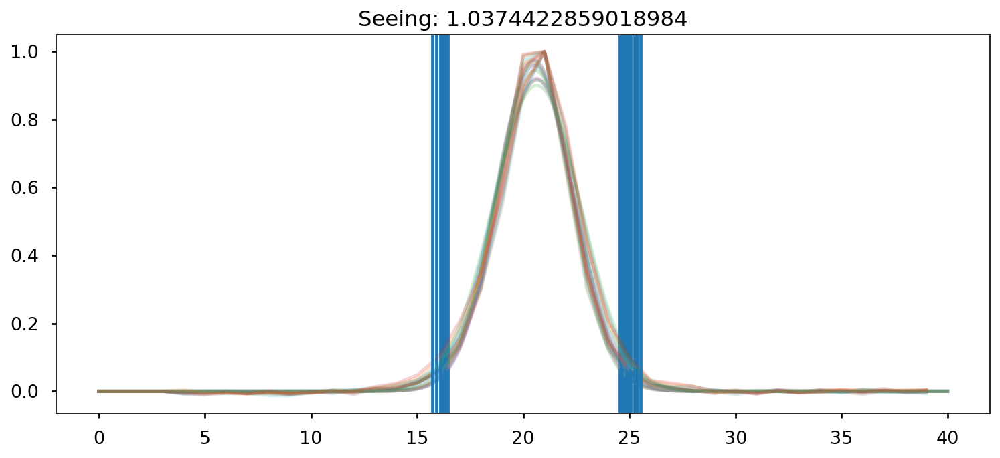

Mediana espectro estrella:  23.876583
Mediana fluxcal:  4.066742294345908e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.36420215]
calib Data:  [1.53927728]
Fcalib :  [5.46274441e-18 5.46091720e-18 5.45909076e-18 ... 7.20712969e-18
 7.20957743e-18 7.21202594e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean006_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean006_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


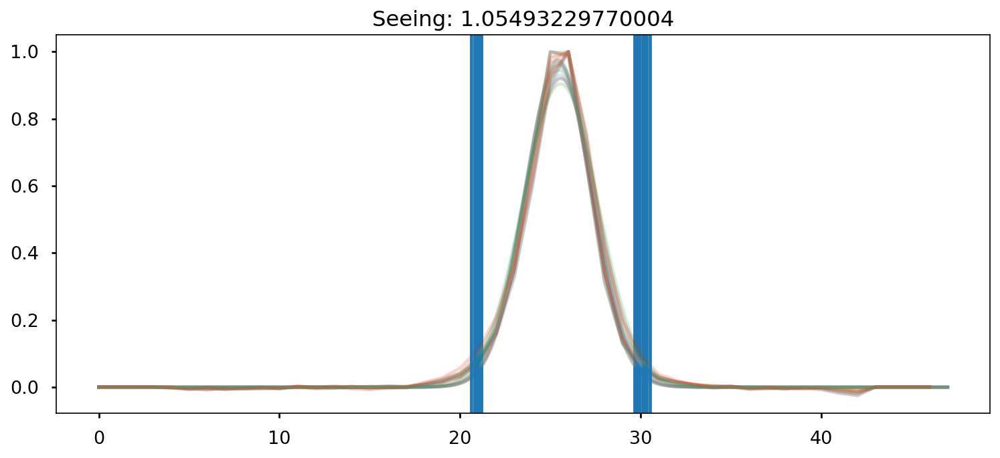

Mediana espectro estrella:  42.19941
Mediana fluxcal:  3.994827475854266e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.7249308]
calib Data:  [1.48250553]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


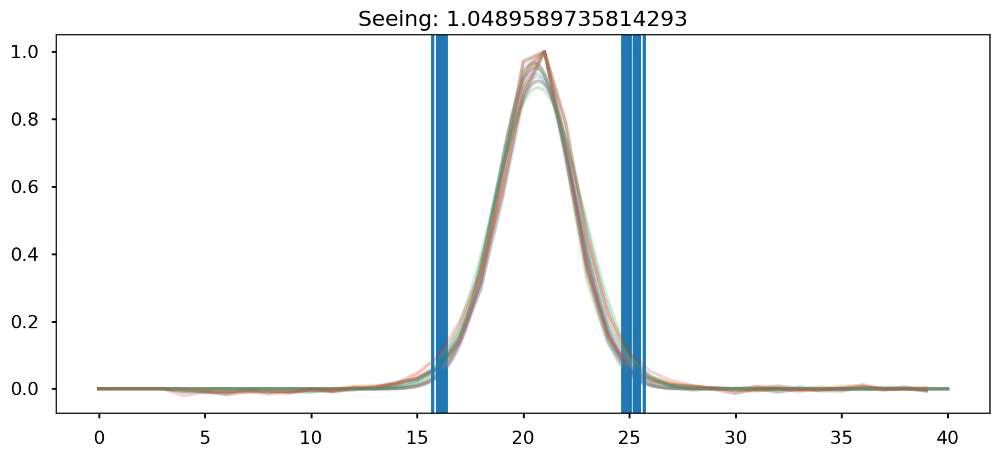

Mediana espectro estrella:  23.546171
Mediana fluxcal:  4.11669483616831e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.36399415]
calib Data:  [1.53898242]
Fcalib :  [5.56642960e-18 5.56453585e-18 5.56264289e-18 ... 7.32701482e-18
 7.32953489e-18 7.33205575e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean007_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean007_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


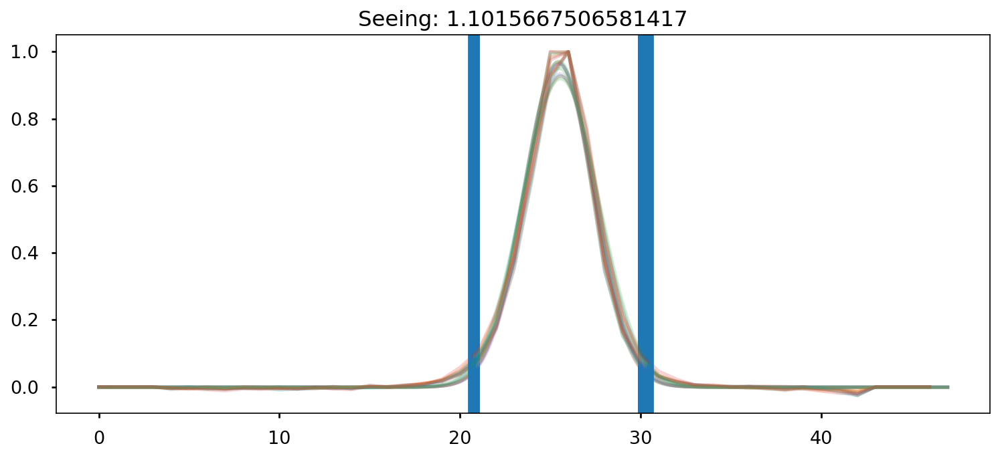

Mediana espectro estrella:  42.540356
Mediana fluxcal:  3.984367569921347e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.73020365]
calib Data:  [1.48972278]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


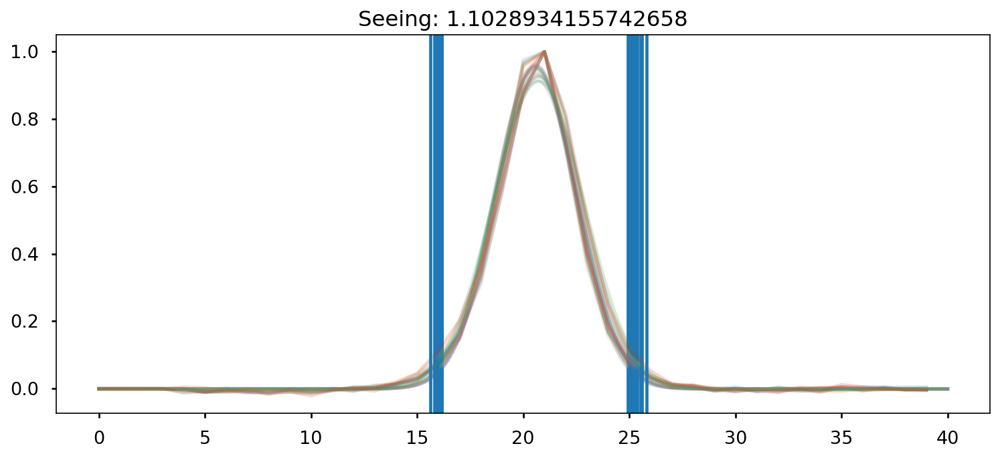

Mediana espectro estrella:  23.73753
Mediana fluxcal:  4.1060614306552125e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.36153061]
calib Data:  [1.53549442]
Fcalib :  [5.58605822e-18 5.58417470e-18 5.58229195e-18 ... 7.18375529e-18
 7.18620725e-18 7.18865998e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean008_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean008_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


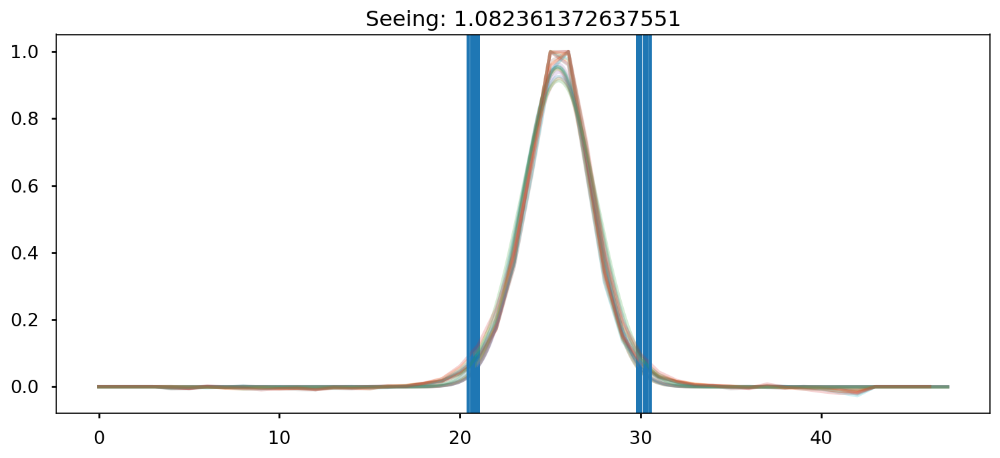

Mediana espectro estrella:  42.09917
Mediana fluxcal:  4.036221325048457e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.72828148]
calib Data:  [1.48708774]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


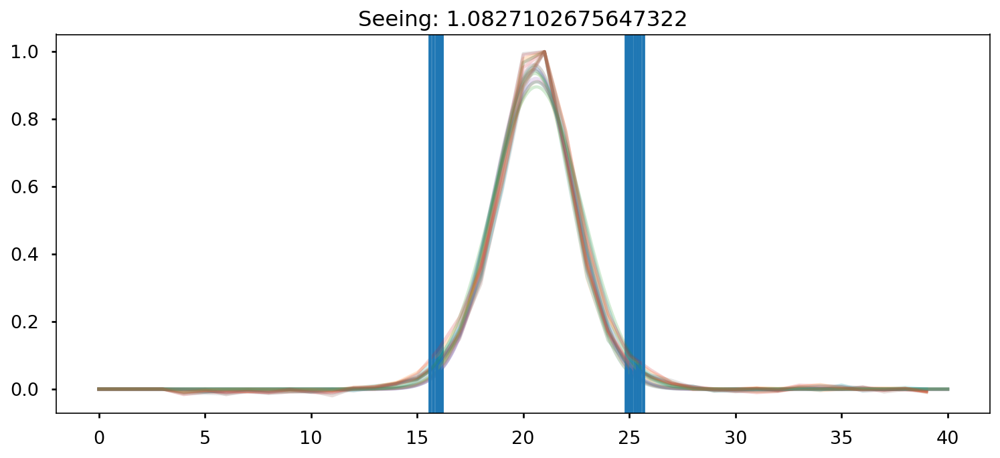

Mediana espectro estrella:  23.658226
Mediana fluxcal:  4.137664330994238e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.34263394]
calib Data:  [1.50900117]
Fcalib :  [5.68029403e-18 5.67835369e-18 5.67641414e-18 ... 7.30237483e-18
 7.30489229e-18 7.30741054e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean009_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean009_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


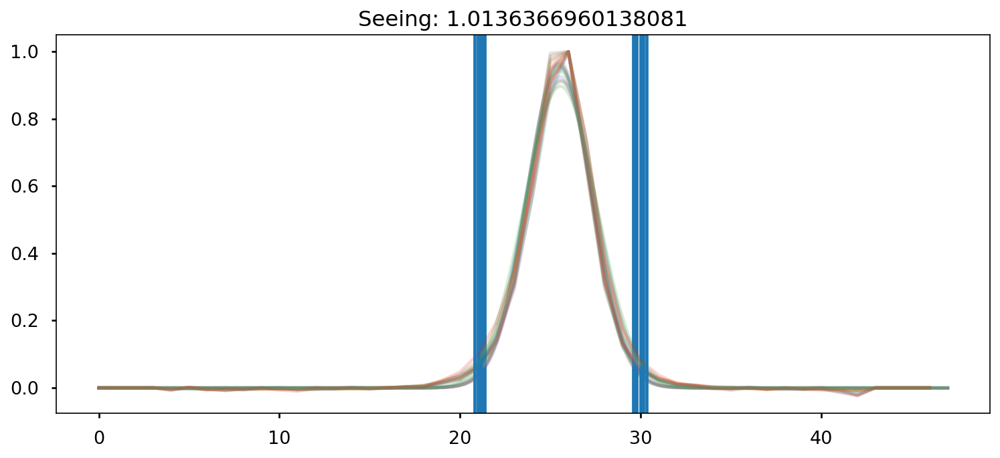

Mediana espectro estrella:  43.421867
Mediana fluxcal:  3.924848636264543e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.72070133]
calib Data:  [1.47674168]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


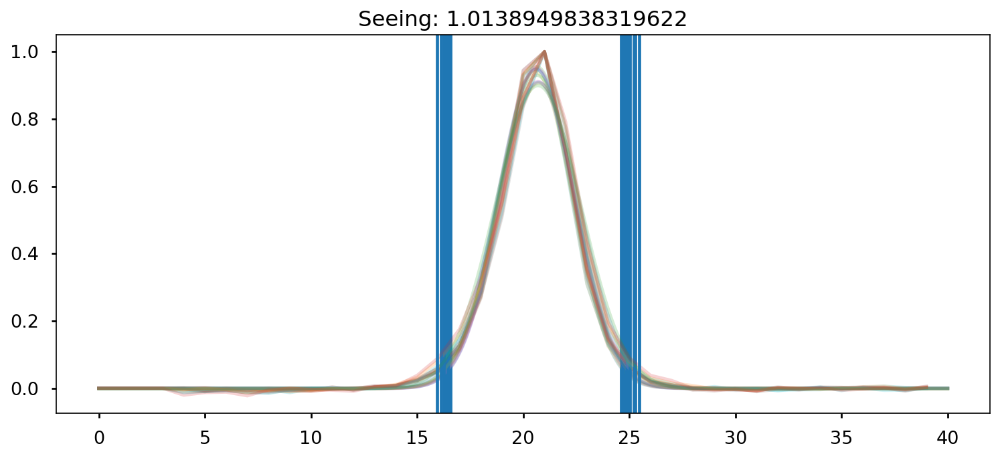

Mediana espectro estrella:  24.106216
Mediana fluxcal:  4.020664563542489e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.35901597]
calib Data:  [1.53194222]
Fcalib :  [5.44385775e-18 5.44202163e-18 5.44018628e-18 ... 7.12574526e-18
 7.12817971e-18 7.13061492e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean010_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean010_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508
mask2_3


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


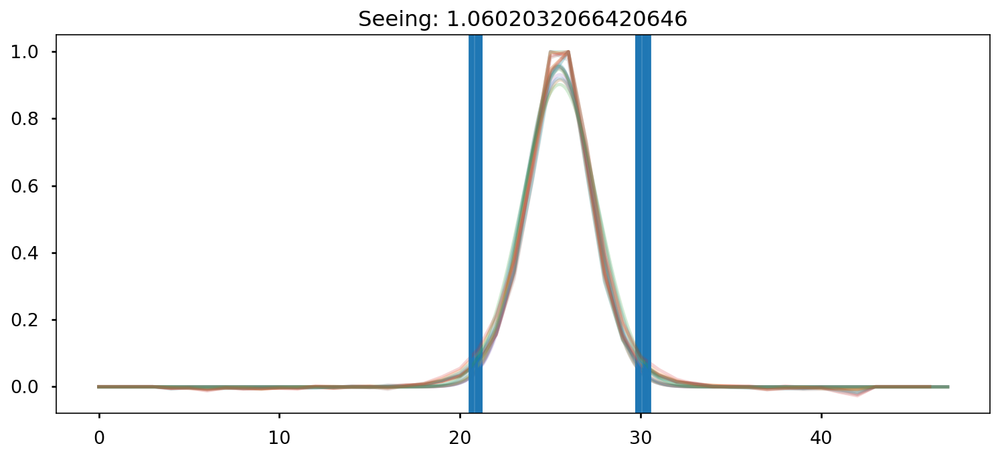

Mediana espectro estrella:  40.46436
Mediana fluxcal:  4.193267956301501e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [17.70976225]
calib Data:  [1.46193781]


<ipython-input-22-e2aafc179341>:22: RuntimeWarning: invalid value encountered in true_divide
  collapsedData=collapsedData/np.max(collapsedData)


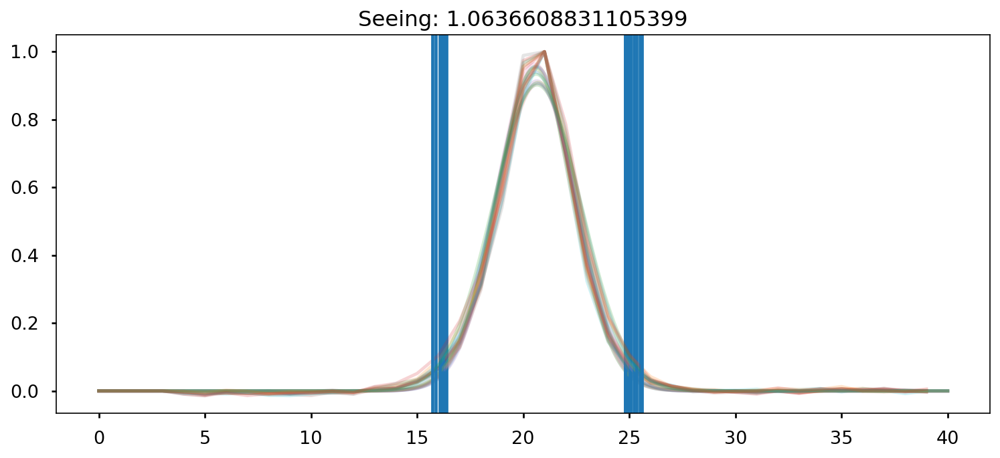

Mediana espectro estrella:  22.598927
Mediana fluxcal:  4.289643347156913e-18
wave Data, masked Data: [ 6760.          6760.62011011  6761.24022022 ... 10250.59980663
 10251.21991674 10251.84002685] [nan nan nan ... nan nan nan]
mag Data:  [18.36233255]
calib Data:  [1.53662898]
Fcalib :  [5.69563081e-18 5.69377996e-18 5.69192988e-18 ... 7.51188014e-18
 7.51437708e-18 7.51687480e-18]
Tcalib :  [1. 1. 1. ... 1. 1. 1.]
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean011_abs_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/0508/obj_clean011_abs_err_slits_lin_fluxcal_telcor.fits
/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/mask2_3/0508


In [25]:
RUN=True

if RUN==True:
    PSF,PSF_ALL=[],[]
    FCAL,FCAL_ALL=[],[]
    for ii,f in enumerate(spec2D_all[:]):
        gal=fits.open(f)
        errgal=fits.open(err2D_all[ii])
        tCalibration=[]
        fCalibration=[]
        PSFs=[]
        FCALs=[]

        folder=""

        if len(gal)==171:
            starIdx=stars['index'][:2]
            folder='mask2_1'
        if len(gal)==152:
            starIdx=stars['index'][2:4]
            folder="mask2_2"
        if len(gal)==154:
            starIdx=stars['index'][4:6]
            folder="mask2_3"
        print(folder)

        for n in starIdx:
            n=n+1 # to ignore first element in each .fits
            Obj,errObj=gal[n],errgal[n]
            Yposition=int(np.round(Obj.header["SLITYPIX"]))
            rng = Yposition 
            #if rng>=Yposition:
            #    rng=Yposition
            dat=Obj.data[Yposition-rng:Yposition+rng]
            err=errObj.data[Yposition-rng:Yposition+rng]
            repetitions=20
            interval=int(np.shape(dat)[1]/repetitions)
            # CALCULATE SEEING FOR EACH STAR IN EACH EXPOSURE
            seeing=obtainSeeing(dat,repetitions,rng,interval,showPlots=True)
            PSFs.append(seeing)
            
            starSpec=Obj.data[Yposition-int(np.round(seeing)): Yposition+int(np.round(seeing))]
            starSpec=np.nansum(starSpec,axis=0)
            print("Mediana espectro estrella: ",np.nanmedian(starSpec))
            #plt.plot(starSpec)
            #plt.show()

            starSpecerr=errObj.data[Yposition-int(np.round(seeing)): Yposition+int(np.round(seeing))]
            starSpecerr=np.nansum(starSpecerr,axis=0)
            starSpec[starSpec == 0.] = np.nan
            starSpecerr[starSpecerr == 0.] = np.nan


            nstep   = len(starSpec)
            wave_nm = (Obj.header['CRVAL1'] + np.linspace(0., nstep*Obj.header['CDELT1'], nstep))
            wave=wave_nm*10

            fluxCal=FluxCalib(Obj.header['ra'] ,Obj.header['dec'],wave,starSpec)
            print("Mediana fluxcal: ",np.nanmedian(fluxCal))




            template,noisyCalib,tellCalib=   runCalbino(Obj.header['ra'] ,Obj.header['dec'],wave,starSpec*fluxCal,starSpecerr*fluxCal)
            tellCalib=np.nan_to_num(noisyCalib,nan=1.0,posinf=1.0,neginf=1.0) #####USE NON-SMOOTH CALIBRATION
            optimisedTellCalib=optimized_tellcorr(wave,starSpec,tellCalib)
            tellCalib=optimisedTellCalib[0]  
   

            #plt.plot(wave,starSpec,label='Standard Stars')
            #plt.plot(wave,starSpecerr,alpha=0.3,label='error')
            #plt.plot(wave,fluxTemplate,label="template")
            #plt.legend()
            #plt.show()
            #transmission =  obtainTransmission(wave,starSpec,fluxTemplate)

            #plt.plot(wave,transmission,lw=0.3)
            #wave,tellCalib   =   TelluricMask(tellCalib,wave)
            #wave,noisyCalib   =   TelluricMask(noisyCalib,wave)   
            #print(np.median(tellCalib))

            ##plt.plot(wave,noisyCalib,lw=0.8)
            #plt.plot(wave,tellCalib,lw=0.8)
            #plt.axhline(y=1,alpha=0.1,ls="--",color="black")
            #plt.xlabel("Wavelength")
            #plt.ylabel("Telluric Transmission")
            #plt.savefig("/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/CalibFigs/"+str(ii)+"_star"+str(n)+"_tellcor.pdf")
            #plt.show()


            #print(optimisedTellCalib[1:])
            
            
            #plt.plot(wave,optimisedTellCalib[0])
            #plt.show()

 




            tCalibration.append(tellCalib)
            fCalibration.append(fluxCal)

            FCALs.append(fluxCal[0])
            
            #plt.plot(wave,starSpec/tellCalib*fluxCal,label='Standard Stars')
            #plt.plot(wave,starSpecerr/tellCalib*fluxCal,alpha=0.3,label='error')
            #plt.plot(wave,template*fluxCal,label="template",alpha=0.3)
            #plt.xlabel("Wavelength")
            #plt.ylabel("Corrected Flux")
            #plt.legend()
            #plt.show()
            #plt.savefig("/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/CalibFigs/"+str(ii)+"_star"+str(n)+"_fluxcal.pdf")
            #plt.close()
        PSF.append(np.median(PSFs))
        FCAL.append(np.median(FCALs))

        PSF_ALL.append(PSFs)
        FCAL_ALL.append(FCALs)
        #print(FCAL_ALL)

        wave=wave
        tCalibration=np.nanmedian(tCalibration,axis=0)
        fCalibration=np.nanmedian(fCalibration,axis=0)

        print("Fcalib : ",fCalibration)
        print("Tcalib : ",tCalibration)

        for ss,ext in enumerate(gal[1:]):
            
            ext.data=ext.data/(tCalibration)*fCalibration

        print(f.split(".fits")[0]+"_fluxcal_telcor.fits")
        ordir=f.split(".fits")[0]+"_fluxcal_telcor.fits"
    



        newdir="/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/"+folder+"/"+ordir.split("/")[-2]
        isExist = os.path.exists(newdir)
        if not isExist:
            # Create a new directory because it does not exist 
            os.makedirs(newdir)
            print("The new directory is created!")



        print(newdir)
        gal.writeto(newdir+"/"+ordir.split("/")[-1],overwrite=True)

        for ss,ext in enumerate(errgal[1:]):
            ext.data=ext.data/(tCalibration)*fCalibration

        
        print(err2D_all[ii].split(".fits")[0]+"_fluxcal_telcor.fits")
        ordir=err2D_all[ii].split(".fits")[0]+"_fluxcal_telcor.fits"
        newdir="/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/"+folder+"/"+ordir.split("/")[-2]
        print(newdir)
        errgal.writeto(newdir+"/"+ordir.split("/")[-1],overwrite=True)










        

#nstep   = spec1D.shape[1]
#wave_nm = header['CRVAL1'] + np.linspace(0., nstep*header['CDELT1'], nstep)
            
        
 





# SEEING and FWHM figures

In [ ]:
# Find stars on the mask

# Find the stars
datadir    = "/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/"

def find_data():
    """
    Finds raw data
    """
    datadir    = "/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask2/Expositions/"
    files=sorted(bt.insensitive_glob(datadir+'/*/obj_clean*abs_slits_lin.fits'))
    errs=sorted(bt.insensitive_glob(datadir+'/*/obj_clean*abs_err_slits_lin.fits'))
    datadir    = "/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/data/large_files/Raw/mask1/Expositions/mask1/"
    files=files+sorted(bt.insensitive_glob(datadir+'/*/obj_clean*abs_slits_lin.fits'))
    errs=files+sorted(bt.insensitive_glob(datadir+'/*/obj_clean*abs_err_slits_lin.fits'))
    return files,errs


spec2D_all,err2D_all = find_data()
for i,s in enumerate(spec2D_all):
    print(i,s)

stars={}
stars["index"]=[]
stars["id"]=[]
stars["ra"]=[]
stars["dec"]=[]
for ss,f in enumerate( [name for name in fits.open(spec2D_all[0]) if "ImageHDU" in str(name)]): #Get stars index
    #print(name)
    if "f_" in f.header["SLITOBJ"]:
        stars["index"].append(ss)
        stars["id"].append(f.header["SLITOBJ"])
        stars["ra"].append(f.header["ra"])
        stars["dec"].append(f.header["dec"])


for ss,f in enumerate( [name for name in fits.open(spec2D_all[70]) if "ImageHDU" in str(name)]): #Get stars index
    #print(name)
    if "f_" in f.header["SLITOBJ"]:
        stars["index"].append(ss)
        stars["id"].append(f.header["SLITOBJ"])
        stars["ra"].append(f.header["ra"])
        stars["dec"].append(f.header["dec"])

for ss,f in enumerate( [name for name in fits.open(spec2D_all[130]) if "ImageHDU" in str(name)]): #Get stars index
    #print(name)
    if "f_" in f.header["SLITOBJ"]:
        stars["index"].append(ss)
        stars["id"].append(f.header["SLITOBJ"])
        stars["ra"].append(f.header["ra"])
        stars["dec"].append(f.header["dec"])

for ss,f in enumerate( [name for name in fits.open(spec2D_all[162]) if "ImageHDU" in str(name)]): #Get stars index
    #print(name)
    if "f_" in f.header["SLITOBJ"]:
        stars["index"].append(ss)
        stars["id"].append(f.header["SLITOBJ"])
        stars["ra"].append(f.header["ra"])
        stars["dec"].append(f.header["dec"])

print(stars)

In [ ]:
print(len(fits.open(spec2D_all[0])))
print(len(fits.open(spec2D_all[70])))
print(len(fits.open(spec2D_all[130])))
print(len(fits.open(spec2D_all[162])))

In [ ]:


print(stars)

PSF,PSF_ALL=[],[]
m1,m2,m3,m4=0,0,0,0
for ii,f in enumerate(spec2D_all[:]):
    gal=fits.open(f)
    errgal=fits.open(err2D_all[ii])
    folder=""
    if len(gal)==171:
        starIdx=stars['index'][:2]
        folder='mask2_1'
    if len(gal)==152:
        starIdx=stars['index'][2:4]
        folder="mask2_2"
    if len(gal)==154:
        starIdx=stars['index'][4:6]
        folder="mask2_3"
    if len(gal)==175:
        starIdx=stars['index'][6:8]
        folder="mask1"

    s=[]
    PSFs=[]
    for n in starIdx:

        n=n+1 # to ignore first element in each .fits
        Obj,errObj=gal[n],errgal[n]
        Yposition=int(np.round(Obj.header["SLITYPIX"]))
        rng = 15 
        if rng>=Yposition:
            rng=Yposition
        dat=Obj.data[Yposition-rng:Yposition+rng]
        err=errObj.data[Yposition-rng:Yposition+rng]
        repetitions=20
        interval=int(np.shape(dat)[1]/repetitions)
        seeing=obtainSeeing(dat,repetitions,rng,interval)
        PSFs.append(seeing)
        s.append(seeing)
    PSF.append(np.median(PSFs))
    PSF_ALL.append(PSFs)
        
    if np.mean(np.array(s)*0.24) > 1.2:
        if len(gal)==171:
            m1+=1
        if len(gal)==152:
            m2+=1
        if len(gal)==154:
            m3+=1
        if len(gal)==175:
            m4+=1
            

In [ ]:
print(m1,m2,m3,m4)

# WHICH EXPOSITIONS WE DONT TAKE?

In [ ]:
Seeing_lim=1.2
Exceptions=[]
for f,seeing in zip(spec2D_all,PSF_ALL):
    if np.mean(np.array(seeing)*0.24) > Seeing_lim:
        #print(f,np.mean(np.array(seeing)*0.24))
        Exceptions.append(f)
np.save("/Users/gonzalo/Desktop/Code/Gonzalo_Binospec/code/files/BadSeeing_Exposures.npy",Exceptions)

    

In [ ]:
def flatten(t):
    return np.array([item for sublist in t for item in sublist])


pixscale=0.24

plt.hist(np.array(PSF)*pixscale,bins=12)
plt.ylabel("N Expositions")
plt.xlabel("FWHM in arcsec")
plt.title("Median of the two stars, ALL expositions")
plt.show()

cut1,cut2,cut3=66,122,162

plt.hist(np.transpose(PSF_ALL[cut3:])[0]*pixscale,bins=10,alpha=0.5)
plt.hist(np.transpose(PSF_ALL[cut3:])[1]*pixscale,bins=10,alpha=0.5)
plt.hist(np.array(PSF[cut3:])*pixscale,bins=12,color="gray",ls="--",edgecolor="black",lw=2.0,alpha=0.6)
plt.ylabel("N Expositions")
plt.xlabel("FWHM in arcsec")
plt.title("mask 1")
plt.show()


plt.hist(np.transpose(PSF_ALL[0:cut1])[0]*pixscale,bins=10,alpha=0.5)
plt.hist(np.transpose(PSF_ALL[0:cut1])[1]*pixscale,bins=10,alpha=0.5)
plt.hist(np.array(PSF[0:cut1])*pixscale,bins=12,color="gray",ls="--",edgecolor="black",lw=2.0,alpha=0.6)
plt.ylabel("N Expositions")
plt.xlabel("FWHM in arcsec")
plt.title("mask 2_1")
plt.show()

plt.hist(np.transpose(PSF_ALL[cut1:cut2])[0]*pixscale,bins=10,alpha=0.5)
plt.hist(np.transpose(PSF_ALL[cut1:cut2])[1]*pixscale,bins=10,alpha=0.5)
plt.hist(np.array(PSF[cut1:cut2])*pixscale,bins=12,color="gray",ls="--",edgecolor="black",lw=2.0,alpha=0.6)
plt.ylabel("N Expositions")
plt.xlabel("FWHM in arcsec")
plt.title("mask 2_2")
plt.show()

plt.hist(np.transpose(PSF_ALL[cut2:cut3])[0]*pixscale,bins=10,alpha=0.5)
plt.hist(np.transpose(PSF_ALL[cut2:cut3])[1]*pixscale,bins=10,alpha=0.5)
plt.hist(np.array(PSF[cut2:cut3])*pixscale,bins=12,color="gray",ls="--",edgecolor="black",lw=2.0,alpha=0.6)
plt.ylabel("N Expositions")
plt.xlabel("FWHM in arcsec")
plt.title("mask 2_3")
plt.show()

plt.hist(FCAL)
plt.show()

cut1,cut2=66,122

plt.hist(FCAL[:cut1],label="mask2",alpha=0.5)
plt.hist(FCAL[cut1:cut2],label="mask3",alpha=0.5)
plt.hist(FCAL[cut2:],label="mask4",alpha=0.5)
plt.show()

print(FCAL)




"""

plt.hist(FCAL,bins=20)
plt.ylabel("N Expositions")
plt.xlabel("Flux Cal")
plt.title("Median of the two stars, ALL expositions")
plt.show()

plt.hist(np.transpose(FCAL_ALL[0:cut1])[0],bins=5)
plt.hist(np.transpose(FCAL_ALL[0:cut1])[1],bins=5)
plt.hist(np.array(FCAL[0:cut1]),bins=10,color="gray",ls="--",edgecolor="black",lw=2.0,alpha=0.6)
plt.ylabel("N Expositions")
plt.xlabel("Flux Cal")
plt.title("mask 2_1")
plt.show()

plt.hist(np.transpose(FCAL_ALL[cut1:cut2])[0],bins=5)
plt.hist(np.transpose(FCAL_ALL[cut1:cut2])[1],bins=5)
plt.hist(np.array(FCAL[cut1:cut2]),bins=10,color="gray",ls="--",edgecolor="black",lw=2.0,alpha=0.6)
plt.ylabel("N Expositions")
plt.xlabel("Flux Cal")
plt.title("mask 2_2")
plt.show()

plt.hist(np.transpose(FCAL_ALL[cut2:])[0],bins=5)
plt.hist(np.transpose(FCAL_ALL[cut2:])[1],bins=5)
plt.hist(np.array(FCAL[cut2:]),bins=10,color="gray",ls="--",edgecolor="black",lw=2.0,alpha=0.6)
plt.ylabel("N Expositions")
plt.xlabel("Flux Cal")
plt.title("mask 2_3")
plt.show()
"""


In [ ]:
#print(spec2D_all[66:67])
counter=0
first=[]
for n,f in enumerate(spec2D_all[0:1]):
    gal=fits.open(f)
    for i in gal[1:]:
        if "z" in i.header["SLITOBJ"]:
            counter+=1
            first.append(i.header["SLITOBJ"])
            #print(i.header["SLITOBJ"])
print(counter)

second=[]
counter=0
for n,f in enumerate(spec2D_all[70:71]):
    gal=fits.open(f)
    for i in gal[1:]:
        if "z" in i.header["SLITOBJ"]:
            counter+=1
            second.append(i.header["SLITOBJ"])
            #print(i.header["SLITOBJ"])
print(counter)

third=[]
counter=0
for n,f in enumerate(spec2D_all[131:132]):
    gal=fits.open(f)
    for i in gal[1:]:
        if "z" in i.header["SLITOBJ"]:
            counter+=1
            third.append(i.header["SLITOBJ"])
            #print(i.header["SLITOBJ"])
print(counter)

for i in first:
    for j in second:
        if i==j:
            print(i,j)

for i in first:
    for j in third:
        if i==j:
            print(i,j)

for i in second:
    for j in third:
        if i==j:
            print(i,j)